In [1]:
nCPU = 4
import time, os, sys, pickle, h5py, importlib, gc, copy, re, itertools, timeit, json
os.environ['OMP_NUM_THREADS'] = str(nCPU)
os.environ['MKL_NUM_THREADS'] = str(nCPU)
os.environ['NUMEXPR_NUM_THREADS'] = str(nCPU)
from tqdm.auto import tqdm, trange
from collections import OrderedDict, deque, defaultdict
from pathlib import Path

import torch, torch.nn as nn, torch.nn.functional as F
import numpy as np, pandas as pd, scipy
from scipy.stats import zscore, ttest_ind, spearmanr, pearsonr
from scipy.sparse import coo_matrix
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.decomposition import PCA, NMF, TruncatedSVD
from sklearn.metrics import silhouette_score, adjusted_rand_score

from umap import UMAP

torch.set_num_threads(nCPU)

import matplotlib
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
sns.set_style("white")
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['svg.fonttype'] = 'none'
%matplotlib inline
%config InlineBackend.figure_format='retina'

from model import SpiceMixPlus

In [2]:
import anndata as ad

In [3]:
context = dict(device='cuda:0', dtype=torch.float32)

In [4]:
def reload_all():
    import model, load_data, estimate_parameters, estimate_weights, util, initialization, sample_for_integral
    importlib.reload(util)
    importlib.reload(load_data)
    importlib.reload(sample_for_integral)
    importlib.reload(estimate_parameters)
    importlib.reload(estimate_weights)
    importlib.reload(initialization)
    importlib.reload(model)
    from model import SpiceMixPlus

reload_all()

In [5]:
# path2dataset = Path('/work/magroup/tianming/Researches/SpiceMix/version1/data/obsolete/synthetic_500_100_20_15_0_0_i4')
# path2dataset = Path('/work/magroup/tianming/Researches/SpiceMix/version1/data/obsolete/synthetic_500_100_20_15_0_0_i5')
# path2dataset = Path('/work/magroup/tianming/Researches/SpiceMix/version1/data/obsolete/synthetic_500_100_20_15_0_0_i4')
# path2dataset = Path('/media/data/tianming/Researches/RNAseq-seqFISH/version1/data/synthetic_500_100_30_15_0_0_i0')
# path2dataset = Path('/media/data/tianming/Researches/RNAseq-seqFISH/version1/data/synthetic_500_100_30_15_0_0_i1')
# path2dataset = Path('/media/data/tianming/Researches/RNAseq-seqFISH/version1/data/synthetic_500_100_30_15_0_0_i2')
# repli_list = ['0', '1']

path2dataset = Path("../tests/test_data/obsolete_synthetic_500_100_20_15_0_0_i4/")
repli_list = ['0', '1']

coor = np.loadtxt(path2dataset / 'files' / 'coordinates_0.txt')

In [6]:
import model
importlib.reload(model)
from model import SpiceMixPlus

In [7]:
!ls ../tests/test_data/obsolete_synthetic_500_100_20_15_0_0_i4/

all_data.h5				     files
cell type encoded_predictor_iteration_10.pt  trained_5_iterations.h5
cell_type_encoded_predictor_iteration_10.pt  trained_iteration_10.h5


In [8]:
# Testing loading from AnnData
obj = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
    random_state=2
)
dataset = obj.load_dataset(path2dataset, data_format="anndata", anndata_filepath="trained_iteration_10.h5")

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:107: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  i = torch.LongTensor(indices)


In [9]:
# dataset = ad.concat(obj.datasets, label="batch", merge="unique", uns_merge="unique", pairwise=True)

In [10]:
obj.datasets[0].uns["Sigma_x_inv"]

{'0': tensor([[-0.2586,  0.1654,  0.0704,  0.2539,  0.3245, -0.1114, -0.0959,  0.2461,
          -0.4428, -0.0262],
         [ 0.1654,  0.3879,  0.0133,  0.2903,  0.3314,  0.1088,  0.2782,  0.3688,
          -0.1241,  0.0356],
         [ 0.0704,  0.0133, -0.2957, -0.0771, -0.0109, -0.4508, -0.4659, -0.3860,
          -0.0868,  0.0477],
         [ 0.2539,  0.2903, -0.0771,  0.2464,  0.1432,  0.0864,  0.1374,  0.0422,
          -0.1086,  0.0429],
         [ 0.3245,  0.3314, -0.0109,  0.1432,  0.4150, -0.1617,  0.2551,  0.2811,
           0.0398,  0.0647],
         [-0.1114,  0.1088, -0.4508,  0.0864, -0.1617, -0.4332, -0.5354, -0.3991,
          -0.4572, -0.1595],
         [-0.0959,  0.2782, -0.4659,  0.1374,  0.2551, -0.5354, -0.2652,  0.2263,
          -0.4662, -0.0481],
         [ 0.2461,  0.3688, -0.3860,  0.0422,  0.2811, -0.3991,  0.2263, -0.1418,
          -0.0673, -0.4523],
         [-0.4428, -0.1241, -0.0868, -0.1086,  0.0398, -0.4572, -0.4662, -0.0673,
          -0.2791, -0.165

In [11]:
from importlib import reload
import util
reload(util)
from util import clustering_louvain_nclust, evaluate_embedding, evaluate_prediction_wrapper

In [12]:
%%time
reload_all()
from sklearn.cluster import AgglomerativeClustering

# evaluate = lambda obj, f=evaluate_embedding: f(obj, embedding='X', do_plot=True, do_sil=True)
def evaluate(obj):
    evaluate_embedding(obj, embedding='X', do_plot=True, do_sil=True)
    print("Done")
    fig, ax = plt.subplots(figsize=(8, 8))
#     sns.heatmap(obj.Sigma_x_inv.cpu().numpy(), annot=True, fmt='.1f')
    
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    for ax, x in zip(axes.flat, obj.Xs[0].cpu().numpy().T):
        sns.scatterplot(x=coor[:, 0], y=coor[:, 1], hue=x, ax=ax)
    plt.show()
    plt.close()

CPU times: user 1.18 ms, sys: 2.25 ms, total: 3.43 ms
Wall time: 3.67 ms


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/model.py:138: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset = ad.AnnData(raw_dataframe)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.009520091982804e-08
M NAG Loss: 21298.875
M NAG Loss: 20965.875
M NAG Loss: 20830.0625
M NAG Loss: 20755.5625
M NAG Loss: 20710.8125
M NAG Loss: 20680.9375
M NAG Loss: 20659.9375
M NAG Loss: 20644.5625
M NAG Loss: 20633.375
M NAG Loss: 20625.5
M NAG Loss: 20619.5625
M NAG Loss: 20614.75
M NAG Loss: 20610.9375
M NAG Loss: 20607.875
M NAG Loss: 20605.0625
M NAG Loss: 20602.9375
M NAG Loss: 20600.9375
M NAG Loss: 20599.1875
M NAG Loss: 20597.4375
M NAG Loss: 20595.9375
M NAG Loss: 20594.6875
M NAG Loss: 20593.4375
M NAG Loss: 20592.25
M NAG Loss: 20591.4375
M NAG Loss: 20590.5625
M NAG Loss: 20589.75
M NAG Loss: 20589.0625
M NAG Loss: 20588.5625
M NAG Loss: 20588.25
M NAG Loss: 20588.0
M NAG Loss: 20587.875
M NAG Loss: 20587.75
M NAG Loss: 20587.6875
M NAG Loss: 20587.75
M NAG Loss: 20587.6875
M NAG Loss: 20587.8125
M NAG Loss: 20587.875
M NAG Loss: 20587.9375
M NAG Loss: 20587.9375
M NAG Loss: 20588.0
M NAG Loss: 20588.0625
M NAG Loss: 20588.0625
M NAG Loss: 20588.25
M NAG Loss: 20588.

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.1718475649648704e-08
M NAG Loss: 20878.25
M NAG Loss: 20511.9375
M NAG Loss: 20351.5
M NAG Loss: 20264.875
M NAG Loss: 20218.5625
M NAG Loss: 20194.1875
M NAG Loss: 20181.6875
M NAG Loss: 20175.4375
M NAG Loss: 20172.375
M NAG Loss: 20170.5
M NAG Loss: 20168.9375
M NAG Loss: 20167.0
M NAG Loss: 20165.125
M NAG Loss: 20163.125
M NAG Loss: 20161.1875
M NAG Loss: 20159.1875
M NAG Loss: 20157.375
M NAG Loss: 20155.75
M NAG Loss: 20154.0625
M NAG Loss: 20152.5
M NAG Loss: 20151.0625
M NAG Loss: 20149.6875
M NAG Loss: 20148.4375
M NAG Loss: 20147.1875
M NAG Loss: 20146.0625
M NAG Loss: 20145.1875
M NAG Loss: 20144.3125
M NAG Loss: 20143.5625
M NAG Loss: 20143.0625
M NAG Loss: 20142.375
M NAG Loss: 20142.0
M NAG Loss: 20141.5625
M NAG Loss: 20141.1875
M NAG Loss: 20140.9375
M NAG Loss: 20140.8125
M NAG Loss: 20140.5625
M NAG Loss: 20140.5625
M NAG Loss: 20140.4375
M NAG Loss: 20140.4375
M NAG Loss: 20140.4375
M NAG Loss: 20140.4375
M NAG Loss: 20140.4375
M NAG Loss: 20140.4375
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

4.7624231856858325e-08
M NAG Loss: 24543.25
M NAG Loss: 24382.375
M NAG Loss: 24282.375
M NAG Loss: 24198.125
M NAG Loss: 24125.375
M NAG Loss: 24063.375
M NAG Loss: 24011.625
M NAG Loss: 23971.375
M NAG Loss: 23941.875
M NAG Loss: 23920.875
M NAG Loss: 23906.75
M NAG Loss: 23898.25
M NAG Loss: 23893.375
M NAG Loss: 23890.875
M NAG Loss: 23889.0
M NAG Loss: 23888.25
M NAG Loss: 23887.125
M NAG Loss: 23886.25
M NAG Loss: 23884.875
M NAG Loss: 23883.625
M NAG Loss: 23882.25
M NAG Loss: 23881.25
M NAG Loss: 23880.375
M NAG Loss: 23879.25
M NAG Loss: 23878.875
M NAG Loss: 23878.375
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.25
M NAG Loss: 23878.125
M NAG Loss: 23878.375
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.125
M NAG Loss: 23878.375
M NAG Loss: 23878.25
M NAG Loss: 23878.25
M NAG Loss: 23878.375
M NAG Loss: 23878.125
M NAG Loss: 23878.125


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

4.904856092012746e-08
M NAG Loss: 23952.375
M NAG Loss: 23793.0
M NAG Loss: 23714.875
M NAG Loss: 23669.75
M NAG Loss: 23645.75
M NAG Loss: 23633.25
M NAG Loss: 23627.0
M NAG Loss: 23622.75
M NAG Loss: 23619.875
M NAG Loss: 23616.75
M NAG Loss: 23614.0
M NAG Loss: 23610.875
M NAG Loss: 23608.0
M NAG Loss: 23605.25
M NAG Loss: 23602.5
M NAG Loss: 23599.75
M NAG Loss: 23597.0
M NAG Loss: 23594.625
M NAG Loss: 23592.0
M NAG Loss: 23589.875
M NAG Loss: 23587.875
M NAG Loss: 23586.0
M NAG Loss: 23584.375
M NAG Loss: 23583.0
M NAG Loss: 23581.625
M NAG Loss: 23580.375
M NAG Loss: 23579.25
M NAG Loss: 23578.25
M NAG Loss: 23577.75
M NAG Loss: 23577.125
M NAG Loss: 23576.625
M NAG Loss: 23576.25
M NAG Loss: 23575.75
M NAG Loss: 23575.75
M NAG Loss: 23575.75
M NAG Loss: 23575.5
M NAG Loss: 23575.5
M NAG Loss: 23575.75
M NAG Loss: 23575.75
M NAG Loss: 23576.0
M NAG Loss: 23575.75
M NAG Loss: 23575.75
M NAG Loss: 23576.125
M NAG Loss: 23576.0
M NAG Loss: 23576.25
M NAG Loss: 23576.125
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.145445272426629e-08
M NAG Loss: 24427.25
M NAG Loss: 24316.25
M NAG Loss: 24259.25
M NAG Loss: 24217.5
M NAG Loss: 24185.25
M NAG Loss: 24160.5
M NAG Loss: 24141.75
M NAG Loss: 24128.25
M NAG Loss: 24118.625
M NAG Loss: 24111.5
M NAG Loss: 24106.75
M NAG Loss: 24102.5
M NAG Loss: 24099.125
M NAG Loss: 24096.5
M NAG Loss: 24093.75
M NAG Loss: 24091.25
M NAG Loss: 24088.625
M NAG Loss: 24086.5
M NAG Loss: 24084.5
M NAG Loss: 24082.875
M NAG Loss: 24081.5
M NAG Loss: 24080.125
M NAG Loss: 24079.375
M NAG Loss: 24078.5
M NAG Loss: 24078.25
M NAG Loss: 24077.625
M NAG Loss: 24077.5
M NAG Loss: 24077.125
M NAG Loss: 24076.875
M NAG Loss: 24076.875
M NAG Loss: 24077.0
M NAG Loss: 24077.0
M NAG Loss: 24076.75
M NAG Loss: 24076.625
M NAG Loss: 24077.125
M NAG Loss: 24077.25
M NAG Loss: 24077.0
M NAG Loss: 24077.25
M NAG Loss: 24077.5
M NAG Loss: 24077.25
M NAG Loss: 24077.375
M NAG Loss: 24077.25
M NAG Loss: 24077.25
M NAG Loss: 24077.25
M NAG Loss: 24077.0
M NAG Loss: 24077.0
M NAG Loss: 240

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.3528456691089206e-08
M NAG Loss: 24085.25
M NAG Loss: 23951.875
M NAG Loss: 23888.875
M NAG Loss: 23851.0
M NAG Loss: 23828.0
M NAG Loss: 23814.125
M NAG Loss: 23805.25
M NAG Loss: 23799.0
M NAG Loss: 23794.0
M NAG Loss: 23789.625
M NAG Loss: 23785.25
M NAG Loss: 23781.25
M NAG Loss: 23777.0
M NAG Loss: 23773.25
M NAG Loss: 23769.0
M NAG Loss: 23765.375
M NAG Loss: 23761.75
M NAG Loss: 23758.75
M NAG Loss: 23755.75
M NAG Loss: 23752.75
M NAG Loss: 23750.5
M NAG Loss: 23747.875
M NAG Loss: 23745.875
M NAG Loss: 23744.25
M NAG Loss: 23742.375
M NAG Loss: 23741.0
M NAG Loss: 23739.625
M NAG Loss: 23738.75
M NAG Loss: 23737.75
M NAG Loss: 23737.375
M NAG Loss: 23736.5
M NAG Loss: 23736.5
M NAG Loss: 23736.0
M NAG Loss: 23735.75
M NAG Loss: 23735.75
M NAG Loss: 23735.75
M NAG Loss: 23735.75
M NAG Loss: 23735.75
M NAG Loss: 23735.875
M NAG Loss: 23736.0
M NAG Loss: 23736.0
M NAG Loss: 23736.25
M NAG Loss: 23736.625
M NAG Loss: 23736.5
M NAG Loss: 23736.375
M NAG Loss: 23736.5
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.607230546218271e-08
M NAG Loss: 24520.625
M NAG Loss: 24392.375
M NAG Loss: 24314.625
M NAG Loss: 24254.75
M NAG Loss: 24209.0
M NAG Loss: 24175.75
M NAG Loss: 24152.625
M NAG Loss: 24136.875
M NAG Loss: 24126.875
M NAG Loss: 24119.625
M NAG Loss: 24114.75
M NAG Loss: 24110.25
M NAG Loss: 24106.25
M NAG Loss: 24102.125
M NAG Loss: 24098.875
M NAG Loss: 24095.125
M NAG Loss: 24091.875
M NAG Loss: 24089.0
M NAG Loss: 24086.25
M NAG Loss: 24084.25
M NAG Loss: 24082.125
M NAG Loss: 24080.625
M NAG Loss: 24079.0
M NAG Loss: 24078.125
M NAG Loss: 24077.125
M NAG Loss: 24076.625
M NAG Loss: 24076.0
M NAG Loss: 24075.625
M NAG Loss: 24075.5
M NAG Loss: 24075.125
M NAG Loss: 24075.375
M NAG Loss: 24075.125
M NAG Loss: 24075.5
M NAG Loss: 24075.5
M NAG Loss: 24075.625
M NAG Loss: 24075.375
M NAG Loss: 24075.75
M NAG Loss: 24075.75
M NAG Loss: 24075.875
M NAG Loss: 24076.125
M NAG Loss: 24076.0
M NAG Loss: 24076.125
M NAG Loss: 24076.125
M NAG Loss: 24075.75
M NAG Loss: 24075.875
M NAG Loss: 24

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.870410454402643e-08
M NAG Loss: 24134.625
M NAG Loss: 23992.625
M NAG Loss: 23911.875
M NAG Loss: 23855.125
M NAG Loss: 23816.125
M NAG Loss: 23789.375
M NAG Loss: 23772.25
M NAG Loss: 23762.125
M NAG Loss: 23755.875
M NAG Loss: 23752.125
M NAG Loss: 23749.375
M NAG Loss: 23746.75
M NAG Loss: 23744.0
M NAG Loss: 23741.625
M NAG Loss: 23738.625
M NAG Loss: 23735.875
M NAG Loss: 23733.125
M NAG Loss: 23730.75
M NAG Loss: 23728.625
M NAG Loss: 23726.625
M NAG Loss: 23724.5
M NAG Loss: 23723.25
M NAG Loss: 23721.5
M NAG Loss: 23720.0
M NAG Loss: 23718.875
M NAG Loss: 23718.125
M NAG Loss: 23717.125
M NAG Loss: 23716.25
M NAG Loss: 23715.75
M NAG Loss: 23715.125
M NAG Loss: 23715.0
M NAG Loss: 23714.625
M NAG Loss: 23714.375
M NAG Loss: 23714.375
M NAG Loss: 23714.375
M NAG Loss: 23714.25
M NAG Loss: 23714.25
M NAG Loss: 23714.375
M NAG Loss: 23714.375
M NAG Loss: 23714.375
M NAG Loss: 23714.375
M NAG Loss: 23714.625
M NAG Loss: 23714.625
M NAG Loss: 23714.625
M NAG Loss: 23714.75
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.067875743496815e-08
M NAG Loss: 24287.0
M NAG Loss: 24144.125
M NAG Loss: 24061.5
M NAG Loss: 23998.75
M NAG Loss: 23950.875
M NAG Loss: 23915.5
M NAG Loss: 23890.0
M NAG Loss: 23872.0
M NAG Loss: 23859.0
M NAG Loss: 23849.25
M NAG Loss: 23842.25
M NAG Loss: 23836.5
M NAG Loss: 23831.625
M NAG Loss: 23827.25
M NAG Loss: 23823.5
M NAG Loss: 23819.75
M NAG Loss: 23816.5
M NAG Loss: 23813.5
M NAG Loss: 23810.875
M NAG Loss: 23808.375
M NAG Loss: 23806.25
M NAG Loss: 23804.625
M NAG Loss: 23803.125
M NAG Loss: 23802.0
M NAG Loss: 23801.125
M NAG Loss: 23800.625
M NAG Loss: 23800.25
M NAG Loss: 23800.0
M NAG Loss: 23800.0
M NAG Loss: 23799.875
M NAG Loss: 23800.0
M NAG Loss: 23800.0
M NAG Loss: 23799.875
M NAG Loss: 23800.0
M NAG Loss: 23800.0
M NAG Loss: 23800.0
M NAG Loss: 23800.125
M NAG Loss: 23800.375
M NAG Loss: 23800.5
M NAG Loss: 23800.5
M NAG Loss: 23800.5
M NAG Loss: 23800.25
M NAG Loss: 23800.625
M NAG Loss: 23800.25
M NAG Loss: 23800.25
M NAG Loss: 23800.25
M NAG Loss: 23800.0

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.299736022161463e-08
M NAG Loss: 23969.625
M NAG Loss: 23835.0
M NAG Loss: 23761.75
M NAG Loss: 23713.75
M NAG Loss: 23682.25
M NAG Loss: 23662.625
M NAG Loss: 23650.0
M NAG Loss: 23642.25
M NAG Loss: 23637.625
M NAG Loss: 23634.25
M NAG Loss: 23632.0
M NAG Loss: 23629.75
M NAG Loss: 23627.5
M NAG Loss: 23625.25
M NAG Loss: 23622.5
M NAG Loss: 23620.5
M NAG Loss: 23618.625
M NAG Loss: 23616.25
M NAG Loss: 23614.625
M NAG Loss: 23613.25
M NAG Loss: 23611.75
M NAG Loss: 23610.625
M NAG Loss: 23609.5
M NAG Loss: 23608.5
M NAG Loss: 23607.75
M NAG Loss: 23607.125
M NAG Loss: 23606.75
M NAG Loss: 23606.125
M NAG Loss: 23605.75
M NAG Loss: 23605.0
M NAG Loss: 23605.0
M NAG Loss: 23604.875
M NAG Loss: 23604.625
M NAG Loss: 23604.5
M NAG Loss: 23604.5
M NAG Loss: 23604.375
M NAG Loss: 23604.25
M NAG Loss: 23604.5
M NAG Loss: 23604.5
M NAG Loss: 23604.5
M NAG Loss: 23604.625
M NAG Loss: 23604.625
M NAG Loss: 23604.5
M NAG Loss: 23604.75
M NAG Loss: 23604.625
M NAG Loss: 23604.75
M NAG Loss: 23

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.217423807958203e-08
M NAG Loss: 24508.375
M NAG Loss: 24414.375
M NAG Loss: 24366.875
M NAG Loss: 24330.75
M NAG Loss: 24302.125
M NAG Loss: 24278.5
M NAG Loss: 24259.25
M NAG Loss: 24243.875
M NAG Loss: 24231.25
M NAG Loss: 24221.875
M NAG Loss: 24214.25
M NAG Loss: 24208.5
M NAG Loss: 24204.0
M NAG Loss: 24200.25
M NAG Loss: 24197.0
M NAG Loss: 24194.25
M NAG Loss: 24191.875
M NAG Loss: 24189.875
M NAG Loss: 24187.875
M NAG Loss: 24186.5
M NAG Loss: 24185.0
M NAG Loss: 24183.625
M NAG Loss: 24183.0
M NAG Loss: 24181.625
M NAG Loss: 24181.0
M NAG Loss: 24180.5
M NAG Loss: 24180.5
M NAG Loss: 24180.5
M NAG Loss: 24180.375
M NAG Loss: 24180.25
M NAG Loss: 24180.375
M NAG Loss: 24180.5
M NAG Loss: 24180.375
M NAG Loss: 24180.5
M NAG Loss: 24180.625
M NAG Loss: 24180.5
M NAG Loss: 24180.875
M NAG Loss: 24180.75
M NAG Loss: 24180.5
M NAG Loss: 24181.0
M NAG Loss: 24180.75
M NAG Loss: 24180.625
M NAG Loss: 24180.875
M NAG Loss: 24180.75
M NAG Loss: 24180.5
M NAG Loss: 24180.5
M NAG Loss: 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.456302261345692e-08
M NAG Loss: 24327.0
M NAG Loss: 24234.375
M NAG Loss: 24187.625
M NAG Loss: 24158.25
M NAG Loss: 24138.875
M NAG Loss: 24125.5
M NAG Loss: 24116.0
M NAG Loss: 24109.0
M NAG Loss: 24104.0
M NAG Loss: 24100.25
M NAG Loss: 24097.75
M NAG Loss: 24095.75
M NAG Loss: 24094.25
M NAG Loss: 24093.25
M NAG Loss: 24092.0
M NAG Loss: 24091.25
M NAG Loss: 24090.75
M NAG Loss: 24089.875
M NAG Loss: 24089.0
M NAG Loss: 24088.25
M NAG Loss: 24087.625
M NAG Loss: 24086.875
M NAG Loss: 24086.375
M NAG Loss: 24085.75
M NAG Loss: 24085.5
M NAG Loss: 24084.5
M NAG Loss: 24084.5
M NAG Loss: 24084.25
M NAG Loss: 24084.25
M NAG Loss: 24083.75
M NAG Loss: 24083.625
M NAG Loss: 24083.5
M NAG Loss: 24083.25
M NAG Loss: 24083.25
M NAG Loss: 24083.5
M NAG Loss: 24083.25
M NAG Loss: 24083.0
M NAG Loss: 24083.0
M NAG Loss: 24083.25
M NAG Loss: 24083.125
M NAG Loss: 24083.125
M NAG Loss: 24083.25
M NAG Loss: 24083.5
M NAG Loss: 24083.25
M NAG Loss: 24083.5
M NAG Loss: 24083.25
M NAG Loss: 24083.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.34864404073417e-08
M NAG Loss: 24667.125
M NAG Loss: 24603.25
M NAG Loss: 24572.75
M NAG Loss: 24550.5
M NAG Loss: 24533.0
M NAG Loss: 24518.25
M NAG Loss: 24506.125
M NAG Loss: 24496.125
M NAG Loss: 24488.0
M NAG Loss: 24481.125
M NAG Loss: 24475.5
M NAG Loss: 24471.625
M NAG Loss: 24468.5
M NAG Loss: 24465.75
M NAG Loss: 24464.0
M NAG Loss: 24462.25
M NAG Loss: 24460.75
M NAG Loss: 24459.75
M NAG Loss: 24458.875
M NAG Loss: 24458.125
M NAG Loss: 24457.5
M NAG Loss: 24457.0
M NAG Loss: 24456.625
M NAG Loss: 24456.25
M NAG Loss: 24456.0
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.25
M NAG Loss: 24455.375
M NAG Loss: 24455.25
M NAG Loss: 24455.375
M NAG Loss: 24455.25
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.625
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.75
M NAG Loss: 24455.5
M NAG Loss: 24455.5
M NAG Loss: 24455.25
M NAG Loss: 24455.5
M NAG Loss: 24455.25
M NAG Loss: 24455.25
M 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.569654764642118e-08
M NAG Loss: 24505.625
M NAG Loss: 24433.375
M NAG Loss: 24396.125
M NAG Loss: 24373.125
M NAG Loss: 24357.625
M NAG Loss: 24346.875
M NAG Loss: 24338.625
M NAG Loss: 24332.625
M NAG Loss: 24327.75
M NAG Loss: 24323.875
M NAG Loss: 24320.875
M NAG Loss: 24318.75
M NAG Loss: 24316.875
M NAG Loss: 24315.625
M NAG Loss: 24315.125
M NAG Loss: 24314.25
M NAG Loss: 24313.75
M NAG Loss: 24313.375
M NAG Loss: 24313.375
M NAG Loss: 24313.125
M NAG Loss: 24312.875
M NAG Loss: 24312.875
M NAG Loss: 24312.5
M NAG Loss: 24312.375
M NAG Loss: 24312.375
M NAG Loss: 24311.875
M NAG Loss: 24312.0
M NAG Loss: 24311.875
M NAG Loss: 24311.375
M NAG Loss: 24311.5
M NAG Loss: 24311.375
M NAG Loss: 24311.125
M NAG Loss: 24311.25
M NAG Loss: 24311.0
M NAG Loss: 24310.875
M NAG Loss: 24311.125
M NAG Loss: 24311.125
M NAG Loss: 24311.375
M NAG Loss: 24311.125
M NAG Loss: 24311.375
M NAG Loss: 24311.0
M NAG Loss: 24311.125
M NAG Loss: 24311.125
M NAG Loss: 24311.125
M NAG Loss: 24311.125
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.468129585095359e-08
M NAG Loss: 24784.875
M NAG Loss: 24735.5
M NAG Loss: 24711.875
M NAG Loss: 24695.5
M NAG Loss: 24683.25
M NAG Loss: 24673.25
M NAG Loss: 24665.0
M NAG Loss: 24658.0
M NAG Loss: 24652.125
M NAG Loss: 24647.375
M NAG Loss: 24643.25
M NAG Loss: 24640.0
M NAG Loss: 24637.75
M NAG Loss: 24635.5
M NAG Loss: 24634.0
M NAG Loss: 24633.0
M NAG Loss: 24632.0
M NAG Loss: 24631.375
M NAG Loss: 24630.625
M NAG Loss: 24630.375
M NAG Loss: 24629.75
M NAG Loss: 24629.75
M NAG Loss: 24629.25
M NAG Loss: 24629.25
M NAG Loss: 24629.0
M NAG Loss: 24629.0
M NAG Loss: 24628.75
M NAG Loss: 24628.875
M NAG Loss: 24629.0
M NAG Loss: 24628.75
M NAG Loss: 24628.875
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.625
M NAG Loss: 24628.875
M NAG Loss: 24629.125
M NAG Loss: 24628.75
M NAG Loss: 24629.125
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.75
M NAG Loss: 24628.625
M NAG Loss: 24628.5
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.630599740398759e-08
M NAG Loss: 24582.0
M NAG Loss: 24525.625
M NAG Loss: 24496.5
M NAG Loss: 24478.0
M NAG Loss: 24465.625
M NAG Loss: 24456.5
M NAG Loss: 24450.0
M NAG Loss: 24444.75
M NAG Loss: 24440.75
M NAG Loss: 24437.375
M NAG Loss: 24434.75
M NAG Loss: 24432.875
M NAG Loss: 24431.125
M NAG Loss: 24429.75
M NAG Loss: 24428.75
M NAG Loss: 24428.125
M NAG Loss: 24427.5
M NAG Loss: 24427.0
M NAG Loss: 24426.5
M NAG Loss: 24426.25
M NAG Loss: 24426.125
M NAG Loss: 24426.0
M NAG Loss: 24425.5
M NAG Loss: 24425.375
M NAG Loss: 24425.125
M NAG Loss: 24425.25
M NAG Loss: 24425.0
M NAG Loss: 24424.75
M NAG Loss: 24424.75
M NAG Loss: 24424.75
M NAG Loss: 24424.75
M NAG Loss: 24424.5
M NAG Loss: 24424.5
M NAG Loss: 24424.375
M NAG Loss: 24424.375
M NAG Loss: 24424.25
M NAG Loss: 24424.25
M NAG Loss: 24424.25
M NAG Loss: 24424.125
M NAG Loss: 24424.25
M NAG Loss: 24424.25
M NAG Loss: 24424.5
M NAG Loss: 24424.25
M NAG Loss: 24424.25
M NAG Loss: 24424.125
M NAG Loss: 24424.5
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.580276844091329e-08
M NAG Loss: 24851.5
M NAG Loss: 24808.75
M NAG Loss: 24787.625
M NAG Loss: 24773.5
M NAG Loss: 24763.125
M NAG Loss: 24754.625
M NAG Loss: 24747.625
M NAG Loss: 24741.625
M NAG Loss: 24736.875
M NAG Loss: 24732.5
M NAG Loss: 24729.125
M NAG Loss: 24726.125
M NAG Loss: 24723.5
M NAG Loss: 24721.625
M NAG Loss: 24720.25
M NAG Loss: 24719.125
M NAG Loss: 24718.375
M NAG Loss: 24717.5
M NAG Loss: 24717.125
M NAG Loss: 24716.375
M NAG Loss: 24716.5
M NAG Loss: 24716.375
M NAG Loss: 24715.875
M NAG Loss: 24715.875
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.5
M NAG Loss: 24715.625
M NAG Loss: 24715.625
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.5
M NAG Loss: 24715.375
M NAG Loss: 24715.5
M NAG Loss: 24715.5
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.5
M NAG Loss: 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.661744525694782e-08
M NAG Loss: 24619.625
M NAG Loss: 24573.375
M NAG Loss: 24548.75
M NAG Loss: 24532.875
M NAG Loss: 24522.25
M NAG Loss: 24514.75
M NAG Loss: 24508.75
M NAG Loss: 24504.5
M NAG Loss: 24501.0
M NAG Loss: 24497.875
M NAG Loss: 24495.5
M NAG Loss: 24493.75
M NAG Loss: 24492.375
M NAG Loss: 24491.125
M NAG Loss: 24490.5
M NAG Loss: 24489.75
M NAG Loss: 24489.125
M NAG Loss: 24488.5
M NAG Loss: 24488.125
M NAG Loss: 24488.0
M NAG Loss: 24487.75
M NAG Loss: 24487.625
M NAG Loss: 24487.25
M NAG Loss: 24487.375
M NAG Loss: 24487.125
M NAG Loss: 24486.875
M NAG Loss: 24487.0
M NAG Loss: 24486.75
M NAG Loss: 24486.5
M NAG Loss: 24486.625
M NAG Loss: 24486.5
M NAG Loss: 24486.5
M NAG Loss: 24486.625
M NAG Loss: 24486.5
M NAG Loss: 24486.25
M NAG Loss: 24486.125
M NAG Loss: 24486.0
M NAG Loss: 24486.375
M NAG Loss: 24486.25
M NAG Loss: 24486.25
M NAG Loss: 24486.5
M NAG Loss: 24486.375
M NAG Loss: 24486.375
M NAG Loss: 24486.5
M NAG Loss: 24486.125
M NAG Loss: 24486.375
M NAG 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.673347132035643e-08
M NAG Loss: 24876.5
M NAG Loss: 24836.625
M NAG Loss: 24816.75
M NAG Loss: 24803.625
M NAG Loss: 24793.875
M NAG Loss: 24786.375
M NAG Loss: 24780.0
M NAG Loss: 24774.875
M NAG Loss: 24769.625
M NAG Loss: 24765.625
M NAG Loss: 24762.25
M NAG Loss: 24759.375
M NAG Loss: 24756.75
M NAG Loss: 24754.625
M NAG Loss: 24753.0
M NAG Loss: 24751.875
M NAG Loss: 24750.625
M NAG Loss: 24749.875
M NAG Loss: 24749.625
M NAG Loss: 24749.125
M NAG Loss: 24748.5
M NAG Loss: 24748.375
M NAG Loss: 24748.375
M NAG Loss: 24748.25
M NAG Loss: 24748.125
M NAG Loss: 24748.125
M NAG Loss: 24748.0
M NAG Loss: 24748.125
M NAG Loss: 24747.875
M NAG Loss: 24748.0
M NAG Loss: 24748.0
M NAG Loss: 24748.125
M NAG Loss: 24747.875
M NAG Loss: 24747.75
M NAG Loss: 24747.625
M NAG Loss: 24748.0
M NAG Loss: 24747.875
M NAG Loss: 24747.875
M NAG Loss: 24747.875
M NAG Loss: 24747.875
M NAG Loss: 24748.125
M NAG Loss: 24747.875
M NAG Loss: 24748.0
M NAG Loss: 24747.875
M NAG Loss: 24747.875
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.67477785671815e-08
M NAG Loss: 24647.875
M NAG Loss: 24606.875
M NAG Loss: 24584.25
M NAG Loss: 24569.125
M NAG Loss: 24559.125
M NAG Loss: 24551.5
M NAG Loss: 24545.5
M NAG Loss: 24541.25
M NAG Loss: 24537.875
M NAG Loss: 24534.875
M NAG Loss: 24532.625
M NAG Loss: 24530.75
M NAG Loss: 24529.125
M NAG Loss: 24528.125
M NAG Loss: 24527.375
M NAG Loss: 24526.375
M NAG Loss: 24525.875
M NAG Loss: 24525.375
M NAG Loss: 24525.125
M NAG Loss: 24525.0
M NAG Loss: 24524.625
M NAG Loss: 24524.5
M NAG Loss: 24524.5
M NAG Loss: 24524.125
M NAG Loss: 24524.125
M NAG Loss: 24524.0
M NAG Loss: 24523.875
M NAG Loss: 24523.625
M NAG Loss: 24523.875
M NAG Loss: 24523.75
M NAG Loss: 24523.625
M NAG Loss: 24523.625
M NAG Loss: 24523.625
M NAG Loss: 24523.375
M NAG Loss: 24523.625
M NAG Loss: 24523.375
M NAG Loss: 24523.5
M NAG Loss: 24523.375
M NAG Loss: 24523.375
M NAG Loss: 24523.625
M NAG Loss: 24523.25
M NAG Loss: 24523.375
M NAG Loss: 24523.5
M NAG Loss: 24523.125
M NAG Loss: 24523.625
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.731210448669505e-08
M NAG Loss: 24884.875
M NAG Loss: 24847.625
M NAG Loss: 24829.125
M NAG Loss: 24817.125
M NAG Loss: 24808.75
M NAG Loss: 24802.375
M NAG Loss: 24796.75
M NAG Loss: 24792.625
M NAG Loss: 24788.5
M NAG Loss: 24785.125
M NAG Loss: 24781.875
M NAG Loss: 24779.625
M NAG Loss: 24777.25
M NAG Loss: 24775.0
M NAG Loss: 24773.125
M NAG Loss: 24771.75
M NAG Loss: 24770.625
M NAG Loss: 24769.625
M NAG Loss: 24768.875
M NAG Loss: 24768.25
M NAG Loss: 24767.625
M NAG Loss: 24767.375
M NAG Loss: 24767.25
M NAG Loss: 24767.125
M NAG Loss: 24766.75
M NAG Loss: 24766.875
M NAG Loss: 24766.875
M NAG Loss: 24766.875
M NAG Loss: 24766.625
M NAG Loss: 24766.875
M NAG Loss: 24766.875
M NAG Loss: 24766.625
M NAG Loss: 24766.875
M NAG Loss: 24766.875
M NAG Loss: 24766.75
M NAG Loss: 24766.875
M NAG Loss: 24766.625
M NAG Loss: 24766.625
M NAG Loss: 24766.625
M NAG Loss: 24766.5
M NAG Loss: 24766.75
M NAG Loss: 24766.75
M NAG Loss: 24766.625
M NAG Loss: 24766.625
M NAG Loss: 24766.375
M NA

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.669375767103264e-08
M NAG Loss: 24666.125
M NAG Loss: 24627.375
M NAG Loss: 24605.25
M NAG Loss: 24590.125
M NAG Loss: 24580.0
M NAG Loss: 24571.75
M NAG Loss: 24565.75
M NAG Loss: 24560.625
M NAG Loss: 24556.75
M NAG Loss: 24553.5
M NAG Loss: 24550.75
M NAG Loss: 24548.75
M NAG Loss: 24547.25
M NAG Loss: 24545.625
M NAG Loss: 24545.0
M NAG Loss: 24543.75
M NAG Loss: 24543.5
M NAG Loss: 24543.125
M NAG Loss: 24542.875
M NAG Loss: 24542.5
M NAG Loss: 24542.25
M NAG Loss: 24542.0
M NAG Loss: 24541.875
M NAG Loss: 24541.75
M NAG Loss: 24541.75
M NAG Loss: 24541.5
M NAG Loss: 24541.375
M NAG Loss: 24541.5
M NAG Loss: 24541.375
M NAG Loss: 24541.25
M NAG Loss: 24541.25
M NAG Loss: 24541.25
M NAG Loss: 24541.0
M NAG Loss: 24540.875
M NAG Loss: 24540.875
M NAG Loss: 24541.0
M NAG Loss: 24540.875
M NAG Loss: 24540.875
M NAG Loss: 24540.75
M NAG Loss: 24540.875
M NAG Loss: 24541.125
M NAG Loss: 24540.75
M NAG Loss: 24540.75
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.748715753135757e-08
M NAG Loss: 24901.875
M NAG Loss: 24867.875
M NAG Loss: 24850.375
M NAG Loss: 24839.25
M NAG Loss: 24831.625
M NAG Loss: 24826.125
M NAG Loss: 24821.625
M NAG Loss: 24818.125
M NAG Loss: 24815.375
M NAG Loss: 24812.625
M NAG Loss: 24810.375
M NAG Loss: 24808.375
M NAG Loss: 24806.625
M NAG Loss: 24804.875
M NAG Loss: 24803.375
M NAG Loss: 24802.375
M NAG Loss: 24801.125
M NAG Loss: 24800.0
M NAG Loss: 24799.375
M NAG Loss: 24798.75
M NAG Loss: 24798.375
M NAG Loss: 24797.875
M NAG Loss: 24797.375
M NAG Loss: 24797.25
M NAG Loss: 24797.25
M NAG Loss: 24796.75
M NAG Loss: 24796.875
M NAG Loss: 24796.75
M NAG Loss: 24796.875
M NAG Loss: 24796.625
M NAG Loss: 24796.625
M NAG Loss: 24796.875
M NAG Loss: 24796.875
M NAG Loss: 24796.875
M NAG Loss: 24796.5
M NAG Loss: 24796.75
M NAG Loss: 24796.75
M NAG Loss: 24796.75
M NAG Loss: 24796.875
M NAG Loss: 24796.75
M NAG Loss: 24796.875
M NAG Loss: 24797.0
M NAG Loss: 24796.75
M NAG Loss: 24796.625
M NAG Loss: 24796.5
M NAG L

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.650896061924631e-08
M NAG Loss: 24671.375
M NAG Loss: 24634.125
M NAG Loss: 24612.125
M NAG Loss: 24597.375
M NAG Loss: 24586.125
M NAG Loss: 24577.875
M NAG Loss: 24571.125
M NAG Loss: 24565.375
M NAG Loss: 24561.125
M NAG Loss: 24557.0
M NAG Loss: 24553.75
M NAG Loss: 24550.875
M NAG Loss: 24548.875
M NAG Loss: 24546.875
M NAG Loss: 24545.625
M NAG Loss: 24544.375
M NAG Loss: 24543.375
M NAG Loss: 24543.0
M NAG Loss: 24542.625
M NAG Loss: 24542.125
M NAG Loss: 24541.875
M NAG Loss: 24541.625
M NAG Loss: 24541.375
M NAG Loss: 24541.625
M NAG Loss: 24541.125
M NAG Loss: 24541.125
M NAG Loss: 24541.125
M NAG Loss: 24540.875
M NAG Loss: 24541.125
M NAG Loss: 24540.875
M NAG Loss: 24540.875
M NAG Loss: 24540.5
M NAG Loss: 24540.625
M NAG Loss: 24540.5
M NAG Loss: 24540.375
M NAG Loss: 24540.625
M NAG Loss: 24540.5
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.125
M NAG Loss: 24540.625

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.736627894678481e-08
M NAG Loss: 24933.0
M NAG Loss: 24901.375
M NAG Loss: 24883.875
M NAG Loss: 24872.75
M NAG Loss: 24864.875
M NAG Loss: 24859.375
M NAG Loss: 24855.25
M NAG Loss: 24852.0
M NAG Loss: 24849.125
M NAG Loss: 24846.75
M NAG Loss: 24844.75
M NAG Loss: 24843.25
M NAG Loss: 24841.75
M NAG Loss: 24840.375
M NAG Loss: 24839.5
M NAG Loss: 24838.25
M NAG Loss: 24837.375
M NAG Loss: 24836.75
M NAG Loss: 24836.125
M NAG Loss: 24835.75
M NAG Loss: 24835.0
M NAG Loss: 24834.875
M NAG Loss: 24834.25
M NAG Loss: 24834.0
M NAG Loss: 24834.0
M NAG Loss: 24833.875
M NAG Loss: 24833.5
M NAG Loss: 24833.75
M NAG Loss: 24833.625
M NAG Loss: 24833.125
M NAG Loss: 24833.25
M NAG Loss: 24833.25
M NAG Loss: 24833.25
M NAG Loss: 24833.375
M NAG Loss: 24833.25
M NAG Loss: 24833.5
M NAG Loss: 24833.625
M NAG Loss: 24833.25
M NAG Loss: 24833.375
M NAG Loss: 24833.375
M NAG Loss: 24833.25
M NAG Loss: 24833.5
M NAG Loss: 24833.625
M NAG Loss: 24833.5
M NAG Loss: 24833.5
M NAG Loss: 24833.25
M NAG 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.622478400290012e-08
M NAG Loss: 24666.375
M NAG Loss: 24631.75
M NAG Loss: 24611.0
M NAG Loss: 24596.75
M NAG Loss: 24586.375
M NAG Loss: 24578.0
M NAG Loss: 24571.5
M NAG Loss: 24565.875
M NAG Loss: 24561.0
M NAG Loss: 24557.0
M NAG Loss: 24553.375
M NAG Loss: 24550.25
M NAG Loss: 24547.75
M NAG Loss: 24545.5
M NAG Loss: 24543.75
M NAG Loss: 24542.25
M NAG Loss: 24541.125
M NAG Loss: 24540.25
M NAG Loss: 24539.5
M NAG Loss: 24538.875
M NAG Loss: 24538.375
M NAG Loss: 24538.25
M NAG Loss: 24538.0
M NAG Loss: 24537.625
M NAG Loss: 24537.5
M NAG Loss: 24537.625
M NAG Loss: 24537.25
M NAG Loss: 24537.75
M NAG Loss: 24537.375
M NAG Loss: 24537.5
M NAG Loss: 24537.25
M NAG Loss: 24537.25
M NAG Loss: 24537.25
M NAG Loss: 24537.0
M NAG Loss: 24537.125
M NAG Loss: 24537.0
M NAG Loss: 24536.75
M NAG Loss: 24537.0
M NAG Loss: 24536.875
M NAG Loss: 24537.0
M NAG Loss: 24536.75
M NAG Loss: 24536.875
M NAG Loss: 24536.875
M NAG Loss: 24537.0
M NAG Loss: 24537.0
M NAG Loss: 24537.0
M NAG Loss: 245

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.708465775218901e-08
M NAG Loss: 24963.625
M NAG Loss: 24933.5
M NAG Loss: 24916.125
M NAG Loss: 24904.5
M NAG Loss: 24896.5
M NAG Loss: 24890.5
M NAG Loss: 24886.125
M NAG Loss: 24882.5
M NAG Loss: 24879.625
M NAG Loss: 24877.375
M NAG Loss: 24875.0
M NAG Loss: 24873.375
M NAG Loss: 24871.625
M NAG Loss: 24870.125
M NAG Loss: 24869.25
M NAG Loss: 24868.125
M NAG Loss: 24867.125
M NAG Loss: 24866.625
M NAG Loss: 24866.125
M NAG Loss: 24865.375
M NAG Loss: 24865.125
M NAG Loss: 24864.75
M NAG Loss: 24864.375
M NAG Loss: 24864.25
M NAG Loss: 24864.125
M NAG Loss: 24863.625
M NAG Loss: 24863.75
M NAG Loss: 24863.375
M NAG Loss: 24863.375
M NAG Loss: 24863.375
M NAG Loss: 24863.125
M NAG Loss: 24863.0
M NAG Loss: 24863.25
M NAG Loss: 24862.875
M NAG Loss: 24863.125
M NAG Loss: 24863.125
M NAG Loss: 24862.875
M NAG Loss: 24863.375
M NAG Loss: 24863.25
M NAG Loss: 24863.0
M NAG Loss: 24863.25
M NAG Loss: 24863.125
M NAG Loss: 24863.25
M NAG Loss: 24863.25
M NAG Loss: 24863.0
M NAG Loss: 248

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.58803625791635e-08
M NAG Loss: 24663.25
M NAG Loss: 24631.25
M NAG Loss: 24612.5
M NAG Loss: 24599.25
M NAG Loss: 24589.25
M NAG Loss: 24582.0
M NAG Loss: 24576.25
M NAG Loss: 24570.75
M NAG Loss: 24566.5
M NAG Loss: 24562.625
M NAG Loss: 24559.125
M NAG Loss: 24556.375
M NAG Loss: 24553.5
M NAG Loss: 24551.375
M NAG Loss: 24549.25
M NAG Loss: 24547.875
M NAG Loss: 24546.25
M NAG Loss: 24545.0
M NAG Loss: 24544.125
M NAG Loss: 24543.5
M NAG Loss: 24543.0
M NAG Loss: 24542.375
M NAG Loss: 24542.25
M NAG Loss: 24541.75
M NAG Loss: 24541.5
M NAG Loss: 24541.625
M NAG Loss: 24541.375
M NAG Loss: 24541.25
M NAG Loss: 24541.375
M NAG Loss: 24541.5
M NAG Loss: 24541.25
M NAG Loss: 24541.25
M NAG Loss: 24540.875
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24541.125
M NAG Loss: 24540.875
M NAG Loss: 24540.875
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24541.0
M NAG Loss: 24540.75
M NAG Loss: 24540.875
M NAG Loss: 24541.0
M NAG Loss: 245

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.670485742103546e-08
M NAG Loss: 24987.0
M NAG Loss: 24958.375
M NAG Loss: 24941.5
M NAG Loss: 24929.75
M NAG Loss: 24921.375
M NAG Loss: 24915.5
M NAG Loss: 24910.75
M NAG Loss: 24907.5
M NAG Loss: 24904.5
M NAG Loss: 24902.125
M NAG Loss: 24900.125
M NAG Loss: 24898.25
M NAG Loss: 24896.5
M NAG Loss: 24895.0
M NAG Loss: 24893.5
M NAG Loss: 24892.375
M NAG Loss: 24891.375
M NAG Loss: 24890.5
M NAG Loss: 24889.75
M NAG Loss: 24889.125
M NAG Loss: 24888.625
M NAG Loss: 24888.625
M NAG Loss: 24888.0
M NAG Loss: 24887.75
M NAG Loss: 24887.5
M NAG Loss: 24887.0
M NAG Loss: 24887.125
M NAG Loss: 24887.0
M NAG Loss: 24886.875
M NAG Loss: 24886.75
M NAG Loss: 24886.75
M NAG Loss: 24886.75
M NAG Loss: 24886.5
M NAG Loss: 24886.75
M NAG Loss: 24886.5
M NAG Loss: 24886.5
M NAG Loss: 24886.5
M NAG Loss: 24886.625
M NAG Loss: 24886.5
M NAG Loss: 24886.375
M NAG Loss: 24886.75
M NAG Loss: 24886.375
M NAG Loss: 24886.625
M NAG Loss: 24886.25
M NAG Loss: 24886.5
M NAG Loss: 24886.5
M NAG Loss: 24886

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.550036712955776e-08
M NAG Loss: 24667.625
M NAG Loss: 24639.25
M NAG Loss: 24621.75
M NAG Loss: 24609.125
M NAG Loss: 24600.25
M NAG Loss: 24593.5
M NAG Loss: 24588.0
M NAG Loss: 24583.25
M NAG Loss: 24579.5
M NAG Loss: 24576.125
M NAG Loss: 24573.0
M NAG Loss: 24570.625
M NAG Loss: 24568.375
M NAG Loss: 24566.0
M NAG Loss: 24564.125
M NAG Loss: 24562.5
M NAG Loss: 24561.5
M NAG Loss: 24560.25
M NAG Loss: 24559.25
M NAG Loss: 24558.5
M NAG Loss: 24557.875
M NAG Loss: 24557.25
M NAG Loss: 24556.75
M NAG Loss: 24556.5
M NAG Loss: 24556.125
M NAG Loss: 24556.25
M NAG Loss: 24555.875
M NAG Loss: 24555.75
M NAG Loss: 24555.875
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.5
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.75
M NAG Loss: 24555.375
M NAG Loss: 24555.5
M NAG Loss: 24555.5
M NAG Loss: 24555.75
M NAG Loss: 24555.5
M NAG Loss: 24555.375
M NAG Loss: 24555.5
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.626734846049021e-08
M NAG Loss: 25003.875
M NAG Loss: 24977.125
M NAG Loss: 24960.25
M NAG Loss: 24948.875
M NAG Loss: 24940.375
M NAG Loss: 24934.125
M NAG Loss: 24929.875
M NAG Loss: 24926.625
M NAG Loss: 24923.875
M NAG Loss: 24922.0
M NAG Loss: 24920.125
M NAG Loss: 24918.625
M NAG Loss: 24917.25
M NAG Loss: 24915.625
M NAG Loss: 24914.625
M NAG Loss: 24913.5
M NAG Loss: 24912.375
M NAG Loss: 24911.625
M NAG Loss: 24910.75
M NAG Loss: 24910.125
M NAG Loss: 24909.75
M NAG Loss: 24909.0
M NAG Loss: 24908.625
M NAG Loss: 24908.375
M NAG Loss: 24907.875
M NAG Loss: 24907.875
M NAG Loss: 24907.625
M NAG Loss: 24907.375
M NAG Loss: 24907.25
M NAG Loss: 24907.125
M NAG Loss: 24906.875
M NAG Loss: 24906.875
M NAG Loss: 24907.0
M NAG Loss: 24906.875
M NAG Loss: 24906.875
M NAG Loss: 24906.875
M NAG Loss: 24906.625
M NAG Loss: 24906.625
M NAG Loss: 24906.75
M NAG Loss: 24906.625
M NAG Loss: 24906.875
M NAG Loss: 24906.625
M NAG Loss: 24906.875
M NAG Loss: 24906.75
M NAG Loss: 24906.625
M N

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.50895638908094e-08
M NAG Loss: 24681.875
M NAG Loss: 24656.25
M NAG Loss: 24639.875
M NAG Loss: 24628.25
M NAG Loss: 24619.375
M NAG Loss: 24612.875
M NAG Loss: 24607.75
M NAG Loss: 24603.625
M NAG Loss: 24600.125
M NAG Loss: 24597.375
M NAG Loss: 24595.0
M NAG Loss: 24592.75
M NAG Loss: 24590.5
M NAG Loss: 24588.75
M NAG Loss: 24587.25
M NAG Loss: 24585.875
M NAG Loss: 24584.875
M NAG Loss: 24583.625
M NAG Loss: 24582.625
M NAG Loss: 24581.625
M NAG Loss: 24581.25
M NAG Loss: 24580.75
M NAG Loss: 24580.375
M NAG Loss: 24580.125
M NAG Loss: 24579.75
M NAG Loss: 24579.625
M NAG Loss: 24579.5
M NAG Loss: 24579.375
M NAG Loss: 24579.125
M NAG Loss: 24578.875
M NAG Loss: 24579.125
M NAG Loss: 24579.125
M NAG Loss: 24579.125
M NAG Loss: 24578.875
M NAG Loss: 24578.875
M NAG Loss: 24578.875
M NAG Loss: 24578.875
M NAG Loss: 24579.125
M NAG Loss: 24579.0
M NAG Loss: 24578.875
M NAG Loss: 24578.75
M NAG Loss: 24578.875
M NAG Loss: 24579.0
M NAG Loss: 24579.0
M NAG Loss: 24578.75
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.581440088854707e-08
M NAG Loss: 25015.875
M NAG Loss: 24990.875
M NAG Loss: 24974.75
M NAG Loss: 24962.625
M NAG Loss: 24954.0
M NAG Loss: 24947.875
M NAG Loss: 24943.25
M NAG Loss: 24940.0
M NAG Loss: 24937.25
M NAG Loss: 24935.625
M NAG Loss: 24934.0
M NAG Loss: 24932.75
M NAG Loss: 24931.625
M NAG Loss: 24930.5
M NAG Loss: 24929.375
M NAG Loss: 24928.5
M NAG Loss: 24927.75
M NAG Loss: 24927.125
M NAG Loss: 24926.25
M NAG Loss: 24925.75
M NAG Loss: 24925.0
M NAG Loss: 24924.75
M NAG Loss: 24924.125
M NAG Loss: 24923.75
M NAG Loss: 24923.5
M NAG Loss: 24923.25
M NAG Loss: 24923.0
M NAG Loss: 24922.75
M NAG Loss: 24922.75
M NAG Loss: 24922.5
M NAG Loss: 24922.5
M NAG Loss: 24922.375
M NAG Loss: 24922.0
M NAG Loss: 24922.25
M NAG Loss: 24922.25
M NAG Loss: 24922.25
M NAG Loss: 24922.125
M NAG Loss: 24922.25
M NAG Loss: 24922.0
M NAG Loss: 24922.0
M NAG Loss: 24922.25
M NAG Loss: 24922.125
M NAG Loss: 24922.0
M NAG Loss: 24922.25
M NAG Loss: 24922.0
M NAG Loss: 24922.25
M NAG Loss: 249

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.467699532411194e-08
M NAG Loss: 24701.125
M NAG Loss: 24677.5
M NAG Loss: 24662.0
M NAG Loss: 24650.375
M NAG Loss: 24641.25
M NAG Loss: 24634.875
M NAG Loss: 24629.5
M NAG Loss: 24625.75
M NAG Loss: 24622.25
M NAG Loss: 24619.5
M NAG Loss: 24617.5
M NAG Loss: 24615.75
M NAG Loss: 24614.0
M NAG Loss: 24612.625
M NAG Loss: 24611.125
M NAG Loss: 24610.125
M NAG Loss: 24609.0
M NAG Loss: 24608.125
M NAG Loss: 24607.0
M NAG Loss: 24606.5
M NAG Loss: 24605.875
M NAG Loss: 24605.5
M NAG Loss: 24605.0
M NAG Loss: 24604.75
M NAG Loss: 24604.5
M NAG Loss: 24604.375
M NAG Loss: 24604.25
M NAG Loss: 24604.0
M NAG Loss: 24604.0
M NAG Loss: 24603.5
M NAG Loss: 24603.75
M NAG Loss: 24603.875
M NAG Loss: 24603.5
M NAG Loss: 24603.625
M NAG Loss: 24603.5
M NAG Loss: 24603.5
M NAG Loss: 24603.625
M NAG Loss: 24603.375
M NAG Loss: 24603.625
M NAG Loss: 24603.625
M NAG Loss: 24603.625
M NAG Loss: 24603.625
M NAG Loss: 24603.5
M NAG Loss: 24603.625
M NAG Loss: 24603.625
M NAG Loss: 24603.5
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.53602460682544e-08
M NAG Loss: 25025.0
M NAG Loss: 25001.875
M NAG Loss: 24986.25
M NAG Loss: 24974.375
M NAG Loss: 24965.5
M NAG Loss: 24959.125
M NAG Loss: 24954.125
M NAG Loss: 24950.375
M NAG Loss: 24947.375
M NAG Loss: 24945.5
M NAG Loss: 24944.125
M NAG Loss: 24942.875
M NAG Loss: 24941.75
M NAG Loss: 24941.125
M NAG Loss: 24940.25
M NAG Loss: 24939.375
M NAG Loss: 24938.625
M NAG Loss: 24938.25
M NAG Loss: 24937.5
M NAG Loss: 24937.0
M NAG Loss: 24936.375
M NAG Loss: 24936.125
M NAG Loss: 24935.625
M NAG Loss: 24935.375
M NAG Loss: 24934.875
M NAG Loss: 24934.875
M NAG Loss: 24934.625
M NAG Loss: 24934.5
M NAG Loss: 24934.375
M NAG Loss: 24934.125
M NAG Loss: 24933.875
M NAG Loss: 24933.875
M NAG Loss: 24934.0
M NAG Loss: 24933.875
M NAG Loss: 24933.625
M NAG Loss: 24933.625
M NAG Loss: 24933.875
M NAG Loss: 24933.375
M NAG Loss: 24933.625
M NAG Loss: 24933.625
M NAG Loss: 24933.625
M NAG Loss: 24933.5
M NAG Loss: 24933.875
M NAG Loss: 24933.375
M NAG Loss: 24933.625
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.427334992956926e-08
M NAG Loss: 24719.375
M NAG Loss: 24697.75
M NAG Loss: 24682.75
M NAG Loss: 24671.125
M NAG Loss: 24661.75
M NAG Loss: 24654.875
M NAG Loss: 24648.875
M NAG Loss: 24644.375
M NAG Loss: 24641.0
M NAG Loss: 24637.875
M NAG Loss: 24635.625
M NAG Loss: 24633.5
M NAG Loss: 24632.0
M NAG Loss: 24630.5
M NAG Loss: 24629.5
M NAG Loss: 24628.25
M NAG Loss: 24627.5
M NAG Loss: 24626.5
M NAG Loss: 24626.0
M NAG Loss: 24625.125
M NAG Loss: 24624.75
M NAG Loss: 24624.25
M NAG Loss: 24623.75
M NAG Loss: 24623.5
M NAG Loss: 24622.875
M NAG Loss: 24622.75
M NAG Loss: 24622.5
M NAG Loss: 24622.5
M NAG Loss: 24622.375
M NAG Loss: 24622.25
M NAG Loss: 24622.125
M NAG Loss: 24622.125
M NAG Loss: 24622.25
M NAG Loss: 24622.0
M NAG Loss: 24622.25
M NAG Loss: 24622.0
M NAG Loss: 24622.125
M NAG Loss: 24622.125
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0
M NAG Loss: 24622.0

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.489586193483248e-08
M NAG Loss: 25035.375
M NAG Loss: 25013.25
M NAG Loss: 24998.625
M NAG Loss: 24987.125
M NAG Loss: 24978.25
M NAG Loss: 24971.125
M NAG Loss: 24965.875
M NAG Loss: 24961.75
M NAG Loss: 24959.0
M NAG Loss: 24956.625
M NAG Loss: 24954.625
M NAG Loss: 24953.375
M NAG Loss: 24952.625
M NAG Loss: 24951.875
M NAG Loss: 24951.375
M NAG Loss: 24950.625
M NAG Loss: 24949.875
M NAG Loss: 24949.25
M NAG Loss: 24949.0
M NAG Loss: 24948.625
M NAG Loss: 24948.375
M NAG Loss: 24947.875
M NAG Loss: 24947.375
M NAG Loss: 24947.125
M NAG Loss: 24946.875
M NAG Loss: 24946.375
M NAG Loss: 24946.5
M NAG Loss: 24946.125
M NAG Loss: 24946.125
M NAG Loss: 24946.125
M NAG Loss: 24946.125
M NAG Loss: 24946.125
M NAG Loss: 24946.0
M NAG Loss: 24945.75
M NAG Loss: 24945.625
M NAG Loss: 24945.625
M NAG Loss: 24945.625
M NAG Loss: 24945.625
M NAG Loss: 24945.625
M NAG Loss: 24945.75
M NAG Loss: 24945.5
M NAG Loss: 24945.625
M NAG Loss: 24945.625
M NAG Loss: 24945.375
M NAG Loss: 24945.625
M NA

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.387445042422855e-08
M NAG Loss: 24732.625
M NAG Loss: 24712.875
M NAG Loss: 24699.125
M NAG Loss: 24687.625
M NAG Loss: 24678.625
M NAG Loss: 24670.875
M NAG Loss: 24664.5
M NAG Loss: 24659.125
M NAG Loss: 24655.0
M NAG Loss: 24651.625
M NAG Loss: 24649.125
M NAG Loss: 24646.875
M NAG Loss: 24645.0
M NAG Loss: 24643.625
M NAG Loss: 24642.375
M NAG Loss: 24641.125
M NAG Loss: 24640.375
M NAG Loss: 24639.5
M NAG Loss: 24638.875
M NAG Loss: 24638.125
M NAG Loss: 24637.75
M NAG Loss: 24637.125
M NAG Loss: 24636.625
M NAG Loss: 24636.375
M NAG Loss: 24636.0
M NAG Loss: 24635.625
M NAG Loss: 24635.75
M NAG Loss: 24635.5
M NAG Loss: 24635.125
M NAG Loss: 24635.125
M NAG Loss: 24635.125
M NAG Loss: 24635.0
M NAG Loss: 24635.0
M NAG Loss: 24635.125
M NAG Loss: 24634.875
M NAG Loss: 24635.0
M NAG Loss: 24634.875
M NAG Loss: 24635.125
M NAG Loss: 24634.875
M NAG Loss: 24635.125
M NAG Loss: 24634.875
M NAG Loss: 24634.875
M NAG Loss: 24635.125
M NAG Loss: 24634.875
M NAG Loss: 24635.125
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.443421859076694e-08
M NAG Loss: 25048.25
M NAG Loss: 25028.75
M NAG Loss: 25015.25
M NAG Loss: 25004.625
M NAG Loss: 24995.75
M NAG Loss: 24988.875
M NAG Loss: 24983.375
M NAG Loss: 24979.0
M NAG Loss: 24975.75
M NAG Loss: 24973.125
M NAG Loss: 24971.125
M NAG Loss: 24969.75
M NAG Loss: 24968.25
M NAG Loss: 24967.75
M NAG Loss: 24967.0
M NAG Loss: 24966.5
M NAG Loss: 24966.125
M NAG Loss: 24965.75
M NAG Loss: 24965.25
M NAG Loss: 24964.75
M NAG Loss: 24964.5
M NAG Loss: 24964.0
M NAG Loss: 24963.75
M NAG Loss: 24963.5
M NAG Loss: 24963.25
M NAG Loss: 24963.0
M NAG Loss: 24963.0
M NAG Loss: 24962.5
M NAG Loss: 24962.625
M NAG Loss: 24962.5
M NAG Loss: 24962.25
M NAG Loss: 24962.25
M NAG Loss: 24962.25
M NAG Loss: 24962.25
M NAG Loss: 24962.25
M NAG Loss: 24962.375
M NAG Loss: 24962.375
M NAG Loss: 24962.25
M NAG Loss: 24962.0
M NAG Loss: 24962.0
M NAG Loss: 24962.25
M NAG Loss: 24962.375
M NAG Loss: 24962.0
M NAG Loss: 24962.0
M NAG Loss: 24962.25
M NAG Loss: 24962.0
M NAG Loss: 24962

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.3474564662872e-08
M NAG Loss: 24742.125
M NAG Loss: 24723.75
M NAG Loss: 24711.375
M NAG Loss: 24701.125
M NAG Loss: 24692.25
M NAG Loss: 24684.375
M NAG Loss: 24677.875
M NAG Loss: 24672.25
M NAG Loss: 24667.5
M NAG Loss: 24663.5
M NAG Loss: 24660.625
M NAG Loss: 24657.875
M NAG Loss: 24656.0
M NAG Loss: 24654.0
M NAG Loss: 24652.875
M NAG Loss: 24651.375
M NAG Loss: 24650.625
M NAG Loss: 24649.875
M NAG Loss: 24648.875
M NAG Loss: 24648.5
M NAG Loss: 24648.125
M NAG Loss: 24647.375
M NAG Loss: 24646.875
M NAG Loss: 24646.875
M NAG Loss: 24646.375
M NAG Loss: 24646.375
M NAG Loss: 24645.875
M NAG Loss: 24645.875
M NAG Loss: 24645.75
M NAG Loss: 24645.625
M NAG Loss: 24645.75
M NAG Loss: 24645.625
M NAG Loss: 24645.375
M NAG Loss: 24645.125
M NAG Loss: 24645.25
M NAG Loss: 24645.125
M NAG Loss: 24645.25
M NAG Loss: 24645.375
M NAG Loss: 24645.375
M NAG Loss: 24645.25
M NAG Loss: 24645.0
M NAG Loss: 24645.125
M NAG Loss: 24645.375
M NAG Loss: 24645.375
M NAG Loss: 24645.375
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.399053554383093e-08
M NAG Loss: 25064.25
M NAG Loss: 25046.875
M NAG Loss: 25034.75
M NAG Loss: 25024.75
M NAG Loss: 25016.875
M NAG Loss: 25010.0
M NAG Loss: 25004.25
M NAG Loss: 24999.75
M NAG Loss: 24995.875
M NAG Loss: 24993.125
M NAG Loss: 24990.875
M NAG Loss: 24989.0
M NAG Loss: 24987.375
M NAG Loss: 24986.125
M NAG Loss: 24985.5
M NAG Loss: 24984.625
M NAG Loss: 24984.375
M NAG Loss: 24984.0
M NAG Loss: 24983.5
M NAG Loss: 24983.125
M NAG Loss: 24982.875
M NAG Loss: 24982.75
M NAG Loss: 24982.5
M NAG Loss: 24982.125
M NAG Loss: 24981.875
M NAG Loss: 24981.625
M NAG Loss: 24981.625
M NAG Loss: 24981.625
M NAG Loss: 24981.375
M NAG Loss: 24981.625
M NAG Loss: 24981.125
M NAG Loss: 24981.125
M NAG Loss: 24981.125
M NAG Loss: 24981.125
M NAG Loss: 24981.125
M NAG Loss: 24980.875
M NAG Loss: 24981.125
M NAG Loss: 24980.625
M NAG Loss: 24980.875
M NAG Loss: 24980.875
M NAG Loss: 24980.625
M NAG Loss: 24980.875
M NAG Loss: 24980.75
M NAG Loss: 24980.875
M NAG Loss: 24980.625
M NAG L

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.308562384616394e-08
M NAG Loss: 24747.5
M NAG Loss: 24731.375
M NAG Loss: 24720.875
M NAG Loss: 24711.875
M NAG Loss: 24704.125
M NAG Loss: 24697.125
M NAG Loss: 24690.625
M NAG Loss: 24685.5
M NAG Loss: 24680.5
M NAG Loss: 24676.5
M NAG Loss: 24672.875
M NAG Loss: 24670.0
M NAG Loss: 24667.75
M NAG Loss: 24665.75
M NAG Loss: 24664.125
M NAG Loss: 24662.875
M NAG Loss: 24661.875
M NAG Loss: 24660.625
M NAG Loss: 24659.875
M NAG Loss: 24659.375
M NAG Loss: 24658.625
M NAG Loss: 24658.125
M NAG Loss: 24657.875
M NAG Loss: 24657.5
M NAG Loss: 24657.375
M NAG Loss: 24657.125
M NAG Loss: 24656.75
M NAG Loss: 24657.0
M NAG Loss: 24656.625
M NAG Loss: 24656.375
M NAG Loss: 24656.375
M NAG Loss: 24656.5
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24656.25
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24655.875
M NAG Loss: 24656.0
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24656.125
M NAG Loss: 24656.0
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.358313068329866e-08
M NAG Loss: 25079.25
M NAG Loss: 25064.25
M NAG Loss: 25054.125
M NAG Loss: 25046.0
M NAG Loss: 25038.375
M NAG Loss: 25032.375
M NAG Loss: 25026.875
M NAG Loss: 25022.25
M NAG Loss: 25018.75
M NAG Loss: 25015.5
M NAG Loss: 25012.625
M NAG Loss: 25010.75
M NAG Loss: 25008.75
M NAG Loss: 25007.5
M NAG Loss: 25006.25
M NAG Loss: 25005.25
M NAG Loss: 25004.625
M NAG Loss: 25004.25
M NAG Loss: 25003.5
M NAG Loss: 25003.5
M NAG Loss: 25003.125
M NAG Loss: 25002.75
M NAG Loss: 25002.75
M NAG Loss: 25002.375
M NAG Loss: 25002.375
M NAG Loss: 25002.0
M NAG Loss: 25002.125
M NAG Loss: 25002.0
M NAG Loss: 25002.0
M NAG Loss: 25001.75
M NAG Loss: 25001.75
M NAG Loss: 25001.5
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.5
M NAG Loss: 25001.0
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.125
M NAG Loss: 25001.25
M NAG Loss: 250

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.272152458464238e-08
M NAG Loss: 24753.75
M NAG Loss: 24740.0
M NAG Loss: 24731.125
M NAG Loss: 24723.75
M NAG Loss: 24717.0
M NAG Loss: 24711.25
M NAG Loss: 24705.75
M NAG Loss: 24700.75
M NAG Loss: 24696.5
M NAG Loss: 24692.875
M NAG Loss: 24689.75
M NAG Loss: 24686.75
M NAG Loss: 24684.25
M NAG Loss: 24682.125
M NAG Loss: 24680.5
M NAG Loss: 24679.0
M NAG Loss: 24677.75
M NAG Loss: 24676.875
M NAG Loss: 24675.75
M NAG Loss: 24675.25
M NAG Loss: 24674.5
M NAG Loss: 24674.125
M NAG Loss: 24673.75
M NAG Loss: 24673.375
M NAG Loss: 24673.25
M NAG Loss: 24672.75
M NAG Loss: 24672.875
M NAG Loss: 24672.5
M NAG Loss: 24672.375
M NAG Loss: 24672.5
M NAG Loss: 24672.25
M NAG Loss: 24672.125
M NAG Loss: 24672.25
M NAG Loss: 24672.25
M NAG Loss: 24672.125
M NAG Loss: 24672.0
M NAG Loss: 24672.25
M NAG Loss: 24671.75
M NAG Loss: 24672.0
M NAG Loss: 24672.0
M NAG Loss: 24672.0
M NAG Loss: 24672.0
M NAG Loss: 24672.0
M NAG Loss: 24671.75
M NAG Loss: 24671.875
M NAG Loss: 24672.0
M NAG Loss: 2467

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.322622431576896e-08
M NAG Loss: 25092.25
M NAG Loss: 25079.375
M NAG Loss: 25071.375
M NAG Loss: 25064.625
M NAG Loss: 25058.625
M NAG Loss: 25053.625
M NAG Loss: 25049.125
M NAG Loss: 25044.875
M NAG Loss: 25041.875
M NAG Loss: 25038.625
M NAG Loss: 25036.625
M NAG Loss: 25034.625
M NAG Loss: 25033.125
M NAG Loss: 25031.25
M NAG Loss: 25030.125
M NAG Loss: 25029.5
M NAG Loss: 25028.125
M NAG Loss: 25027.875
M NAG Loss: 25027.25
M NAG Loss: 25026.875
M NAG Loss: 25026.375
M NAG Loss: 25026.25
M NAG Loss: 25026.125
M NAG Loss: 25025.875
M NAG Loss: 25025.625
M NAG Loss: 25025.625
M NAG Loss: 25025.5
M NAG Loss: 25025.625
M NAG Loss: 25025.625
M NAG Loss: 25025.375
M NAG Loss: 25025.375
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.75
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.75
M NAG Loss: 25024.875
M NAG Loss: 25024.875
M NAG Loss: 25024.625
M NAG Loss: 25025.0


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.239928754989447e-08
M NAG Loss: 24762.25
M NAG Loss: 24751.25
M NAG Loss: 24744.0
M NAG Loss: 24738.0
M NAG Loss: 24732.625
M NAG Loss: 24728.0
M NAG Loss: 24723.5
M NAG Loss: 24719.5
M NAG Loss: 24715.5
M NAG Loss: 24712.5
M NAG Loss: 24709.625
M NAG Loss: 24706.75
M NAG Loss: 24704.75
M NAG Loss: 24702.625
M NAG Loss: 24701.25
M NAG Loss: 24699.875
M NAG Loss: 24698.75
M NAG Loss: 24697.75
M NAG Loss: 24697.0
M NAG Loss: 24696.125
M NAG Loss: 24695.5
M NAG Loss: 24695.0
M NAG Loss: 24694.75
M NAG Loss: 24694.25
M NAG Loss: 24694.0
M NAG Loss: 24693.75
M NAG Loss: 24693.5
M NAG Loss: 24693.125
M NAG Loss: 24693.125
M NAG Loss: 24693.25
M NAG Loss: 24693.0
M NAG Loss: 24693.0
M NAG Loss: 24693.125
M NAG Loss: 24693.0
M NAG Loss: 24692.625
M NAG Loss: 24693.0
M NAG Loss: 24692.625
M NAG Loss: 24692.75
M NAG Loss: 24692.625
M NAG Loss: 24692.5
M NAG Loss: 24692.625
M NAG Loss: 24692.625
M NAG Loss: 24692.875
M NAG Loss: 24692.625
M NAG Loss: 24692.875
M NAG Loss: 24692.625
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.293138679002225e-08
M NAG Loss: 25107.5
M NAG Loss: 25097.25
M NAG Loss: 25090.875
M NAG Loss: 25085.375
M NAG Loss: 25081.125
M NAG Loss: 25076.75
M NAG Loss: 25073.5
M NAG Loss: 25069.75
M NAG Loss: 25067.25
M NAG Loss: 25064.625
M NAG Loss: 25062.5
M NAG Loss: 25060.75
M NAG Loss: 25059.25
M NAG Loss: 25057.75
M NAG Loss: 25056.75
M NAG Loss: 25055.75
M NAG Loss: 25055.0
M NAG Loss: 25054.25
M NAG Loss: 25053.875
M NAG Loss: 25053.375
M NAG Loss: 25053.0
M NAG Loss: 25052.375
M NAG Loss: 25052.5
M NAG Loss: 25052.0
M NAG Loss: 25051.75
M NAG Loss: 25051.75
M NAG Loss: 25051.5
M NAG Loss: 25051.875
M NAG Loss: 25051.5
M NAG Loss: 25051.5
M NAG Loss: 25051.375
M NAG Loss: 25051.125
M NAG Loss: 25051.25
M NAG Loss: 25051.0
M NAG Loss: 25051.125
M NAG Loss: 25051.125
M NAG Loss: 25051.0
M NAG Loss: 25050.875
M NAG Loss: 25051.0
M NAG Loss: 25051.0
M NAG Loss: 25050.875
M NAG Loss: 25050.75
M NAG Loss: 25050.75
M NAG Loss: 25051.0
M NAG Loss: 25050.875
M NAG Loss: 25050.75
M NAG Loss: 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.213138999600122e-08
M NAG Loss: 24773.0
M NAG Loss: 24764.25
M NAG Loss: 24758.375
M NAG Loss: 24753.5
M NAG Loss: 24749.5
M NAG Loss: 24745.5
M NAG Loss: 24742.0
M NAG Loss: 24738.875
M NAG Loss: 24736.0
M NAG Loss: 24733.5
M NAG Loss: 24730.75
M NAG Loss: 24728.625
M NAG Loss: 24726.75
M NAG Loss: 24725.25
M NAG Loss: 24723.75
M NAG Loss: 24722.5
M NAG Loss: 24721.25
M NAG Loss: 24720.25
M NAG Loss: 24719.25
M NAG Loss: 24718.75
M NAG Loss: 24717.875
M NAG Loss: 24717.75
M NAG Loss: 24717.125
M NAG Loss: 24717.0
M NAG Loss: 24716.5
M NAG Loss: 24716.0
M NAG Loss: 24716.25
M NAG Loss: 24716.0
M NAG Loss: 24716.0
M NAG Loss: 24715.5
M NAG Loss: 24715.5
M NAG Loss: 24715.625
M NAG Loss: 24715.375
M NAG Loss: 24715.375
M NAG Loss: 24715.625
M NAG Loss: 24715.375
M NAG Loss: 24715.5
M NAG Loss: 24715.375
M NAG Loss: 24715.25
M NAG Loss: 24715.5
M NAG Loss: 24715.25
M NAG Loss: 24715.125
M NAG Loss: 24715.25
M NAG Loss: 24715.25
M NAG Loss: 24715.5
M NAG Loss: 24715.25
M NAG Loss: 24715.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.270187652922039e-08
M NAG Loss: 25118.75
M NAG Loss: 25110.75
M NAG Loss: 25105.5
M NAG Loss: 25101.25
M NAG Loss: 25097.75
M NAG Loss: 25094.375
M NAG Loss: 25091.5
M NAG Loss: 25088.625
M NAG Loss: 25086.5
M NAG Loss: 25084.25
M NAG Loss: 25082.375
M NAG Loss: 25080.75
M NAG Loss: 25079.5
M NAG Loss: 25078.5
M NAG Loss: 25077.25
M NAG Loss: 25076.5
M NAG Loss: 25075.75
M NAG Loss: 25075.25
M NAG Loss: 25074.5
M NAG Loss: 25074.25
M NAG Loss: 25073.75
M NAG Loss: 25073.5
M NAG Loss: 25073.25
M NAG Loss: 25072.875
M NAG Loss: 25072.75
M NAG Loss: 25072.5
M NAG Loss: 25072.5
M NAG Loss: 25072.25
M NAG Loss: 25072.25
M NAG Loss: 25072.375
M NAG Loss: 25072.25
M NAG Loss: 25072.125
M NAG Loss: 25072.0
M NAG Loss: 25072.0
M NAG Loss: 25072.125
M NAG Loss: 25072.125
M NAG Loss: 25072.0
M NAG Loss: 25072.0
M NAG Loss: 25071.75
M NAG Loss: 25072.0
M NAG Loss: 25071.5
M NAG Loss: 25072.0
M NAG Loss: 25071.625
M NAG Loss: 25072.0
M NAG Loss: 25071.75
M NAG Loss: 25071.75
M NAG Loss: 25071.75


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.192425920008719e-08
M NAG Loss: 24782.0
M NAG Loss: 24775.25
M NAG Loss: 24770.75
M NAG Loss: 24767.0
M NAG Loss: 24763.625
M NAG Loss: 24760.625
M NAG Loss: 24758.0
M NAG Loss: 24755.625
M NAG Loss: 24753.25
M NAG Loss: 24751.125
M NAG Loss: 24749.25
M NAG Loss: 24747.375
M NAG Loss: 24745.875
M NAG Loss: 24744.25
M NAG Loss: 24743.0
M NAG Loss: 24742.25
M NAG Loss: 24741.0
M NAG Loss: 24740.25
M NAG Loss: 24739.5
M NAG Loss: 24738.875
M NAG Loss: 24738.375
M NAG Loss: 24738.0
M NAG Loss: 24737.375
M NAG Loss: 24736.875
M NAG Loss: 24737.0
M NAG Loss: 24736.625
M NAG Loss: 24736.375
M NAG Loss: 24736.25
M NAG Loss: 24736.125
M NAG Loss: 24736.0
M NAG Loss: 24736.0
M NAG Loss: 24735.75
M NAG Loss: 24735.75
M NAG Loss: 24735.75
M NAG Loss: 24735.875
M NAG Loss: 24735.625
M NAG Loss: 24735.75
M NAG Loss: 24735.625
M NAG Loss: 24735.625
M NAG Loss: 24735.625
M NAG Loss: 24735.625
M NAG Loss: 24735.375
M NAG Loss: 24735.5
M NAG Loss: 24735.625
M NAG Loss: 24735.625
M NAG Loss: 24735.5
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.252950611069598e-08
M NAG Loss: 25127.375
M NAG Loss: 25120.625
M NAG Loss: 25116.375
M NAG Loss: 25113.125
M NAG Loss: 25110.375
M NAG Loss: 25108.125
M NAG Loss: 25105.625
M NAG Loss: 25103.375
M NAG Loss: 25101.375
M NAG Loss: 25099.625
M NAG Loss: 25098.125
M NAG Loss: 25096.875
M NAG Loss: 25095.625
M NAG Loss: 25094.25
M NAG Loss: 25093.75
M NAG Loss: 25092.625
M NAG Loss: 25092.125
M NAG Loss: 25091.625
M NAG Loss: 25091.125
M NAG Loss: 25090.625
M NAG Loss: 25090.375
M NAG Loss: 25090.125
M NAG Loss: 25090.0
M NAG Loss: 25089.625
M NAG Loss: 25089.5
M NAG Loss: 25089.375
M NAG Loss: 25089.125
M NAG Loss: 25088.75
M NAG Loss: 25089.0
M NAG Loss: 25089.0
M NAG Loss: 25088.5
M NAG Loss: 25088.625
M NAG Loss: 25088.375
M NAG Loss: 25088.375
M NAG Loss: 25088.625
M NAG Loss: 25088.5
M NAG Loss: 25088.625
M NAG Loss: 25088.625
M NAG Loss: 25088.5
M NAG Loss: 25088.625
M NAG Loss: 25088.5
M NAG Loss: 25088.375
M NAG Loss: 25088.5
M NAG Loss: 25088.5
M NAG Loss: 25088.375
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.176567560345991e-08
M NAG Loss: 24791.375
M NAG Loss: 24786.375
M NAG Loss: 24782.625
M NAG Loss: 24779.625
M NAG Loss: 24777.125
M NAG Loss: 24775.125
M NAG Loss: 24773.0
M NAG Loss: 24771.125
M NAG Loss: 24769.375
M NAG Loss: 24768.0
M NAG Loss: 24766.375
M NAG Loss: 24765.125
M NAG Loss: 24763.75
M NAG Loss: 24762.75
M NAG Loss: 24761.625
M NAG Loss: 24760.75
M NAG Loss: 24760.0
M NAG Loss: 24759.375
M NAG Loss: 24758.625
M NAG Loss: 24757.875
M NAG Loss: 24757.75
M NAG Loss: 24757.125
M NAG Loss: 24756.875
M NAG Loss: 24756.375
M NAG Loss: 24756.125
M NAG Loss: 24755.875
M NAG Loss: 24755.875
M NAG Loss: 24755.375
M NAG Loss: 24755.375
M NAG Loss: 24755.5
M NAG Loss: 24755.125
M NAG Loss: 24755.25
M NAG Loss: 24755.125
M NAG Loss: 24755.125
M NAG Loss: 24755.0
M NAG Loss: 24755.0
M NAG Loss: 24755.125
M NAG Loss: 24755.0
M NAG Loss: 24755.125
M NAG Loss: 24754.875
M NAG Loss: 24754.75
M NAG Loss: 24754.75
M NAG Loss: 24755.0
M NAG Loss: 24754.875
M NAG Loss: 24754.75
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.2403274923868e-08
M NAG Loss: 25132.75
M NAG Loss: 25127.125
M NAG Loss: 25123.5
M NAG Loss: 25121.125
M NAG Loss: 25118.5
M NAG Loss: 25116.75
M NAG Loss: 25114.75
M NAG Loss: 25112.875
M NAG Loss: 25111.5
M NAG Loss: 25109.875
M NAG Loss: 25108.5
M NAG Loss: 25107.5
M NAG Loss: 25106.5
M NAG Loss: 25105.375
M NAG Loss: 25104.625
M NAG Loss: 25103.75
M NAG Loss: 25103.25
M NAG Loss: 25102.875
M NAG Loss: 25102.5
M NAG Loss: 25102.125
M NAG Loss: 25101.75
M NAG Loss: 25101.5
M NAG Loss: 25101.125
M NAG Loss: 25100.875
M NAG Loss: 25100.75
M NAG Loss: 25100.5
M NAG Loss: 25100.5
M NAG Loss: 25100.375
M NAG Loss: 25100.0
M NAG Loss: 25100.125
M NAG Loss: 25100.0
M NAG Loss: 25100.375
M NAG Loss: 25099.875
M NAG Loss: 25100.125
M NAG Loss: 25100.0
M NAG Loss: 25100.0
M NAG Loss: 25099.75
M NAG Loss: 25100.0
M NAG Loss: 25099.75
M NAG Loss: 25100.0
M NAG Loss: 25099.75
M NAG Loss: 25100.0
M NAG Loss: 25100.0
M NAG Loss: 25100.0
M NAG Loss: 25099.75
M NAG Loss: 25099.875
M NAG Loss: 25099

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.164896683729456e-08
M NAG Loss: 24801.125
M NAG Loss: 24797.0
M NAG Loss: 24793.875
M NAG Loss: 24791.375
M NAG Loss: 24789.5
M NAG Loss: 24787.5
M NAG Loss: 24786.25
M NAG Loss: 24784.75
M NAG Loss: 24783.375
M NAG Loss: 24782.25
M NAG Loss: 24781.0
M NAG Loss: 24779.875
M NAG Loss: 24778.75
M NAG Loss: 24777.75
M NAG Loss: 24777.25
M NAG Loss: 24776.5
M NAG Loss: 24775.75
M NAG Loss: 24775.0
M NAG Loss: 24774.75
M NAG Loss: 24774.375
M NAG Loss: 24773.75
M NAG Loss: 24773.5
M NAG Loss: 24773.25
M NAG Loss: 24772.875
M NAG Loss: 24772.5
M NAG Loss: 24772.5
M NAG Loss: 24772.25
M NAG Loss: 24772.25
M NAG Loss: 24771.875
M NAG Loss: 24772.0
M NAG Loss: 24771.625
M NAG Loss: 24771.5
M NAG Loss: 24771.625
M NAG Loss: 24771.625
M NAG Loss: 24771.5
M NAG Loss: 24771.5
M NAG Loss: 24771.5
M NAG Loss: 24771.75
M NAG Loss: 24771.5
M NAG Loss: 24771.5
M NAG Loss: 24771.25
M NAG Loss: 24771.625
M NAG Loss: 24771.625
M NAG Loss: 24771.5
M NAG Loss: 24771.625
M NAG Loss: 24771.5
M NAG Loss: 2477

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.231122813436694e-08
M NAG Loss: 25135.75
M NAG Loss: 25130.875
M NAG Loss: 25128.25
M NAG Loss: 25125.875
M NAG Loss: 25124.0
M NAG Loss: 25122.25
M NAG Loss: 25120.75
M NAG Loss: 25119.25
M NAG Loss: 25117.875
M NAG Loss: 25116.875
M NAG Loss: 25115.75
M NAG Loss: 25114.625
M NAG Loss: 25113.75
M NAG Loss: 25113.25
M NAG Loss: 25112.25
M NAG Loss: 25111.75
M NAG Loss: 25111.0
M NAG Loss: 25110.75
M NAG Loss: 25110.5
M NAG Loss: 25110.0
M NAG Loss: 25109.875
M NAG Loss: 25109.5
M NAG Loss: 25109.5
M NAG Loss: 25109.0
M NAG Loss: 25109.0
M NAG Loss: 25108.75
M NAG Loss: 25108.75
M NAG Loss: 25108.75
M NAG Loss: 25108.5
M NAG Loss: 25108.625
M NAG Loss: 25108.25
M NAG Loss: 25108.5
M NAG Loss: 25108.25
M NAG Loss: 25108.25
M NAG Loss: 25108.375
M NAG Loss: 25108.375
M NAG Loss: 25108.125
M NAG Loss: 25108.25
M NAG Loss: 25108.25
M NAG Loss: 25108.125
M NAG Loss: 25108.125
M NAG Loss: 25108.0
M NAG Loss: 25108.25
M NAG Loss: 25108.0
M NAG Loss: 25108.25
M NAG Loss: 25108.125
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.156208622582796e-08
M NAG Loss: 24809.625
M NAG Loss: 24806.0
M NAG Loss: 24803.625
M NAG Loss: 24801.75
M NAG Loss: 24800.125
M NAG Loss: 24798.625
M NAG Loss: 24797.625
M NAG Loss: 24796.375
M NAG Loss: 24795.25
M NAG Loss: 24794.375
M NAG Loss: 24793.375
M NAG Loss: 24792.625
M NAG Loss: 24791.875
M NAG Loss: 24790.875
M NAG Loss: 24790.625
M NAG Loss: 24790.0
M NAG Loss: 24789.375
M NAG Loss: 24788.875
M NAG Loss: 24788.5
M NAG Loss: 24788.25
M NAG Loss: 24787.625
M NAG Loss: 24787.625
M NAG Loss: 24787.125
M NAG Loss: 24786.75
M NAG Loss: 24786.625
M NAG Loss: 24786.75
M NAG Loss: 24786.375
M NAG Loss: 24786.0
M NAG Loss: 24786.125
M NAG Loss: 24786.25
M NAG Loss: 24786.125
M NAG Loss: 24785.75
M NAG Loss: 24786.0
M NAG Loss: 24785.625
M NAG Loss: 24785.75
M NAG Loss: 24785.75
M NAG Loss: 24785.875
M NAG Loss: 24785.625
M NAG Loss: 24785.75
M NAG Loss: 24785.625
M NAG Loss: 24785.5
M NAG Loss: 24785.625
M NAG Loss: 24785.75
M NAG Loss: 24785.625
M NAG Loss: 24785.625
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.224606716898412e-08
M NAG Loss: 25137.25
M NAG Loss: 25133.125
M NAG Loss: 25130.875
M NAG Loss: 25128.75
M NAG Loss: 25127.375
M NAG Loss: 25125.875
M NAG Loss: 25124.75
M NAG Loss: 25123.5
M NAG Loss: 25122.5
M NAG Loss: 25121.5
M NAG Loss: 25120.25
M NAG Loss: 25119.625
M NAG Loss: 25118.75
M NAG Loss: 25118.375
M NAG Loss: 25117.625
M NAG Loss: 25117.25
M NAG Loss: 25116.625
M NAG Loss: 25116.25
M NAG Loss: 25115.75
M NAG Loss: 25115.75
M NAG Loss: 25115.25
M NAG Loss: 25115.125
M NAG Loss: 25115.0
M NAG Loss: 25115.0
M NAG Loss: 25114.875
M NAG Loss: 25114.75
M NAG Loss: 25114.5
M NAG Loss: 25114.25
M NAG Loss: 25114.25
M NAG Loss: 25114.25
M NAG Loss: 25114.125
M NAG Loss: 25114.0
M NAG Loss: 25114.125
M NAG Loss: 25113.875
M NAG Loss: 25113.875
M NAG Loss: 25114.0
M NAG Loss: 25114.0
M NAG Loss: 25114.125
M NAG Loss: 25114.0
M NAG Loss: 25113.875
M NAG Loss: 25113.875
M NAG Loss: 25113.75
M NAG Loss: 25114.0
M NAG Loss: 25113.875
M NAG Loss: 25114.25
M NAG Loss: 25114.0
M NAG 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.149848184847708e-08
M NAG Loss: 24817.0
M NAG Loss: 24814.375
M NAG Loss: 24812.25
M NAG Loss: 24810.75
M NAG Loss: 24809.25
M NAG Loss: 24808.375
M NAG Loss: 24807.25
M NAG Loss: 24806.625
M NAG Loss: 24805.5
M NAG Loss: 24804.75
M NAG Loss: 24804.0
M NAG Loss: 24803.5
M NAG Loss: 24802.625
M NAG Loss: 24802.25
M NAG Loss: 24801.75
M NAG Loss: 24801.0
M NAG Loss: 24800.75
M NAG Loss: 24800.375
M NAG Loss: 24800.0
M NAG Loss: 24799.75
M NAG Loss: 24799.125
M NAG Loss: 24799.125
M NAG Loss: 24798.75
M NAG Loss: 24798.75
M NAG Loss: 24798.5
M NAG Loss: 24798.25
M NAG Loss: 24798.25
M NAG Loss: 24798.25
M NAG Loss: 24798.0
M NAG Loss: 24798.125
M NAG Loss: 24797.875
M NAG Loss: 24797.875
M NAG Loss: 24798.0
M NAG Loss: 24797.75
M NAG Loss: 24797.5
M NAG Loss: 24797.5
M NAG Loss: 24797.375
M NAG Loss: 24797.75
M NAG Loss: 24797.25
M NAG Loss: 24797.5
M NAG Loss: 24797.5
M NAG Loss: 24797.5
M NAG Loss: 24797.5
M NAG Loss: 24797.75
M NAG Loss: 24797.375
M NAG Loss: 24797.625
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.220017184663477e-08
M NAG Loss: 25137.25
M NAG Loss: 25134.125
M NAG Loss: 25132.0
M NAG Loss: 25130.5
M NAG Loss: 25129.0
M NAG Loss: 25128.0
M NAG Loss: 25127.0
M NAG Loss: 25126.0
M NAG Loss: 25125.125
M NAG Loss: 25124.375
M NAG Loss: 25123.75
M NAG Loss: 25122.75
M NAG Loss: 25122.375
M NAG Loss: 25121.625
M NAG Loss: 25121.0
M NAG Loss: 25120.75
M NAG Loss: 25120.25
M NAG Loss: 25119.875
M NAG Loss: 25119.75
M NAG Loss: 25119.5
M NAG Loss: 25119.25
M NAG Loss: 25119.0
M NAG Loss: 25119.0
M NAG Loss: 25118.875
M NAG Loss: 25118.625
M NAG Loss: 25118.25
M NAG Loss: 25118.375
M NAG Loss: 25118.375
M NAG Loss: 25118.125
M NAG Loss: 25118.25
M NAG Loss: 25118.25
M NAG Loss: 25118.25
M NAG Loss: 25118.0
M NAG Loss: 25118.0
M NAG Loss: 25118.0
M NAG Loss: 25117.75
M NAG Loss: 25117.75
M NAG Loss: 25117.875
M NAG Loss: 25118.125
M NAG Loss: 25118.0
M NAG Loss: 25118.0
M NAG Loss: 25117.875
M NAG Loss: 25117.75
M NAG Loss: 25117.875
M NAG Loss: 25118.0
M NAG Loss: 25118.0
M NAG Loss: 25

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.145316076958039e-08
M NAG Loss: 24824.125
M NAG Loss: 24821.625
M NAG Loss: 24819.75
M NAG Loss: 24818.5
M NAG Loss: 24817.625
M NAG Loss: 24816.625
M NAG Loss: 24816.0
M NAG Loss: 24815.125
M NAG Loss: 24814.5
M NAG Loss: 24813.625
M NAG Loss: 24813.125
M NAG Loss: 24812.875
M NAG Loss: 24812.375
M NAG Loss: 24811.75
M NAG Loss: 24811.125
M NAG Loss: 24810.875
M NAG Loss: 24810.5
M NAG Loss: 24810.0
M NAG Loss: 24809.875
M NAG Loss: 24809.875
M NAG Loss: 24809.375
M NAG Loss: 24809.375
M NAG Loss: 24809.0
M NAG Loss: 24808.875
M NAG Loss: 24808.625
M NAG Loss: 24808.5
M NAG Loss: 24808.375
M NAG Loss: 24808.375
M NAG Loss: 24808.375
M NAG Loss: 24808.0
M NAG Loss: 24808.125
M NAG Loss: 24808.125
M NAG Loss: 24808.125
M NAG Loss: 24808.125
M NAG Loss: 24808.0
M NAG Loss: 24808.0
M NAG Loss: 24808.0
M NAG Loss: 24807.875
M NAG Loss: 24808.125
M NAG Loss: 24808.125
M NAG Loss: 24807.875
M NAG Loss: 24807.875
M NAG Loss: 24807.875
M NAG Loss: 24807.875
M NAG Loss: 24807.875
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.216748941194404e-08
M NAG Loss: 25137.375
M NAG Loss: 25134.625
M NAG Loss: 25132.625
M NAG Loss: 25131.5
M NAG Loss: 25130.5
M NAG Loss: 25129.75
M NAG Loss: 25128.625
M NAG Loss: 25127.625
M NAG Loss: 25127.0
M NAG Loss: 25126.125
M NAG Loss: 25125.625
M NAG Loss: 25125.125
M NAG Loss: 25124.375
M NAG Loss: 25123.875
M NAG Loss: 25123.5
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.25
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25121.875
M NAG Loss: 25121.5
M NAG Loss: 25121.625
M NAG Loss: 25121.375
M NAG Loss: 25121.25
M NAG Loss: 25121.125
M NAG Loss: 25121.25
M NAG Loss: 25121.0
M NAG Loss: 25121.0
M NAG Loss: 25120.875
M NAG Loss: 25120.75
M NAG Loss: 25120.875
M NAG Loss: 25120.875
M NAG Loss: 25120.875
M NAG Loss: 25120.5
M NAG Loss: 25120.75
M NAG Loss: 25120.75
M NAG Loss: 25120.75
M NAG Loss: 25121.0
M NAG Loss: 25120.625
M NAG Loss: 25120.5
M NAG Loss: 25120.625
M NAG Loss: 25120.5
M NAG Loss: 25120.75
M NAG Loss: 25120.5
M NA

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.142257886628415e-08
M NAG Loss: 24830.625
M NAG Loss: 24828.5
M NAG Loss: 24827.25
M NAG Loss: 24826.125
M NAG Loss: 24825.125
M NAG Loss: 24824.25
M NAG Loss: 24823.625
M NAG Loss: 24823.125
M NAG Loss: 24822.625
M NAG Loss: 24822.125
M NAG Loss: 24821.625
M NAG Loss: 24820.875
M NAG Loss: 24820.625
M NAG Loss: 24820.125
M NAG Loss: 24820.0
M NAG Loss: 24819.625
M NAG Loss: 24819.375
M NAG Loss: 24819.125
M NAG Loss: 24818.875
M NAG Loss: 24818.625
M NAG Loss: 24818.375
M NAG Loss: 24818.125
M NAG Loss: 24818.375
M NAG Loss: 24817.875
M NAG Loss: 24817.75
M NAG Loss: 24817.875
M NAG Loss: 24817.375
M NAG Loss: 24817.625
M NAG Loss: 24817.625
M NAG Loss: 24817.5
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.125
M NAG Loss: 24817.125
M NAG Loss: 24817.25
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.0
M NAG Loss: 24817.0
M NAG Loss: 24817.125
M NAG Loss: 24817.25
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.21453983569751e-08
M NAG Loss: 25136.5
M NAG Loss: 25134.0
M NAG Loss: 25132.625
M NAG Loss: 25131.375
M NAG Loss: 25130.625
M NAG Loss: 25129.625
M NAG Loss: 25129.0
M NAG Loss: 25128.125
M NAG Loss: 25127.5
M NAG Loss: 25126.875
M NAG Loss: 25126.375
M NAG Loss: 25125.875
M NAG Loss: 25125.375
M NAG Loss: 25124.875
M NAG Loss: 25124.625
M NAG Loss: 25124.375
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.875
M NAG Loss: 25122.375
M NAG Loss: 25122.625
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.0
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.140446000242425e-08
M NAG Loss: 24835.875
M NAG Loss: 24834.125
M NAG Loss: 24832.875
M NAG Loss: 24832.0
M NAG Loss: 24831.375
M NAG Loss: 24830.625
M NAG Loss: 24829.875
M NAG Loss: 24829.5
M NAG Loss: 24828.875
M NAG Loss: 24828.75
M NAG Loss: 24828.375
M NAG Loss: 24827.875
M NAG Loss: 24827.625
M NAG Loss: 24827.25
M NAG Loss: 24826.875
M NAG Loss: 24826.5
M NAG Loss: 24826.375
M NAG Loss: 24825.875
M NAG Loss: 24825.625
M NAG Loss: 24825.625
M NAG Loss: 24825.5
M NAG Loss: 24825.375
M NAG Loss: 24825.125
M NAG Loss: 24825.125
M NAG Loss: 24825.125
M NAG Loss: 24825.0
M NAG Loss: 24824.875
M NAG Loss: 24825.0
M NAG Loss: 24824.625
M NAG Loss: 24824.625
M NAG Loss: 24824.625
M NAG Loss: 24824.375
M NAG Loss: 24824.625
M NAG Loss: 24824.375
M NAG Loss: 24824.375
M NAG Loss: 24824.625
M NAG Loss: 24824.375
M NAG Loss: 24824.375
M NAG Loss: 24824.375
M NAG Loss: 24824.25
M NAG Loss: 24824.625
M NAG Loss: 24824.375
M NAG Loss: 24824.25
M NAG Loss: 24824.625
M NAG Loss: 24824.375
M NA

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.213164477748111e-08
M NAG Loss: 25135.625
M NAG Loss: 25133.25
M NAG Loss: 25131.875
M NAG Loss: 25131.375
M NAG Loss: 25130.25
M NAG Loss: 25129.375
M NAG Loss: 25128.875
M NAG Loss: 25128.25
M NAG Loss: 25127.625
M NAG Loss: 25127.375
M NAG Loss: 25126.75
M NAG Loss: 25126.5
M NAG Loss: 25125.875
M NAG Loss: 25125.625
M NAG Loss: 25125.125
M NAG Loss: 25125.0
M NAG Loss: 25124.875
M NAG Loss: 25124.5
M NAG Loss: 25124.25
M NAG Loss: 25124.125
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.875
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.625
M NAG Loss: 25123.25
M NAG Loss: 25123.5
M NAG Loss: 25123.625
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M N

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.139544227250563e-08
M NAG Loss: 24840.125
M NAG Loss: 24838.625
M NAG Loss: 24837.875
M NAG Loss: 24836.875
M NAG Loss: 24836.375
M NAG Loss: 24835.75
M NAG Loss: 24835.5
M NAG Loss: 24834.875
M NAG Loss: 24834.375
M NAG Loss: 24834.25
M NAG Loss: 24833.875
M NAG Loss: 24833.375
M NAG Loss: 24833.125
M NAG Loss: 24832.875
M NAG Loss: 24832.625
M NAG Loss: 24832.375
M NAG Loss: 24832.125
M NAG Loss: 24831.875
M NAG Loss: 24831.625
M NAG Loss: 24831.625
M NAG Loss: 24831.25
M NAG Loss: 24831.125
M NAG Loss: 24831.125
M NAG Loss: 24830.875
M NAG Loss: 24830.875
M NAG Loss: 24830.875
M NAG Loss: 24830.875
M NAG Loss: 24830.75
M NAG Loss: 24830.5
M NAG Loss: 24830.5
M NAG Loss: 24830.625
M NAG Loss: 24830.25
M NAG Loss: 24830.625
M NAG Loss: 24830.5
M NAG Loss: 24830.375
M NAG Loss: 24830.5
M NAG Loss: 24830.375
M NAG Loss: 24830.375
M NAG Loss: 24830.25
M NAG Loss: 24830.375
M NAG Loss: 24830.375
M NAG Loss: 24830.375
M NAG Loss: 24830.5
M NAG Loss: 24830.375
M NAG Loss: 24830.25
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.212410258627608e-08
M NAG Loss: 25134.875
M NAG Loss: 25132.75
M NAG Loss: 25131.75
M NAG Loss: 25130.75
M NAG Loss: 25130.0
M NAG Loss: 25129.5
M NAG Loss: 25129.0
M NAG Loss: 25128.375
M NAG Loss: 25128.0
M NAG Loss: 25127.5
M NAG Loss: 25127.25
M NAG Loss: 25126.5
M NAG Loss: 25126.5
M NAG Loss: 25126.125
M NAG Loss: 25125.75
M NAG Loss: 25125.5
M NAG Loss: 25125.125
M NAG Loss: 25125.125
M NAG Loss: 25124.625
M NAG Loss: 25124.75
M NAG Loss: 25124.375
M NAG Loss: 25124.375
M NAG Loss: 25124.25
M NAG Loss: 25124.375
M NAG Loss: 25124.125
M NAG Loss: 25124.0
M NAG Loss: 25124.25
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25124.0
M NAG Loss: 25123.875
M NAG Loss: 25123.875
M NAG Loss: 25124.0
M NAG Loss: 25123.75
M NAG Loss: 25124.0
M NAG Loss: 25123.75
M NAG Loss: 25124.0
M NAG Loss: 25123.875
M NAG Loss: 25123.625
M NAG Loss: 25123.75
M NAG Loss: 25123.875
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.139383654996108e-08
M NAG Loss: 24844.125
M NAG Loss: 24842.625
M NAG Loss: 24841.625
M NAG Loss: 24840.875
M NAG Loss: 24840.375
M NAG Loss: 24839.875
M NAG Loss: 24839.625
M NAG Loss: 24839.25
M NAG Loss: 24839.125
M NAG Loss: 24838.5
M NAG Loss: 24838.25
M NAG Loss: 24838.0
M NAG Loss: 24837.625
M NAG Loss: 24837.375
M NAG Loss: 24837.125
M NAG Loss: 24836.875
M NAG Loss: 24837.0
M NAG Loss: 24836.625
M NAG Loss: 24836.375
M NAG Loss: 24836.375
M NAG Loss: 24836.125
M NAG Loss: 24836.125
M NAG Loss: 24835.875
M NAG Loss: 24835.875
M NAG Loss: 24835.875
M NAG Loss: 24835.625
M NAG Loss: 24835.625
M NAG Loss: 24835.5
M NAG Loss: 24835.375
M NAG Loss: 24835.375
M NAG Loss: 24835.625
M NAG Loss: 24835.375
M NAG Loss: 24835.375
M NAG Loss: 24835.125
M NAG Loss: 24835.375
M NAG Loss: 24835.375
M NAG Loss: 24835.375
M NAG Loss: 24835.25
M NAG Loss: 24835.125
M NAG Loss: 24835.125
M NAG Loss: 24835.125
M NAG Loss: 24835.125
M NAG Loss: 24835.375
M NAG Loss: 24835.125
M NAG Loss: 24835.375

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.212049039406009e-08
M NAG Loss: 25133.75
M NAG Loss: 25131.75
M NAG Loss: 25130.875
M NAG Loss: 25130.0
M NAG Loss: 25129.5
M NAG Loss: 25128.875
M NAG Loss: 25128.5
M NAG Loss: 25128.0
M NAG Loss: 25127.75
M NAG Loss: 25127.25
M NAG Loss: 25127.0
M NAG Loss: 25126.625
M NAG Loss: 25126.0
M NAG Loss: 25125.875
M NAG Loss: 25125.625
M NAG Loss: 25125.5
M NAG Loss: 25125.0
M NAG Loss: 25124.875
M NAG Loss: 25124.75
M NAG Loss: 25124.75
M NAG Loss: 25124.5
M NAG Loss: 25124.25
M NAG Loss: 25124.25
M NAG Loss: 25124.25
M NAG Loss: 25124.25
M NAG Loss: 25124.125
M NAG Loss: 25124.0
M NAG Loss: 25124.0
M NAG Loss: 25123.875
M NAG Loss: 25124.0
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.625
M NAG Loss: 25124.0
M NAG Loss: 25123.625
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25124.0
M NAG Loss: 25123.75
M NAG Loss: 25123.5
M NAG Loss: 25123.75
M NAG Loss: 25

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.139754566995037e-08
M NAG Loss: 24847.375
M NAG Loss: 24845.875
M NAG Loss: 24845.125
M NAG Loss: 24844.5
M NAG Loss: 24844.125
M NAG Loss: 24843.875
M NAG Loss: 24843.375
M NAG Loss: 24843.0
M NAG Loss: 24842.875
M NAG Loss: 24842.625
M NAG Loss: 24842.125
M NAG Loss: 24841.875
M NAG Loss: 24841.625
M NAG Loss: 24841.25
M NAG Loss: 24841.125
M NAG Loss: 24841.125
M NAG Loss: 24841.0
M NAG Loss: 24840.625
M NAG Loss: 24840.625
M NAG Loss: 24840.125
M NAG Loss: 24840.25
M NAG Loss: 24840.0
M NAG Loss: 24840.125
M NAG Loss: 24839.875
M NAG Loss: 24839.625
M NAG Loss: 24839.75
M NAG Loss: 24839.5
M NAG Loss: 24839.625
M NAG Loss: 24839.5
M NAG Loss: 24839.75
M NAG Loss: 24839.5
M NAG Loss: 24839.375
M NAG Loss: 24839.375
M NAG Loss: 24839.625
M NAG Loss: 24839.625
M NAG Loss: 24839.375
M NAG Loss: 24839.375
M NAG Loss: 24839.5
M NAG Loss: 24839.25
M NAG Loss: 24839.25
M NAG Loss: 24839.25
M NAG Loss: 24839.375
M NAG Loss: 24839.375
M NAG Loss: 24839.5
M NAG Loss: 24839.5
M NAG Loss: 248

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.212015852567494e-08
M NAG Loss: 25132.375
M NAG Loss: 25130.875
M NAG Loss: 25129.875
M NAG Loss: 25129.25
M NAG Loss: 25128.75
M NAG Loss: 25128.25
M NAG Loss: 25127.75
M NAG Loss: 25127.5
M NAG Loss: 25127.0
M NAG Loss: 25126.75
M NAG Loss: 25126.125
M NAG Loss: 25126.125
M NAG Loss: 25125.875
M NAG Loss: 25125.5
M NAG Loss: 25125.25
M NAG Loss: 25124.75
M NAG Loss: 25124.75
M NAG Loss: 25124.5
M NAG Loss: 25124.125
M NAG Loss: 25124.25
M NAG Loss: 25124.25
M NAG Loss: 25124.125
M NAG Loss: 25124.0
M NAG Loss: 25123.75
M NAG Loss: 25123.5
M NAG Loss: 25123.875
M NAG Loss: 25123.5
M NAG Loss: 25123.625
M NAG Loss: 25123.75
M NAG Loss: 25123.625
M NAG Loss: 25123.5
M NAG Loss: 25123.5
M NAG Loss: 25123.625
M NAG Loss: 25123.5
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss: 25123.5
M NAG Loss: 25123.375
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.140484459661929e-08
M NAG Loss: 24850.125
M NAG Loss: 24849.125
M NAG Loss: 24848.5
M NAG Loss: 24847.875
M NAG Loss: 24847.375
M NAG Loss: 24846.875
M NAG Loss: 24846.625
M NAG Loss: 24846.125
M NAG Loss: 24845.875
M NAG Loss: 24845.625
M NAG Loss: 24845.625
M NAG Loss: 24845.25
M NAG Loss: 24845.0
M NAG Loss: 24844.875
M NAG Loss: 24844.75
M NAG Loss: 24844.375
M NAG Loss: 24844.375
M NAG Loss: 24843.875
M NAG Loss: 24844.125
M NAG Loss: 24843.75
M NAG Loss: 24843.625
M NAG Loss: 24843.625
M NAG Loss: 24843.375
M NAG Loss: 24843.25
M NAG Loss: 24843.375
M NAG Loss: 24843.125
M NAG Loss: 24843.0
M NAG Loss: 24843.125
M NAG Loss: 24843.125
M NAG Loss: 24842.75
M NAG Loss: 24843.125
M NAG Loss: 24843.0
M NAG Loss: 24843.0
M NAG Loss: 24842.875
M NAG Loss: 24842.875
M NAG Loss: 24842.875
M NAG Loss: 24843.125
M NAG Loss: 24843.0
M NAG Loss: 24842.75
M NAG Loss: 24842.875
M NAG Loss: 24842.75
M NAG Loss: 24842.875
M NAG Loss: 24842.875
M NAG Loss: 24842.875
M NAG Loss: 24842.875
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.21224739604332e-08
M NAG Loss: 25131.875
M NAG Loss: 25130.125
M NAG Loss: 25128.875
M NAG Loss: 25128.5
M NAG Loss: 25127.875
M NAG Loss: 25127.5
M NAG Loss: 25127.125
M NAG Loss: 25126.875
M NAG Loss: 25126.375
M NAG Loss: 25126.0
M NAG Loss: 25125.875
M NAG Loss: 25125.625
M NAG Loss: 25125.125
M NAG Loss: 25124.875
M NAG Loss: 25124.625
M NAG Loss: 25124.5
M NAG Loss: 25124.5
M NAG Loss: 25124.25
M NAG Loss: 25123.875
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.875
M NAG Loss: 25123.875
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.0
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25123.125
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.141438558285015e-08
M NAG Loss: 24852.875
M NAG Loss: 24851.625
M NAG Loss: 24850.75
M NAG Loss: 24850.5
M NAG Loss: 24850.125
M NAG Loss: 24849.625
M NAG Loss: 24849.375
M NAG Loss: 24849.125
M NAG Loss: 24848.875
M NAG Loss: 24848.625
M NAG Loss: 24848.5
M NAG Loss: 24848.375
M NAG Loss: 24848.125
M NAG Loss: 24847.75
M NAG Loss: 24847.625
M NAG Loss: 24847.5
M NAG Loss: 24847.375
M NAG Loss: 24847.25
M NAG Loss: 24847.0
M NAG Loss: 24847.0
M NAG Loss: 24846.875
M NAG Loss: 24846.75
M NAG Loss: 24846.625
M NAG Loss: 24846.625
M NAG Loss: 24846.75
M NAG Loss: 24846.625
M NAG Loss: 24846.375
M NAG Loss: 24846.5
M NAG Loss: 24846.125
M NAG Loss: 24846.25
M NAG Loss: 24846.375
M NAG Loss: 24846.375
M NAG Loss: 24846.125
M NAG Loss: 24846.0
M NAG Loss: 24846.25
M NAG Loss: 24846.25
M NAG Loss: 24845.875
M NAG Loss: 24846.0
M NAG Loss: 24846.125
M NAG Loss: 24846.25
M NAG Loss: 24846.25
M NAG Loss: 24846.125
M NAG Loss: 24846.375
M NAG Loss: 24846.0
M NAG Loss: 24845.875
M NAG Loss: 2484

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.212655726428438e-08
M NAG Loss: 25130.625
M NAG Loss: 25129.25
M NAG Loss: 25128.375
M NAG Loss: 25127.875
M NAG Loss: 25127.375
M NAG Loss: 25126.875
M NAG Loss: 25126.625
M NAG Loss: 25126.25
M NAG Loss: 25125.875
M NAG Loss: 25125.625
M NAG Loss: 25125.25
M NAG Loss: 25124.875
M NAG Loss: 25125.0
M NAG Loss: 25124.625
M NAG Loss: 25124.375
M NAG Loss: 25124.125
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25123.0
M NAG Loss: 25123.125
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25123.125
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG L

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.14253406311552e-08
M NAG Loss: 24854.875
M NAG Loss: 24854.125
M NAG Loss: 24853.375
M NAG Loss: 24852.75
M NAG Loss: 24852.625
M NAG Loss: 24852.375
M NAG Loss: 24851.875
M NAG Loss: 24851.875
M NAG Loss: 24851.5
M NAG Loss: 24851.25
M NAG Loss: 24851.25
M NAG Loss: 24850.875
M NAG Loss: 24850.625
M NAG Loss: 24850.625
M NAG Loss: 24850.125
M NAG Loss: 24850.25
M NAG Loss: 24850.125
M NAG Loss: 24850.0
M NAG Loss: 24849.875
M NAG Loss: 24849.75
M NAG Loss: 24849.5
M NAG Loss: 24849.375
M NAG Loss: 24849.25
M NAG Loss: 24849.125
M NAG Loss: 24849.375
M NAG Loss: 24849.25
M NAG Loss: 24849.125
M NAG Loss: 24848.875
M NAG Loss: 24848.875
M NAG Loss: 24849.125
M NAG Loss: 24848.875
M NAG Loss: 24848.875
M NAG Loss: 24849.125
M NAG Loss: 24848.875
M NAG Loss: 24848.75
M NAG Loss: 24848.875
M NAG Loss: 24849.0
M NAG Loss: 24848.875
M NAG Loss: 24849.0
M NAG Loss: 24848.875
M NAG Loss: 24849.125
M NAG Loss: 24848.875
M NAG Loss: 24849.125
M NAG Loss: 24848.625
M NAG Loss: 24848.875
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.21321543467096e-08
M NAG Loss: 25129.625
M NAG Loss: 25128.375
M NAG Loss: 25127.625
M NAG Loss: 25127.125
M NAG Loss: 25126.75
M NAG Loss: 25126.25
M NAG Loss: 25126.125
M NAG Loss: 25125.875
M NAG Loss: 25125.375
M NAG Loss: 25125.0
M NAG Loss: 25124.875
M NAG Loss: 25124.625
M NAG Loss: 25124.5
M NAG Loss: 25124.5
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.375
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.75
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.375
M NAG Loss: 25122.625
M 

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.143801322244346e-08
M NAG Loss: 24857.125
M NAG Loss: 24856.0
M NAG Loss: 24855.625
M NAG Loss: 24855.25
M NAG Loss: 24855.0
M NAG Loss: 24854.375
M NAG Loss: 24854.5
M NAG Loss: 24854.125
M NAG Loss: 24854.0
M NAG Loss: 24853.75
M NAG Loss: 24853.25
M NAG Loss: 24853.25
M NAG Loss: 24853.0
M NAG Loss: 24852.875
M NAG Loss: 24852.75
M NAG Loss: 24852.75
M NAG Loss: 24852.375
M NAG Loss: 24852.625
M NAG Loss: 24852.375
M NAG Loss: 24852.0
M NAG Loss: 24852.0
M NAG Loss: 24851.875
M NAG Loss: 24852.0
M NAG Loss: 24851.875
M NAG Loss: 24851.75
M NAG Loss: 24851.875
M NAG Loss: 24851.625
M NAG Loss: 24851.625
M NAG Loss: 24851.625
M NAG Loss: 24851.5
M NAG Loss: 24851.5
M NAG Loss: 24851.5
M NAG Loss: 24851.375
M NAG Loss: 24851.5
M NAG Loss: 24851.5
M NAG Loss: 24851.125
M NAG Loss: 24851.25
M NAG Loss: 24851.25
M NAG Loss: 24851.25
M NAG Loss: 24851.5
M NAG Loss: 24851.375
M NAG Loss: 24851.5
M NAG Loss: 24851.25
M NAG Loss: 24851.5
M NAG Loss: 24851.5
M NAG Loss: 24851.5
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.213893395687682e-08
M NAG Loss: 25128.875
M NAG Loss: 25128.25
M NAG Loss: 25127.25
M NAG Loss: 25126.75
M NAG Loss: 25126.25
M NAG Loss: 25125.875
M NAG Loss: 25125.75
M NAG Loss: 25125.25
M NAG Loss: 25125.125
M NAG Loss: 25124.75
M NAG Loss: 25124.625
M NAG Loss: 25124.5
M NAG Loss: 25124.0
M NAG Loss: 25124.0
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.75
M NAG Loss: 25123.25
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25123.125
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25123.0
M NAG Loss: 25122.5
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25122.625
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25122.75
M NAG Loss: 25122.

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.145214868666926e-08
M NAG Loss: 24859.0
M NAG Loss: 24858.0
M NAG Loss: 24857.5
M NAG Loss: 24857.0
M NAG Loss: 24856.5
M NAG Loss: 24856.5
M NAG Loss: 24856.125
M NAG Loss: 24856.0
M NAG Loss: 24855.875
M NAG Loss: 24855.75
M NAG Loss: 24855.375
M NAG Loss: 24855.25
M NAG Loss: 24855.0
M NAG Loss: 24854.875
M NAG Loss: 24854.75
M NAG Loss: 24854.75
M NAG Loss: 24854.75
M NAG Loss: 24854.375
M NAG Loss: 24854.5
M NAG Loss: 24854.25
M NAG Loss: 24854.25
M NAG Loss: 24854.0
M NAG Loss: 24854.125
M NAG Loss: 24854.0
M NAG Loss: 24854.0
M NAG Loss: 24853.75
M NAG Loss: 24853.75
M NAG Loss: 24854.0
M NAG Loss: 24853.625
M NAG Loss: 24853.75
M NAG Loss: 24853.75
M NAG Loss: 24853.625
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.625
M NAG Loss: 24853.625
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG Loss: 24853.625
M NAG Loss: 24853.5
M NAG Loss: 24853.5
M NAG

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.214643340375767e-08
M NAG Loss: 25128.375
M NAG Loss: 25127.5
M NAG Loss: 25126.875
M NAG Loss: 25126.25
M NAG Loss: 25125.875
M NAG Loss: 25125.5
M NAG Loss: 25125.125
M NAG Loss: 25124.875
M NAG Loss: 25124.875
M NAG Loss: 25124.75
M NAG Loss: 25124.375
M NAG Loss: 25124.25
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.625
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss: 25123.125
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.875
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.125
M NAG Loss: 25122.5
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25122.25
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.146703117435714e-08
M NAG Loss: 24860.375
M NAG Loss: 24859.5
M NAG Loss: 24859.0
M NAG Loss: 24858.5
M NAG Loss: 24858.5
M NAG Loss: 24858.0
M NAG Loss: 24857.875
M NAG Loss: 24857.625
M NAG Loss: 24857.75
M NAG Loss: 24857.5
M NAG Loss: 24857.25
M NAG Loss: 24857.125
M NAG Loss: 24856.875
M NAG Loss: 24856.75
M NAG Loss: 24856.75
M NAG Loss: 24856.625
M NAG Loss: 24856.5
M NAG Loss: 24856.375
M NAG Loss: 24856.25
M NAG Loss: 24856.25
M NAG Loss: 24856.125
M NAG Loss: 24856.0
M NAG Loss: 24855.625
M NAG Loss: 24856.0
M NAG Loss: 24855.75
M NAG Loss: 24855.75
M NAG Loss: 24855.75
M NAG Loss: 24855.625
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.625
M NAG Loss: 24855.25
M NAG Loss: 24855.625
M NAG Loss: 24855.25
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.25
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.25
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M NAG Loss: 24855.25
M NAG Loss: 24855.375
M NAG Loss: 24855.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.215446777502172e-08
M NAG Loss: 25127.625
M NAG Loss: 25126.75
M NAG Loss: 25126.125
M NAG Loss: 25125.625
M NAG Loss: 25125.375
M NAG Loss: 25125.0
M NAG Loss: 25124.875
M NAG Loss: 25124.5
M NAG Loss: 25124.625
M NAG Loss: 25124.125
M NAG Loss: 25123.625
M NAG Loss: 25123.875
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25123.375
M NAG Loss: 25122.875
M NAG Loss: 25123.125
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.625
M NAG Loss: 25122.5
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.0
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.0
M NAG Loss: 25122.25
M NAG Loss: 25122.0
M NAG

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.148204939344884e-08
M NAG Loss: 24861.5
M NAG Loss: 24860.875
M NAG Loss: 24860.25
M NAG Loss: 24859.875
M NAG Loss: 24859.75
M NAG Loss: 24859.625
M NAG Loss: 24859.25
M NAG Loss: 24859.125
M NAG Loss: 24859.125
M NAG Loss: 24859.0
M NAG Loss: 24858.5
M NAG Loss: 24858.5
M NAG Loss: 24858.375
M NAG Loss: 24858.25
M NAG Loss: 24858.25
M NAG Loss: 24858.0
M NAG Loss: 24858.0
M NAG Loss: 24857.875
M NAG Loss: 24857.75
M NAG Loss: 24857.5
M NAG Loss: 24857.5
M NAG Loss: 24857.75
M NAG Loss: 24857.25
M NAG Loss: 24857.25
M NAG Loss: 24857.25
M NAG Loss: 24857.25
M NAG Loss: 24857.375
M NAG Loss: 24857.25
M NAG Loss: 24857.0
M NAG Loss: 24857.25
M NAG Loss: 24857.25
M NAG Loss: 24857.0
M NAG Loss: 24857.0
M NAG Loss: 24857.0
M NAG Loss: 24857.125
M NAG Loss: 24857.0
M NAG Loss: 24857.0
M NAG Loss: 24857.125
M NAG Loss: 24857.0
M NAG Loss: 24857.0
M NAG Loss: 24857.0
M NAG Loss: 24857.125
M NAG Loss: 24856.875
M NAG Loss: 24857.0
M NAG Loss: 24856.875
M NAG Loss: 24857.0
M NAG Loss: 24857.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.216279790277639e-08
M NAG Loss: 25127.375
M NAG Loss: 25126.5
M NAG Loss: 25125.75
M NAG Loss: 25125.375
M NAG Loss: 25125.125
M NAG Loss: 25124.625
M NAG Loss: 25124.5
M NAG Loss: 25124.125
M NAG Loss: 25124.25
M NAG Loss: 25124.125
M NAG Loss: 25123.625
M NAG Loss: 25123.75
M NAG Loss: 25123.375
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.5
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.375
M NAG Loss: 25122.375
M NAG Loss: 25122.0
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.0
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Los

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.14970371342479e-08
M NAG Loss: 24863.125
M NAG Loss: 24862.25
M NAG Loss: 24862.0
M NAG Loss: 24861.5
M NAG Loss: 24861.25
M NAG Loss: 24861.25
M NAG Loss: 24860.875
M NAG Loss: 24860.75
M NAG Loss: 24860.75
M NAG Loss: 24860.375
M NAG Loss: 24860.25
M NAG Loss: 24860.25
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24859.75
M NAG Loss: 24859.625
M NAG Loss: 24859.75
M NAG Loss: 24859.625
M NAG Loss: 24859.5
M NAG Loss: 24859.25
M NAG Loss: 24859.5
M NAG Loss: 24859.125
M NAG Loss: 24859.25
M NAG Loss: 24859.0
M NAG Loss: 24858.875
M NAG Loss: 24859.125
M NAG Loss: 24859.25
M NAG Loss: 24858.875
M NAG Loss: 24858.875
M NAG Loss: 24858.875
M NAG Loss: 24859.0
M NAG Loss: 24859.0
M NAG Loss: 24858.625
M NAG Loss: 24858.75
M NAG Loss: 24858.875
M NAG Loss: 24858.75
M NAG Loss: 24859.0
M NAG Loss: 24858.75
M NAG Loss: 24859.125
M NAG Loss: 24858.625
M NAG Loss: 24858.75
M NAG Loss: 24858.75
M NAG Loss: 24858.875
M NAG Loss: 24858.875
M NAG Loss: 24858.75
M NAG Loss: 24858.75
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.217140856289297e-08
M NAG Loss: 25126.75
M NAG Loss: 25125.875
M NAG Loss: 25125.375
M NAG Loss: 25124.625
M NAG Loss: 25124.375
M NAG Loss: 25124.125
M NAG Loss: 25124.0
M NAG Loss: 25124.125
M NAG Loss: 25123.75
M NAG Loss: 25123.5
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25123.375
M NAG Loss: 25122.75
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.75
M NAG Loss: 25122.375
M NAG Loss: 25122.5
M NAG Loss: 25122.5
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.25
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25121.875
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25122.0
M NAG Loss: 25121.875
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25122.0
M NAG Loss: 25121.875
M NAG Loss: 2

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.151157813981852e-08
M NAG Loss: 24864.0
M NAG Loss: 24863.25
M NAG Loss: 24863.25
M NAG Loss: 24862.625
M NAG Loss: 24862.375
M NAG Loss: 24862.125
M NAG Loss: 24862.0
M NAG Loss: 24861.875
M NAG Loss: 24861.875
M NAG Loss: 24861.875
M NAG Loss: 24861.625
M NAG Loss: 24861.625
M NAG Loss: 24861.375
M NAG Loss: 24861.125
M NAG Loss: 24861.125
M NAG Loss: 24860.875
M NAG Loss: 24860.875
M NAG Loss: 24861.125
M NAG Loss: 24860.75
M NAG Loss: 24860.875
M NAG Loss: 24860.625
M NAG Loss: 24860.5
M NAG Loss: 24860.5
M NAG Loss: 24860.25
M NAG Loss: 24860.125
M NAG Loss: 24860.25
M NAG Loss: 24860.125
M NAG Loss: 24860.25
M NAG Loss: 24860.125
M NAG Loss: 24860.0
M NAG Loss: 24859.875
M NAG Loss: 24860.0
M NAG Loss: 24860.125
M NAG Loss: 24860.0
M NAG Loss: 24859.875
M NAG Loss: 24859.875
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24860.125
M NAG Loss: 24859.875
M NAG Loss: 24860.125
M NAG Loss: 24859.875
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.218026905651142e-08
M NAG Loss: 25126.0
M NAG Loss: 25125.125
M NAG Loss: 25125.0
M NAG Loss: 25124.375
M NAG Loss: 25124.25
M NAG Loss: 25124.0
M NAG Loss: 25123.625
M NAG Loss: 25123.75
M NAG Loss: 25123.375
M NAG Loss: 25123.375
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.625
M NAG Loss: 25122.375
M NAG Loss: 25122.5
M NAG Loss: 25122.125
M NAG Loss: 25122.25
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.375
M NAG Loss: 25121.625
M NAG Loss: 25121.375
M NAG Lo

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.152570205440472e-08
M NAG Loss: 24865.125
M NAG Loss: 24864.625
M NAG Loss: 24864.375
M NAG Loss: 24863.875
M NAG Loss: 24863.625
M NAG Loss: 24863.5
M NAG Loss: 24863.375
M NAG Loss: 24863.0
M NAG Loss: 24862.875
M NAG Loss: 24863.0
M NAG Loss: 24863.125
M NAG Loss: 24862.75
M NAG Loss: 24862.875
M NAG Loss: 24862.625
M NAG Loss: 24862.125
M NAG Loss: 24862.375
M NAG Loss: 24862.125
M NAG Loss: 24862.125
M NAG Loss: 24862.0
M NAG Loss: 24861.875
M NAG Loss: 24861.875
M NAG Loss: 24861.875
M NAG Loss: 24861.75
M NAG Loss: 24861.625
M NAG Loss: 24861.625
M NAG Loss: 24861.625
M NAG Loss: 24861.625
M NAG Loss: 24861.625
M NAG Loss: 24861.875
M NAG Loss: 24861.625
M NAG Loss: 24861.375
M NAG Loss: 24861.5
M NAG Loss: 24861.375
M NAG Loss: 24861.25
M NAG Loss: 24861.375
M NAG Loss: 24861.5
M NAG Loss: 24861.625
M NAG Loss: 24861.5
M NAG Loss: 24861.375
M NAG Loss: 24861.375
M NAG Loss: 24861.375
M NAG Loss: 24861.375
M NAG Loss: 24861.375
M NAG Loss: 24861.5
M NAG Loss: 24861.5
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.218948788698031e-08
M NAG Loss: 25125.625
M NAG Loss: 25125.125
M NAG Loss: 25124.625
M NAG Loss: 25124.25
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.25
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25123.0
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25122.0
M NAG Loss: 25121.75
M NAG Loss: 25121.75
M NAG Loss: 25121.75
M NAG Loss: 25121.875
M NAG Loss: 25121.75
M NAG Loss: 25121.5
M NAG Loss: 25121.375
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.75
M NAG Loss: 25121.5
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.25
M NAG Loss: 25121.75
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.25
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.125
M NAG Loss: 25121.5
M NAG Loss: 25121.25
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 251

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.153932498252899e-08
M NAG Loss: 24866.125
M NAG Loss: 24865.625
M NAG Loss: 24865.125
M NAG Loss: 24864.875
M NAG Loss: 24864.625
M NAG Loss: 24864.375
M NAG Loss: 24864.375
M NAG Loss: 24864.375
M NAG Loss: 24863.875
M NAG Loss: 24863.875
M NAG Loss: 24863.875
M NAG Loss: 24863.75
M NAG Loss: 24863.625
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.375
M NAG Loss: 24863.125
M NAG Loss: 24863.0
M NAG Loss: 24863.25
M NAG Loss: 24863.0
M NAG Loss: 24862.875
M NAG Loss: 24862.75
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.875
M NAG Loss: 24862.75
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.375
M NAG Loss: 24862.625
M NAG Loss: 24862.5
M NAG Loss: 24862.875
M NAG Loss: 24862.625
M NAG Loss: 24862.375
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.625
M NAG Loss: 24862.5
M NAG Loss: 24862.125
M NAG Loss: 24862.25
M NAG Loss: 24862.375
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.219883324940638e-08
M NAG Loss: 25125.375
M NAG Loss: 25124.5
M NAG Loss: 25124.125
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.625
M NAG Loss: 25123.375
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.5
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.125
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.75
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.375
M NAG Loss: 25121.625
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.375
M NAG Loss: 25121.625
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.25
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.375
M NAG L

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.15526205351114e-08
M NAG Loss: 24867.0
M NAG Loss: 24866.25
M NAG Loss: 24866.0
M NAG Loss: 24865.75
M NAG Loss: 24865.625
M NAG Loss: 24865.375
M NAG Loss: 24865.25
M NAG Loss: 24865.0
M NAG Loss: 24865.0
M NAG Loss: 24864.75
M NAG Loss: 24864.75
M NAG Loss: 24864.5
M NAG Loss: 24864.75
M NAG Loss: 24864.25
M NAG Loss: 24864.25
M NAG Loss: 24864.25
M NAG Loss: 24864.25
M NAG Loss: 24864.125
M NAG Loss: 24864.0
M NAG Loss: 24864.0
M NAG Loss: 24864.0
M NAG Loss: 24863.625
M NAG Loss: 24863.75
M NAG Loss: 24863.75
M NAG Loss: 24864.0
M NAG Loss: 24863.75
M NAG Loss: 24863.75
M NAG Loss: 24863.625
M NAG Loss: 24863.375
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.375
M NAG Loss: 24863.5
M NAG Loss: 24863.25
M NAG Loss: 24863.25
M NAG Loss: 24863.5
M NAG Loss: 24863.375
M NAG Loss: 24863.5
M NAG Loss: 24863.5
M NAG Loss: 24863.375
M NAG Loss: 24863.25
M NAG Loss: 24863.375
M NAG Loss: 24863.5
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.220818916067093e-08
M NAG Loss: 25124.875
M NAG Loss: 25124.375
M NAG Loss: 25123.875
M NAG Loss: 25123.75
M NAG Loss: 25123.5
M NAG Loss: 25123.125
M NAG Loss: 25122.875
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25122.625
M NAG Loss: 25122.375
M NAG Loss: 25122.5
M NAG Loss: 25122.375
M NAG Loss: 25122.125
M NAG Loss: 25121.875
M NAG Loss: 25121.875
M NAG Loss: 25121.75
M NAG Loss: 25121.75
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.625
M NAG Loss: 25121.25
M NAG Loss: 25121.125
M NAG Loss: 25121.375
M NAG Loss: 25121.625
M NAG Loss: 25121.125
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.125
M NAG Loss: 25121.25
M NAG Loss: 25121.0
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.125
M N

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.156568683234321e-08
M NAG Loss: 24867.75
M NAG Loss: 24867.0
M NAG Loss: 24867.0
M NAG Loss: 24866.25
M NAG Loss: 24866.25
M NAG Loss: 24866.25
M NAG Loss: 24866.125
M NAG Loss: 24866.0
M NAG Loss: 24865.75
M NAG Loss: 24866.0
M NAG Loss: 24865.625
M NAG Loss: 24865.5
M NAG Loss: 24865.25
M NAG Loss: 24865.375
M NAG Loss: 24865.25
M NAG Loss: 24865.25
M NAG Loss: 24865.25
M NAG Loss: 24865.0
M NAG Loss: 24865.0
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.625
M NAG Loss: 24864.5
M NAG Loss: 24864.5
M NAG Loss: 24864.375
M NAG Loss: 24864.625
M NAG Loss: 24864.5
M NAG Loss: 24864.25
M NAG Loss: 24864.5
M NAG Loss: 24864.5
M NAG Loss: 24864.375
M NAG Loss: 24864.25
M NAG Loss: 24864.25
M NAG Loss: 24864.5
M NAG Loss: 24864.5
M NAG Loss: 24864.25
M NAG Loss: 24864.5
M NAG Loss: 24864.25
M NAG Loss: 24864.375
M NAG Loss: 24864.5
M NAG Loss: 24864.375
M NAG Loss: 24864.25
M NAG Loss: 24864.0
M NAG Loss: 24864.5
M NAG Loss: 24864.0
M NAG Loss: 24864.125
M NAG Loss: 24864.2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.221747046661112e-08
M NAG Loss: 25124.875
M NAG Loss: 25124.0
M NAG Loss: 25123.625
M NAG Loss: 25123.25
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25122.5
M NAG Loss: 25122.75
M NAG Loss: 25122.25
M NAG Loss: 25122.625
M NAG Loss: 25122.25
M NAG Loss: 25121.75
M NAG Loss: 25122.25
M NAG Loss: 25121.75
M NAG Loss: 25121.875
M NAG Loss: 25122.0
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.625
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.25
M NAG Loss: 25121.125
M NAG Loss: 25121.375
M NAG Loss: 25121.375
M NAG Loss: 25121.125
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25121.125
M NAG Loss: 25121.125
M NAG Loss: 25121.25
M NAG Loss: 25121.0
M NAG Loss: 25121.0
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.0
M NAG Loss: 25121.125
M NAG Loss: 25121.375
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25121.0
M NAG Loss:

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.15783794861235e-08
M NAG Loss: 24868.125
M NAG Loss: 24867.5
M NAG Loss: 24867.125
M NAG Loss: 24867.125
M NAG Loss: 24866.75
M NAG Loss: 24866.875
M NAG Loss: 24866.375
M NAG Loss: 24866.375
M NAG Loss: 24866.375
M NAG Loss: 24866.125
M NAG Loss: 24866.25
M NAG Loss: 24865.875
M NAG Loss: 24865.875
M NAG Loss: 24865.75
M NAG Loss: 24865.625
M NAG Loss: 24865.875
M NAG Loss: 24865.75
M NAG Loss: 24865.875
M NAG Loss: 24865.25
M NAG Loss: 24865.375
M NAG Loss: 24865.375
M NAG Loss: 24865.375
M NAG Loss: 24865.125
M NAG Loss: 24865.125
M NAG Loss: 24865.0
M NAG Loss: 24865.125
M NAG Loss: 24865.375
M NAG Loss: 24865.125
M NAG Loss: 24865.125
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24865.125
M NAG Loss: 24865.0
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.625
M NAG Loss: 24865.0
M NAG Loss: 24864.75
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M NAG Loss: 24864.875
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.222658416749107e-08
M NAG Loss: 25124.25
M NAG Loss: 25124.0
M NAG Loss: 25123.5
M NAG Loss: 25123.25
M NAG Loss: 25123.0
M NAG Loss: 25122.75
M NAG Loss: 25122.75
M NAG Loss: 25122.25
M NAG Loss: 25122.375
M NAG Loss: 25122.25
M NAG Loss: 25121.75
M NAG Loss: 25122.25
M NAG Loss: 25121.75
M NAG Loss: 25121.875
M NAG Loss: 25121.75
M NAG Loss: 25121.375
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.5
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25121.25
M NAG Loss: 25120.875
M NAG Loss: 25121.125
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25120.75
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25121.0
M NAG Loss: 25120.75
M NAG Loss: 25121.0
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25121.0
M NAG Loss: 25120.875
M NAG Loss: 25121.125
M NAG Loss: 25121.25
M NAG Loss: 25120.875
M NAG Loss: 25121.0
M NAG Loss: 25121.125
M NAG Loss: 25121.125
M NAG Loss: 25121.0
M NAG Loss: 25120.875
M NAG Loss: 25121.0
M NAG Loss: 2

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.159062216259703e-08
M NAG Loss: 24868.75
M NAG Loss: 24868.375
M NAG Loss: 24867.875
M NAG Loss: 24867.75
M NAG Loss: 24867.375
M NAG Loss: 24867.375
M NAG Loss: 24867.375
M NAG Loss: 24867.125
M NAG Loss: 24867.0
M NAG Loss: 24866.875
M NAG Loss: 24866.875
M NAG Loss: 24866.875
M NAG Loss: 24866.75
M NAG Loss: 24866.625
M NAG Loss: 24866.5
M NAG Loss: 24866.5
M NAG Loss: 24866.25
M NAG Loss: 24866.25
M NAG Loss: 24866.25
M NAG Loss: 24866.0
M NAG Loss: 24866.375
M NAG Loss: 24865.875
M NAG Loss: 24865.875
M NAG Loss: 24865.875
M NAG Loss: 24865.875
M NAG Loss: 24866.0
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.875
M NAG Loss: 24865.625
M NAG Loss: 24865.75
M NAG Loss: 24865.375
M NAG Loss: 24865.75
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.875
M NAG Loss: 24865.5
M NAG Loss: 24865.625
M NAG Loss: 24865.375
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.625
M NAG Loss: 24865.75
M NAG Los

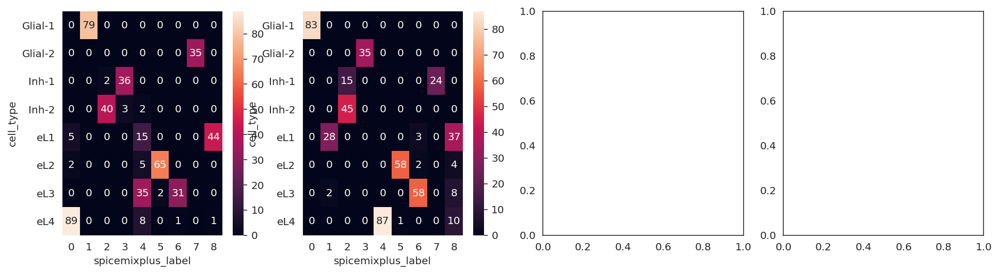

sil 0.5865084


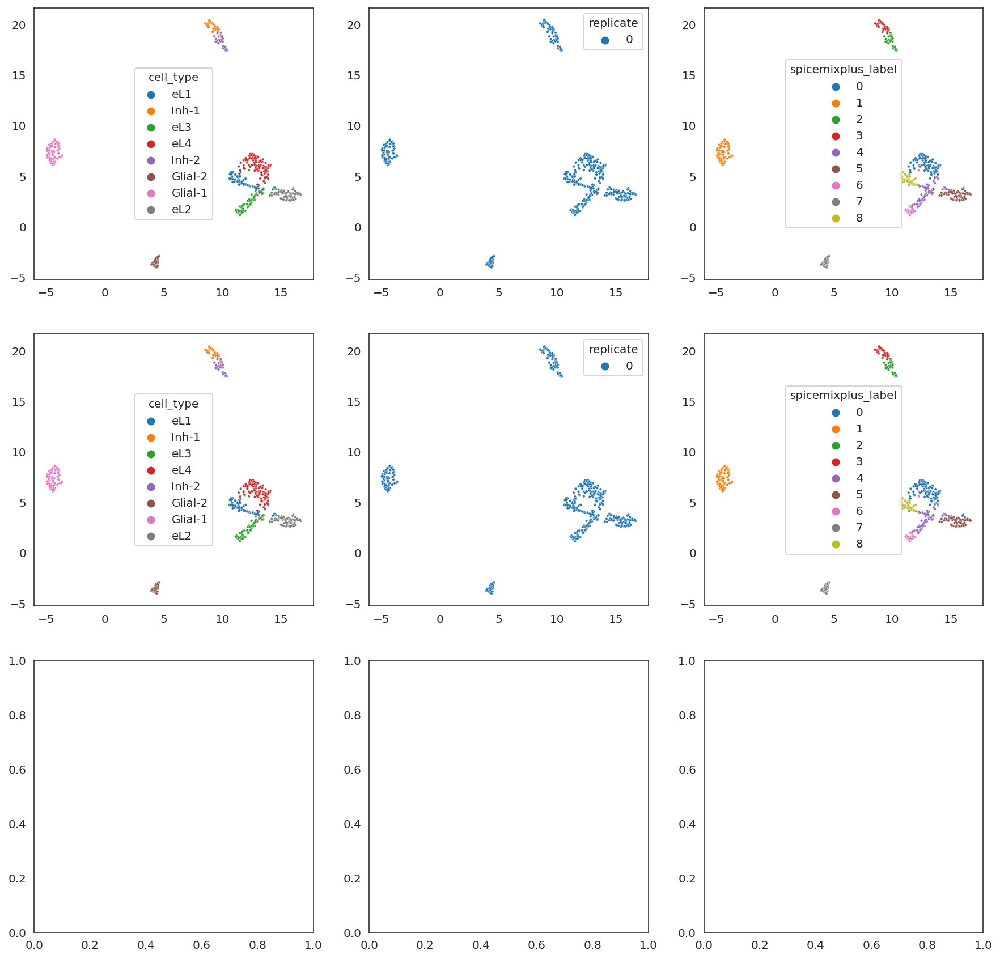

sil 0.6264209


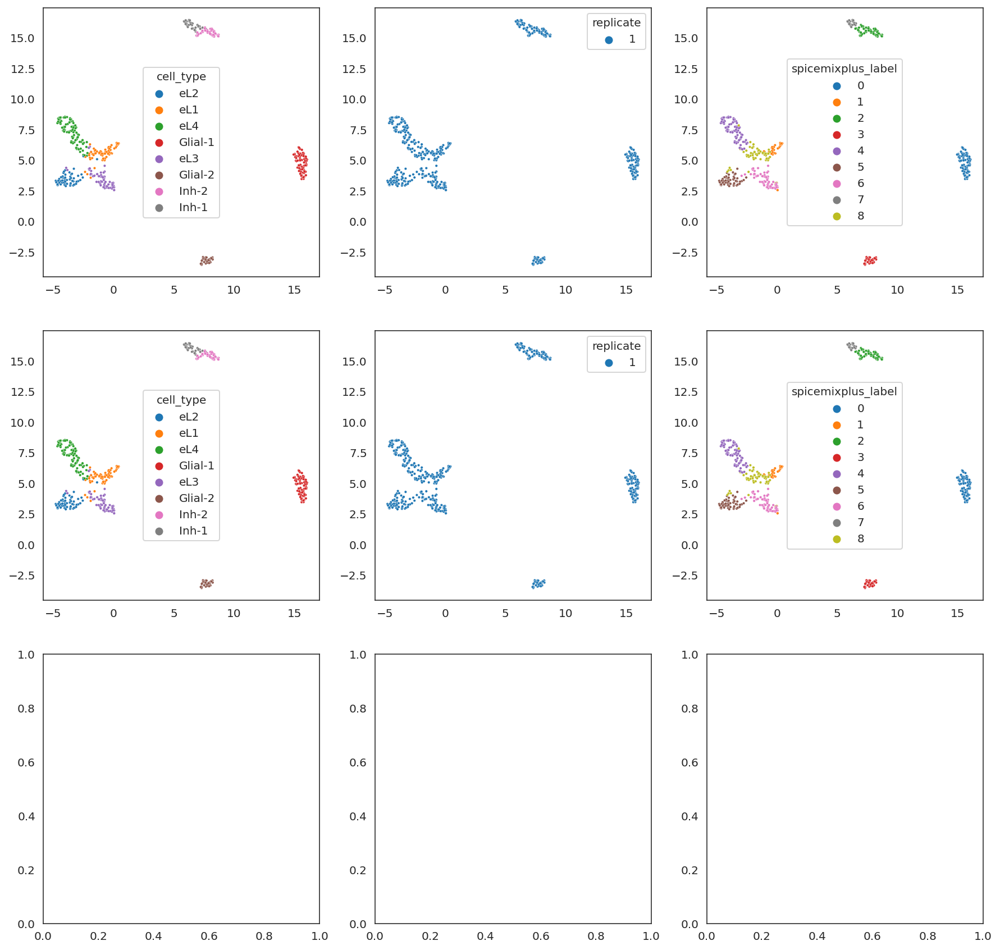

Done


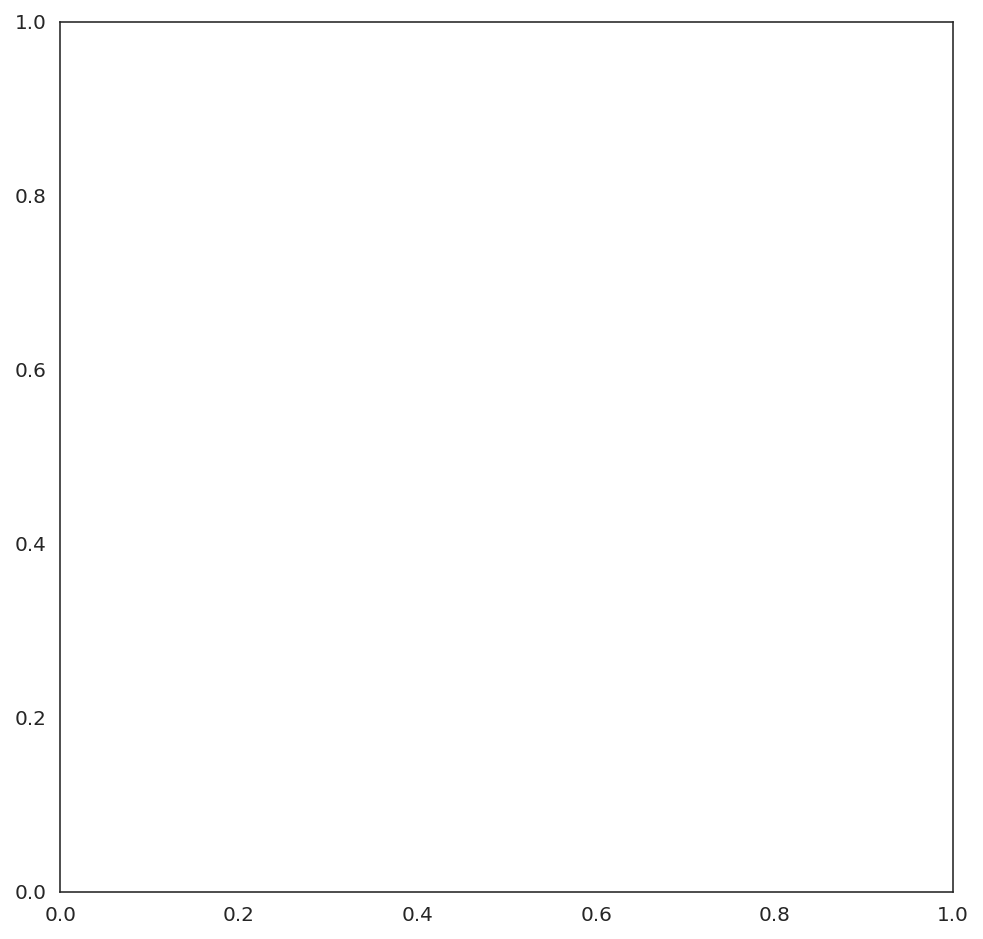

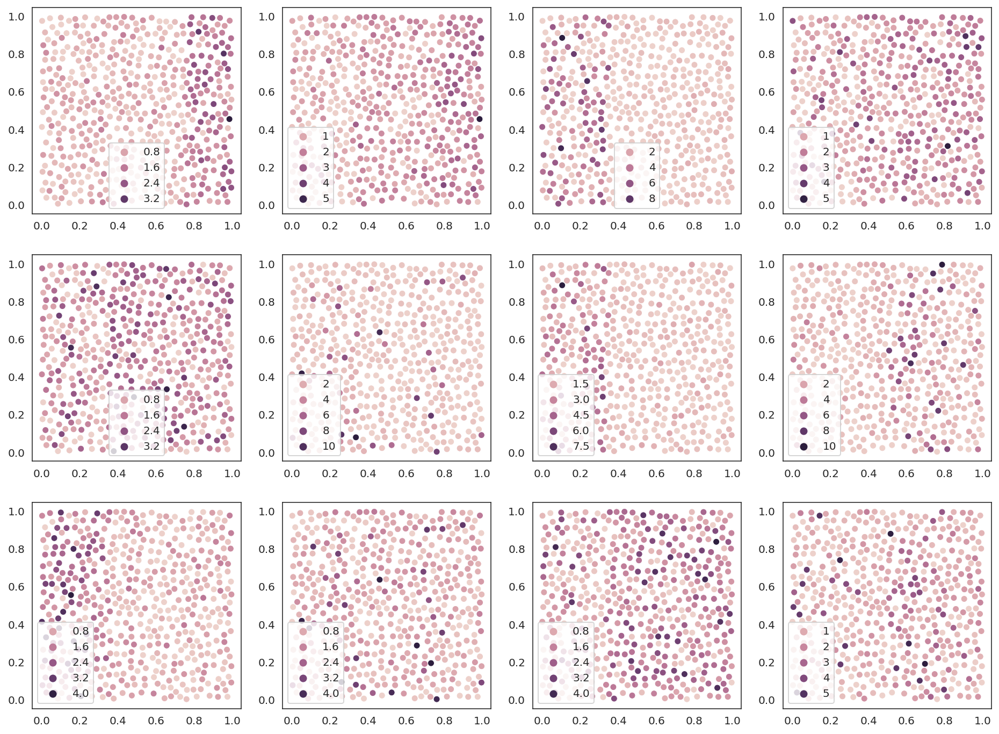

In [13]:
# NMF differential 50 iterations
obj = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    metagene_mode="differential",
    lambda_M=1,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
    random_state=2
)
obj.load_dataset(path2dataset)
# obj.meta['cell type'] = obj.meta['cell type'].astype('category')
obj.initialize(
    method='kmeans',
#     method='svd',
#    random_state=2,
)
# print(obj.sigma_yxs)
# obj.sigma_yxs[:] = 1e-2
# for prior_x in obj.prior_xs: prior_x[0][:] = 0
# evaluate(obj)
for iiter in trange(50):
    obj.estimate_weights(iiter=iiter, use_spatial=[False]*obj.num_repli, backend_algorithm="gd")
    obj.estimate_parameters(iiter=iiter, use_spatial=[False]*obj.num_repli)
    
evaluate(obj)

/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/model.py:138: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset = ad.AnnData(raw_dataframe)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.261362939233047e-08
M NAG Loss: 21088.5625
M NAG Loss: 20957.3125
M NAG Loss: 20899.875
M NAG Loss: 20865.4375
M NAG Loss: 20843.8125
M NAG Loss: 20830.125
M NAG Loss: 20822.0625
M NAG Loss: 20817.4375
M NAG Loss: 20815.0625
M NAG Loss: 20813.5625
M NAG Loss: 20812.625
M NAG Loss: 20811.6875
M NAG Loss: 20810.6875
M NAG Loss: 20809.5625
M NAG Loss: 20808.3125
M NAG Loss: 20807.1875
M NAG Loss: 20806.125
M NAG Loss: 20805.125
M NAG Loss: 20804.1875
M NAG Loss: 20803.5
M NAG Loss: 20802.8125
M NAG Loss: 20802.0
M NAG Loss: 20801.4375
M NAG Loss: 20800.9375
M NAG Loss: 20800.4375
M NAG Loss: 20800.0
M NAG Loss: 20799.6875
M NAG Loss: 20799.4375
M NAG Loss: 20799.1875
M NAG Loss: 20799.0
M NAG Loss: 20798.875
M NAG Loss: 20798.75
M NAG Loss: 20798.6875
M NAG Loss: 20798.5625
M NAG Loss: 20798.625
M NAG Loss: 20798.6875
M NAG Loss: 20798.6875
M NAG Loss: 20798.6875
M NAG Loss: 20798.625
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.045419369708049e-08
M NAG Loss: 24268.375
M NAG Loss: 24106.75
M NAG Loss: 24011.375
M NAG Loss: 23944.75
M NAG Loss: 23901.125
M NAG Loss: 23875.0
M NAG Loss: 23861.0
M NAG Loss: 23854.5
M NAG Loss: 23852.0
M NAG Loss: 23850.875
M NAG Loss: 23849.625
M NAG Loss: 23848.375
M NAG Loss: 23846.75
M NAG Loss: 23845.125
M NAG Loss: 23843.375
M NAG Loss: 23842.125
M NAG Loss: 23840.625
M NAG Loss: 23839.375
M NAG Loss: 23838.375
M NAG Loss: 23837.375
M NAG Loss: 23836.375
M NAG Loss: 23835.625
M NAG Loss: 23834.5
M NAG Loss: 23834.0
M NAG Loss: 23833.375
M NAG Loss: 23832.75
M NAG Loss: 23832.375
M NAG Loss: 23832.125
M NAG Loss: 23831.75
M NAG Loss: 23831.375
M NAG Loss: 23831.25
M NAG Loss: 23831.125
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23831.0
M NAG Loss: 23831.0
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.444854405682163e-08
M NAG Loss: 24292.5
M NAG Loss: 24183.375
M NAG Loss: 24130.75
M NAG Loss: 24096.125
M NAG Loss: 24072.75
M NAG Loss: 24058.25
M NAG Loss: 24048.625
M NAG Loss: 24043.125
M NAG Loss: 24039.125
M NAG Loss: 24035.875
M NAG Loss: 24032.625
M NAG Loss: 24030.0
M NAG Loss: 24027.625
M NAG Loss: 24025.375
M NAG Loss: 24023.125
M NAG Loss: 24021.125
M NAG Loss: 24018.875
M NAG Loss: 24016.875
M NAG Loss: 24014.875
M NAG Loss: 24013.125
M NAG Loss: 24011.375
M NAG Loss: 24010.125
M NAG Loss: 24008.625
M NAG Loss: 24007.5
M NAG Loss: 24006.625
M NAG Loss: 24006.125
M NAG Loss: 24005.125
M NAG Loss: 24004.75
M NAG Loss: 24003.875
M NAG Loss: 24003.75
M NAG Loss: 24003.375
M NAG Loss: 24003.125
M NAG Loss: 24003.0
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.375
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.75
M NAG Loss: 24002.625
M NAG Loss: 24002.875
M NAG Loss: 24002.875
M NAG Loss: 24002.75
M NAG Loss: 24002.875
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.942399136688253e-08
M NAG Loss: 24370.375
M NAG Loss: 24238.25
M NAG Loss: 24155.5
M NAG Loss: 24093.75
M NAG Loss: 24049.25
M NAG Loss: 24018.875
M NAG Loss: 23999.75
M NAG Loss: 23988.5
M NAG Loss: 23983.0
M NAG Loss: 23979.5
M NAG Loss: 23977.625
M NAG Loss: 23976.0
M NAG Loss: 23974.25
M NAG Loss: 23972.0
M NAG Loss: 23969.75
M NAG Loss: 23967.375
M NAG Loss: 23965.125
M NAG Loss: 23963.25
M NAG Loss: 23961.625
M NAG Loss: 23960.125
M NAG Loss: 23958.5
M NAG Loss: 23957.0
M NAG Loss: 23956.125
M NAG Loss: 23954.875
M NAG Loss: 23954.25
M NAG Loss: 23953.125
M NAG Loss: 23952.25
M NAG Loss: 23951.75
M NAG Loss: 23951.125
M NAG Loss: 23950.75
M NAG Loss: 23950.75
M NAG Loss: 23950.0
M NAG Loss: 23949.875
M NAG Loss: 23949.75
M NAG Loss: 23949.75
M NAG Loss: 23949.5
M NAG Loss: 23949.5
M NAG Loss: 23949.625
M NAG Loss: 23949.625
M NAG Loss: 23949.75
M NAG Loss: 23949.5
M NAG Loss: 23949.5
M NAG Loss: 23949.625
M NAG Loss: 23949.625
M NAG Loss: 23949.875
M NAG Loss: 23949.75
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.412548896486904e-08
M NAG Loss: 24031.375
M NAG Loss: 23887.125
M NAG Loss: 23808.75
M NAG Loss: 23753.875
M NAG Loss: 23716.375
M NAG Loss: 23691.625
M NAG Loss: 23676.375
M NAG Loss: 23667.125
M NAG Loss: 23661.625
M NAG Loss: 23657.875
M NAG Loss: 23655.5
M NAG Loss: 23653.0
M NAG Loss: 23650.625
M NAG Loss: 23648.375
M NAG Loss: 23646.25
M NAG Loss: 23644.125
M NAG Loss: 23641.875
M NAG Loss: 23639.75
M NAG Loss: 23638.125
M NAG Loss: 23636.375
M NAG Loss: 23634.5
M NAG Loss: 23633.125
M NAG Loss: 23631.875
M NAG Loss: 23630.625
M NAG Loss: 23629.875
M NAG Loss: 23628.875
M NAG Loss: 23628.0
M NAG Loss: 23627.625
M NAG Loss: 23627.125
M NAG Loss: 23626.625
M NAG Loss: 23626.25
M NAG Loss: 23626.0
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG Loss: 23625.625
M NAG Loss: 23625.625
M NAG Loss: 23625.625
M NAG Loss: 23625.75
M NAG Loss: 23626.0
M NAG Loss: 23626.0
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG Loss: 23626.125
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.514426262101687e-08
M NAG Loss: 24427.375
M NAG Loss: 24334.0
M NAG Loss: 24289.5
M NAG Loss: 24257.25
M NAG Loss: 24232.75
M NAG Loss: 24213.875
M NAG Loss: 24199.375
M NAG Loss: 24188.25
M NAG Loss: 24180.25
M NAG Loss: 24174.25
M NAG Loss: 24169.875
M NAG Loss: 24166.875
M NAG Loss: 24164.75
M NAG Loss: 24162.75
M NAG Loss: 24161.25
M NAG Loss: 24160.0
M NAG Loss: 24158.5
M NAG Loss: 24156.75
M NAG Loss: 24155.125
M NAG Loss: 24153.75
M NAG Loss: 24152.25
M NAG Loss: 24151.25
M NAG Loss: 24150.25
M NAG Loss: 24149.25
M NAG Loss: 24148.25
M NAG Loss: 24147.875
M NAG Loss: 24147.375
M NAG Loss: 24146.75
M NAG Loss: 24146.25
M NAG Loss: 24146.0
M NAG Loss: 24146.0
M NAG Loss: 24145.625
M NAG Loss: 24145.375
M NAG Loss: 24145.625
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.375
M NAG Loss: 24145.75
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.875
M NAG Loss: 24145.75
M NAG Loss: 24145.75
M NAG Loss: 24146.0
M NAG Loss: 24145.75
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.647881526241914e-08
M NAG Loss: 24596.375
M NAG Loss: 24526.5
M NAG Loss: 24494.625
M NAG Loss: 24471.625
M NAG Loss: 24453.375
M NAG Loss: 24438.0
M NAG Loss: 24425.25
M NAG Loss: 24414.875
M NAG Loss: 24406.25
M NAG Loss: 24399.75
M NAG Loss: 24395.0
M NAG Loss: 24391.125
M NAG Loss: 24388.625
M NAG Loss: 24387.125
M NAG Loss: 24385.875
M NAG Loss: 24385.125
M NAG Loss: 24384.625
M NAG Loss: 24384.0
M NAG Loss: 24383.625
M NAG Loss: 24382.875
M NAG Loss: 24382.625
M NAG Loss: 24381.875
M NAG Loss: 24381.625
M NAG Loss: 24380.75
M NAG Loss: 24380.75
M NAG Loss: 24380.25
M NAG Loss: 24380.125
M NAG Loss: 24379.75
M NAG Loss: 24379.625
M NAG Loss: 24379.375
M NAG Loss: 24379.125
M NAG Loss: 24379.25
M NAG Loss: 24378.875
M NAG Loss: 24379.25
M NAG Loss: 24378.875
M NAG Loss: 24379.125
M NAG Loss: 24378.875
M NAG Loss: 24379.125
M NAG Loss: 24379.125
M NAG Loss: 24379.375
M NAG Loss: 24379.25
M NAG Loss: 24379.25
M NAG Loss: 24379.375
M NAG Loss: 24379.375
M NAG Loss: 24379.25
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.769784016810727e-08
M NAG Loss: 24710.875
M NAG Loss: 24661.0
M NAG Loss: 24639.125
M NAG Loss: 24624.0
M NAG Loss: 24612.25
M NAG Loss: 24602.75
M NAG Loss: 24594.875
M NAG Loss: 24587.75
M NAG Loss: 24582.0
M NAG Loss: 24577.25
M NAG Loss: 24573.375
M NAG Loss: 24570.5
M NAG Loss: 24567.875
M NAG Loss: 24566.25
M NAG Loss: 24565.375
M NAG Loss: 24564.5
M NAG Loss: 24564.0
M NAG Loss: 24564.0
M NAG Loss: 24564.0
M NAG Loss: 24563.5
M NAG Loss: 24563.75
M NAG Loss: 24563.5
M NAG Loss: 24563.5
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.5
M NAG Loss: 24562.75
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.25
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.5
M NAG Loss: 24562.625
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.883876845240398e-08
M NAG Loss: 24775.75
M NAG Loss: 24736.375
M NAG Loss: 24718.5
M NAG Loss: 24706.5
M NAG Loss: 24697.75
M NAG Loss: 24690.625
M NAG Loss: 24684.875
M NAG Loss: 24679.75
M NAG Loss: 24675.375
M NAG Loss: 24671.5
M NAG Loss: 24668.625
M NAG Loss: 24666.0
M NAG Loss: 24663.625
M NAG Loss: 24662.125
M NAG Loss: 24660.625
M NAG Loss: 24659.625
M NAG Loss: 24659.125
M NAG Loss: 24658.375
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24657.875
M NAG Loss: 24657.875
M NAG Loss: 24657.875
M NAG Loss: 24657.75
M NAG Loss: 24657.625
M NAG Loss: 24657.75
M NAG Loss: 24657.625
M NAG Loss: 24657.5
M NAG Loss: 24657.5
M NAG Loss: 24657.25
M NAG Loss: 24657.375
M NAG Loss: 24657.5
M NAG Loss: 24657.625
M NAG Loss: 24657.375
M NAG Loss: 24657.25
M NAG Loss: 24657.375
M NAG Loss: 24657.125
M NAG Loss: 24657.375
M NAG Loss: 24657.375
M NAG Loss: 24657.625
M NAG Loss: 24657.375
M NAG Loss: 24657.625
M NAG Loss: 24657.625
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.97114878536795e-08
M NAG Loss: 24798.0
M NAG Loss: 24764.125
M NAG Loss: 24747.625
M NAG Loss: 24736.75
M NAG Loss: 24728.75
M NAG Loss: 24722.625
M NAG Loss: 24717.625
M NAG Loss: 24713.625
M NAG Loss: 24710.0
M NAG Loss: 24707.125
M NAG Loss: 24704.5
M NAG Loss: 24702.0
M NAG Loss: 24700.0
M NAG Loss: 24698.25
M NAG Loss: 24696.75
M NAG Loss: 24695.875
M NAG Loss: 24694.625
M NAG Loss: 24694.0
M NAG Loss: 24693.75
M NAG Loss: 24693.25
M NAG Loss: 24692.875
M NAG Loss: 24692.625
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.5
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.125
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.25
M NAG Loss: 24692.0
M NAG Loss: 24692.375
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.019570421944975e-08
M NAG Loss: 24811.75
M NAG Loss: 24781.5
M NAG Loss: 24765.75
M NAG Loss: 24755.625
M NAG Loss: 24748.0
M NAG Loss: 24742.125
M NAG Loss: 24737.75
M NAG Loss: 24734.0
M NAG Loss: 24731.0
M NAG Loss: 24728.25
M NAG Loss: 24725.875
M NAG Loss: 24724.125
M NAG Loss: 24722.25
M NAG Loss: 24721.0
M NAG Loss: 24719.5
M NAG Loss: 24718.5
M NAG Loss: 24717.25
M NAG Loss: 24716.5
M NAG Loss: 24715.75
M NAG Loss: 24715.25
M NAG Loss: 24714.875
M NAG Loss: 24714.625
M NAG Loss: 24714.25
M NAG Loss: 24714.25
M NAG Loss: 24714.25
M NAG Loss: 24714.0
M NAG Loss: 24713.75
M NAG Loss: 24714.0
M NAG Loss: 24713.625
M NAG Loss: 24713.75
M NAG Loss: 24714.0
M NAG Loss: 24713.625
M NAG Loss: 24713.75
M NAG Loss: 24713.875
M NAG Loss: 24713.75
M NAG Loss: 24713.75
M NAG Loss: 24713.625
M NAG Loss: 24713.625
M NAG Loss: 24713.5
M NAG Loss: 24713.375
M NAG Loss: 24713.75
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.038194168293075e-08
M NAG Loss: 24824.5
M NAG Loss: 24796.375
M NAG Loss: 24781.125
M NAG Loss: 24771.125
M NAG Loss: 24763.75
M NAG Loss: 24757.875
M NAG Loss: 24753.5
M NAG Loss: 24749.625
M NAG Loss: 24746.625
M NAG Loss: 24743.75
M NAG Loss: 24741.5
M NAG Loss: 24739.75
M NAG Loss: 24738.0
M NAG Loss: 24736.375
M NAG Loss: 24735.5
M NAG Loss: 24734.5
M NAG Loss: 24733.375
M NAG Loss: 24732.75
M NAG Loss: 24732.0
M NAG Loss: 24731.375
M NAG Loss: 24730.625
M NAG Loss: 24730.25
M NAG Loss: 24730.0
M NAG Loss: 24729.875
M NAG Loss: 24729.5
M NAG Loss: 24729.375
M NAG Loss: 24729.125
M NAG Loss: 24729.375
M NAG Loss: 24729.0
M NAG Loss: 24729.25
M NAG Loss: 24729.0
M NAG Loss: 24729.125
M NAG Loss: 24729.0
M NAG Loss: 24728.75
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24728.75
M NAG Loss: 24729.0
M NAG Loss: 24729.25
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24729.125
M NAG Loss: 24728.75
M NAG Loss: 24728.875
M NAG Loss: 24729.0
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.034120690598714e-08
M NAG Loss: 24831.125
M NAG Loss: 24804.625
M NAG Loss: 24790.0
M NAG Loss: 24780.125
M NAG Loss: 24772.875
M NAG Loss: 24767.125
M NAG Loss: 24762.625
M NAG Loss: 24759.0
M NAG Loss: 24755.875
M NAG Loss: 24753.125
M NAG Loss: 24750.625
M NAG Loss: 24748.875
M NAG Loss: 24746.875
M NAG Loss: 24745.625
M NAG Loss: 24744.5
M NAG Loss: 24743.5
M NAG Loss: 24742.625
M NAG Loss: 24741.75
M NAG Loss: 24741.375
M NAG Loss: 24740.875
M NAG Loss: 24740.25
M NAG Loss: 24739.875
M NAG Loss: 24739.5
M NAG Loss: 24738.875
M NAG Loss: 24738.875
M NAG Loss: 24738.625
M NAG Loss: 24738.375
M NAG Loss: 24738.25
M NAG Loss: 24738.0
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.25
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.0
M NAG Loss: 24738.0
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.013381110355693e-08
M NAG Loss: 24835.0
M NAG Loss: 24810.0
M NAG Loss: 24795.5
M NAG Loss: 24785.25
M NAG Loss: 24778.125
M NAG Loss: 24772.5
M NAG Loss: 24768.0
M NAG Loss: 24764.375
M NAG Loss: 24760.875
M NAG Loss: 24758.25
M NAG Loss: 24755.75
M NAG Loss: 24753.625
M NAG Loss: 24751.875
M NAG Loss: 24750.0
M NAG Loss: 24748.75
M NAG Loss: 24747.875
M NAG Loss: 24746.75
M NAG Loss: 24746.0
M NAG Loss: 24745.375
M NAG Loss: 24744.625
M NAG Loss: 24744.25
M NAG Loss: 24744.0
M NAG Loss: 24743.375
M NAG Loss: 24743.5
M NAG Loss: 24742.75
M NAG Loss: 24742.625
M NAG Loss: 24742.375
M NAG Loss: 24742.5
M NAG Loss: 24742.125
M NAG Loss: 24742.0
M NAG Loss: 24741.75
M NAG Loss: 24741.75
M NAG Loss: 24741.875
M NAG Loss: 24741.875
M NAG Loss: 24741.75
M NAG Loss: 24741.75
M NAG Loss: 24741.5
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.875
M NAG Loss: 24741.625
M NAG Loss: 24741.75
M NAG Loss: 24741.625
M NAG Loss: 24741.875
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.980670244865158e-08
M NAG Loss: 24839.375
M NAG Loss: 24816.125
M NAG Loss: 24801.75
M NAG Loss: 24792.125
M NAG Loss: 24784.625
M NAG Loss: 24779.125
M NAG Loss: 24775.0
M NAG Loss: 24771.625
M NAG Loss: 24768.125
M NAG Loss: 24765.375
M NAG Loss: 24763.375
M NAG Loss: 24761.125
M NAG Loss: 24759.125
M NAG Loss: 24757.375
M NAG Loss: 24755.875
M NAG Loss: 24754.375
M NAG Loss: 24753.375
M NAG Loss: 24752.375
M NAG Loss: 24751.5
M NAG Loss: 24750.875
M NAG Loss: 24750.125
M NAG Loss: 24749.875
M NAG Loss: 24749.25
M NAG Loss: 24749.125
M NAG Loss: 24748.75
M NAG Loss: 24748.25
M NAG Loss: 24748.125
M NAG Loss: 24748.0
M NAG Loss: 24748.25
M NAG Loss: 24747.75
M NAG Loss: 24747.875
M NAG Loss: 24747.75
M NAG Loss: 24747.75
M NAG Loss: 24747.625
M NAG Loss: 24747.75
M NAG Loss: 24747.5
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.25
M NAG Loss: 24747.375
M NAG Loss: 24747.625
M NAG Loss: 24747.375
M NAG Loss: 24747.625
M NAG 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.940584226453496e-08
M NAG Loss: 24849.0
M NAG Loss: 24827.5
M NAG Loss: 24814.0
M NAG Loss: 24804.625
M NAG Loss: 24797.875
M NAG Loss: 24792.5
M NAG Loss: 24788.75
M NAG Loss: 24785.5
M NAG Loss: 24783.0
M NAG Loss: 24780.5
M NAG Loss: 24778.625
M NAG Loss: 24776.75
M NAG Loss: 24775.25
M NAG Loss: 24773.75
M NAG Loss: 24772.25
M NAG Loss: 24771.25
M NAG Loss: 24769.875
M NAG Loss: 24768.875
M NAG Loss: 24767.875
M NAG Loss: 24767.375
M NAG Loss: 24766.5
M NAG Loss: 24766.0
M NAG Loss: 24765.625
M NAG Loss: 24765.0
M NAG Loss: 24764.75
M NAG Loss: 24764.5
M NAG Loss: 24764.5
M NAG Loss: 24764.25
M NAG Loss: 24763.625
M NAG Loss: 24764.0
M NAG Loss: 24763.5
M NAG Loss: 24763.625
M NAG Loss: 24763.625
M NAG Loss: 24763.75
M NAG Loss: 24763.5
M NAG Loss: 24763.75
M NAG Loss: 24763.75
M NAG Loss: 24763.125
M NAG Loss: 24763.375
M NAG Loss: 24763.25
M NAG Loss: 24763.375
M NAG Loss: 24763.5
M NAG Loss: 24763.125
M NAG Loss: 24763.25
M NAG Loss: 24763.375
M NAG Loss: 24763.5
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.897989360265291e-08
M NAG Loss: 24861.5
M NAG Loss: 24841.375
M NAG Loss: 24828.875
M NAG Loss: 24820.25
M NAG Loss: 24814.0
M NAG Loss: 24809.0
M NAG Loss: 24805.5
M NAG Loss: 24803.0
M NAG Loss: 24800.5
M NAG Loss: 24798.25
M NAG Loss: 24796.75
M NAG Loss: 24795.25
M NAG Loss: 24794.25
M NAG Loss: 24793.0
M NAG Loss: 24791.875
M NAG Loss: 24790.75
M NAG Loss: 24790.0
M NAG Loss: 24789.25
M NAG Loss: 24788.625
M NAG Loss: 24787.75
M NAG Loss: 24787.0
M NAG Loss: 24786.5
M NAG Loss: 24785.75
M NAG Loss: 24785.5
M NAG Loss: 24785.25
M NAG Loss: 24784.75
M NAG Loss: 24784.75
M NAG Loss: 24784.5
M NAG Loss: 24784.0
M NAG Loss: 24784.0
M NAG Loss: 24784.125
M NAG Loss: 24783.75
M NAG Loss: 24783.75
M NAG Loss: 24783.75
M NAG Loss: 24783.75
M NAG Loss: 24783.5
M NAG Loss: 24783.75
M NAG Loss: 24783.25
M NAG Loss: 24783.5
M NAG Loss: 24783.75
M NAG Loss: 24783.625
M NAG Loss: 24783.5
M NAG Loss: 24783.75
M NAG Loss: 24783.5
M NAG Loss: 24783.75
M NAG Loss: 24783.5
M NAG Loss: 24783.75
M NA

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.855262243258433e-08
M NAG Loss: 24871.875
M NAG Loss: 24852.875
M NAG Loss: 24840.75
M NAG Loss: 24831.75
M NAG Loss: 24825.5
M NAG Loss: 24821.0
M NAG Loss: 24817.5
M NAG Loss: 24815.0
M NAG Loss: 24813.0
M NAG Loss: 24811.25
M NAG Loss: 24809.875
M NAG Loss: 24808.75
M NAG Loss: 24807.625
M NAG Loss: 24806.875
M NAG Loss: 24806.0
M NAG Loss: 24805.375
M NAG Loss: 24804.375
M NAG Loss: 24803.875
M NAG Loss: 24803.5
M NAG Loss: 24802.75
M NAG Loss: 24802.5
M NAG Loss: 24801.75
M NAG Loss: 24801.75
M NAG Loss: 24801.25
M NAG Loss: 24800.875
M NAG Loss: 24800.5
M NAG Loss: 24800.375
M NAG Loss: 24799.875
M NAG Loss: 24799.875
M NAG Loss: 24799.875
M NAG Loss: 24799.625
M NAG Loss: 24799.5
M NAG Loss: 24799.25
M NAG Loss: 24799.25
M NAG Loss: 24799.375
M NAG Loss: 24799.25
M NAG Loss: 24799.25
M NAG Loss: 24799.25
M NAG Loss: 24799.0
M NAG Loss: 24799.25
M NAG Loss: 24799.25
M NAG Loss: 24799.25
M NAG Loss: 24799.125
M NAG Loss: 24799.25
M NAG Loss: 24799.375
M NAG Loss: 24799.0
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.812580792950341e-08
M NAG Loss: 24880.125
M NAG Loss: 24862.375
M NAG Loss: 24850.375
M NAG Loss: 24841.625
M NAG Loss: 24834.875
M NAG Loss: 24829.875
M NAG Loss: 24826.375
M NAG Loss: 24823.75
M NAG Loss: 24821.625
M NAG Loss: 24820.25
M NAG Loss: 24818.875
M NAG Loss: 24818.125
M NAG Loss: 24817.375
M NAG Loss: 24816.625
M NAG Loss: 24816.125
M NAG Loss: 24815.375
M NAG Loss: 24815.0
M NAG Loss: 24814.375
M NAG Loss: 24814.25
M NAG Loss: 24813.875
M NAG Loss: 24813.5
M NAG Loss: 24813.25
M NAG Loss: 24812.875
M NAG Loss: 24812.625
M NAG Loss: 24812.25
M NAG Loss: 24812.125
M NAG Loss: 24811.875
M NAG Loss: 24811.625
M NAG Loss: 24811.625
M NAG Loss: 24811.5
M NAG Loss: 24811.25
M NAG Loss: 24811.25
M NAG Loss: 24811.125
M NAG Loss: 24811.125
M NAG Loss: 24810.875
M NAG Loss: 24810.875
M NAG Loss: 24810.875
M NAG Loss: 24811.0
M NAG Loss: 24810.625
M NAG Loss: 24810.875
M NAG Loss: 24810.75
M NAG Loss: 24810.75
M NAG Loss: 24810.75
M NAG Loss: 24810.625
M NAG Loss: 24810.75
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.770174510726258e-08
M NAG Loss: 24889.0
M NAG Loss: 24871.375
M NAG Loss: 24859.375
M NAG Loss: 24849.875
M NAG Loss: 24842.875
M NAG Loss: 24837.375
M NAG Loss: 24833.0
M NAG Loss: 24830.125
M NAG Loss: 24827.625
M NAG Loss: 24826.125
M NAG Loss: 24824.875
M NAG Loss: 24824.0
M NAG Loss: 24823.125
M NAG Loss: 24822.5
M NAG Loss: 24821.875
M NAG Loss: 24821.375
M NAG Loss: 24821.0
M NAG Loss: 24820.875
M NAG Loss: 24820.5
M NAG Loss: 24820.125
M NAG Loss: 24819.875
M NAG Loss: 24819.5
M NAG Loss: 24819.25
M NAG Loss: 24819.125
M NAG Loss: 24818.75
M NAG Loss: 24818.5
M NAG Loss: 24818.25
M NAG Loss: 24818.125
M NAG Loss: 24818.125
M NAG Loss: 24817.875
M NAG Loss: 24818.0
M NAG Loss: 24817.75
M NAG Loss: 24817.625
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.125
M NAG Loss: 24817.25
M NAG Loss: 24817.125
M NAG Loss: 24817.375
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.727883227629318e-08
M NAG Loss: 24897.75
M NAG Loss: 24880.75
M NAG Loss: 24868.875
M NAG Loss: 24859.375
M NAG Loss: 24851.625
M NAG Loss: 24845.375
M NAG Loss: 24840.625
M NAG Loss: 24836.625
M NAG Loss: 24833.625
M NAG Loss: 24831.375
M NAG Loss: 24829.875
M NAG Loss: 24828.375
M NAG Loss: 24827.625
M NAG Loss: 24826.875
M NAG Loss: 24826.375
M NAG Loss: 24825.875
M NAG Loss: 24825.375
M NAG Loss: 24825.25
M NAG Loss: 24824.875
M NAG Loss: 24824.75
M NAG Loss: 24824.5
M NAG Loss: 24824.125
M NAG Loss: 24823.875
M NAG Loss: 24823.625
M NAG Loss: 24823.375
M NAG Loss: 24823.125
M NAG Loss: 24823.25
M NAG Loss: 24822.875
M NAG Loss: 24822.875
M NAG Loss: 24822.75
M NAG Loss: 24822.625
M NAG Loss: 24822.5
M NAG Loss: 24822.625
M NAG Loss: 24822.375
M NAG Loss: 24822.375
M NAG Loss: 24822.25
M NAG Loss: 24822.375
M NAG Loss: 24822.125
M NAG Loss: 24822.375
M NAG Loss: 24822.25
M NAG Loss: 24822.125
M NAG Loss: 24822.125
M NAG Loss: 24821.875
M NAG Loss: 24822.125
M NAG Loss: 24822.125


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.686618645154655e-08
M NAG Loss: 24908.125
M NAG Loss: 24892.25
M NAG Loss: 24881.5
M NAG Loss: 24872.5
M NAG Loss: 24865.0
M NAG Loss: 24858.5
M NAG Loss: 24852.875
M NAG Loss: 24848.125
M NAG Loss: 24844.25
M NAG Loss: 24841.5
M NAG Loss: 24839.0
M NAG Loss: 24837.25
M NAG Loss: 24835.875
M NAG Loss: 24834.5
M NAG Loss: 24833.875
M NAG Loss: 24833.25
M NAG Loss: 24832.875
M NAG Loss: 24832.5
M NAG Loss: 24832.0
M NAG Loss: 24832.0
M NAG Loss: 24831.75
M NAG Loss: 24831.5
M NAG Loss: 24831.5
M NAG Loss: 24831.375
M NAG Loss: 24831.0
M NAG Loss: 24831.125
M NAG Loss: 24830.75
M NAG Loss: 24830.5
M NAG Loss: 24830.5
M NAG Loss: 24830.125
M NAG Loss: 24830.125
M NAG Loss: 24830.125
M NAG Loss: 24830.25
M NAG Loss: 24830.125
M NAG Loss: 24830.0
M NAG Loss: 24830.0
M NAG Loss: 24830.0
M NAG Loss: 24830.0
M NAG Loss: 24830.0
M NAG Loss: 24829.875
M NAG Loss: 24829.75
M NAG Loss: 24829.75
M NAG Loss: 24829.625
M NAG Loss: 24829.75
M NAG Loss: 24829.625
M NAG Loss: 24829.625
M NAG Loss: 2482

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.647756016717777e-08
M NAG Loss: 24917.625
M NAG Loss: 24903.5
M NAG Loss: 24894.125
M NAG Loss: 24886.5
M NAG Loss: 24879.5
M NAG Loss: 24873.125
M NAG Loss: 24867.5
M NAG Loss: 24862.5
M NAG Loss: 24858.375
M NAG Loss: 24854.875
M NAG Loss: 24851.875
M NAG Loss: 24849.75
M NAG Loss: 24847.5
M NAG Loss: 24846.0
M NAG Loss: 24844.875
M NAG Loss: 24843.875
M NAG Loss: 24843.0
M NAG Loss: 24842.375
M NAG Loss: 24842.125
M NAG Loss: 24841.5
M NAG Loss: 24841.5
M NAG Loss: 24841.375
M NAG Loss: 24841.125
M NAG Loss: 24841.125
M NAG Loss: 24840.875
M NAG Loss: 24841.0
M NAG Loss: 24840.75
M NAG Loss: 24840.5
M NAG Loss: 24840.5
M NAG Loss: 24840.5
M NAG Loss: 24840.125
M NAG Loss: 24840.0
M NAG Loss: 24840.25
M NAG Loss: 24840.0
M NAG Loss: 24839.875
M NAG Loss: 24840.0
M NAG Loss: 24839.75
M NAG Loss: 24839.75
M NAG Loss: 24839.75
M NAG Loss: 24839.5
M NAG Loss: 24839.75
M NAG Loss: 24839.75
M NAG Loss: 24839.5
M NAG Loss: 24839.5
M NAG Loss: 24839.75
M NAG Loss: 24839.5
M NAG Loss: 24839

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.611961938373341e-08
M NAG Loss: 24926.375
M NAG Loss: 24914.5
M NAG Loss: 24906.5
M NAG Loss: 24900.125
M NAG Loss: 24894.125
M NAG Loss: 24889.125
M NAG Loss: 24884.0
M NAG Loss: 24879.75
M NAG Loss: 24875.5
M NAG Loss: 24872.125
M NAG Loss: 24869.0
M NAG Loss: 24866.25
M NAG Loss: 24864.25
M NAG Loss: 24862.5
M NAG Loss: 24860.5
M NAG Loss: 24859.5
M NAG Loss: 24858.125
M NAG Loss: 24857.375
M NAG Loss: 24856.75
M NAG Loss: 24856.25
M NAG Loss: 24855.5
M NAG Loss: 24855.25
M NAG Loss: 24855.0
M NAG Loss: 24855.25
M NAG Loss: 24855.0
M NAG Loss: 24854.625
M NAG Loss: 24854.75
M NAG Loss: 24854.625
M NAG Loss: 24854.625
M NAG Loss: 24854.375
M NAG Loss: 24854.375
M NAG Loss: 24854.5
M NAG Loss: 24854.25
M NAG Loss: 24854.375
M NAG Loss: 24854.25
M NAG Loss: 24854.125
M NAG Loss: 24854.125
M NAG Loss: 24854.125
M NAG Loss: 24854.0
M NAG Loss: 24853.875
M NAG Loss: 24853.875
M NAG Loss: 24853.75
M NAG Loss: 24853.75
M NAG Loss: 24853.625
M NAG Loss: 24853.875
M NAG Loss: 24853.875
M NA

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.580221853495835e-08
M NAG Loss: 24936.25
M NAG Loss: 24926.25
M NAG Loss: 24920.25
M NAG Loss: 24915.25
M NAG Loss: 24910.5
M NAG Loss: 24906.75
M NAG Loss: 24902.625
M NAG Loss: 24899.25
M NAG Loss: 24896.0
M NAG Loss: 24893.0
M NAG Loss: 24889.875
M NAG Loss: 24887.75
M NAG Loss: 24885.75
M NAG Loss: 24883.75
M NAG Loss: 24882.5
M NAG Loss: 24880.875
M NAG Loss: 24879.75
M NAG Loss: 24878.75
M NAG Loss: 24878.0
M NAG Loss: 24877.375
M NAG Loss: 24876.75
M NAG Loss: 24876.0
M NAG Loss: 24875.625
M NAG Loss: 24875.5
M NAG Loss: 24875.375
M NAG Loss: 24875.125
M NAG Loss: 24874.875
M NAG Loss: 24874.625
M NAG Loss: 24874.75
M NAG Loss: 24874.5
M NAG Loss: 24874.625
M NAG Loss: 24874.5
M NAG Loss: 24874.5
M NAG Loss: 24874.5
M NAG Loss: 24874.5
M NAG Loss: 24874.625
M NAG Loss: 24874.5
M NAG Loss: 24874.5
M NAG Loss: 24874.25
M NAG Loss: 24874.5
M NAG Loss: 24874.25
M NAG Loss: 24874.0
M NAG Loss: 24874.25
M NAG Loss: 24874.25
M NAG Loss: 24874.25
M NAG Loss: 24874.0
M NAG Loss: 24874.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.553767105332145e-08
M NAG Loss: 24947.375
M NAG Loss: 24939.625
M NAG Loss: 24935.125
M NAG Loss: 24931.375
M NAG Loss: 24927.875
M NAG Loss: 24924.875
M NAG Loss: 24922.125
M NAG Loss: 24919.125
M NAG Loss: 24916.375
M NAG Loss: 24914.125
M NAG Loss: 24912.125
M NAG Loss: 24910.125
M NAG Loss: 24908.375
M NAG Loss: 24906.5
M NAG Loss: 24905.375
M NAG Loss: 24904.0
M NAG Loss: 24903.0
M NAG Loss: 24902.0
M NAG Loss: 24901.375
M NAG Loss: 24900.5
M NAG Loss: 24899.875
M NAG Loss: 24899.375
M NAG Loss: 24899.125
M NAG Loss: 24898.625
M NAG Loss: 24898.125
M NAG Loss: 24898.0
M NAG Loss: 24897.625
M NAG Loss: 24897.5
M NAG Loss: 24897.375
M NAG Loss: 24897.625
M NAG Loss: 24897.625
M NAG Loss: 24897.125
M NAG Loss: 24897.375
M NAG Loss: 24897.375
M NAG Loss: 24897.375
M NAG Loss: 24897.375
M NAG Loss: 24897.375
M NAG Loss: 24897.125
M NAG Loss: 24897.0
M NAG Loss: 24897.125
M NAG Loss: 24896.875
M NAG Loss: 24897.125
M NAG Loss: 24897.375
M NAG Loss: 24897.125
M NAG Loss: 24897.125
M NA

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.533439384121417e-08
M NAG Loss: 24958.25
M NAG Loss: 24952.25
M NAG Loss: 24948.625
M NAG Loss: 24946.0
M NAG Loss: 24943.375
M NAG Loss: 24941.25
M NAG Loss: 24939.25
M NAG Loss: 24937.25
M NAG Loss: 24935.25
M NAG Loss: 24933.375
M NAG Loss: 24931.5
M NAG Loss: 24930.25
M NAG Loss: 24928.875
M NAG Loss: 24927.375
M NAG Loss: 24926.25
M NAG Loss: 24925.5
M NAG Loss: 24924.5
M NAG Loss: 24923.5
M NAG Loss: 24923.125
M NAG Loss: 24922.5
M NAG Loss: 24921.75
M NAG Loss: 24921.375
M NAG Loss: 24920.875
M NAG Loss: 24920.75
M NAG Loss: 24920.25
M NAG Loss: 24920.0
M NAG Loss: 24919.5
M NAG Loss: 24919.25
M NAG Loss: 24919.25
M NAG Loss: 24919.25
M NAG Loss: 24919.25
M NAG Loss: 24919.25
M NAG Loss: 24918.875
M NAG Loss: 24918.75
M NAG Loss: 24918.75
M NAG Loss: 24918.75
M NAG Loss: 24918.75
M NAG Loss: 24918.75
M NAG Loss: 24918.875
M NAG Loss: 24918.875
M NAG Loss: 24918.75
M NAG Loss: 24918.75
M NAG Loss: 24919.0
M NAG Loss: 24918.875
M NAG Loss: 24919.0
M NAG Loss: 24918.75
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.518922672408882e-08
M NAG Loss: 24966.25
M NAG Loss: 24962.0
M NAG Loss: 24958.625
M NAG Loss: 24956.375
M NAG Loss: 24954.625
M NAG Loss: 24953.0
M NAG Loss: 24951.5
M NAG Loss: 24949.875
M NAG Loss: 24948.5
M NAG Loss: 24947.25
M NAG Loss: 24945.75
M NAG Loss: 24944.5
M NAG Loss: 24943.625
M NAG Loss: 24942.75
M NAG Loss: 24941.5
M NAG Loss: 24940.625
M NAG Loss: 24940.0
M NAG Loss: 24939.25
M NAG Loss: 24938.75
M NAG Loss: 24938.25
M NAG Loss: 24937.75
M NAG Loss: 24937.5
M NAG Loss: 24936.875
M NAG Loss: 24936.75
M NAG Loss: 24936.25
M NAG Loss: 24936.0
M NAG Loss: 24935.875
M NAG Loss: 24935.75
M NAG Loss: 24935.5
M NAG Loss: 24935.5
M NAG Loss: 24935.25
M NAG Loss: 24935.375
M NAG Loss: 24935.25
M NAG Loss: 24935.0
M NAG Loss: 24935.25
M NAG Loss: 24934.875
M NAG Loss: 24934.875
M NAG Loss: 24935.0
M NAG Loss: 24934.875
M NAG Loss: 24935.125
M NAG Loss: 24935.0
M NAG Loss: 24934.75
M NAG Loss: 24935.0
M NAG Loss: 24934.75
M NAG Loss: 24934.75
M NAG Loss: 24935.0
M NAG Loss: 249

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.508397199150315e-08
M NAG Loss: 24972.625
M NAG Loss: 24968.625
M NAG Loss: 24966.625
M NAG Loss: 24964.875
M NAG Loss: 24962.875
M NAG Loss: 24961.875
M NAG Loss: 24960.875
M NAG Loss: 24959.375
M NAG Loss: 24958.375
M NAG Loss: 24957.375
M NAG Loss: 24956.375
M NAG Loss: 24955.5
M NAG Loss: 24954.5
M NAG Loss: 24953.75
M NAG Loss: 24953.0
M NAG Loss: 24952.375
M NAG Loss: 24951.625
M NAG Loss: 24951.125
M NAG Loss: 24950.75
M NAG Loss: 24950.25
M NAG Loss: 24949.875
M NAG Loss: 24949.375
M NAG Loss: 24949.375
M NAG Loss: 24948.75
M NAG Loss: 24948.375
M NAG Loss: 24948.375
M NAG Loss: 24948.25
M NAG Loss: 24948.0
M NAG Loss: 24947.875
M NAG Loss: 24947.875
M NAG Loss: 24947.625
M NAG Loss: 24947.375
M NAG Loss: 24947.375
M NAG Loss: 24947.375
M NAG Loss: 24947.5
M NAG Loss: 24947.375
M NAG Loss: 24947.25
M NAG Loss: 24947.25
M NAG Loss: 24946.875
M NAG Loss: 24947.125
M NAG Loss: 24947.25
M NAG Loss: 24947.125
M NAG Loss: 24947.25
M NAG Loss: 24947.0
M NAG Loss: 24947.375
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.500685107203448e-08
M NAG Loss: 24977.625
M NAG Loss: 24974.375
M NAG Loss: 24972.375
M NAG Loss: 24971.0
M NAG Loss: 24969.75
M NAG Loss: 24968.75
M NAG Loss: 24967.75
M NAG Loss: 24966.375
M NAG Loss: 24965.75
M NAG Loss: 24965.125
M NAG Loss: 24964.0
M NAG Loss: 24963.375
M NAG Loss: 24962.875
M NAG Loss: 24962.0
M NAG Loss: 24961.375
M NAG Loss: 24960.75
M NAG Loss: 24960.125
M NAG Loss: 24960.0
M NAG Loss: 24959.375
M NAG Loss: 24958.875
M NAG Loss: 24958.375
M NAG Loss: 24958.375
M NAG Loss: 24958.125
M NAG Loss: 24957.75
M NAG Loss: 24957.5
M NAG Loss: 24957.625
M NAG Loss: 24957.125
M NAG Loss: 24956.875
M NAG Loss: 24956.625
M NAG Loss: 24956.625
M NAG Loss: 24956.625
M NAG Loss: 24956.5
M NAG Loss: 24956.5
M NAG Loss: 24956.375
M NAG Loss: 24956.125
M NAG Loss: 24956.25
M NAG Loss: 24956.125
M NAG Loss: 24956.125
M NAG Loss: 24956.125
M NAG Loss: 24956.125
M NAG Loss: 24956.125
M NAG Loss: 24956.25
M NAG Loss: 24956.375
M NAG Loss: 24956.125
M NAG Loss: 24955.875
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.494861135971996e-08
M NAG Loss: 24980.75
M NAG Loss: 24978.0
M NAG Loss: 24976.25
M NAG Loss: 24975.0
M NAG Loss: 24974.25
M NAG Loss: 24973.0
M NAG Loss: 24972.375
M NAG Loss: 24971.5
M NAG Loss: 24970.75
M NAG Loss: 24970.25
M NAG Loss: 24969.25
M NAG Loss: 24968.75
M NAG Loss: 24968.25
M NAG Loss: 24967.5
M NAG Loss: 24967.25
M NAG Loss: 24966.625
M NAG Loss: 24966.0
M NAG Loss: 24965.75
M NAG Loss: 24965.5
M NAG Loss: 24965.125
M NAG Loss: 24964.5
M NAG Loss: 24964.25
M NAG Loss: 24964.125
M NAG Loss: 24963.875
M NAG Loss: 24963.75
M NAG Loss: 24963.75
M NAG Loss: 24963.5
M NAG Loss: 24963.5
M NAG Loss: 24963.25
M NAG Loss: 24963.25
M NAG Loss: 24962.875
M NAG Loss: 24962.75
M NAG Loss: 24962.875
M NAG Loss: 24962.75
M NAG Loss: 24962.75
M NAG Loss: 24963.0
M NAG Loss: 24962.875
M NAG Loss: 24962.375
M NAG Loss: 24962.75
M NAG Loss: 24962.625
M NAG Loss: 24962.75
M NAG Loss: 24962.75
M NAG Loss: 24962.625
M NAG Loss: 24962.5
M NAG Loss: 24962.75
M NAG Loss: 24962.625
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.490299274189832e-08
M NAG Loss: 24983.875
M NAG Loss: 24981.375
M NAG Loss: 24980.25
M NAG Loss: 24978.875
M NAG Loss: 24978.125
M NAG Loss: 24977.375
M NAG Loss: 24976.625
M NAG Loss: 24976.0
M NAG Loss: 24975.375
M NAG Loss: 24974.875
M NAG Loss: 24974.125
M NAG Loss: 24973.875
M NAG Loss: 24973.375
M NAG Loss: 24972.875
M NAG Loss: 24972.625
M NAG Loss: 24972.0
M NAG Loss: 24971.625
M NAG Loss: 24971.0
M NAG Loss: 24970.875
M NAG Loss: 24970.625
M NAG Loss: 24970.625
M NAG Loss: 24970.125
M NAG Loss: 24969.875
M NAG Loss: 24969.625
M NAG Loss: 24969.75
M NAG Loss: 24969.625
M NAG Loss: 24969.5
M NAG Loss: 24969.125
M NAG Loss: 24969.125
M NAG Loss: 24969.125
M NAG Loss: 24969.0
M NAG Loss: 24969.125
M NAG Loss: 24969.125
M NAG Loss: 24968.875
M NAG Loss: 24968.625
M NAG Loss: 24968.875
M NAG Loss: 24968.875
M NAG Loss: 24968.625
M NAG Loss: 24968.625
M NAG Loss: 24968.625
M NAG Loss: 24968.875
M NAG Loss: 24968.625
M NAG Loss: 24968.875
M NAG Loss: 24968.375
M NAG Loss: 24968.5
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.48695466929051e-08
M NAG Loss: 24986.0
M NAG Loss: 24984.0
M NAG Loss: 24982.75
M NAG Loss: 24981.625
M NAG Loss: 24981.125
M NAG Loss: 24980.375
M NAG Loss: 24979.875
M NAG Loss: 24979.375
M NAG Loss: 24978.75
M NAG Loss: 24978.25
M NAG Loss: 24977.75
M NAG Loss: 24977.25
M NAG Loss: 24977.0
M NAG Loss: 24976.875
M NAG Loss: 24976.25
M NAG Loss: 24976.0
M NAG Loss: 24975.375
M NAG Loss: 24975.25
M NAG Loss: 24975.0
M NAG Loss: 24974.625
M NAG Loss: 24974.5
M NAG Loss: 24974.125
M NAG Loss: 24974.0
M NAG Loss: 24973.75
M NAG Loss: 24973.75
M NAG Loss: 24973.625
M NAG Loss: 24973.5
M NAG Loss: 24973.5
M NAG Loss: 24973.25
M NAG Loss: 24973.25
M NAG Loss: 24973.5
M NAG Loss: 24973.25
M NAG Loss: 24973.375
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24972.75
M NAG Loss: 24973.0
M NAG Loss: 24973.0
M NAG Loss: 24972.625
M NAG Loss: 24972.75
M NAG Loss: 24972.75
M NAG Loss: 24972.625
M NAG Loss: 24972.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.484429134851355e-08
M NAG Loss: 24987.875
M NAG Loss: 24985.875
M NAG Loss: 24984.625
M NAG Loss: 24983.75
M NAG Loss: 24983.125
M NAG Loss: 24982.875
M NAG Loss: 24981.875
M NAG Loss: 24981.375
M NAG Loss: 24981.125
M NAG Loss: 24980.75
M NAG Loss: 24980.375
M NAG Loss: 24979.875
M NAG Loss: 24979.375
M NAG Loss: 24979.25
M NAG Loss: 24979.0
M NAG Loss: 24978.625
M NAG Loss: 24978.25
M NAG Loss: 24977.875
M NAG Loss: 24977.875
M NAG Loss: 24977.375
M NAG Loss: 24977.375
M NAG Loss: 24977.125
M NAG Loss: 24977.0
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 24976.625
M NAG Loss: 24976.375
M NAG Loss: 24976.375
M NAG Loss: 24976.375
M NAG Loss: 24976.125
M NAG Loss: 24976.375
M NAG Loss: 24976.0
M NAG Loss: 24975.875
M NAG Loss: 24975.875
M NAG Loss: 24975.625
M NAG Loss: 24976.125
M NAG Loss: 24976.0
M NAG Loss: 24975.875
M NAG Loss: 24975.875
M NAG Loss: 24975.875
M NAG Loss: 24975.875
M NAG Loss: 24975.625
M NAG Loss: 24975.75
M NAG Loss: 24975.875
M NAG Loss: 24975.875
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.482411467437745e-08
M NAG Loss: 24989.0
M NAG Loss: 24987.0
M NAG Loss: 24986.25
M NAG Loss: 24985.5
M NAG Loss: 24985.0
M NAG Loss: 24984.5
M NAG Loss: 24984.0
M NAG Loss: 24983.75
M NAG Loss: 24983.25
M NAG Loss: 24982.75
M NAG Loss: 24982.5
M NAG Loss: 24982.0
M NAG Loss: 24981.875
M NAG Loss: 24981.5
M NAG Loss: 24981.25
M NAG Loss: 24981.125
M NAG Loss: 24980.5
M NAG Loss: 24980.25
M NAG Loss: 24980.25
M NAG Loss: 24980.0
M NAG Loss: 24979.625
M NAG Loss: 24979.625
M NAG Loss: 24979.5
M NAG Loss: 24979.375
M NAG Loss: 24979.0
M NAG Loss: 24979.0
M NAG Loss: 24978.75
M NAG Loss: 24978.875
M NAG Loss: 24978.625
M NAG Loss: 24978.875
M NAG Loss: 24978.625
M NAG Loss: 24978.75
M NAG Loss: 24978.375
M NAG Loss: 24978.625
M NAG Loss: 24978.5
M NAG Loss: 24978.5
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.5
M NAG Loss: 24978.

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.480802437403874e-08
M NAG Loss: 24990.25
M NAG Loss: 24988.5
M NAG Loss: 24987.875
M NAG Loss: 24987.125
M NAG Loss: 24986.75
M NAG Loss: 24986.0
M NAG Loss: 24985.5
M NAG Loss: 24985.5
M NAG Loss: 24985.0
M NAG Loss: 24984.75
M NAG Loss: 24984.5
M NAG Loss: 24983.875
M NAG Loss: 24983.75
M NAG Loss: 24983.25
M NAG Loss: 24983.375
M NAG Loss: 24983.0
M NAG Loss: 24982.75
M NAG Loss: 24982.625
M NAG Loss: 24982.375
M NAG Loss: 24982.125
M NAG Loss: 24981.75
M NAG Loss: 24981.625
M NAG Loss: 24981.75
M NAG Loss: 24981.5
M NAG Loss: 24981.375
M NAG Loss: 24981.25
M NAG Loss: 24981.25
M NAG Loss: 24981.0
M NAG Loss: 24981.125
M NAG Loss: 24981.125
M NAG Loss: 24981.0
M NAG Loss: 24981.0
M NAG Loss: 24980.875
M NAG Loss: 24980.875
M NAG Loss: 24980.5
M NAG Loss: 24980.875
M NAG Loss: 24980.625
M NAG Loss: 24980.75
M NAG Loss: 24980.75
M NAG Loss: 24980.75
M NAG Loss: 24980.5
M NAG Loss: 24980.75
M NAG Loss: 24980.5
M NAG Loss: 24980.25
M NAG Loss: 24980.5
M NAG Loss: 24980.5
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.479577925477597e-08
M NAG Loss: 24991.0
M NAG Loss: 24989.75
M NAG Loss: 24988.875
M NAG Loss: 24988.375
M NAG Loss: 24987.75
M NAG Loss: 24987.625
M NAG Loss: 24987.25
M NAG Loss: 24987.0
M NAG Loss: 24986.625
M NAG Loss: 24986.375
M NAG Loss: 24986.125
M NAG Loss: 24985.875
M NAG Loss: 24985.5
M NAG Loss: 24985.25
M NAG Loss: 24985.0
M NAG Loss: 24984.625
M NAG Loss: 24984.375
M NAG Loss: 24984.125
M NAG Loss: 24984.375
M NAG Loss: 24983.875
M NAG Loss: 24983.75
M NAG Loss: 24983.5
M NAG Loss: 24983.375
M NAG Loss: 24983.375
M NAG Loss: 24983.125
M NAG Loss: 24983.25
M NAG Loss: 24983.125
M NAG Loss: 24982.875
M NAG Loss: 24982.875
M NAG Loss: 24982.875
M NAG Loss: 24982.75
M NAG Loss: 24982.875
M NAG Loss: 24982.625
M NAG Loss: 24982.5
M NAG Loss: 24982.625
M NAG Loss: 24982.625
M NAG Loss: 24982.625
M NAG Loss: 24982.625
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.75
M NAG Loss: 24982.625
M NAG Loss: 24982.375
M NAG Loss: 24982.5
M NAG Loss: 24982.625
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.478630883892569e-08
M NAG Loss: 24991.75
M NAG Loss: 24990.75
M NAG Loss: 24990.125
M NAG Loss: 24989.5
M NAG Loss: 24989.0
M NAG Loss: 24988.5
M NAG Loss: 24988.25
M NAG Loss: 24988.25
M NAG Loss: 24987.625
M NAG Loss: 24987.625
M NAG Loss: 24987.25
M NAG Loss: 24986.875
M NAG Loss: 24986.75
M NAG Loss: 24986.5
M NAG Loss: 24986.25
M NAG Loss: 24985.75
M NAG Loss: 24985.875
M NAG Loss: 24985.5
M NAG Loss: 24985.5
M NAG Loss: 24985.25
M NAG Loss: 24985.25
M NAG Loss: 24985.0
M NAG Loss: 24984.75
M NAG Loss: 24984.75
M NAG Loss: 24984.625
M NAG Loss: 24984.75
M NAG Loss: 24984.375
M NAG Loss: 24984.375
M NAG Loss: 24984.25
M NAG Loss: 24984.375
M NAG Loss: 24984.25
M NAG Loss: 24984.125
M NAG Loss: 24984.0
M NAG Loss: 24984.125
M NAG Loss: 24983.875
M NAG Loss: 24984.0
M NAG Loss: 24984.125
M NAG Loss: 24984.0
M NAG Loss: 24984.25
M NAG Loss: 24984.0
M NAG Loss: 24983.75
M NAG Loss: 24983.75
M NAG Loss: 24984.125
M NAG Loss: 24984.0
M NAG Loss: 24983.875
M NAG Loss: 24983.875
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.47790987387639e-08
M NAG Loss: 24992.5
M NAG Loss: 24991.5
M NAG Loss: 24990.75
M NAG Loss: 24990.25
M NAG Loss: 24989.875
M NAG Loss: 24989.375
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24988.625
M NAG Loss: 24988.5
M NAG Loss: 24988.25
M NAG Loss: 24987.875
M NAG Loss: 24987.75
M NAG Loss: 24987.5
M NAG Loss: 24987.375
M NAG Loss: 24987.25
M NAG Loss: 24987.125
M NAG Loss: 24986.875
M NAG Loss: 24986.625
M NAG Loss: 24986.5
M NAG Loss: 24986.5
M NAG Loss: 24986.25
M NAG Loss: 24986.0
M NAG Loss: 24986.0
M NAG Loss: 24985.875
M NAG Loss: 24986.0
M NAG Loss: 24985.875
M NAG Loss: 24986.0
M NAG Loss: 24985.875
M NAG Loss: 24985.75
M NAG Loss: 24985.25
M NAG Loss: 24985.5
M NAG Loss: 24985.5
M NAG Loss: 24985.375
M NAG Loss: 24985.75
M NAG Loss: 24985.375
M NAG Loss: 24985.25
M NAG Loss: 24985.5
M NAG Loss: 24985.5
M NAG Loss: 24985.25
M NAG Loss: 24985.25
M NAG Loss: 24985.25
M NAG Loss: 24985.375
M NAG Loss: 24985.25
M NAG Loss: 24985.375
M NAG Loss: 24985.375
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.477416422867508e-08
M NAG Loss: 24993.0
M NAG Loss: 24992.0
M NAG Loss: 24991.375
M NAG Loss: 24991.0
M NAG Loss: 24990.625
M NAG Loss: 24990.375
M NAG Loss: 24989.875
M NAG Loss: 24989.875
M NAG Loss: 24989.5
M NAG Loss: 24989.5
M NAG Loss: 24989.5
M NAG Loss: 24989.125
M NAG Loss: 24988.875
M NAG Loss: 24988.625
M NAG Loss: 24988.625
M NAG Loss: 24988.25
M NAG Loss: 24988.375
M NAG Loss: 24988.25
M NAG Loss: 24987.875
M NAG Loss: 24987.625
M NAG Loss: 24987.875
M NAG Loss: 24987.5
M NAG Loss: 24987.375
M NAG Loss: 24987.125
M NAG Loss: 24987.0
M NAG Loss: 24987.125
M NAG Loss: 24986.875
M NAG Loss: 24986.875
M NAG Loss: 24987.0
M NAG Loss: 24986.875
M NAG Loss: 24987.0
M NAG Loss: 24986.75
M NAG Loss: 24986.75
M NAG Loss: 24986.875
M NAG Loss: 24986.75
M NAG Loss: 24986.875
M NAG Loss: 24986.5
M NAG Loss: 24986.625
M NAG Loss: 24986.875
M NAG Loss: 24986.875
M NAG Loss: 24986.5
M NAG Loss: 24986.625
M NAG Loss: 24986.5
M NAG Loss: 24986.625
M NAG Loss: 24986.625
M NAG Loss: 24986.7

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.477110151807917e-08
M NAG Loss: 24993.75
M NAG Loss: 24993.0
M NAG Loss: 24992.375
M NAG Loss: 24991.75
M NAG Loss: 24991.5
M NAG Loss: 24991.375
M NAG Loss: 24991.125
M NAG Loss: 24991.0
M NAG Loss: 24990.5
M NAG Loss: 24990.5
M NAG Loss: 24990.5
M NAG Loss: 24990.25
M NAG Loss: 24990.0
M NAG Loss: 24989.75
M NAG Loss: 24989.5
M NAG Loss: 24989.5
M NAG Loss: 24989.125
M NAG Loss: 24988.875
M NAG Loss: 24988.875
M NAG Loss: 24988.875
M NAG Loss: 24988.75
M NAG Loss: 24988.75
M NAG Loss: 24988.625
M NAG Loss: 24988.5
M NAG Loss: 24988.25
M NAG Loss: 24988.25
M NAG Loss: 24988.25
M NAG Loss: 24988.25
M NAG Loss: 24988.25
M NAG Loss: 24988.0
M NAG Loss: 24988.125
M NAG Loss: 24988.0
M NAG Loss: 24987.875
M NAG Loss: 24988.0
M NAG Loss: 24988.125
M NAG Loss: 24988.0
M NAG Loss: 24988.0
M NAG Loss: 24988.125
M NAG Loss: 24987.875
M NAG Loss: 24988.0
M NAG Loss: 24988.0
M NAG Loss: 24988.0
M NAG Loss: 24987.75
M NAG Loss: 24987.875
M NAG Loss: 24987.875
M NAG Loss: 24988.0
M NAG Loss: 2498

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.47700527111643e-08
M NAG Loss: 24994.625
M NAG Loss: 24993.5
M NAG Loss: 24992.875
M NAG Loss: 24992.75
M NAG Loss: 24992.25
M NAG Loss: 24992.125
M NAG Loss: 24991.75
M NAG Loss: 24991.625
M NAG Loss: 24991.5
M NAG Loss: 24991.25
M NAG Loss: 24991.25
M NAG Loss: 24991.125
M NAG Loss: 24990.875
M NAG Loss: 24990.875
M NAG Loss: 24990.75
M NAG Loss: 24990.25
M NAG Loss: 24990.375
M NAG Loss: 24990.125
M NAG Loss: 24990.125
M NAG Loss: 24989.875
M NAG Loss: 24989.75
M NAG Loss: 24990.0
M NAG Loss: 24989.5
M NAG Loss: 24989.5
M NAG Loss: 24989.5
M NAG Loss: 24989.25
M NAG Loss: 24989.375
M NAG Loss: 24989.375
M NAG Loss: 24989.375
M NAG Loss: 24989.375
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.375
M NAG Loss: 24989.375
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.0
M NAG Loss: 24988.875
M NAG Loss: 24988.875
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 24989.125
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.477046383942728e-08
M NAG Loss: 24994.875
M NAG Loss: 24994.125
M NAG Loss: 24993.75
M NAG Loss: 24993.625
M NAG Loss: 24992.875
M NAG Loss: 24992.625
M NAG Loss: 24992.75
M NAG Loss: 24992.375
M NAG Loss: 24992.125
M NAG Loss: 24992.0
M NAG Loss: 24992.0
M NAG Loss: 24991.75
M NAG Loss: 24991.625
M NAG Loss: 24991.375
M NAG Loss: 24991.25
M NAG Loss: 24991.125
M NAG Loss: 24991.0
M NAG Loss: 24991.25
M NAG Loss: 24990.875
M NAG Loss: 24990.75
M NAG Loss: 24990.75
M NAG Loss: 24990.625
M NAG Loss: 24990.5
M NAG Loss: 24990.5
M NAG Loss: 24990.5
M NAG Loss: 24990.5
M NAG Loss: 24990.25
M NAG Loss: 24990.25
M NAG Loss: 24990.375
M NAG Loss: 24990.125
M NAG Loss: 24990.25
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.25
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.0
M NAG Loss: 24990.25
M NAG Loss: 24990.0
M NAG Loss: 24990.25
M NAG Loss: 24990

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.477246921332152e-08
M NAG Loss: 24995.25
M NAG Loss: 24994.625
M NAG Loss: 24994.25
M NAG Loss: 24993.875
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.25
M NAG Loss: 24993.125
M NAG Loss: 24992.875
M NAG Loss: 24992.875
M NAG Loss: 24992.625
M NAG Loss: 24992.375
M NAG Loss: 24992.375
M NAG Loss: 24992.125
M NAG Loss: 24992.125
M NAG Loss: 24991.875
M NAG Loss: 24992.0
M NAG Loss: 24991.875
M NAG Loss: 24991.625
M NAG Loss: 24991.75
M NAG Loss: 24991.25
M NAG Loss: 24991.625
M NAG Loss: 24991.375
M NAG Loss: 24991.375
M NAG Loss: 24991.375
M NAG Loss: 24991.5
M NAG Loss: 24991.375
M NAG Loss: 24991.5
M NAG Loss: 24991.25
M NAG Loss: 24991.375
M NAG Loss: 24991.125
M NAG Loss: 24991.125
M NAG Loss: 24991.125
M NAG Loss: 24991.125
M NAG Loss: 24991.0
M NAG Loss: 24991.125
M NAG Loss: 24991.0
M NAG Loss: 24990.875
M NAG Loss: 24991.0
M NAG Loss: 24991.0
M NAG Loss: 24991.0
M NAG Loss: 24990.875
M NAG Loss: 24991.125
M NAG Loss: 24990.875
M NAG Loss: 24991.0
M NAG Loss: 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.477601877779053e-08
M NAG Loss: 24995.875
M NAG Loss: 24995.375
M NAG Loss: 24994.75
M NAG Loss: 24994.75
M NAG Loss: 24994.25
M NAG Loss: 24994.0
M NAG Loss: 24993.875
M NAG Loss: 24993.75
M NAG Loss: 24993.625
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.125
M NAG Loss: 24993.125
M NAG Loss: 24993.125
M NAG Loss: 24992.625
M NAG Loss: 24992.625
M NAG Loss: 24992.875
M NAG Loss: 24992.625
M NAG Loss: 24992.625
M NAG Loss: 24992.5
M NAG Loss: 24992.375
M NAG Loss: 24992.125
M NAG Loss: 24992.125
M NAG Loss: 24992.125
M NAG Loss: 24992.125
M NAG Loss: 24992.125
M NAG Loss: 24992.25
M NAG Loss: 24992.0
M NAG Loss: 24992.125
M NAG Loss: 24992.25
M NAG Loss: 24992.0
M NAG Loss: 24992.0
M NAG Loss: 24991.875
M NAG Loss: 24992.0
M NAG Loss: 24991.875
M NAG Loss: 24991.875
M NAG Loss: 24992.0
M NAG Loss: 24992.0
M NAG Loss: 24991.625
M NAG Loss: 24991.875
M NAG Loss: 24991.875
M NAG Loss: 24991.75
M NAG Loss: 24992.0
M NAG Loss: 24991.875
M NAG Loss: 2

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.478040802069553e-08
M NAG Loss: 24996.25
M NAG Loss: 24995.75
M NAG Loss: 24995.25
M NAG Loss: 24995.0
M NAG Loss: 24994.75
M NAG Loss: 24994.625
M NAG Loss: 24994.5
M NAG Loss: 24994.5
M NAG Loss: 24994.0
M NAG Loss: 24994.125
M NAG Loss: 24994.0
M NAG Loss: 24994.125
M NAG Loss: 24994.0
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.375
M NAG Loss: 24993.5
M NAG Loss: 24993.375
M NAG Loss: 24993.5
M NAG Loss: 24993.375
M NAG Loss: 24993.0
M NAG Loss: 24993.0
M NAG Loss: 24993.0
M NAG Loss: 24993.0
M NAG Loss: 24992.875
M NAG Loss: 24992.875
M NAG Loss: 24992.75
M NAG Loss: 24993.0
M NAG Loss: 24992.75
M NAG Loss: 24992.875
M NAG Loss: 24992.5
M NAG Loss: 24993.0
M NAG Loss: 24992.625
M NAG Loss: 24992.625
M NAG Loss: 24992.5
M NAG Loss: 24992.875
M NAG Loss: 24992.5
M NAG Loss: 24992.75
M NAG Loss: 24992.875
M NAG Loss: 24992.75
M NAG Loss: 24992.75
M NAG Loss: 24992.75
M NAG Loss: 24992.875
M NAG Loss: 24992.5
M NAG Loss: 24992.75
M NAG Loss: 24992.625
M NAG Loss: 249

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.478509165470842e-08
M NAG Loss: 24996.375
M NAG Loss: 24995.875
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24995.125
M NAG Loss: 24994.875
M NAG Loss: 24994.75
M NAG Loss: 24994.875
M NAG Loss: 24994.625
M NAG Loss: 24994.5
M NAG Loss: 24994.0
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.0
M NAG Loss: 24993.875
M NAG Loss: 24993.875
M NAG Loss: 24993.625
M NAG Loss: 24993.75
M NAG Loss: 24993.5
M NAG Loss: 24993.625
M NAG Loss: 24993.5
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.375
M NAG Loss: 24993.25
M NAG Loss: 24993.375
M NAG Loss: 24992.875
M NAG Loss: 24993.25
M NAG Loss: 24993.125
M NAG Loss: 24993.0
M NAG Loss: 24993.125
M NAG Loss: 24993.125
M NAG Loss: 24993.25
M NAG Loss: 24993.125
M NAG Loss: 24993.0
M NAG Loss: 24993.125
M NAG Loss: 24993.125
M NAG Loss: 24993.25
M NAG Loss: 24993.0
M NAG Loss: 24993.25
M NAG Loss: 24993.125
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.479004462090373e-08
M NAG Loss: 24996.75
M NAG Loss: 24996.375
M NAG Loss: 24996.0
M NAG Loss: 24995.5
M NAG Loss: 24995.5
M NAG Loss: 24995.5
M NAG Loss: 24995.125
M NAG Loss: 24995.0
M NAG Loss: 24995.0
M NAG Loss: 24994.875
M NAG Loss: 24994.75
M NAG Loss: 24994.75
M NAG Loss: 24994.625
M NAG Loss: 24994.5
M NAG Loss: 24994.5
M NAG Loss: 24994.375
M NAG Loss: 24994.5
M NAG Loss: 24994.5
M NAG Loss: 24994.25
M NAG Loss: 24994.0
M NAG Loss: 24994.25
M NAG Loss: 24993.75
M NAG Loss: 24994.0
M NAG Loss: 24994.0
M NAG Loss: 24993.75
M NAG Loss: 24994.0
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.625
M NAG Loss: 24994.0
M NAG Loss: 24993.625
M NAG Loss: 24993.875
M NAG Loss: 24993.5
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.5
M NAG Loss: 24993.5
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24993.75
M NAG Loss: 24994.0
M NAG Loss: 24993.75
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.479515788376941e-08
M NAG Loss: 24996.875
M NAG Loss: 24996.375
M NAG Loss: 24996.125
M NAG Loss: 24996.25
M NAG Loss: 24995.75
M NAG Loss: 24995.625
M NAG Loss: 24995.625
M NAG Loss: 24995.25
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24995.0
M NAG Loss: 24994.875
M NAG Loss: 24995.125
M NAG Loss: 24994.75
M NAG Loss: 24994.75
M NAG Loss: 24994.5
M NAG Loss: 24994.625
M NAG Loss: 24994.625
M NAG Loss: 24994.75
M NAG Loss: 24994.625
M NAG Loss: 24994.375
M NAG Loss: 24994.625
M NAG Loss: 24994.125
M NAG Loss: 24994.5
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.5
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.125
M NAG Loss: 24994.375
M NAG Loss: 24994.0
M NAG Loss: 24994.125
M NAG Loss: 24994.375
M NAG Loss: 24994.125
M NAG Loss: 24994.0
M NAG Loss: 24994.0
M NAG Loss: 24994.125
M NAG Loss: 24994.0
M NAG Loss: 24994.0
M NAG Loss: 24994.0
M NAG Loss: 24994.0
M NAG Loss: 2499

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.480013758365212e-08
M NAG Loss: 24997.125
M NAG Loss: 24996.625
M NAG Loss: 24996.125
M NAG Loss: 24996.375
M NAG Loss: 24995.875
M NAG Loss: 24995.875
M NAG Loss: 24996.125
M NAG Loss: 24995.625
M NAG Loss: 24995.375
M NAG Loss: 24995.5
M NAG Loss: 24995.25
M NAG Loss: 24995.375
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24994.875
M NAG Loss: 24994.875
M NAG Loss: 24995.0
M NAG Loss: 24994.875
M NAG Loss: 24994.875
M NAG Loss: 24995.0
M NAG Loss: 24994.75
M NAG Loss: 24994.875
M NAG Loss: 24994.625
M NAG Loss: 24994.625
M NAG Loss: 24994.625
M NAG Loss: 24994.375
M NAG Loss: 24994.625
M NAG Loss: 24994.375
M NAG Loss: 24994.75
M NAG Loss: 24994.625
M NAG Loss: 24994.625
M NAG Loss: 24994.625
M NAG Loss: 24994.375
M NAG Loss: 24994.625
M NAG Loss: 24994.25
M NAG Loss: 24994.5
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.25
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.375
M NAG Loss: 24994.125
M

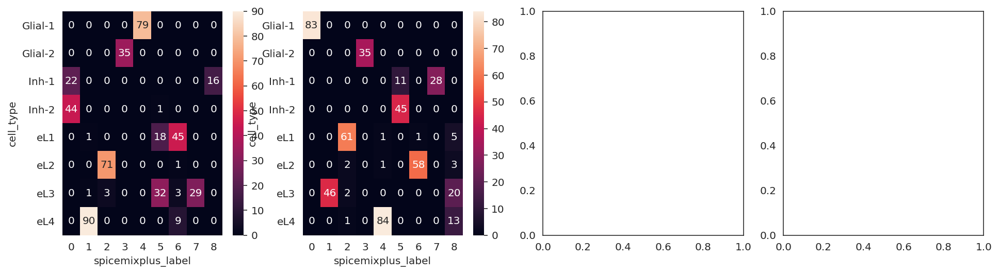

sil 0.61118865


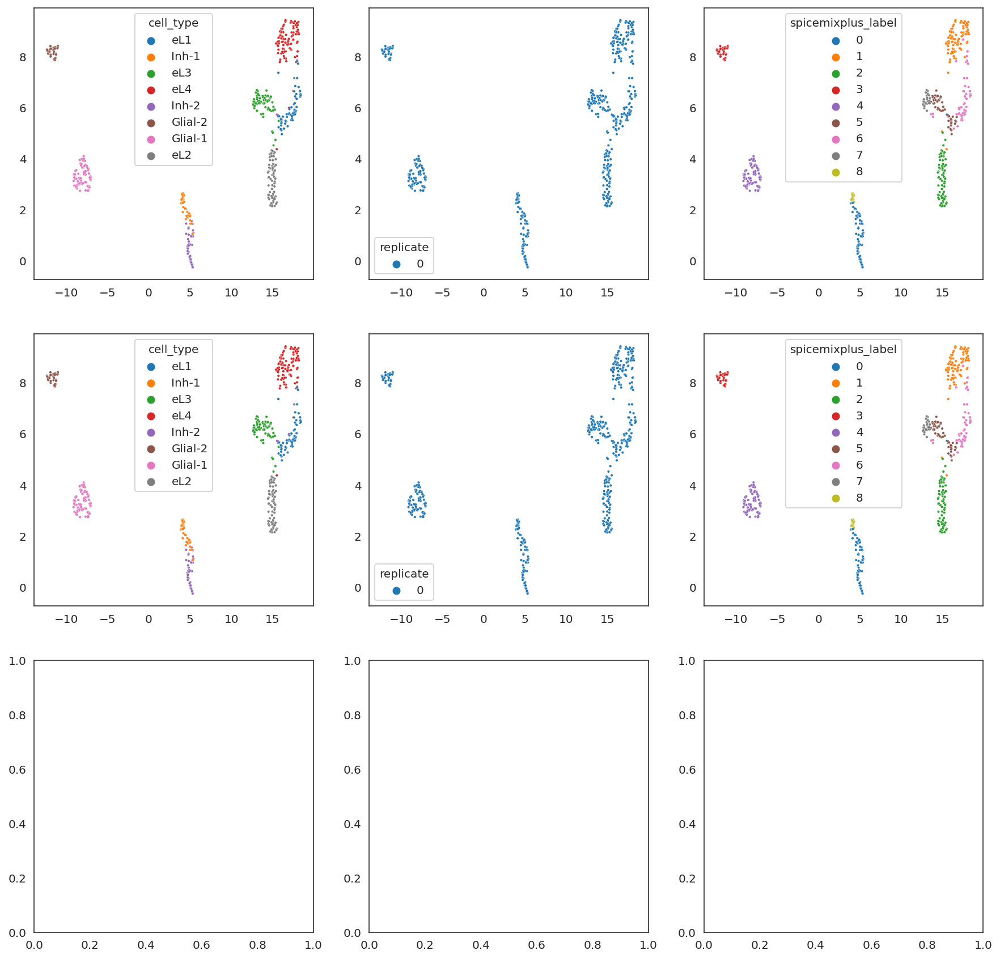

sil 0.64529365


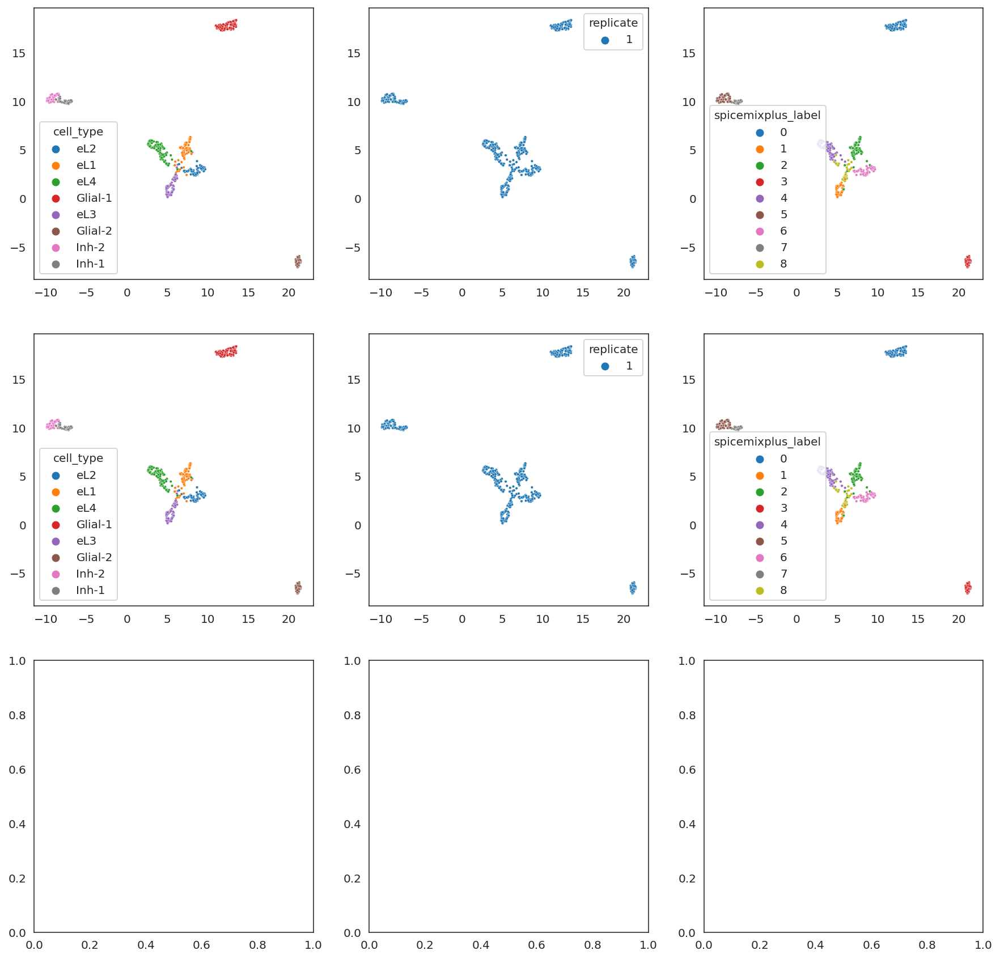

Done


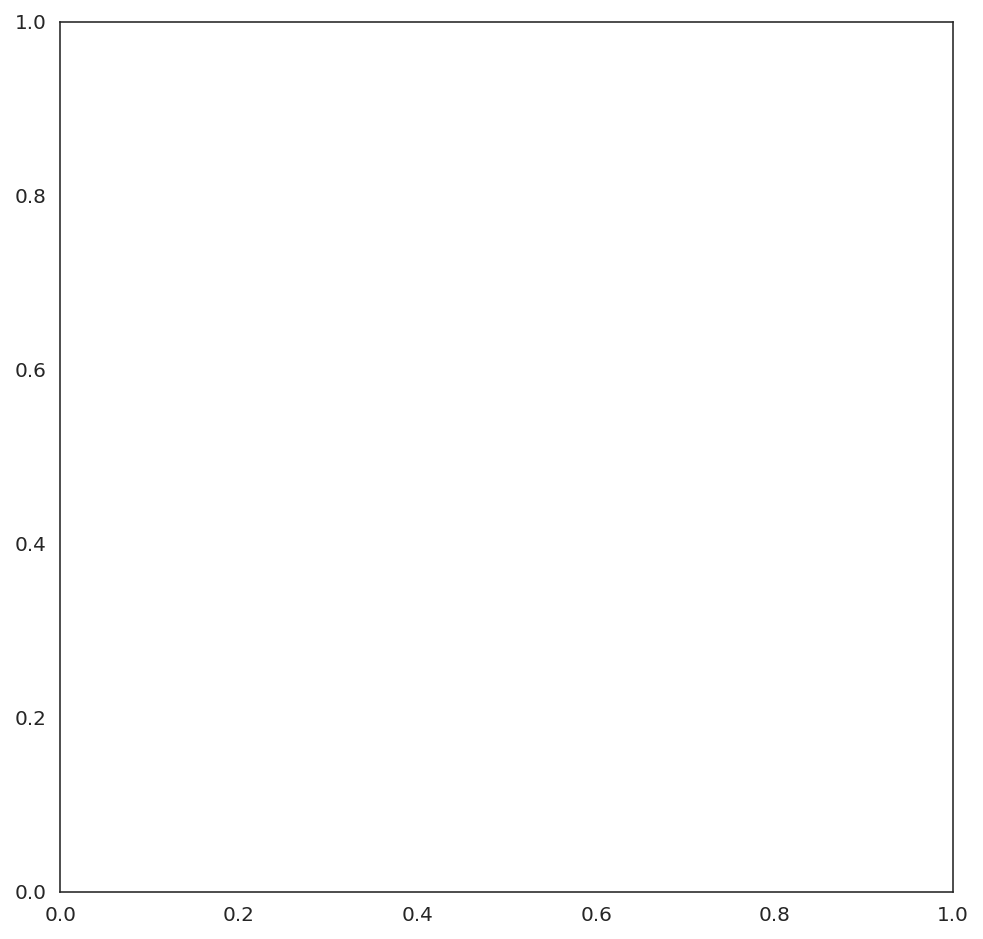

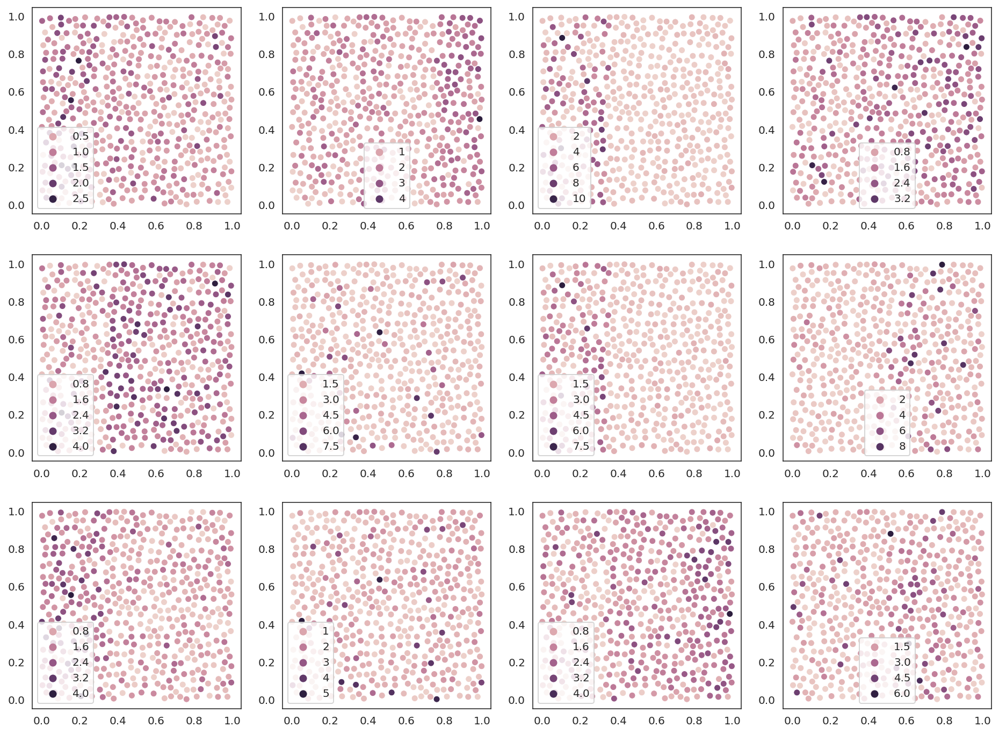

In [14]:
# NMF shared 50 iterations
obj = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    metagene_mode="shared",
    lambda_M=1,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
    random_state=2
)
obj.load_dataset(path2dataset)
# obj.meta['cell type'] = obj.meta['cell type'].astype('category')
obj.initialize(
    method='kmeans',
#     method='svd',
#    random_state=2,
)
# print(obj.sigma_yxs)
# obj.sigma_yxs[:] = 1e-2
# for prior_x in obj.prior_xs: prior_x[0][:] = 0
# evaluate(obj)
for iiter in trange(50):
    obj.estimate_weights(iiter=iiter, use_spatial=[False]*obj.num_repli, backend_algorithm="gd")
    obj.estimate_parameters(iiter=iiter, use_spatial=[False]*obj.num_repli)
    
evaluate(obj)

/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/model.py:138: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset = ad.AnnData(raw_dataframe)


  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

==== iteration 0 ====
1.0000e-01


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

150046.73600196838


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -9470.810546875
Function value: -7303.8583984375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -79554.7578125
Function value: -14247.66796875
==== iteration 1 ====
7.0000e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

148709.31208133698


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3230.51416015625
Function value: -1656.4169921875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -83511.6328125
Function value: -10776.212890625
==== iteration 2 ====
4.9000e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

103457.28695392609


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -20412.984375
Function value: -4456.42041015625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4966.12255859375
Function value: -71489.8984375
==== iteration 3 ====
3.4300e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

115572.2513794899


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -95803.140625
Function value: -8750.4306640625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1628.585205078125
Function value: -80181.2890625
==== iteration 4 ====
2.4010e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

82923.22605848312


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -17079.0078125
Function value: -5003.28955078125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -5151.04296875
Function value: -84552.53125
==== iteration 5 ====
1.6807e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

76998.53926897049


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1725.859130859375
Function value: -1487.02978515625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6763.08837890625
Function value: -2974.271728515625
==== iteration 6 ====
1.1765e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

65204.21802997589


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3827.281982421875
Function value: -116735.3515625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4350.111328125
Function value: -12329.9326171875
==== iteration 7 ====
8.2354e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

51572.50165939331


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -89564.5234375
Function value: -72878.265625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -14992.201171875
Function value: -5638.548828125
==== iteration 8 ====
5.7648e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

40834.14748311043


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8220.7197265625
Function value: -71709.078125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4201.400390625
Function value: -2721.119873046875
==== iteration 9 ====
4.0354e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

31772.322952747345


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -104302.75
Function value: -5987.6962890625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1478.990966796875
Function value: -5476.72314453125
==== iteration 10 ====
2.8248e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

18973.41012954712


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8577.00390625
Function value: -4440.595703125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3827.27685546875
Function value: -11079.1953125
==== iteration 11 ====
1.9773e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

10063.949972391129


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -10390.9853515625
Function value: -1983.7232666015625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -70484.640625
Function value: -4149.25634765625
==== iteration 12 ====
1.3841e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

9447.668679058552


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3788.13916015625
Function value: -4086.49951171875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1947.1766357421875
Function value: -5020.6884765625
==== iteration 13 ====
9.6889e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

3366.8633550405502


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -14999.2041015625
Function value: -3108.54541015625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -2645.99365234375
Function value: -92592.859375
==== iteration 14 ====
6.7822e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-415.0576132815331


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -81977.328125
Function value: -4356.74951171875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -10377.63671875
Function value: -54265.390625
==== iteration 15 ====
4.7476e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-3531.3682164996862


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -69241.484375
Function value: -5181.2451171875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -5461.6376953125
Function value: -4218.6396484375
==== iteration 16 ====
3.3233e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-6445.952225476503


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -7143.48681640625
Function value: -9002.697265625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -72943.9140625
Function value: -76585.9453125
==== iteration 17 ====
2.3263e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-10171.718895435333


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -66080.0234375
Function value: -4376.09912109375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6965.91796875
Function value: -17454.86328125
==== iteration 18 ====
1.6284e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-12430.714443325996


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -13529.474609375
Function value: -118792.15625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -10867.794921875
Function value: -7413.72802734375
==== iteration 19 ====
1.1399e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-14824.464917182922


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -96843.7578125
Function value: -97044.8125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6499.1689453125
Function value: -3135.422119140625
==== iteration 20 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-17511.246725916862


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -78066.703125
Function value: -16323.5078125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -16010.845703125
Function value: -4553.8955078125
==== iteration 21 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-17019.43576335907


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4413.375
Function value: -10762.0361328125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1902.4921875
Function value: -10420.1357421875
==== iteration 22 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-18697.1016228199


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6448.77490234375
Function value: -12660.5341796875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -66181.734375
Function value: -83533.859375
==== iteration 23 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-19007.714465260506


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3548.0810546875
Function value: -5653.8671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6856.82421875
Function value: -541.508056640625
==== iteration 24 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-19480.425864458084


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -2108.032470703125
Function value: -49824.83984375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -5396.8583984375
Function value: -94194.765625
==== iteration 25 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-20141.134038567543


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8803.048828125
Function value: -4748.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -65554.421875
Function value: -6858.28173828125
==== iteration 26 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-20688.649266958237


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -71097.2265625
Function value: -4798.513671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6995.234375
Function value: -89124.640625
==== iteration 27 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-20411.796867847443


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -64794.31640625
Function value: -1774.1573486328125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -7319.74951171875
Function value: -9010.76953125
==== iteration 28 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21115.051582455635


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -93803.8125
Function value: -13217.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3922.6279296875
Function value: -56099.62890625
==== iteration 29 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21216.578781604767


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8131.6298828125
Function value: -25894.6484375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -94048.09375
Function value: -8929.6728515625
==== iteration 30 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21168.22823882103


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -15670.2734375
Function value: -1920.07177734375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4760.9609375
Function value: -2858.9267578125
==== iteration 31 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21506.818011403084


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3356.331298828125
Function value: -1652.857666015625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -102573.8828125
Function value: -83135.2421875
==== iteration 32 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21745.260804891586


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1988.699951171875
Function value: -1898.74169921875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -973.129638671875
Function value: -7246.1708984375
==== iteration 33 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-21454.691886901855


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3524.68994140625
Function value: -4992.66162109375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3194.041015625
Function value: -9704.8427734375
==== iteration 34 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

-23120.393976569176


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -953.9517211914062
Function value: -3948.358154296875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6566.3564453125
Function value: -7574.14794921875
replicate 0hierarchical w/ K=6.ARI = 0.68
replicate 0hierarchical w/ K=7.ARI = 0.77
replicate 0hierarchical w/ K=8.ARI = 0.81
replicate 0hierarchical w/ K=9.ARI = 0.75
replicate 1hierarchical w/ K=6.ARI = 0.58
replicate 1hierarchical w/ K=7.ARI = 0.71
replicate 1hierarchical w/ K=8.ARI = 0.72
replicate 1hierarchical w/ K=9.ARI = 0.76


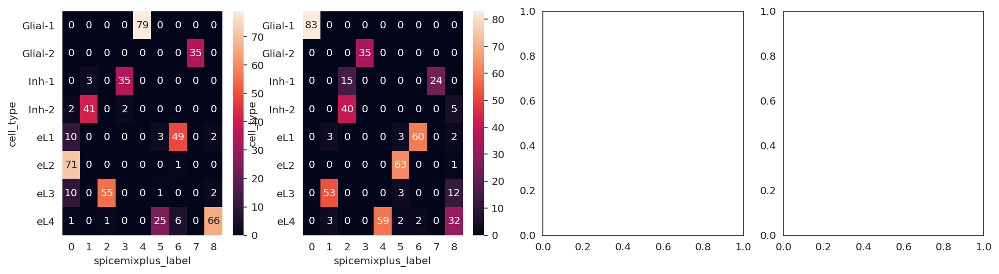

sil 0.5801007


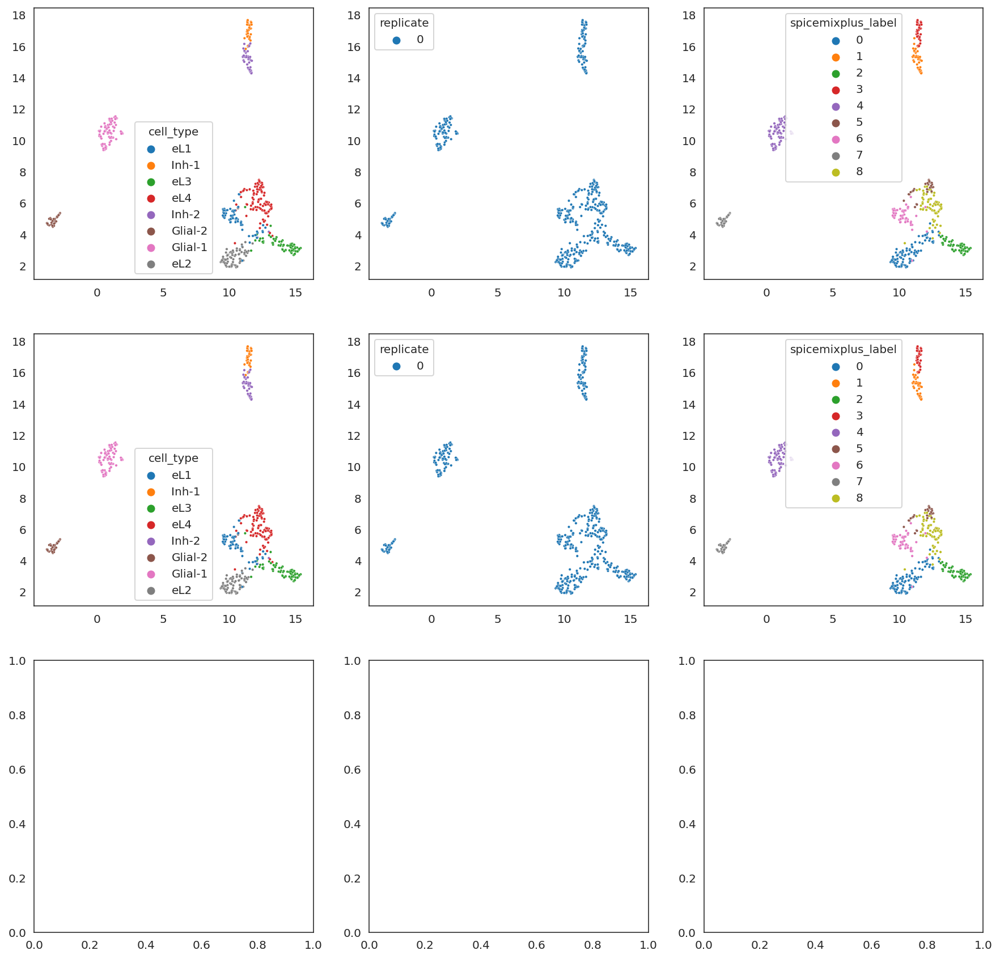

sil 0.61519223


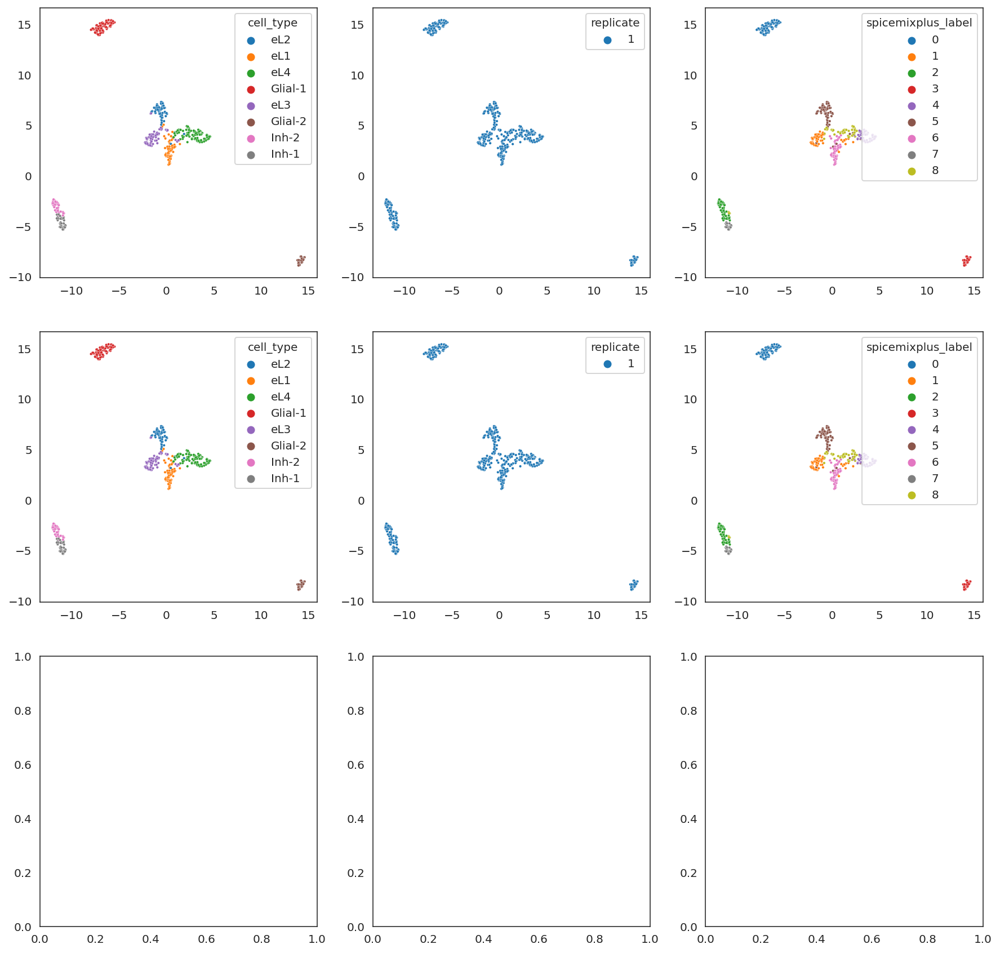

Done


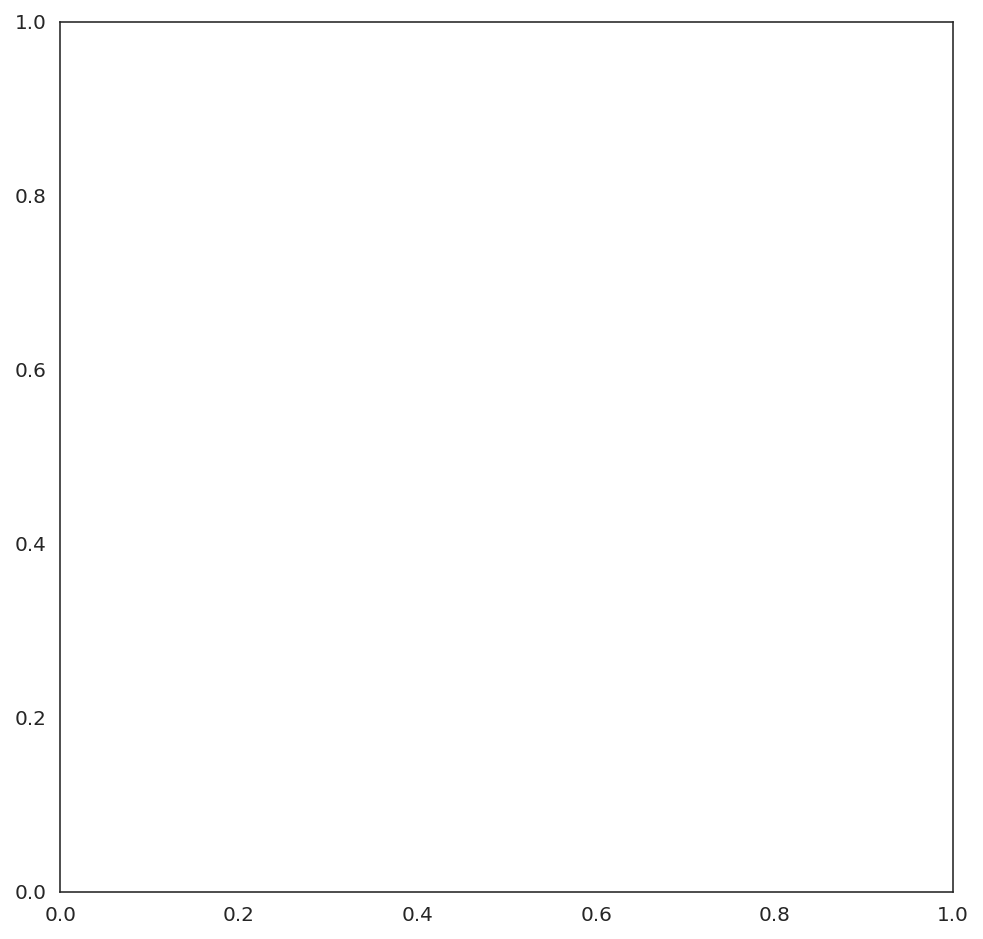

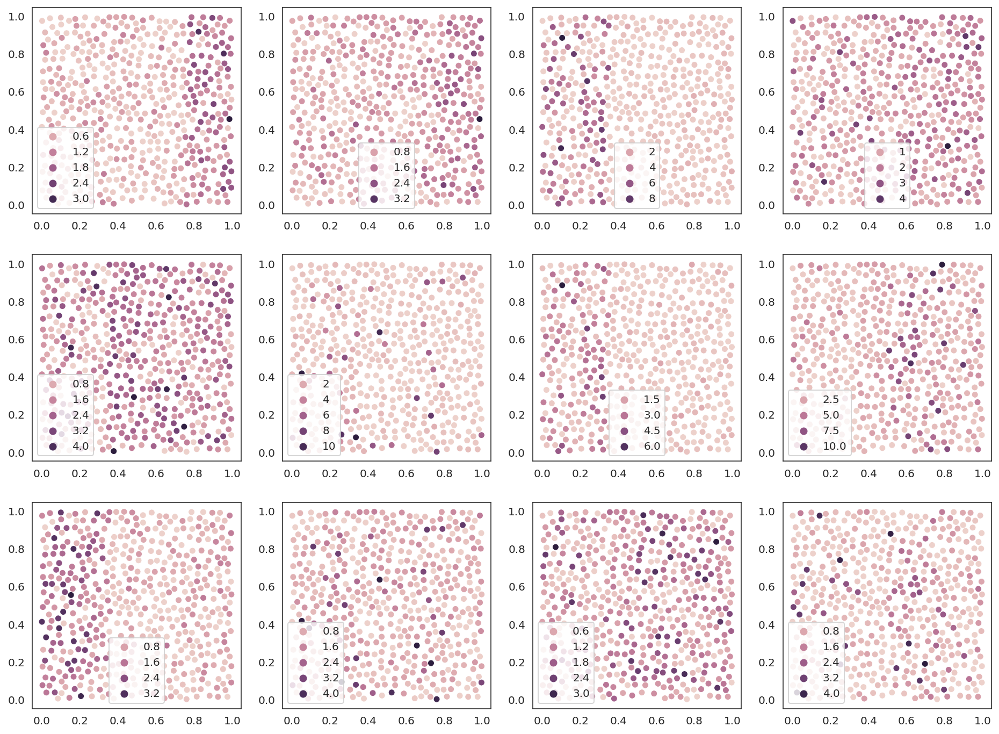

In [13]:
# SpiceMix differential 50 iterations
obj = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    metagene_mode="differential",
    lambda_M=1,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
    random_state=2
)
obj.load_dataset(path2dataset)
# obj.meta['cell type'] = obj.meta['cell type'].astype('category')
obj.initialize(
    method='kmeans',
#     method='svd',
#    random_state=2,
)
# print(obj.sigma_yxs)
# obj.sigma_yxs[:] = 1e-2
# for prior_x in obj.prior_xs: prior_x[0][:] = 0
# evaluate(obj)
for iiter in trange(15):
    obj.estimate_weights(iiter=iiter, use_spatial=[False]*obj.num_repli, backend_algorithm="gd")
    obj.estimate_parameters(iiter=iiter, use_spatial=[False]*obj.num_repli)
    
obj.initialize_Sigma_x_inv()
for iiter in range(35):
    print(f'==== iteration {iiter} ====')
    obj.lambda_Sigma_x_inv = max(1e-4, 1e-1 * .7**iiter)
    print(f'{obj.lambda_Sigma_x_inv:.4e}')
    obj.estimate_parameters(iiter=iiter, use_spatial=[True]*obj.num_repli)
    obj.estimate_weights(iiter=iiter, use_spatial=[True]*obj.num_repli)

evaluate(obj)

/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/model.py:138: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset = ad.AnnData(raw_dataframe)


  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.261362939233047e-08
M NAG Loss: 21088.5625
M NAG Loss: 20957.3125
M NAG Loss: 20899.875
M NAG Loss: 20865.4375
M NAG Loss: 20843.8125
M NAG Loss: 20830.125
M NAG Loss: 20822.0625
M NAG Loss: 20817.4375
M NAG Loss: 20815.0625
M NAG Loss: 20813.5625
M NAG Loss: 20812.625
M NAG Loss: 20811.6875
M NAG Loss: 20810.6875
M NAG Loss: 20809.5625
M NAG Loss: 20808.3125
M NAG Loss: 20807.1875
M NAG Loss: 20806.125
M NAG Loss: 20805.125
M NAG Loss: 20804.1875
M NAG Loss: 20803.5
M NAG Loss: 20802.8125
M NAG Loss: 20802.0
M NAG Loss: 20801.4375
M NAG Loss: 20800.9375
M NAG Loss: 20800.4375
M NAG Loss: 20800.0
M NAG Loss: 20799.6875
M NAG Loss: 20799.4375
M NAG Loss: 20799.1875
M NAG Loss: 20799.0
M NAG Loss: 20798.875
M NAG Loss: 20798.75
M NAG Loss: 20798.6875
M NAG Loss: 20798.5625
M NAG Loss: 20798.625
M NAG Loss: 20798.6875
M NAG Loss: 20798.6875
M NAG Loss: 20798.6875
M NAG Loss: 20798.625
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss: 20798.8125
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.045419369708049e-08
M NAG Loss: 24268.375
M NAG Loss: 24106.75
M NAG Loss: 24011.375
M NAG Loss: 23944.75
M NAG Loss: 23901.125
M NAG Loss: 23875.0
M NAG Loss: 23861.0
M NAG Loss: 23854.5
M NAG Loss: 23852.0
M NAG Loss: 23850.875
M NAG Loss: 23849.625
M NAG Loss: 23848.375
M NAG Loss: 23846.75
M NAG Loss: 23845.125
M NAG Loss: 23843.375
M NAG Loss: 23842.125
M NAG Loss: 23840.625
M NAG Loss: 23839.375
M NAG Loss: 23838.375
M NAG Loss: 23837.375
M NAG Loss: 23836.375
M NAG Loss: 23835.625
M NAG Loss: 23834.5
M NAG Loss: 23834.0
M NAG Loss: 23833.375
M NAG Loss: 23832.75
M NAG Loss: 23832.375
M NAG Loss: 23832.125
M NAG Loss: 23831.75
M NAG Loss: 23831.375
M NAG Loss: 23831.25
M NAG Loss: 23831.125
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23830.875
M NAG Loss: 23831.0
M NAG Loss: 23831.0
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss: 23831.125
M NAG Loss

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.444854405682163e-08
M NAG Loss: 24292.5
M NAG Loss: 24183.375
M NAG Loss: 24130.75
M NAG Loss: 24096.125
M NAG Loss: 24072.75
M NAG Loss: 24058.25
M NAG Loss: 24048.625
M NAG Loss: 24043.125
M NAG Loss: 24039.125
M NAG Loss: 24035.875
M NAG Loss: 24032.625
M NAG Loss: 24030.0
M NAG Loss: 24027.625
M NAG Loss: 24025.375
M NAG Loss: 24023.125
M NAG Loss: 24021.125
M NAG Loss: 24018.875
M NAG Loss: 24016.875
M NAG Loss: 24014.875
M NAG Loss: 24013.125
M NAG Loss: 24011.375
M NAG Loss: 24010.125
M NAG Loss: 24008.625
M NAG Loss: 24007.5
M NAG Loss: 24006.625
M NAG Loss: 24006.125
M NAG Loss: 24005.125
M NAG Loss: 24004.75
M NAG Loss: 24003.875
M NAG Loss: 24003.75
M NAG Loss: 24003.375
M NAG Loss: 24003.125
M NAG Loss: 24003.0
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.375
M NAG Loss: 24002.625
M NAG Loss: 24002.625
M NAG Loss: 24002.75
M NAG Loss: 24002.625
M NAG Loss: 24002.875
M NAG Loss: 24002.875
M NAG Loss: 24002.75
M NAG Loss: 24002.875
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.942399136688253e-08
M NAG Loss: 24370.375
M NAG Loss: 24238.25
M NAG Loss: 24155.5
M NAG Loss: 24093.75
M NAG Loss: 24049.25
M NAG Loss: 24018.875
M NAG Loss: 23999.75
M NAG Loss: 23988.5
M NAG Loss: 23983.0
M NAG Loss: 23979.5
M NAG Loss: 23977.625
M NAG Loss: 23976.0
M NAG Loss: 23974.25
M NAG Loss: 23972.0
M NAG Loss: 23969.75
M NAG Loss: 23967.375
M NAG Loss: 23965.125
M NAG Loss: 23963.25
M NAG Loss: 23961.625
M NAG Loss: 23960.125
M NAG Loss: 23958.5
M NAG Loss: 23957.0
M NAG Loss: 23956.125
M NAG Loss: 23954.875
M NAG Loss: 23954.25
M NAG Loss: 23953.125
M NAG Loss: 23952.25
M NAG Loss: 23951.75
M NAG Loss: 23951.125
M NAG Loss: 23950.75
M NAG Loss: 23950.75
M NAG Loss: 23950.0
M NAG Loss: 23949.875
M NAG Loss: 23949.75
M NAG Loss: 23949.75
M NAG Loss: 23949.5
M NAG Loss: 23949.5
M NAG Loss: 23949.625
M NAG Loss: 23949.625
M NAG Loss: 23949.75
M NAG Loss: 23949.5
M NAG Loss: 23949.5
M NAG Loss: 23949.625
M NAG Loss: 23949.625
M NAG Loss: 23949.875
M NAG Loss: 23949.75
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.412548896486904e-08
M NAG Loss: 24031.375
M NAG Loss: 23887.125
M NAG Loss: 23808.75
M NAG Loss: 23753.875
M NAG Loss: 23716.375
M NAG Loss: 23691.625
M NAG Loss: 23676.375
M NAG Loss: 23667.125
M NAG Loss: 23661.625
M NAG Loss: 23657.875
M NAG Loss: 23655.5
M NAG Loss: 23653.0
M NAG Loss: 23650.625
M NAG Loss: 23648.375
M NAG Loss: 23646.25
M NAG Loss: 23644.125
M NAG Loss: 23641.875
M NAG Loss: 23639.75
M NAG Loss: 23638.125
M NAG Loss: 23636.375
M NAG Loss: 23634.5
M NAG Loss: 23633.125
M NAG Loss: 23631.875
M NAG Loss: 23630.625
M NAG Loss: 23629.875
M NAG Loss: 23628.875
M NAG Loss: 23628.0
M NAG Loss: 23627.625
M NAG Loss: 23627.125
M NAG Loss: 23626.625
M NAG Loss: 23626.25
M NAG Loss: 23626.0
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG Loss: 23625.625
M NAG Loss: 23625.625
M NAG Loss: 23625.625
M NAG Loss: 23625.75
M NAG Loss: 23626.0
M NAG Loss: 23626.0
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG Loss: 23626.125
M NAG Loss: 23625.875
M NAG Loss: 23625.875
M NAG L

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.514426262101687e-08
M NAG Loss: 24427.375
M NAG Loss: 24334.0
M NAG Loss: 24289.5
M NAG Loss: 24257.25
M NAG Loss: 24232.75
M NAG Loss: 24213.875
M NAG Loss: 24199.375
M NAG Loss: 24188.25
M NAG Loss: 24180.25
M NAG Loss: 24174.25
M NAG Loss: 24169.875
M NAG Loss: 24166.875
M NAG Loss: 24164.75
M NAG Loss: 24162.75
M NAG Loss: 24161.25
M NAG Loss: 24160.0
M NAG Loss: 24158.5
M NAG Loss: 24156.75
M NAG Loss: 24155.125
M NAG Loss: 24153.75
M NAG Loss: 24152.25
M NAG Loss: 24151.25
M NAG Loss: 24150.25
M NAG Loss: 24149.25
M NAG Loss: 24148.25
M NAG Loss: 24147.875
M NAG Loss: 24147.375
M NAG Loss: 24146.75
M NAG Loss: 24146.25
M NAG Loss: 24146.0
M NAG Loss: 24146.0
M NAG Loss: 24145.625
M NAG Loss: 24145.375
M NAG Loss: 24145.625
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.375
M NAG Loss: 24145.75
M NAG Loss: 24145.5
M NAG Loss: 24145.5
M NAG Loss: 24145.875
M NAG Loss: 24145.75
M NAG Loss: 24145.75
M NAG Loss: 24146.0
M NAG Loss: 24145.75
M NAG Loss:

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.647881526241914e-08
M NAG Loss: 24596.375
M NAG Loss: 24526.5
M NAG Loss: 24494.625
M NAG Loss: 24471.625
M NAG Loss: 24453.375
M NAG Loss: 24438.0
M NAG Loss: 24425.25
M NAG Loss: 24414.875
M NAG Loss: 24406.25
M NAG Loss: 24399.75
M NAG Loss: 24395.0
M NAG Loss: 24391.125
M NAG Loss: 24388.625
M NAG Loss: 24387.125
M NAG Loss: 24385.875
M NAG Loss: 24385.125
M NAG Loss: 24384.625
M NAG Loss: 24384.0
M NAG Loss: 24383.625
M NAG Loss: 24382.875
M NAG Loss: 24382.625
M NAG Loss: 24381.875
M NAG Loss: 24381.625
M NAG Loss: 24380.75
M NAG Loss: 24380.75
M NAG Loss: 24380.25
M NAG Loss: 24380.125
M NAG Loss: 24379.75
M NAG Loss: 24379.625
M NAG Loss: 24379.375
M NAG Loss: 24379.125
M NAG Loss: 24379.25
M NAG Loss: 24378.875
M NAG Loss: 24379.25
M NAG Loss: 24378.875
M NAG Loss: 24379.125
M NAG Loss: 24378.875
M NAG Loss: 24379.125
M NAG Loss: 24379.125
M NAG Loss: 24379.375
M NAG Loss: 24379.25
M NAG Loss: 24379.25
M NAG Loss: 24379.375
M NAG Loss: 24379.375
M NAG Loss: 24379.25
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.769784016810727e-08
M NAG Loss: 24710.875
M NAG Loss: 24661.0
M NAG Loss: 24639.125
M NAG Loss: 24624.0
M NAG Loss: 24612.25
M NAG Loss: 24602.75
M NAG Loss: 24594.875
M NAG Loss: 24587.75
M NAG Loss: 24582.0
M NAG Loss: 24577.25
M NAG Loss: 24573.375
M NAG Loss: 24570.5
M NAG Loss: 24567.875
M NAG Loss: 24566.25
M NAG Loss: 24565.375
M NAG Loss: 24564.5
M NAG Loss: 24564.0
M NAG Loss: 24564.0
M NAG Loss: 24564.0
M NAG Loss: 24563.5
M NAG Loss: 24563.75
M NAG Loss: 24563.5
M NAG Loss: 24563.5
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24563.0
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.5
M NAG Loss: 24562.75
M NAG Loss: 24562.375
M NAG Loss: 24562.5
M NAG Loss: 24562.25
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.5
M NAG Loss: 24562.625
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.25
M NAG Loss: 24562.5
M NAG Loss: 24562.375
M N

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.883876845240398e-08
M NAG Loss: 24775.75
M NAG Loss: 24736.375
M NAG Loss: 24718.5
M NAG Loss: 24706.5
M NAG Loss: 24697.75
M NAG Loss: 24690.625
M NAG Loss: 24684.875
M NAG Loss: 24679.75
M NAG Loss: 24675.375
M NAG Loss: 24671.5
M NAG Loss: 24668.625
M NAG Loss: 24666.0
M NAG Loss: 24663.625
M NAG Loss: 24662.125
M NAG Loss: 24660.625
M NAG Loss: 24659.625
M NAG Loss: 24659.125
M NAG Loss: 24658.375
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24658.125
M NAG Loss: 24657.875
M NAG Loss: 24657.875
M NAG Loss: 24657.875
M NAG Loss: 24657.75
M NAG Loss: 24657.625
M NAG Loss: 24657.75
M NAG Loss: 24657.625
M NAG Loss: 24657.5
M NAG Loss: 24657.5
M NAG Loss: 24657.25
M NAG Loss: 24657.375
M NAG Loss: 24657.5
M NAG Loss: 24657.625
M NAG Loss: 24657.375
M NAG Loss: 24657.25
M NAG Loss: 24657.375
M NAG Loss: 24657.125
M NAG Loss: 24657.375
M NAG Loss: 24657.375
M NAG Loss: 24657.625
M NAG Loss: 24657.375
M NAG Loss: 24657.625
M NAG Loss: 24657.625
M NAG Los

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.97114878536795e-08
M NAG Loss: 24798.0
M NAG Loss: 24764.125
M NAG Loss: 24747.625
M NAG Loss: 24736.75
M NAG Loss: 24728.75
M NAG Loss: 24722.625
M NAG Loss: 24717.625
M NAG Loss: 24713.625
M NAG Loss: 24710.0
M NAG Loss: 24707.125
M NAG Loss: 24704.5
M NAG Loss: 24702.0
M NAG Loss: 24700.0
M NAG Loss: 24698.25
M NAG Loss: 24696.75
M NAG Loss: 24695.875
M NAG Loss: 24694.625
M NAG Loss: 24694.0
M NAG Loss: 24693.75
M NAG Loss: 24693.25
M NAG Loss: 24692.875
M NAG Loss: 24692.625
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.5
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.5
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.25
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.125
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.0
M NAG Loss: 24692.25
M NAG Loss: 24692.0
M NAG Loss: 24692.375
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.019570421944975e-08
M NAG Loss: 24811.75
M NAG Loss: 24781.5
M NAG Loss: 24765.75
M NAG Loss: 24755.625
M NAG Loss: 24748.0
M NAG Loss: 24742.125
M NAG Loss: 24737.75
M NAG Loss: 24734.0
M NAG Loss: 24731.0
M NAG Loss: 24728.25
M NAG Loss: 24725.875
M NAG Loss: 24724.125
M NAG Loss: 24722.25
M NAG Loss: 24721.0
M NAG Loss: 24719.5
M NAG Loss: 24718.5
M NAG Loss: 24717.25
M NAG Loss: 24716.5
M NAG Loss: 24715.75
M NAG Loss: 24715.25
M NAG Loss: 24714.875
M NAG Loss: 24714.625
M NAG Loss: 24714.25
M NAG Loss: 24714.25
M NAG Loss: 24714.25
M NAG Loss: 24714.0
M NAG Loss: 24713.75
M NAG Loss: 24714.0
M NAG Loss: 24713.625
M NAG Loss: 24713.75
M NAG Loss: 24714.0
M NAG Loss: 24713.625
M NAG Loss: 24713.75
M NAG Loss: 24713.875
M NAG Loss: 24713.75
M NAG Loss: 24713.75
M NAG Loss: 24713.625
M NAG Loss: 24713.625
M NAG Loss: 24713.5
M NAG Loss: 24713.375
M NAG Loss: 24713.75
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713.5
M NAG Loss: 24713

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.038194168293075e-08
M NAG Loss: 24824.5
M NAG Loss: 24796.375
M NAG Loss: 24781.125
M NAG Loss: 24771.125
M NAG Loss: 24763.75
M NAG Loss: 24757.875
M NAG Loss: 24753.5
M NAG Loss: 24749.625
M NAG Loss: 24746.625
M NAG Loss: 24743.75
M NAG Loss: 24741.5
M NAG Loss: 24739.75
M NAG Loss: 24738.0
M NAG Loss: 24736.375
M NAG Loss: 24735.5
M NAG Loss: 24734.5
M NAG Loss: 24733.375
M NAG Loss: 24732.75
M NAG Loss: 24732.0
M NAG Loss: 24731.375
M NAG Loss: 24730.625
M NAG Loss: 24730.25
M NAG Loss: 24730.0
M NAG Loss: 24729.875
M NAG Loss: 24729.5
M NAG Loss: 24729.375
M NAG Loss: 24729.125
M NAG Loss: 24729.375
M NAG Loss: 24729.0
M NAG Loss: 24729.25
M NAG Loss: 24729.0
M NAG Loss: 24729.125
M NAG Loss: 24729.0
M NAG Loss: 24728.75
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24728.75
M NAG Loss: 24729.0
M NAG Loss: 24729.25
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24729.0
M NAG Loss: 24729.125
M NAG Loss: 24728.75
M NAG Loss: 24728.875
M NAG Loss: 24729.0
M NAG Loss: 24

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.034120690598714e-08
M NAG Loss: 24831.125
M NAG Loss: 24804.625
M NAG Loss: 24790.0
M NAG Loss: 24780.125
M NAG Loss: 24772.875
M NAG Loss: 24767.125
M NAG Loss: 24762.625
M NAG Loss: 24759.0
M NAG Loss: 24755.875
M NAG Loss: 24753.125
M NAG Loss: 24750.625
M NAG Loss: 24748.875
M NAG Loss: 24746.875
M NAG Loss: 24745.625
M NAG Loss: 24744.5
M NAG Loss: 24743.5
M NAG Loss: 24742.625
M NAG Loss: 24741.75
M NAG Loss: 24741.375
M NAG Loss: 24740.875
M NAG Loss: 24740.25
M NAG Loss: 24739.875
M NAG Loss: 24739.5
M NAG Loss: 24738.875
M NAG Loss: 24738.875
M NAG Loss: 24738.625
M NAG Loss: 24738.375
M NAG Loss: 24738.25
M NAG Loss: 24738.0
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.25
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24738.125
M NAG Loss: 24738.125
M NAG Loss: 24737.875
M NAG Loss: 24737.875
M NAG Loss: 24738.0
M NAG Loss: 24738.0
M NAG Lo

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

7.013381110355693e-08
M NAG Loss: 24835.0
M NAG Loss: 24810.0
M NAG Loss: 24795.5
M NAG Loss: 24785.25
M NAG Loss: 24778.125
M NAG Loss: 24772.5
M NAG Loss: 24768.0
M NAG Loss: 24764.375
M NAG Loss: 24760.875
M NAG Loss: 24758.25
M NAG Loss: 24755.75
M NAG Loss: 24753.625
M NAG Loss: 24751.875
M NAG Loss: 24750.0
M NAG Loss: 24748.75
M NAG Loss: 24747.875
M NAG Loss: 24746.75
M NAG Loss: 24746.0
M NAG Loss: 24745.375
M NAG Loss: 24744.625
M NAG Loss: 24744.25
M NAG Loss: 24744.0
M NAG Loss: 24743.375
M NAG Loss: 24743.5
M NAG Loss: 24742.75
M NAG Loss: 24742.625
M NAG Loss: 24742.375
M NAG Loss: 24742.5
M NAG Loss: 24742.125
M NAG Loss: 24742.0
M NAG Loss: 24741.75
M NAG Loss: 24741.75
M NAG Loss: 24741.875
M NAG Loss: 24741.875
M NAG Loss: 24741.75
M NAG Loss: 24741.75
M NAG Loss: 24741.5
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.625
M NAG Loss: 24741.875
M NAG Loss: 24741.625
M NAG Loss: 24741.75
M NAG Loss: 24741.625
M NAG Loss: 24741.875
M 

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.980670244865158e-08
M NAG Loss: 24839.375
M NAG Loss: 24816.125
M NAG Loss: 24801.75
M NAG Loss: 24792.125
M NAG Loss: 24784.625
M NAG Loss: 24779.125
M NAG Loss: 24775.0
M NAG Loss: 24771.625
M NAG Loss: 24768.125
M NAG Loss: 24765.375
M NAG Loss: 24763.375
M NAG Loss: 24761.125
M NAG Loss: 24759.125
M NAG Loss: 24757.375
M NAG Loss: 24755.875
M NAG Loss: 24754.375
M NAG Loss: 24753.375
M NAG Loss: 24752.375
M NAG Loss: 24751.5
M NAG Loss: 24750.875
M NAG Loss: 24750.125
M NAG Loss: 24749.875
M NAG Loss: 24749.25
M NAG Loss: 24749.125
M NAG Loss: 24748.75
M NAG Loss: 24748.25
M NAG Loss: 24748.125
M NAG Loss: 24748.0
M NAG Loss: 24748.25
M NAG Loss: 24747.75
M NAG Loss: 24747.875
M NAG Loss: 24747.75
M NAG Loss: 24747.75
M NAG Loss: 24747.625
M NAG Loss: 24747.75
M NAG Loss: 24747.5
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.375
M NAG Loss: 24747.25
M NAG Loss: 24747.375
M NAG Loss: 24747.625
M NAG Loss: 24747.375
M NAG Loss: 24747.625
M NAG 

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.910146603597297e-08
M NAG Loss: 25000.0
M NAG Loss: 25000.0
M NAG Loss: 25000.0
M NAG Loss: 25000.0
M NAG Loss: 25000.25
M NAG Loss: 24999.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -9045.51171875
Function value: -6973.9296875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -76025.71875
Function value: -13609.525390625
replicate 0hierarchical w/ K=6.ARI = 0.47
replicate 0hierarchical w/ K=7.ARI = 0.54
replicate 0hierarchical w/ K=8.ARI = 0.57
replicate 0hierarchical w/ K=9.ARI = 0.52
replicate 1hierarchical w/ K=6.ARI = 0.48
replicate 1hierarchical w/ K=7.ARI = 0.57
replicate 1hierarchical w/ K=8.ARI = 0.60
replicate 1hierarchical w/ K=9.ARI = 0.53


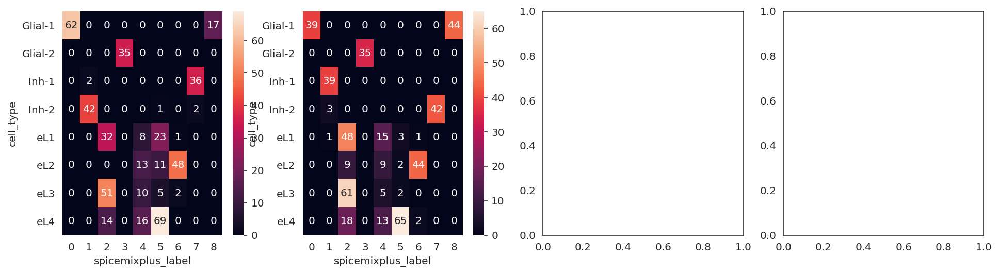

sil 0.50117123


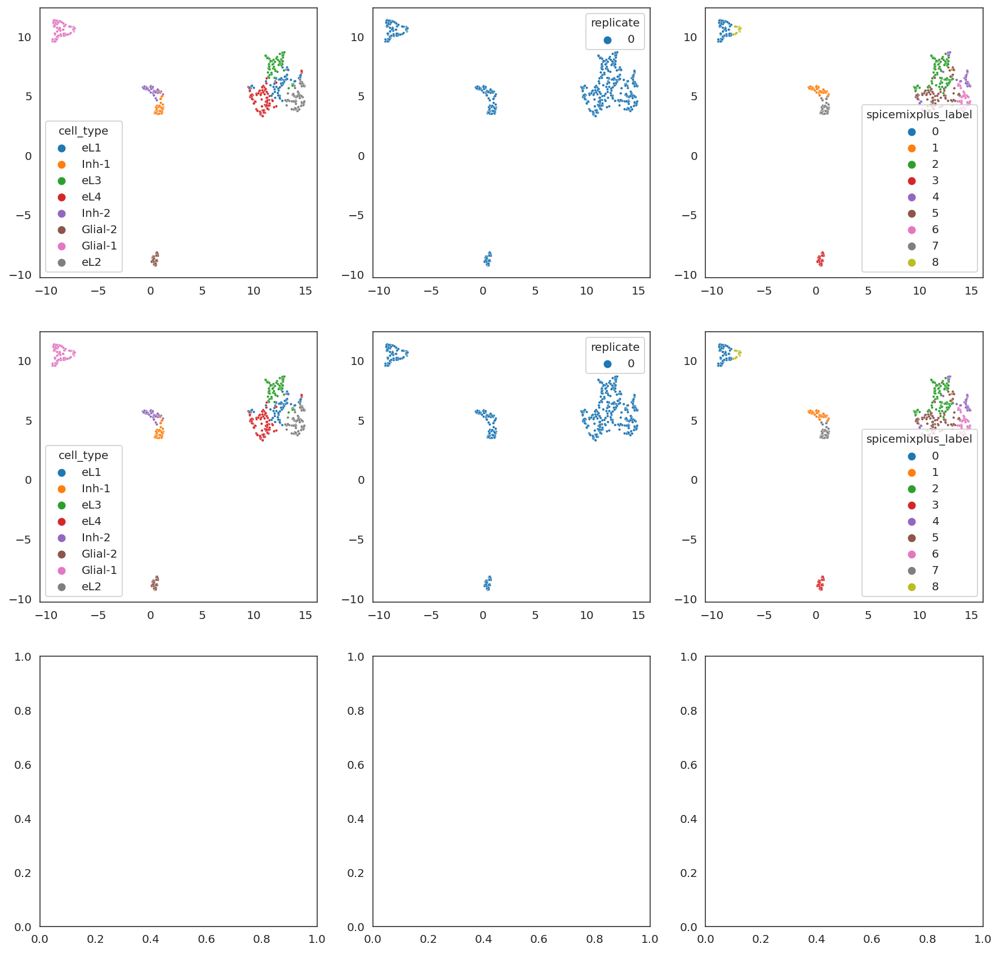

sil 0.5787279


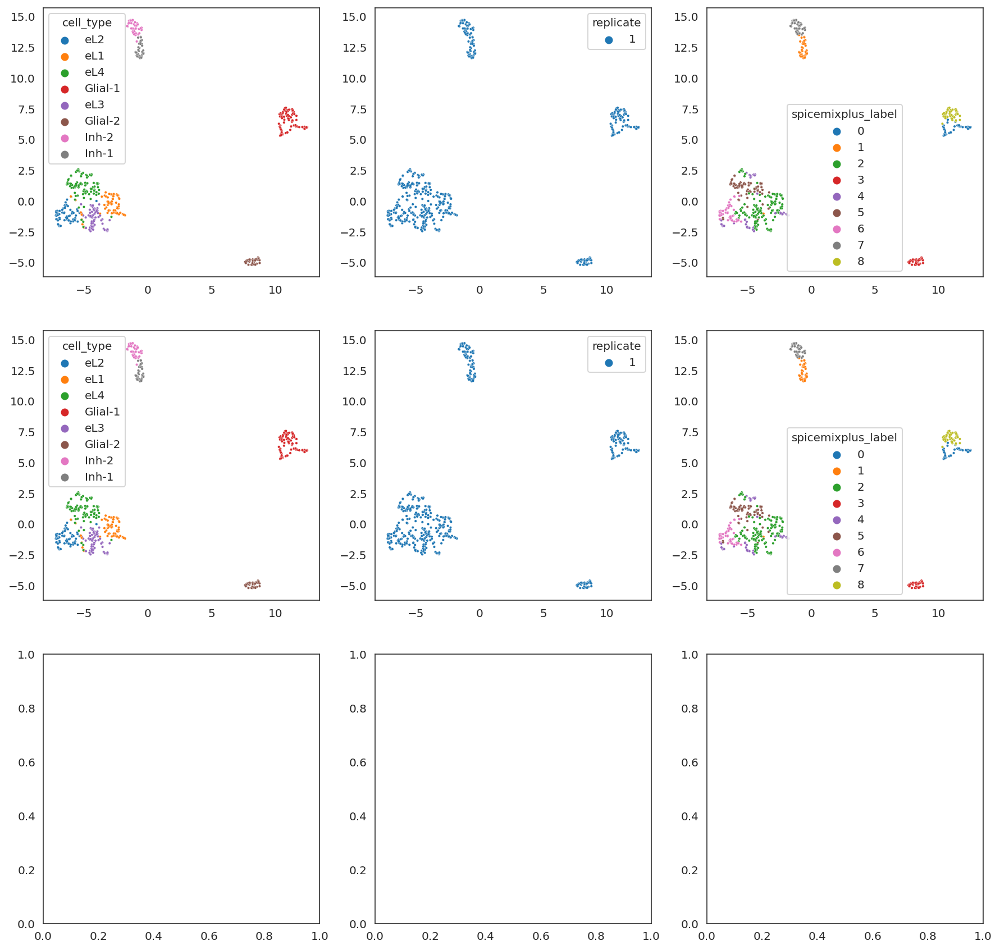

Done


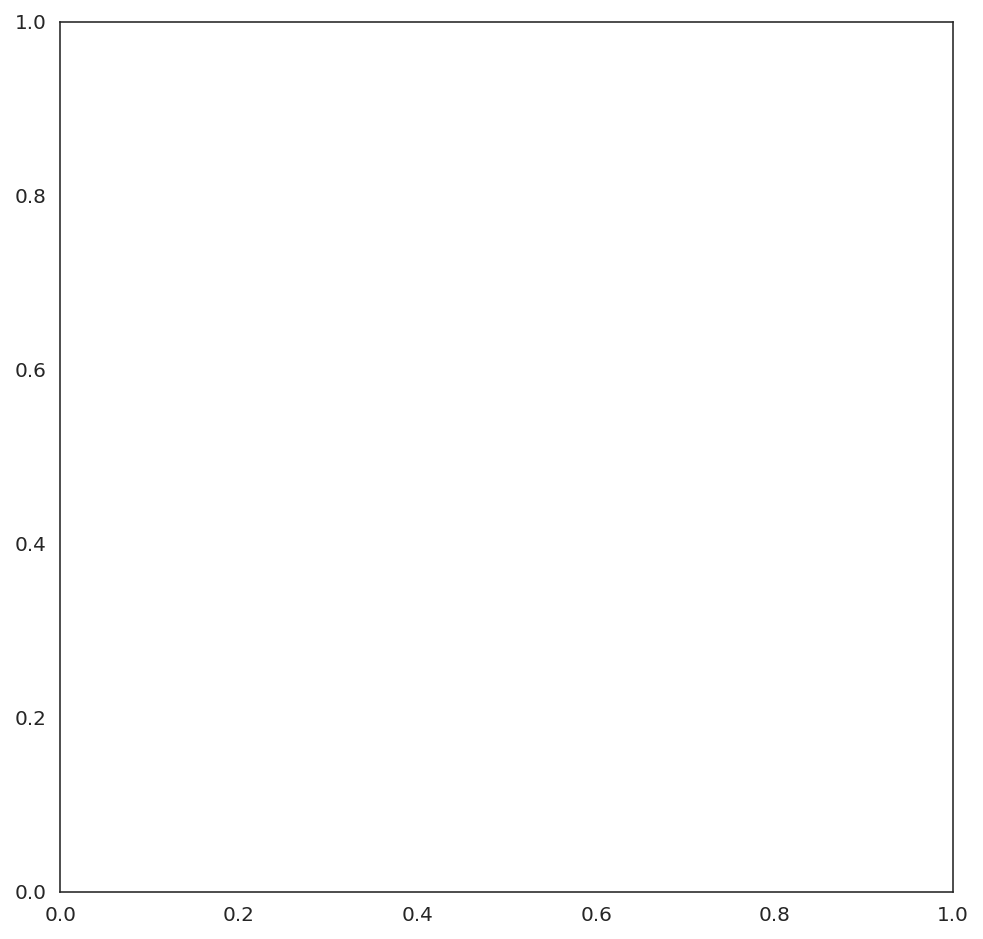

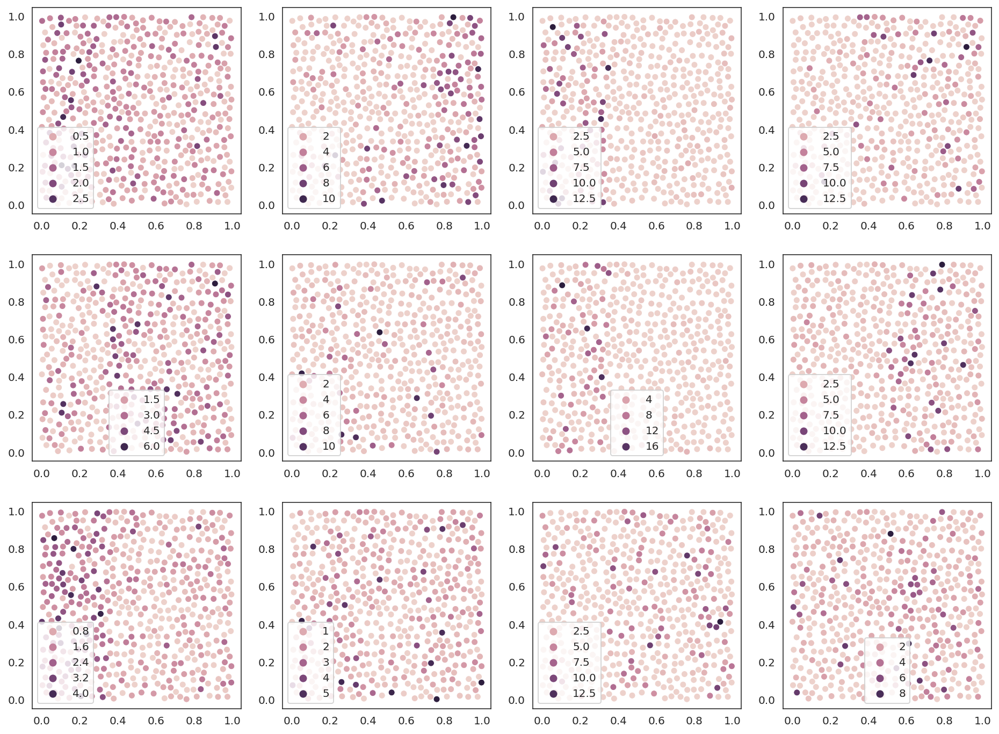

==== iteration 1 ====
7.0000e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.915651322265617e-08
M NAG Loss: 24746.25
M NAG Loss: 24684.75
M NAG Loss: 24640.5
M NAG Loss: 24609.875
M NAG Loss: 24590.0
M NAG Loss: 24577.75
M NAG Loss: 24570.25
M NAG Loss: 24565.25
M NAG Loss: 24562.0
M NAG Loss: 24559.25
M NAG Loss: 24557.0
M NAG Loss: 24555.0
M NAG Loss: 24552.75
M NAG Loss: 24551.375
M NAG Loss: 24549.875
M NAG Loss: 24548.375
M NAG Loss: 24547.125
M NAG Loss: 24546.375
M NAG Loss: 24545.5
M NAG Loss: 24544.25
M NAG Loss: 24543.5
M NAG Loss: 24543.0
M NAG Loss: 24542.625
M NAG Loss: 24542.125
M NAG Loss: 24541.875
M NAG Loss: 24541.5
M NAG Loss: 24541.25
M NAG Loss: 24540.875
M NAG Loss: 24540.75
M NAG Loss: 24540.75
M NAG Loss: 24540.75
M NAG Loss: 24540.75
M NAG Loss: 24540.5
M NAG Loss: 24540.375
M NAG Loss: 24540.5
M NAG Loss: 24540.5
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.375
M NAG Loss: 24540.25
M NAG Loss: 24540.25
M NAG Loss: 24540.25
M NAG Loss: 24540.125
M NAG Loss: 24540.25
M NAG Loss: 24540.25
M NAG Loss: 24540.0
M NAG Loss

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3096.41259765625
Function value: -1584.69189453125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -80066.46875
Function value: -10326.0234375
==== iteration 2 ====
4.9000e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.802211153966553e-08
M NAG Loss: 24855.25
M NAG Loss: 24819.75
M NAG Loss: 24793.25
M NAG Loss: 24771.625
M NAG Loss: 24755.5
M NAG Loss: 24743.5
M NAG Loss: 24735.0
M NAG Loss: 24729.25
M NAG Loss: 24725.25
M NAG Loss: 24722.75
M NAG Loss: 24720.75
M NAG Loss: 24719.125
M NAG Loss: 24717.5
M NAG Loss: 24716.5
M NAG Loss: 24715.0
M NAG Loss: 24713.875
M NAG Loss: 24713.0
M NAG Loss: 24712.125
M NAG Loss: 24711.5
M NAG Loss: 24710.375
M NAG Loss: 24709.75
M NAG Loss: 24709.25
M NAG Loss: 24708.75
M NAG Loss: 24708.25
M NAG Loss: 24707.75
M NAG Loss: 24707.5
M NAG Loss: 24707.375
M NAG Loss: 24707.0
M NAG Loss: 24706.75
M NAG Loss: 24706.625
M NAG Loss: 24706.625
M NAG Loss: 24706.25
M NAG Loss: 24706.375
M NAG Loss: 24706.5
M NAG Loss: 24706.375
M NAG Loss: 24706.5
M NAG Loss: 24706.375
M NAG Loss: 24706.375
M NAG Loss: 24706.5
M NAG Loss: 24706.125
M NAG Loss: 24706.125
M NAG Loss: 24706.125
M NAG Loss: 24706.25
M NAG Loss: 24706.125
M NAG Loss: 24706.25
M NAG Loss: 24706.0
M NAG Loss

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -19596.4765625
Function value: -4269.609375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4767.125
Function value: -68568.0546875
==== iteration 3 ====
3.4300e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.734576338577863e-08
M NAG Loss: 24881.25
M NAG Loss: 24855.125
M NAG Loss: 24835.875
M NAG Loss: 24819.75
M NAG Loss: 24806.125
M NAG Loss: 24795.25
M NAG Loss: 24786.5
M NAG Loss: 24780.0
M NAG Loss: 24775.25
M NAG Loss: 24771.75
M NAG Loss: 24769.375
M NAG Loss: 24767.5
M NAG Loss: 24766.25
M NAG Loss: 24765.25
M NAG Loss: 24764.25
M NAG Loss: 24763.5
M NAG Loss: 24763.0
M NAG Loss: 24762.25
M NAG Loss: 24761.5
M NAG Loss: 24760.75
M NAG Loss: 24760.25
M NAG Loss: 24759.625
M NAG Loss: 24759.5
M NAG Loss: 24759.0
M NAG Loss: 24758.5
M NAG Loss: 24758.5
M NAG Loss: 24758.125
M NAG Loss: 24757.75
M NAG Loss: 24757.5
M NAG Loss: 24757.5
M NAG Loss: 24757.125
M NAG Loss: 24757.25
M NAG Loss: 24757.0
M NAG Loss: 24757.0
M NAG Loss: 24756.75
M NAG Loss: 24756.75
M NAG Loss: 24757.0
M NAG Loss: 24756.875
M NAG Loss: 24756.75
M NAG Loss: 24756.875
M NAG Loss: 24756.75
M NAG Loss: 24756.625
M NAG Loss: 24756.75
M NAG Loss: 24756.875
M NAG Loss: 24756.75
M NAG Loss: 24756.75
M NAG Loss: 2475

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -91837.390625
Function value: -8391.755859375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1560.054931640625
Function value: -76910.3125
==== iteration 4 ====
2.4010e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.678979142082458e-08
M NAG Loss: 24898.25
M NAG Loss: 24877.125
M NAG Loss: 24862.875
M NAG Loss: 24850.625
M NAG Loss: 24840.0
M NAG Loss: 24831.125
M NAG Loss: 24823.125
M NAG Loss: 24817.0
M NAG Loss: 24811.625
M NAG Loss: 24807.75
M NAG Loss: 24804.625
M NAG Loss: 24802.375
M NAG Loss: 24800.625
M NAG Loss: 24799.625
M NAG Loss: 24798.625
M NAG Loss: 24798.125
M NAG Loss: 24797.375
M NAG Loss: 24797.125
M NAG Loss: 24796.75
M NAG Loss: 24796.25
M NAG Loss: 24795.875
M NAG Loss: 24795.625
M NAG Loss: 24795.375
M NAG Loss: 24794.875
M NAG Loss: 24794.75
M NAG Loss: 24794.375
M NAG Loss: 24794.125
M NAG Loss: 24793.875
M NAG Loss: 24793.625
M NAG Loss: 24793.5
M NAG Loss: 24793.375
M NAG Loss: 24793.5
M NAG Loss: 24793.25
M NAG Loss: 24793.125
M NAG Loss: 24793.0
M NAG Loss: 24792.875
M NAG Loss: 24792.875
M NAG Loss: 24793.125
M NAG Loss: 24792.875
M NAG Loss: 24793.0
M NAG Loss: 24792.625
M NAG Loss: 24792.875
M NAG Loss: 24792.875
M NAG Loss: 24792.875
M NAG Loss: 24792.625
M NAG 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -16387.8046875
Function value: -4793.62109375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4929.912109375
Function value: -81037.453125
==== iteration 5 ====
1.6807e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.631757976910606e-08
M NAG Loss: 24911.125
M NAG Loss: 24893.125
M NAG Loss: 24882.125
M NAG Loss: 24872.5
M NAG Loss: 24864.375
M NAG Loss: 24856.875
M NAG Loss: 24850.125
M NAG Loss: 24844.125
M NAG Loss: 24839.125
M NAG Loss: 24834.875
M NAG Loss: 24831.375
M NAG Loss: 24828.375
M NAG Loss: 24826.125
M NAG Loss: 24824.375
M NAG Loss: 24822.875
M NAG Loss: 24821.75
M NAG Loss: 24821.0
M NAG Loss: 24820.375
M NAG Loss: 24820.375
M NAG Loss: 24819.625
M NAG Loss: 24819.375
M NAG Loss: 24818.875
M NAG Loss: 24818.875
M NAG Loss: 24818.375
M NAG Loss: 24818.375
M NAG Loss: 24818.375
M NAG Loss: 24818.0
M NAG Loss: 24817.75
M NAG Loss: 24817.625
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.375
M NAG Loss: 24817.125
M NAG Loss: 24817.0
M NAG Loss: 24817.125
M NAG Loss: 24816.625
M NAG Loss: 24816.875
M NAG Loss: 24816.5
M NAG Loss: 24816.75
M NAG Loss: 24816.5
M NAG Loss: 24816.625
M NAG Loss: 24816.625
M NAG Loss: 24816.75
M NAG Loss: 24816.625
M NAG Loss: 24816.375
M NA

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1654.943115234375
Function value: -1426.966796875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6481.68798828125
Function value: -2852.177734375
==== iteration 6 ====
1.1765e-02


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.589600845472147e-08
M NAG Loss: 24918.875
M NAG Loss: 24903.375
M NAG Loss: 24894.625
M NAG Loss: 24887.375
M NAG Loss: 24880.625
M NAG Loss: 24874.625
M NAG Loss: 24869.125
M NAG Loss: 24864.25
M NAG Loss: 24859.375
M NAG Loss: 24855.75
M NAG Loss: 24851.875
M NAG Loss: 24848.75
M NAG Loss: 24846.125
M NAG Loss: 24844.125
M NAG Loss: 24842.375
M NAG Loss: 24840.875
M NAG Loss: 24839.75
M NAG Loss: 24838.875
M NAG Loss: 24838.0
M NAG Loss: 24837.625
M NAG Loss: 24837.25
M NAG Loss: 24836.875
M NAG Loss: 24836.5
M NAG Loss: 24836.0
M NAG Loss: 24836.25
M NAG Loss: 24836.25
M NAG Loss: 24836.0
M NAG Loss: 24835.875
M NAG Loss: 24835.625
M NAG Loss: 24835.625
M NAG Loss: 24835.5
M NAG Loss: 24835.125
M NAG Loss: 24835.375
M NAG Loss: 24834.875
M NAG Loss: 24834.875
M NAG Loss: 24834.875
M NAG Loss: 24834.875
M NAG Loss: 24834.875
M NAG Loss: 24834.875
M NAG Loss: 24834.75
M NAG Loss: 24834.75
M NAG Loss: 24834.625
M NAG Loss: 24834.625
M NAG Loss: 24834.625
M NAG Loss: 24834.625
M NAG L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3665.714111328125
Function value: -111963.234375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4170.01953125
Function value: -11808.611328125
==== iteration 7 ====
8.2354e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.551809944048853e-08
M NAG Loss: 24928.125
M NAG Loss: 24915.75
M NAG Loss: 24908.25
M NAG Loss: 24902.75
M NAG Loss: 24897.625
M NAG Loss: 24893.125
M NAG Loss: 24888.75
M NAG Loss: 24884.75
M NAG Loss: 24880.875
M NAG Loss: 24877.5
M NAG Loss: 24874.375
M NAG Loss: 24871.25
M NAG Loss: 24868.75
M NAG Loss: 24866.5
M NAG Loss: 24864.625
M NAG Loss: 24863.0
M NAG Loss: 24861.875
M NAG Loss: 24861.0
M NAG Loss: 24859.75
M NAG Loss: 24858.875
M NAG Loss: 24858.125
M NAG Loss: 24857.5
M NAG Loss: 24857.125
M NAG Loss: 24857.0
M NAG Loss: 24856.75
M NAG Loss: 24856.375
M NAG Loss: 24856.5
M NAG Loss: 24856.125
M NAG Loss: 24856.125
M NAG Loss: 24855.875
M NAG Loss: 24856.125
M NAG Loss: 24855.75
M NAG Loss: 24855.75
M NAG Loss: 24855.625
M NAG Loss: 24855.875
M NAG Loss: 24855.75
M NAG Loss: 24855.75
M NAG Loss: 24855.5
M NAG Loss: 24855.625
M NAG Loss: 24855.375
M NAG Loss: 24855.625
M NAG Loss: 24855.25
M NAG Loss: 24855.25
M NAG Loss: 24855.375
M NAG Loss: 24855.5
M NAG Loss: 24855.5
M

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -85842.5078125
Function value: -69860.5625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -14382.31640625
Function value: -5417.87939453125
==== iteration 8 ====
5.7648e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.519720851632017e-08
M NAG Loss: 24938.375
M NAG Loss: 24928.375
M NAG Loss: 24922.375
M NAG Loss: 24918.375
M NAG Loss: 24914.75
M NAG Loss: 24911.125
M NAG Loss: 24908.0
M NAG Loss: 24905.125
M NAG Loss: 24902.125
M NAG Loss: 24899.125
M NAG Loss: 24896.625
M NAG Loss: 24894.125
M NAG Loss: 24891.875
M NAG Loss: 24890.125
M NAG Loss: 24888.375
M NAG Loss: 24887.0
M NAG Loss: 24885.625
M NAG Loss: 24884.125
M NAG Loss: 24883.625
M NAG Loss: 24882.375
M NAG Loss: 24881.625
M NAG Loss: 24881.25
M NAG Loss: 24880.75
M NAG Loss: 24880.375
M NAG Loss: 24879.75
M NAG Loss: 24879.625
M NAG Loss: 24879.125
M NAG Loss: 24879.0
M NAG Loss: 24879.125
M NAG Loss: 24878.875
M NAG Loss: 24878.75
M NAG Loss: 24878.375
M NAG Loss: 24878.625
M NAG Loss: 24878.625
M NAG Loss: 24878.625
M NAG Loss: 24878.625
M NAG Loss: 24878.375
M NAG Loss: 24878.625
M NAG Loss: 24878.125
M NAG Loss: 24878.375
M NAG Loss: 24878.25
M NAG Loss: 24878.625
M NAG Loss: 24878.25
M NAG Loss: 24878.25
M NAG Loss: 24878.125
M 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -7881.32275390625
Function value: -68760.203125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4024.8720703125
Function value: -2609.6005859375
==== iteration 9 ====
4.0354e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.493358917167467e-08
M NAG Loss: 24949.125
M NAG Loss: 24941.25
M NAG Loss: 24937.0
M NAG Loss: 24933.75
M NAG Loss: 24930.5
M NAG Loss: 24928.125
M NAG Loss: 24925.75
M NAG Loss: 24923.625
M NAG Loss: 24921.375
M NAG Loss: 24919.375
M NAG Loss: 24917.25
M NAG Loss: 24915.625
M NAG Loss: 24913.875
M NAG Loss: 24912.5
M NAG Loss: 24911.25
M NAG Loss: 24909.75
M NAG Loss: 24908.875
M NAG Loss: 24907.75
M NAG Loss: 24907.125
M NAG Loss: 24906.25
M NAG Loss: 24905.625
M NAG Loss: 24905.0
M NAG Loss: 24904.375
M NAG Loss: 24904.0
M NAG Loss: 24903.625
M NAG Loss: 24903.25
M NAG Loss: 24903.0
M NAG Loss: 24902.75
M NAG Loss: 24902.375
M NAG Loss: 24902.25
M NAG Loss: 24902.25
M NAG Loss: 24902.0
M NAG Loss: 24902.0
M NAG Loss: 24902.125
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.625
M NAG Loss: 24901.75
M NAG Loss: 24901.875
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.75
M NAG Loss: 24901.625
M N

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -100020.3125
Function value: -5755.3671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1422.87646484375
Function value: -5250.2314453125
==== iteration 10 ====
2.8248e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.473095226998504e-08
M NAG Loss: 24960.0
M NAG Loss: 24953.5
M NAG Loss: 24950.25
M NAG Loss: 24947.5
M NAG Loss: 24945.5
M NAG Loss: 24943.75
M NAG Loss: 24941.75
M NAG Loss: 24940.5
M NAG Loss: 24939.0
M NAG Loss: 24937.125
M NAG Loss: 24935.875
M NAG Loss: 24934.625
M NAG Loss: 24933.0
M NAG Loss: 24931.875
M NAG Loss: 24930.5
M NAG Loss: 24929.75
M NAG Loss: 24928.875
M NAG Loss: 24928.25
M NAG Loss: 24927.5
M NAG Loss: 24926.75
M NAG Loss: 24926.0
M NAG Loss: 24925.75
M NAG Loss: 24925.0
M NAG Loss: 24924.75
M NAG Loss: 24924.5
M NAG Loss: 24924.0
M NAG Loss: 24924.0
M NAG Loss: 24923.625
M NAG Loss: 24923.25
M NAG Loss: 24923.25
M NAG Loss: 24922.875
M NAG Loss: 24922.875
M NAG Loss: 24922.75
M NAG Loss: 24922.75
M NAG Loss: 24922.75
M NAG Loss: 24922.5
M NAG Loss: 24922.625
M NAG Loss: 24922.25
M NAG Loss: 24922.75
M NAG Loss: 24922.5
M NAG Loss: 24922.375
M NAG Loss: 24922.5
M NAG Loss: 24922.5
M NAG Loss: 24922.75
M NAG Loss: 24922.375
M NAG Loss: 24922.5
M NAG Loss: 24922.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8223.6044921875
Function value: -4258.5654296875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3673.8349609375
Function value: -10638.623046875
replicate 0hierarchical w/ K=6.ARI = 0.69
replicate 0hierarchical w/ K=7.ARI = 0.76
replicate 0hierarchical w/ K=8.ARI = 0.79
replicate 0hierarchical w/ K=9.ARI = 0.83
replicate 1hierarchical w/ K=6.ARI = 0.66
replicate 1hierarchical w/ K=7.ARI = 0.66
replicate 1hierarchical w/ K=8.ARI = 0.68
replicate 1hierarchical w/ K=9.ARI = 0.74


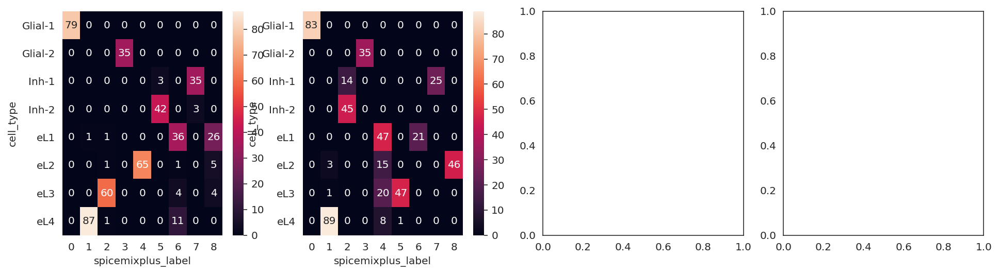

sil 0.62355137


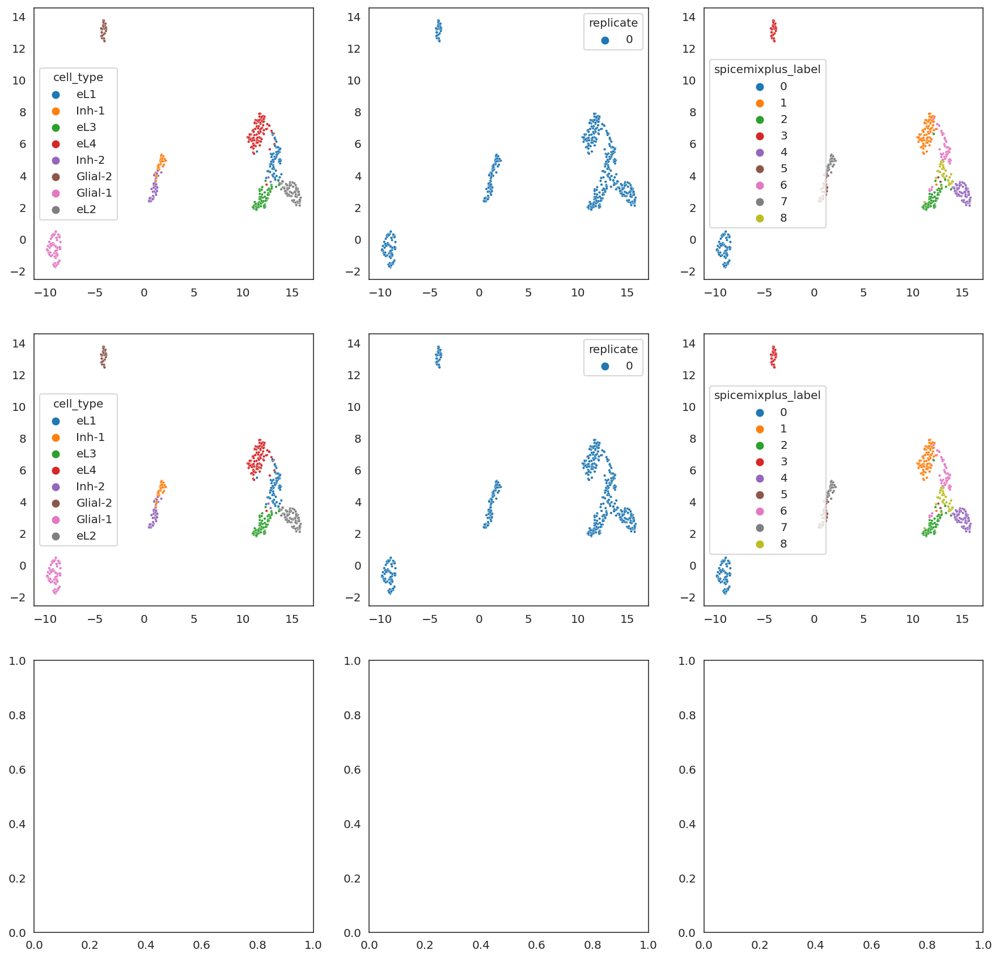

sil 0.6457886


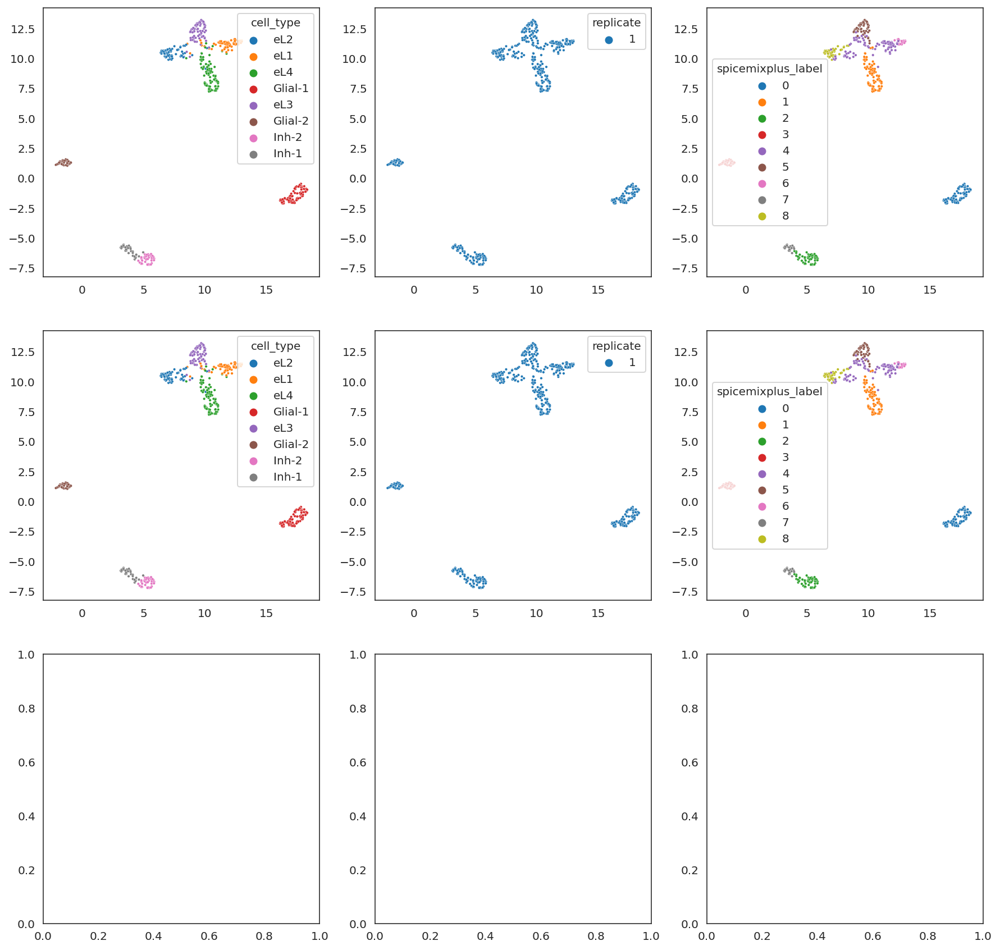

Done


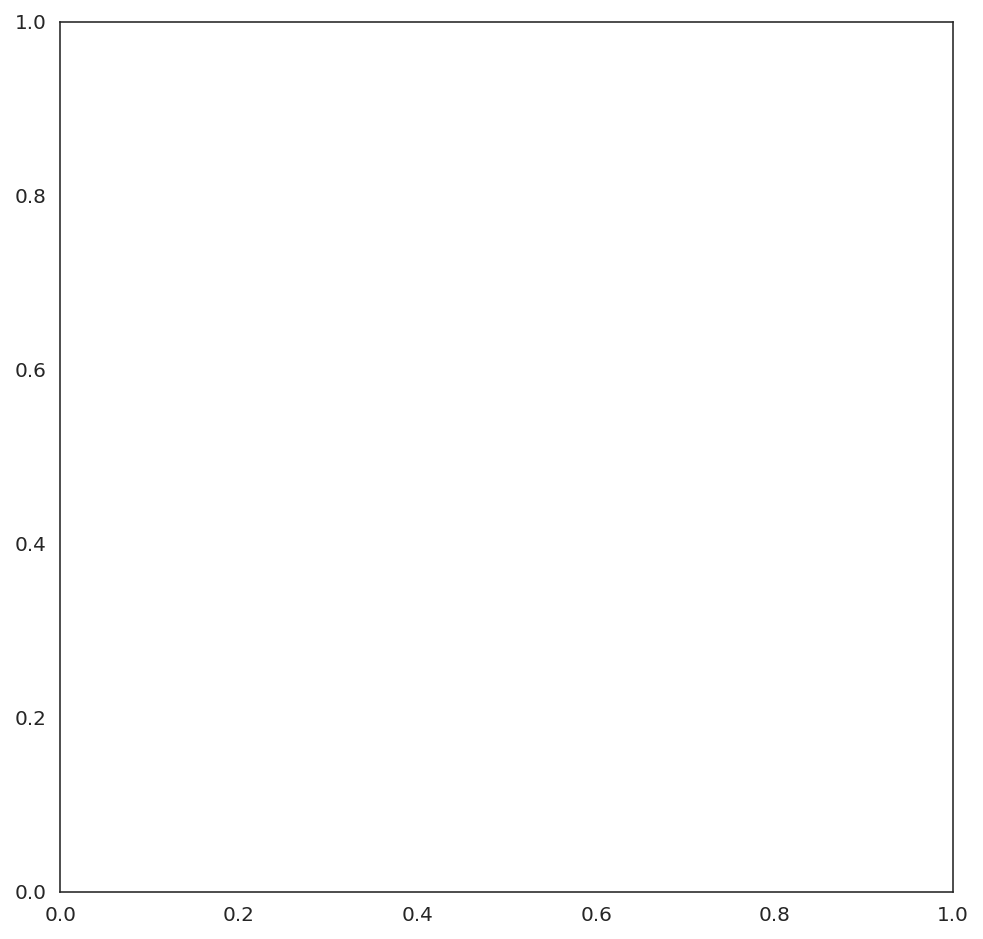

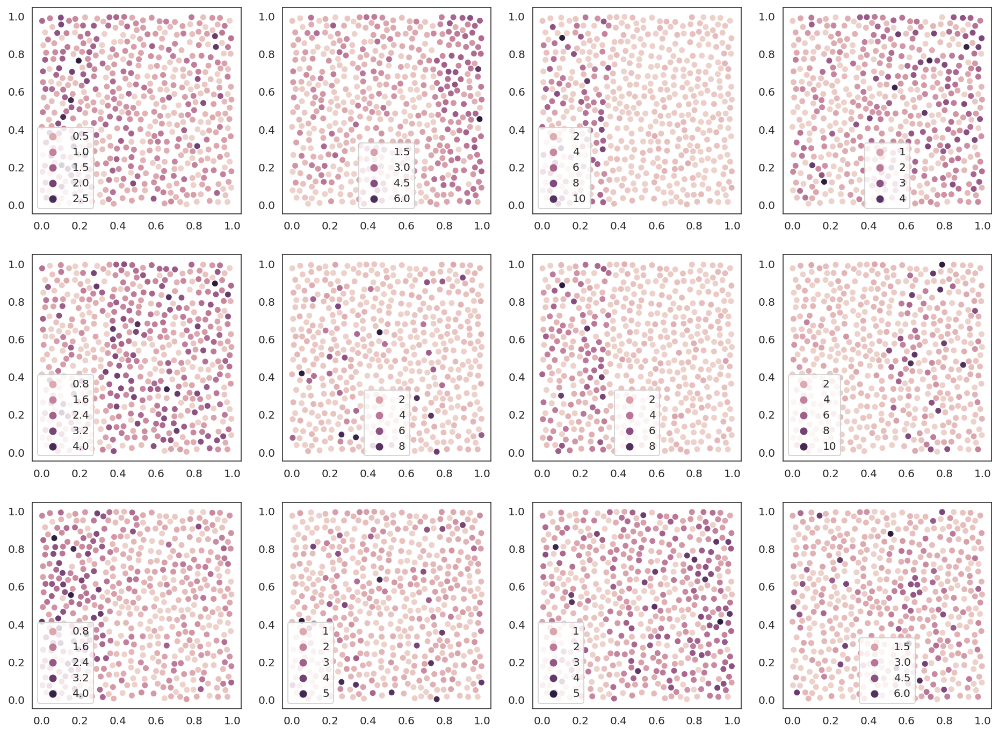

==== iteration 11 ====
1.9773e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.458933583561032e-08
M NAG Loss: 24968.25
M NAG Loss: 24962.5
M NAG Loss: 24959.5
M NAG Loss: 24957.125
M NAG Loss: 24955.625
M NAG Loss: 24954.125
M NAG Loss: 24952.625
M NAG Loss: 24951.75
M NAG Loss: 24950.125
M NAG Loss: 24949.0
M NAG Loss: 24948.0
M NAG Loss: 24946.75
M NAG Loss: 24945.75
M NAG Loss: 24945.125
M NAG Loss: 24943.875
M NAG Loss: 24943.125
M NAG Loss: 24942.625
M NAG Loss: 24942.0
M NAG Loss: 24941.375
M NAG Loss: 24941.125
M NAG Loss: 24940.25
M NAG Loss: 24940.0
M NAG Loss: 24939.625
M NAG Loss: 24939.375
M NAG Loss: 24938.75
M NAG Loss: 24938.875
M NAG Loss: 24938.5
M NAG Loss: 24938.375
M NAG Loss: 24938.125
M NAG Loss: 24937.875
M NAG Loss: 24937.625
M NAG Loss: 24937.375
M NAG Loss: 24937.625
M NAG Loss: 24937.5
M NAG Loss: 24937.375
M NAG Loss: 24937.125
M NAG Loss: 24937.25
M NAG Loss: 24937.125
M NAG Loss: 24937.375
M NAG Loss: 24937.125
M NAG Loss: 24937.125
M NAG Loss: 24937.25
M NAG Loss: 24937.25
M NAG Loss: 24937.125
M NAG Loss: 24937.125
M NAG Loss: 2

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -9967.7841796875
Function value: -1901.3199462890625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -67570.5
Function value: -3979.63330078125
==== iteration 12 ====
1.3841e-03


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.448284756254837e-08
M NAG Loss: 24974.5
M NAG Loss: 24969.5
M NAG Loss: 24967.0
M NAG Loss: 24965.125
M NAG Loss: 24963.75
M NAG Loss: 24962.75
M NAG Loss: 24961.625
M NAG Loss: 24960.5
M NAG Loss: 24959.5
M NAG Loss: 24958.75
M NAG Loss: 24957.75
M NAG Loss: 24956.75
M NAG Loss: 24956.0
M NAG Loss: 24955.25
M NAG Loss: 24954.5
M NAG Loss: 24954.0
M NAG Loss: 24953.25
M NAG Loss: 24952.75
M NAG Loss: 24952.25
M NAG Loss: 24951.5
M NAG Loss: 24951.5
M NAG Loss: 24950.75
M NAG Loss: 24950.75
M NAG Loss: 24950.25
M NAG Loss: 24950.125
M NAG Loss: 24950.0
M NAG Loss: 24950.0
M NAG Loss: 24949.75
M NAG Loss: 24949.375
M NAG Loss: 24949.25
M NAG Loss: 24949.25
M NAG Loss: 24949.125
M NAG Loss: 24949.0
M NAG Loss: 24948.75
M NAG Loss: 24949.0
M NAG Loss: 24948.625
M NAG Loss: 24949.0
M NAG Loss: 24949.0
M NAG Loss: 24948.75
M NAG Loss: 24948.75
M NAG Loss: 24948.75
M NAG Loss: 24948.5
M NAG Loss: 24948.5
M NAG Loss: 24948.625
M NAG Loss: 24948.25
M NAG Loss: 24948.75
M NAG Loss: 24948.75
M 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3629.826171875
Function value: -3913.982421875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1870.7088623046875
Function value: -4815.6455078125
==== iteration 13 ====
9.6889e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.443225071258847e-08
M NAG Loss: 24980.875
M NAG Loss: 24975.5
M NAG Loss: 24973.375
M NAG Loss: 24972.0
M NAG Loss: 24970.875
M NAG Loss: 24969.625
M NAG Loss: 24968.75
M NAG Loss: 24968.0
M NAG Loss: 24967.125
M NAG Loss: 24966.375
M NAG Loss: 24965.625
M NAG Loss: 24964.875
M NAG Loss: 24964.375
M NAG Loss: 24963.625
M NAG Loss: 24963.0
M NAG Loss: 24962.375
M NAG Loss: 24962.125
M NAG Loss: 24961.75
M NAG Loss: 24961.25
M NAG Loss: 24960.625
M NAG Loss: 24960.375
M NAG Loss: 24960.125
M NAG Loss: 24959.875
M NAG Loss: 24959.625
M NAG Loss: 24959.375
M NAG Loss: 24959.375
M NAG Loss: 24959.125
M NAG Loss: 24958.875
M NAG Loss: 24958.625
M NAG Loss: 24958.625
M NAG Loss: 24958.625
M NAG Loss: 24958.625
M NAG Loss: 24958.375
M NAG Loss: 24958.375
M NAG Loss: 24958.375
M NAG Loss: 24958.125
M NAG Loss: 24958.375
M NAG Loss: 24958.125
M NAG Loss: 24958.25
M NAG Loss: 24958.125
M NAG Loss: 24957.875
M NAG Loss: 24958.0
M NAG Loss: 24957.875
M NAG Loss: 24958.0
M NAG Loss: 24958.0
M NAG 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -14384.8408203125
Function value: -2983.27783203125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -2541.542236328125
Function value: -88750.96875
==== iteration 14 ====
6.7822e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.439576296486336e-08
M NAG Loss: 24983.375
M NAG Loss: 24978.625
M NAG Loss: 24977.0
M NAG Loss: 24975.625
M NAG Loss: 24974.75
M NAG Loss: 24973.5
M NAG Loss: 24973.0
M NAG Loss: 24972.125
M NAG Loss: 24971.5
M NAG Loss: 24971.0
M NAG Loss: 24970.25
M NAG Loss: 24969.875
M NAG Loss: 24969.125
M NAG Loss: 24968.75
M NAG Loss: 24968.0
M NAG Loss: 24967.75
M NAG Loss: 24967.25
M NAG Loss: 24966.625
M NAG Loss: 24966.25
M NAG Loss: 24966.0
M NAG Loss: 24965.75
M NAG Loss: 24965.25
M NAG Loss: 24965.25
M NAG Loss: 24965.0
M NAG Loss: 24964.75
M NAG Loss: 24964.5
M NAG Loss: 24964.75
M NAG Loss: 24964.375
M NAG Loss: 24964.25
M NAG Loss: 24964.25
M NAG Loss: 24964.0
M NAG Loss: 24963.875
M NAG Loss: 24963.875
M NAG Loss: 24963.875
M NAG Loss: 24964.0
M NAG Loss: 24963.625
M NAG Loss: 24963.75
M NAG Loss: 24963.5
M NAG Loss: 24963.375
M NAG Loss: 24963.5
M NAG Loss: 24963.625
M NAG Loss: 24963.375
M NAG Loss: 24963.5
M NAG Loss: 24963.5
M NAG Loss: 24963.75
M NAG Loss: 24963.5
M NAG Loss: 2

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -78613.71875
Function value: -4175.7138671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -9948.931640625
Function value: -52031.8671875
==== iteration 15 ====
4.7476e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.437843394566666e-08
M NAG Loss: 24986.0
M NAG Loss: 24981.625
M NAG Loss: 24980.0
M NAG Loss: 24978.625
M NAG Loss: 24978.125
M NAG Loss: 24977.125
M NAG Loss: 24976.375
M NAG Loss: 24975.875
M NAG Loss: 24975.25
M NAG Loss: 24974.625
M NAG Loss: 24974.125
M NAG Loss: 24973.875
M NAG Loss: 24973.25
M NAG Loss: 24972.5
M NAG Loss: 24972.25
M NAG Loss: 24971.875
M NAG Loss: 24971.375
M NAG Loss: 24971.125
M NAG Loss: 24970.625
M NAG Loss: 24970.25
M NAG Loss: 24970.125
M NAG Loss: 24970.0
M NAG Loss: 24969.75
M NAG Loss: 24969.5
M NAG Loss: 24969.375
M NAG Loss: 24969.375
M NAG Loss: 24969.125
M NAG Loss: 24969.125
M NAG Loss: 24968.875
M NAG Loss: 24968.875
M NAG Loss: 24968.875
M NAG Loss: 24968.875
M NAG Loss: 24968.625
M NAG Loss: 24968.375
M NAG Loss: 24968.5
M NAG Loss: 24968.25
M NAG Loss: 24968.375
M NAG Loss: 24968.5
M NAG Loss: 24968.5
M NAG Loss: 24968.25
M NAG Loss: 24968.375
M NAG Loss: 24968.375
M NAG Loss: 24968.0
M NAG Loss: 24968.25
M NAG Loss: 24968.375
M NAG Loss: 24

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -66369.84375
Function value: -4969.03369140625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -5239.3349609375
Function value: -4042.000732421875
==== iteration 16 ====
3.3233e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.430935164726475e-08
M NAG Loss: 24990.875
M NAG Loss: 24985.625
M NAG Loss: 24983.875
M NAG Loss: 24983.125
M NAG Loss: 24981.875
M NAG Loss: 24981.375
M NAG Loss: 24980.875
M NAG Loss: 24980.375
M NAG Loss: 24979.75
M NAG Loss: 24979.375
M NAG Loss: 24978.875
M NAG Loss: 24978.375
M NAG Loss: 24977.875
M NAG Loss: 24977.75
M NAG Loss: 24977.125
M NAG Loss: 24976.875
M NAG Loss: 24976.625
M NAG Loss: 24976.25
M NAG Loss: 24975.875
M NAG Loss: 24975.5
M NAG Loss: 24975.375
M NAG Loss: 24974.875
M NAG Loss: 24974.875
M NAG Loss: 24975.125
M NAG Loss: 24974.875
M NAG Loss: 24974.625
M NAG Loss: 24974.375
M NAG Loss: 24974.375
M NAG Loss: 24974.25
M NAG Loss: 24974.375
M NAG Loss: 24974.125
M NAG Loss: 24974.125
M NAG Loss: 24973.875
M NAG Loss: 24973.875
M NAG Loss: 24973.75
M NAG Loss: 24973.875
M NAG Loss: 24973.625
M NAG Loss: 24973.75
M NAG Loss: 24973.875
M NAG Loss: 24973.75
M NAG Loss: 24973.625
M NAG Loss: 24973.625
M NAG Loss: 24973.875
M NAG Loss: 24973.625
M NAG Loss: 24973.6

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6850.18505859375
Function value: -8652.767578125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -69940.46875
Function value: -73441.5390625
==== iteration 17 ====
2.3263e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.423613408445074e-08
M NAG Loss: 24991.5
M NAG Loss: 24987.25
M NAG Loss: 24986.0
M NAG Loss: 24985.125
M NAG Loss: 24984.25
M NAG Loss: 24983.75
M NAG Loss: 24983.25
M NAG Loss: 24982.5
M NAG Loss: 24982.25
M NAG Loss: 24982.0
M NAG Loss: 24981.625
M NAG Loss: 24980.875
M NAG Loss: 24980.625
M NAG Loss: 24980.125
M NAG Loss: 24980.0
M NAG Loss: 24979.5
M NAG Loss: 24979.375
M NAG Loss: 24979.0
M NAG Loss: 24978.5
M NAG Loss: 24978.75
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24978.25
M NAG Loss: 24977.75
M NAG Loss: 24977.875
M NAG Loss: 24977.5
M NAG Loss: 24977.5
M NAG Loss: 24977.25
M NAG Loss: 24977.25
M NAG Loss: 24977.25
M NAG Loss: 24977.125
M NAG Loss: 24977.0
M NAG Loss: 24977.0
M NAG Loss: 24977.0
M NAG Loss: 24976.875
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 24977.0
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 24976.875
M NAG Loss: 24976.625
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 24976.75
M NAG Loss: 249

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -63379.046875
Function value: -4200.07763671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6680.951171875
Function value: -16736.76953125
==== iteration 18 ====
1.6284e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.410166832284011e-08
M NAG Loss: 24999.0
M NAG Loss: 24992.125
M NAG Loss: 24990.625
M NAG Loss: 24990.0
M NAG Loss: 24989.5
M NAG Loss: 24988.625
M NAG Loss: 24988.25
M NAG Loss: 24988.0
M NAG Loss: 24987.5
M NAG Loss: 24987.0
M NAG Loss: 24986.75
M NAG Loss: 24986.375
M NAG Loss: 24986.0
M NAG Loss: 24985.625
M NAG Loss: 24985.5
M NAG Loss: 24985.0
M NAG Loss: 24985.0
M NAG Loss: 24984.625
M NAG Loss: 24984.25
M NAG Loss: 24984.0
M NAG Loss: 24983.75
M NAG Loss: 24983.75
M NAG Loss: 24983.625
M NAG Loss: 24983.5
M NAG Loss: 24983.25
M NAG Loss: 24983.25
M NAG Loss: 24983.125
M NAG Loss: 24983.0
M NAG Loss: 24982.875
M NAG Loss: 24982.75
M NAG Loss: 24982.75
M NAG Loss: 24982.75
M NAG Loss: 24982.625
M NAG Loss: 24982.75
M NAG Loss: 24982.5
M NAG Loss: 24982.75
M NAG Loss: 24982.625
M NAG Loss: 24982.375
M NAG Loss: 24982.625
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.5
M NAG Loss: 24982.25

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -12971.498046875
Function value: -113914.890625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -10417.1201171875
Function value: -7121.076171875
==== iteration 19 ====
1.1399e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.390127508604307e-08
M NAG Loss: 25003.375
M NAG Loss: 24994.875
M NAG Loss: 24993.375
M NAG Loss: 24992.625
M NAG Loss: 24992.125
M NAG Loss: 24991.375
M NAG Loss: 24991.125
M NAG Loss: 24990.75
M NAG Loss: 24990.375
M NAG Loss: 24989.875
M NAG Loss: 24989.625
M NAG Loss: 24989.25
M NAG Loss: 24989.125
M NAG Loss: 24988.625
M NAG Loss: 24988.125
M NAG Loss: 24988.25
M NAG Loss: 24987.75
M NAG Loss: 24987.625
M NAG Loss: 24987.375
M NAG Loss: 24987.25
M NAG Loss: 24987.0
M NAG Loss: 24987.0
M NAG Loss: 24986.375
M NAG Loss: 24986.625
M NAG Loss: 24986.625
M NAG Loss: 24986.375
M NAG Loss: 24986.375
M NAG Loss: 24986.375
M NAG Loss: 24986.0
M NAG Loss: 24985.875
M NAG Loss: 24986.125
M NAG Loss: 24985.75
M NAG Loss: 24985.875
M NAG Loss: 24985.625
M NAG Loss: 24985.625
M NAG Loss: 24985.875
M NAG Loss: 24985.625
M NAG Loss: 24985.75
M NAG Loss: 24985.875
M NAG Loss: 24985.625
M NAG Loss: 24985.625
M NAG Loss: 24985.75
M NAG Loss: 24985.75
M NAG Loss: 24985.625
M NAG Loss: 24985.875
M N

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -92901.5078125
Function value: -93131.5078125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6227.47509765625
Function value: -3002.5751953125
==== iteration 20 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.357136826944496e-08
M NAG Loss: 25020.5
M NAG Loss: 25004.125
M NAG Loss: 25002.5
M NAG Loss: 25001.5
M NAG Loss: 25000.625
M NAG Loss: 25000.25
M NAG Loss: 24999.75
M NAG Loss: 24999.5
M NAG Loss: 24998.875
M NAG Loss: 24998.75
M NAG Loss: 24998.375
M NAG Loss: 24998.25
M NAG Loss: 24997.625
M NAG Loss: 24997.375
M NAG Loss: 24997.375
M NAG Loss: 24996.875
M NAG Loss: 24997.0
M NAG Loss: 24996.625
M NAG Loss: 24996.5
M NAG Loss: 24996.25
M NAG Loss: 24996.0
M NAG Loss: 24995.875
M NAG Loss: 24995.625
M NAG Loss: 24995.5
M NAG Loss: 24995.375
M NAG Loss: 24995.25
M NAG Loss: 24995.25
M NAG Loss: 24994.875
M NAG Loss: 24995.0
M NAG Loss: 24995.0
M NAG Loss: 24994.875
M NAG Loss: 24994.75
M NAG Loss: 24994.75
M NAG Loss: 24994.75
M NAG Loss: 24994.875
M NAG Loss: 24994.5
M NAG Loss: 24994.5
M NAG Loss: 24994.625
M NAG Loss: 24994.5
M NAG Loss: 24994.75
M NAG Loss: 24994.25
M NAG Loss: 24994.5
M NAG Loss: 24994.375
M NAG Loss: 24994.5
M NAG Loss: 24994.75
M NAG Loss: 24994.5
M NAG Loss:

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -74901.65625
Function value: -15660.080078125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -15365.5517578125
Function value: -4376.59814453125
replicate 0hierarchical w/ K=6.ARI = 0.54
replicate 0hierarchical w/ K=7.ARI = 0.66
replicate 0hierarchical w/ K=8.ARI = 0.68
replicate 0hierarchical w/ K=9.ARI = 0.70
replicate 1hierarchical w/ K=6.ARI = 0.70
replicate 1hierarchical w/ K=7.ARI = 0.80
replicate 1hierarchical w/ K=8.ARI = 0.82
replicate 1hierarchical w/ K=9.ARI = 0.80


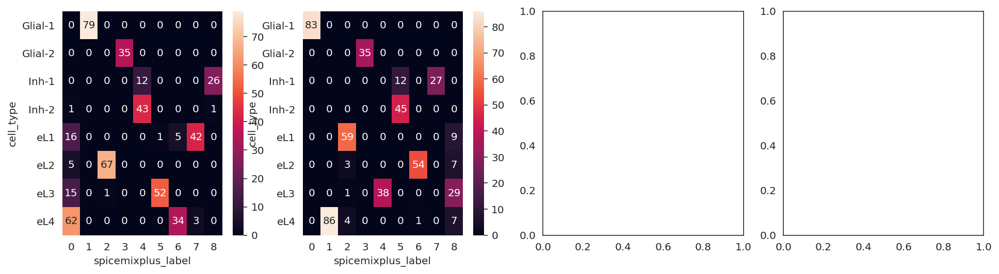

sil 0.6119551


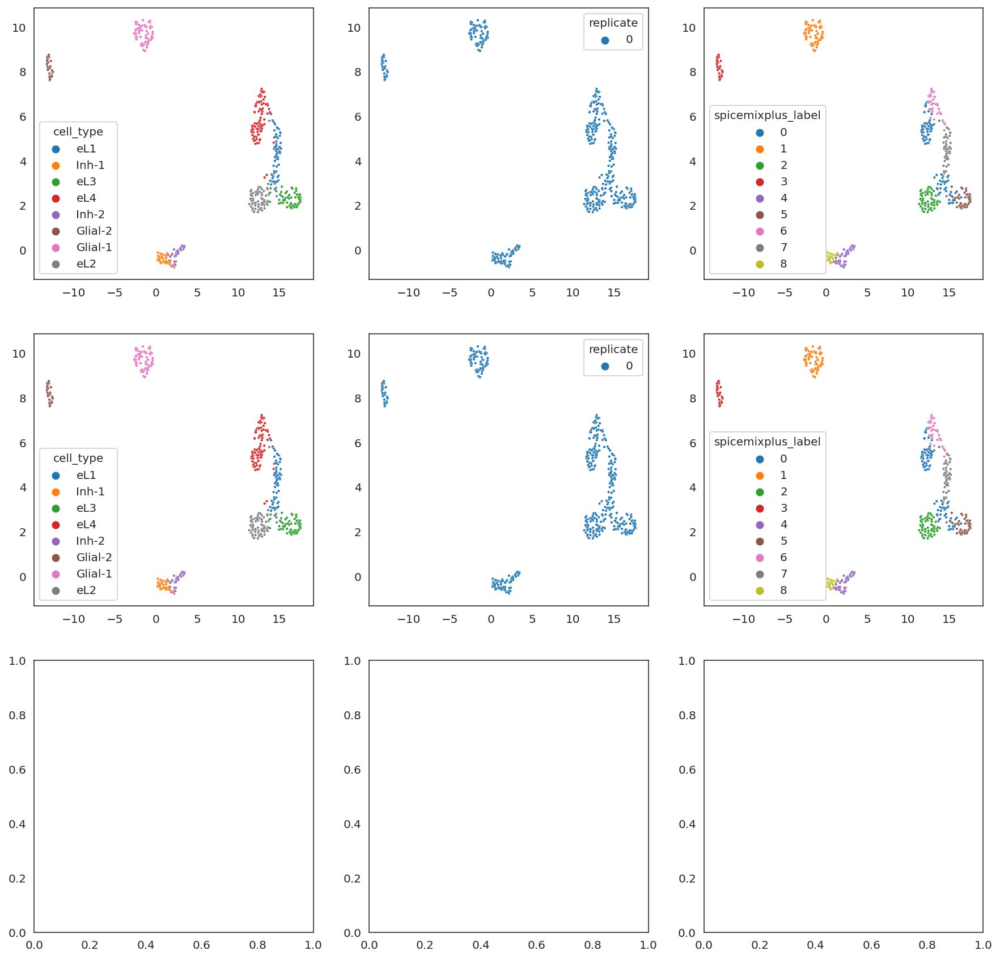

sil 0.62647516


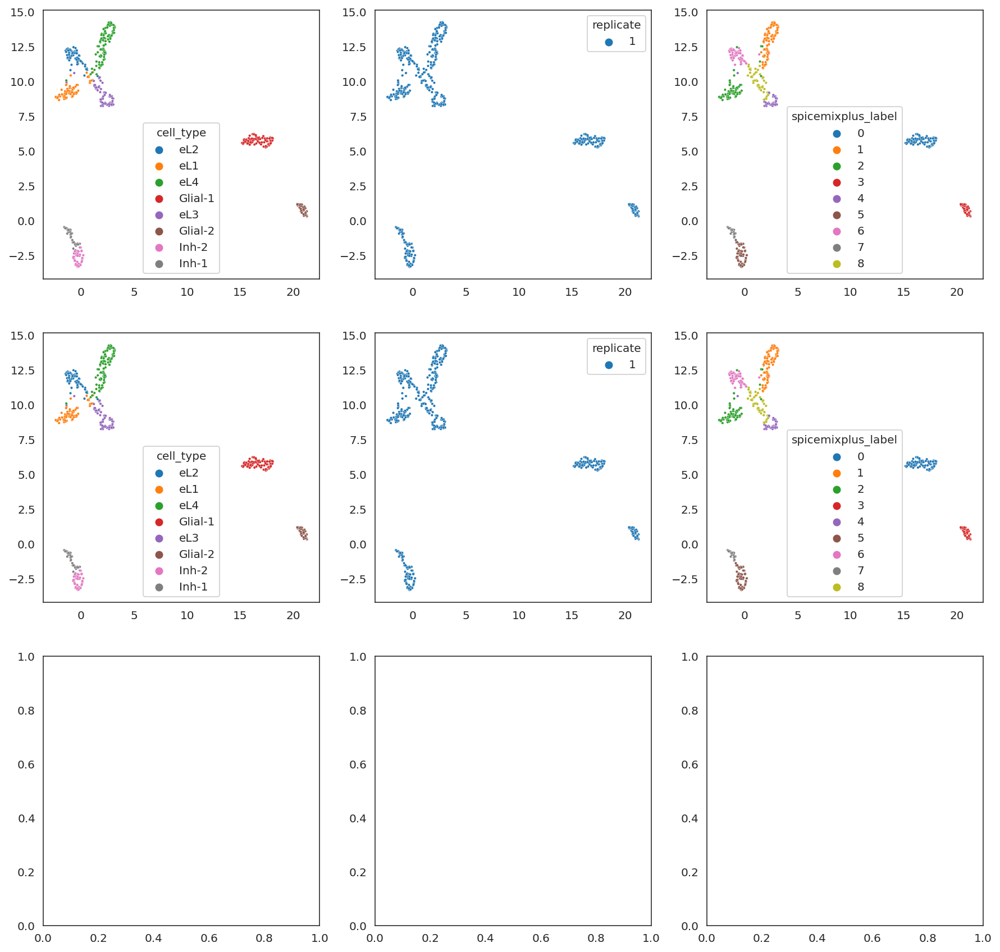

Done


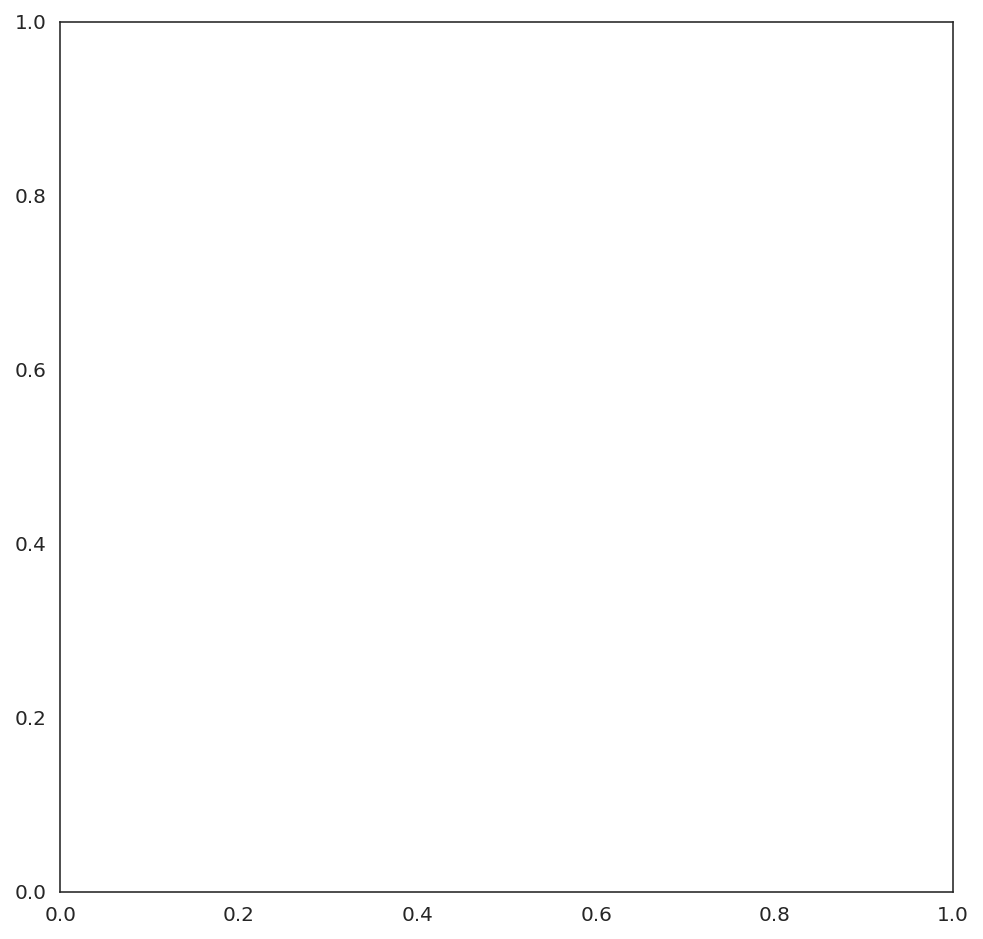

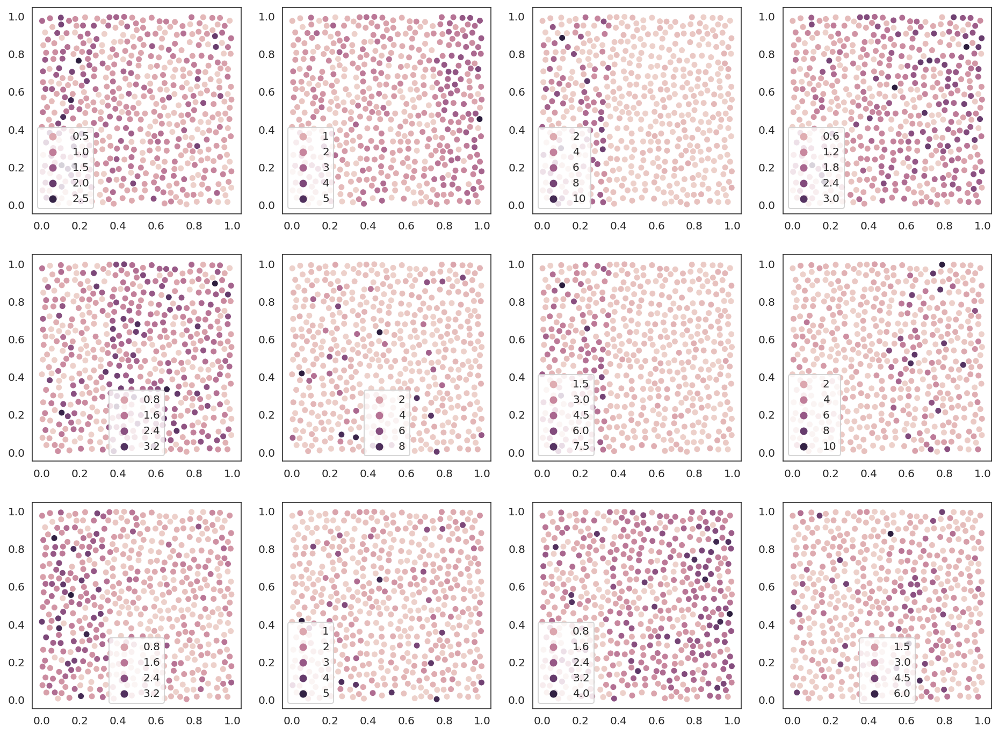

==== iteration 21 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.322102792080833e-08
M NAG Loss: 25018.625
M NAG Loss: 25004.375
M NAG Loss: 25002.875
M NAG Loss: 25001.625
M NAG Loss: 25001.125
M NAG Loss: 25000.625
M NAG Loss: 25000.0
M NAG Loss: 24999.75
M NAG Loss: 24999.375
M NAG Loss: 24999.125
M NAG Loss: 24998.75
M NAG Loss: 24998.375
M NAG Loss: 24998.375
M NAG Loss: 24998.0
M NAG Loss: 24997.625
M NAG Loss: 24997.375
M NAG Loss: 24997.125
M NAG Loss: 24997.125
M NAG Loss: 24996.875
M NAG Loss: 24996.625
M NAG Loss: 24996.5
M NAG Loss: 24996.375
M NAG Loss: 24995.875
M NAG Loss: 24996.0
M NAG Loss: 24995.875
M NAG Loss: 24995.875
M NAG Loss: 24995.75
M NAG Loss: 24995.75
M NAG Loss: 24995.625
M NAG Loss: 24995.625
M NAG Loss: 24995.375
M NAG Loss: 24995.25
M NAG Loss: 24995.625
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24995.25
M NAG Loss: 24995.375
M NAG Loss: 24995.25
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24995.375
M NAG Loss: 24995.375
M NAG Loss: 24995.375
M NAG Loss: 24995.125
M NAG Loss: 24995.25
M NA

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4230.57177734375
Function value: -10323.6435546875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1825.425048828125
Function value: -9996.142578125
==== iteration 22 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.281703758871023e-08
M NAG Loss: 25019.0
M NAG Loss: 25006.0
M NAG Loss: 25004.125
M NAG Loss: 25003.25
M NAG Loss: 25002.5
M NAG Loss: 25002.0
M NAG Loss: 25001.75
M NAG Loss: 25001.25
M NAG Loss: 25000.875
M NAG Loss: 25000.625
M NAG Loss: 25000.25
M NAG Loss: 25000.125
M NAG Loss: 24999.75
M NAG Loss: 24999.375
M NAG Loss: 24999.25
M NAG Loss: 24999.0
M NAG Loss: 24998.875
M NAG Loss: 24998.625
M NAG Loss: 24998.625
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24997.75
M NAG Loss: 24997.875
M NAG Loss: 24997.75
M NAG Loss: 24997.75
M NAG Loss: 24997.25
M NAG Loss: 24997.375
M NAG Loss: 24997.375
M NAG Loss: 24997.125
M NAG Loss: 24997.0
M NAG Loss: 24997.375
M NAG Loss: 24997.125
M NAG Loss: 24997.375
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24996.875
M NAG Loss: 24997.125
M NAG Loss: 24997.0
M NAG Loss: 24997.125
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Los

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6188.3955078125
Function value: -12144.970703125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -63469.234375
Function value: -80075.671875
==== iteration 23 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.242309474727136e-08
M NAG Loss: 25016.25
M NAG Loss: 25005.5
M NAG Loss: 25004.0
M NAG Loss: 25003.25
M NAG Loss: 25002.5
M NAG Loss: 25002.0
M NAG Loss: 25001.375
M NAG Loss: 25001.125
M NAG Loss: 25001.0
M NAG Loss: 25000.375
M NAG Loss: 25000.375
M NAG Loss: 25000.25
M NAG Loss: 25000.0
M NAG Loss: 24999.75
M NAG Loss: 24999.25
M NAG Loss: 24999.125
M NAG Loss: 24999.0
M NAG Loss: 24998.75
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24998.125
M NAG Loss: 24998.125
M NAG Loss: 24998.0
M NAG Loss: 24998.0
M NAG Loss: 24997.875
M NAG Loss: 24998.0
M NAG Loss: 24997.625
M NAG Loss: 24997.25
M NAG Loss: 24997.5
M NAG Loss: 24997.5
M NAG Loss: 24997.25
M NAG Loss: 24997.625
M NAG Loss: 24997.5
M NAG Loss: 24997.25
M NAG Loss: 24997.25
M NAG Loss: 24997.25
M NAG Loss: 24997.0
M NAG Loss: 24997.125
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.375
M NAG Loss: 24997.25
M NAG Loss: 24997.0
M NAG Loss: 24997.25
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.1

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3400.625732421875
Function value: -5416.904296875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6581.1923828125
Function value: -523.3412475585938
==== iteration 24 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.189508387155235e-08
M NAG Loss: 25031.0
M NAG Loss: 25015.25
M NAG Loss: 25013.375
M NAG Loss: 25012.625
M NAG Loss: 25011.875
M NAG Loss: 25011.0
M NAG Loss: 25010.75
M NAG Loss: 25010.5
M NAG Loss: 25010.125
M NAG Loss: 25009.75
M NAG Loss: 25009.375
M NAG Loss: 25009.125
M NAG Loss: 25009.0
M NAG Loss: 25008.625
M NAG Loss: 25008.625
M NAG Loss: 25008.25
M NAG Loss: 25008.125
M NAG Loss: 25007.875
M NAG Loss: 25007.625
M NAG Loss: 25007.5
M NAG Loss: 25007.75
M NAG Loss: 25007.25
M NAG Loss: 25007.125
M NAG Loss: 25007.0
M NAG Loss: 25007.0
M NAG Loss: 25006.875
M NAG Loss: 25006.75
M NAG Loss: 25006.75
M NAG Loss: 25006.625
M NAG Loss: 25006.75
M NAG Loss: 25006.625
M NAG Loss: 25006.375
M NAG Loss: 25006.375
M NAG Loss: 25006.5
M NAG Loss: 25006.5
M NAG Loss: 25006.375
M NAG Loss: 25006.5
M NAG Loss: 25006.0
M NAG Loss: 25006.5
M NAG Loss: 25006.25
M NAG Loss: 25006.375
M NAG Loss: 25006.25
M NAG Loss: 25006.25
M NAG Loss: 25006.25
M NAG Loss: 25006.25
M NAG Loss: 25006.25
M NAG

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -2024.41845703125
Function value: -47765.23046875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -5179.6171875
Function value: -90289.265625
==== iteration 25 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.138241045288433e-08
M NAG Loss: 25022.375
M NAG Loss: 25010.625
M NAG Loss: 25009.0
M NAG Loss: 25008.125
M NAG Loss: 25007.125
M NAG Loss: 25006.625
M NAG Loss: 25006.375
M NAG Loss: 25005.875
M NAG Loss: 25005.5
M NAG Loss: 25005.25
M NAG Loss: 25004.875
M NAG Loss: 25004.875
M NAG Loss: 25004.625
M NAG Loss: 25004.375
M NAG Loss: 25003.875
M NAG Loss: 25003.875
M NAG Loss: 25003.625
M NAG Loss: 25003.375
M NAG Loss: 25003.125
M NAG Loss: 25003.125
M NAG Loss: 25003.125
M NAG Loss: 25002.625
M NAG Loss: 25002.75
M NAG Loss: 25002.625
M NAG Loss: 25002.5
M NAG Loss: 25002.375
M NAG Loss: 25002.25
M NAG Loss: 25002.0
M NAG Loss: 25002.125
M NAG Loss: 25002.125
M NAG Loss: 25002.0
M NAG Loss: 25002.125
M NAG Loss: 25001.875
M NAG Loss: 25002.0
M NAG Loss: 25001.625
M NAG Loss: 25001.875
M NAG Loss: 25002.0
M NAG Loss: 25001.875
M NAG Loss: 25001.75
M NAG Loss: 25001.875
M NAG Loss: 25001.625
M NAG Loss: 25001.75
M NAG Loss: 25001.875
M NAG Loss: 25001.875
M NAG Loss: 25001.75
M NAG Lo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -8440.5810546875
Function value: -4549.814453125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -62813.0703125
Function value: -6565.4296875
==== iteration 26 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.090823930116322e-08
M NAG Loss: 25019.375
M NAG Loss: 25009.625
M NAG Loss: 25008.375
M NAG Loss: 25007.25
M NAG Loss: 25006.625
M NAG Loss: 25006.25
M NAG Loss: 25006.0
M NAG Loss: 25005.5
M NAG Loss: 25005.0
M NAG Loss: 25004.875
M NAG Loss: 25004.5
M NAG Loss: 25004.25
M NAG Loss: 25004.0
M NAG Loss: 25003.75
M NAG Loss: 25003.75
M NAG Loss: 25003.25
M NAG Loss: 25003.25
M NAG Loss: 25003.25
M NAG Loss: 25003.0
M NAG Loss: 25003.0
M NAG Loss: 25002.375
M NAG Loss: 25002.5
M NAG Loss: 25002.25
M NAG Loss: 25002.25
M NAG Loss: 25001.875
M NAG Loss: 25002.0
M NAG Loss: 25002.0
M NAG Loss: 25001.75
M NAG Loss: 25001.75
M NAG Loss: 25001.75
M NAG Loss: 25001.875
M NAG Loss: 25001.875
M NAG Loss: 25001.75
M NAG Loss: 25001.625
M NAG Loss: 25001.5
M NAG Loss: 25001.5
M NAG Loss: 25001.375
M NAG Loss: 25001.375
M NAG Loss: 25001.375
M NAG Loss: 25001.5
M NAG Loss: 25001.5
M NAG Loss: 25001.5
M NAG Loss: 25001.375
M NAG Loss: 25001.25
M NAG Loss: 25001.5
M NAG Loss: 25001.75
M NAG Loss: 25

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -68099.421875
Function value: -4601.06982421875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6703.45458984375
Function value: -85357.296875
==== iteration 27 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

6.046692803697866e-08
M NAG Loss: 25017.0
M NAG Loss: 25009.0
M NAG Loss: 25007.75
M NAG Loss: 25006.625
M NAG Loss: 25006.0
M NAG Loss: 25005.25
M NAG Loss: 25005.0
M NAG Loss: 25005.0
M NAG Loss: 25004.25
M NAG Loss: 25004.125
M NAG Loss: 25003.75
M NAG Loss: 25003.5
M NAG Loss: 25003.25
M NAG Loss: 25003.25
M NAG Loss: 25003.0
M NAG Loss: 25002.75
M NAG Loss: 25002.625
M NAG Loss: 25002.5
M NAG Loss: 25002.375
M NAG Loss: 25002.125
M NAG Loss: 25002.125
M NAG Loss: 25002.0
M NAG Loss: 25002.0
M NAG Loss: 25001.75
M NAG Loss: 25001.625
M NAG Loss: 25001.5
M NAG Loss: 25001.375
M NAG Loss: 25001.25
M NAG Loss: 25001.375
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.0
M NAG Loss: 25001.125
M NAG Loss: 25000.75
M NAG Loss: 25001.25
M NAG Loss: 25000.75
M NAG Loss: 25000.75
M NAG Loss: 25001.125
M NAG Loss: 25000.875
M NAG Loss: 25001.0
M NAG Loss: 25000.75
M NAG Loss: 25001.0
M NAG Loss: 25000.875
M NAG Loss: 25000.75
M NAG Loss: 25001.0
M NAG Loss: 25000.75
M NAG Loss: 250

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -62080.66015625
Function value: -1696.708251953125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -7017.7919921875
Function value: -8633.63671875
==== iteration 28 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.991942036349517e-08
M NAG Loss: 25028.625
M NAG Loss: 25016.375
M NAG Loss: 25014.75
M NAG Loss: 25013.625
M NAG Loss: 25012.75
M NAG Loss: 25012.25
M NAG Loss: 25011.75
M NAG Loss: 25011.375
M NAG Loss: 25010.875
M NAG Loss: 25010.625
M NAG Loss: 25010.25
M NAG Loss: 25010.25
M NAG Loss: 25009.875
M NAG Loss: 25009.625
M NAG Loss: 25009.375
M NAG Loss: 25009.375
M NAG Loss: 25009.125
M NAG Loss: 25009.0
M NAG Loss: 25008.75
M NAG Loss: 25008.625
M NAG Loss: 25008.5
M NAG Loss: 25008.375
M NAG Loss: 25008.125
M NAG Loss: 25008.0
M NAG Loss: 25008.125
M NAG Loss: 25007.875
M NAG Loss: 25008.0
M NAG Loss: 25007.75
M NAG Loss: 25007.75
M NAG Loss: 25007.375
M NAG Loss: 25007.625
M NAG Loss: 25007.75
M NAG Loss: 25007.5
M NAG Loss: 25007.375
M NAG Loss: 25007.5
M NAG Loss: 25007.125
M NAG Loss: 25007.375
M NAG Loss: 25007.375
M NAG Loss: 25007.125
M NAG Loss: 25007.5
M NAG Loss: 25007.375
M NAG Loss: 25007.125
M NAG Loss: 25007.25
M NAG Loss: 25007.25
M NAG Loss: 25007.125
M NAG Loss: 25

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -89819.03125
Function value: -12648.4375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3761.03076171875
Function value: -53721.34375
==== iteration 29 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.942671052357903e-08
M NAG Loss: 25023.25
M NAG Loss: 25012.125
M NAG Loss: 25011.125
M NAG Loss: 25010.0
M NAG Loss: 25008.875
M NAG Loss: 25008.5
M NAG Loss: 25008.0
M NAG Loss: 25007.625
M NAG Loss: 25007.125
M NAG Loss: 25007.375
M NAG Loss: 25006.75
M NAG Loss: 25006.625
M NAG Loss: 25006.125
M NAG Loss: 25005.875
M NAG Loss: 25005.75
M NAG Loss: 25005.75
M NAG Loss: 25005.625
M NAG Loss: 25005.5
M NAG Loss: 25005.125
M NAG Loss: 25004.875
M NAG Loss: 25004.75
M NAG Loss: 25004.625
M NAG Loss: 25004.625
M NAG Loss: 25004.5
M NAG Loss: 25004.375
M NAG Loss: 25004.375
M NAG Loss: 25004.375
M NAG Loss: 25004.25
M NAG Loss: 25004.25
M NAG Loss: 25004.0
M NAG Loss: 25004.0
M NAG Loss: 25003.875
M NAG Loss: 25003.875
M NAG Loss: 25003.75
M NAG Loss: 25003.875
M NAG Loss: 25003.875
M NAG Loss: 25003.625
M NAG Loss: 25003.875
M NAG Loss: 25003.875
M NAG Loss: 25003.625
M NAG Loss: 25003.625
M NAG Loss: 25003.625
M NAG Loss: 25003.625
M NAG Loss: 25003.375
M NAG Loss: 25003.625
M NAG Loss

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -7807.23486328125
Function value: -24777.2109375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -90069.03125
Function value: -8553.638671875
==== iteration 30 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.8984091046899195e-08
M NAG Loss: 25021.25
M NAG Loss: 25011.0
M NAG Loss: 25009.75
M NAG Loss: 25009.0
M NAG Loss: 25008.25
M NAG Loss: 25007.75
M NAG Loss: 25007.125
M NAG Loss: 25006.75
M NAG Loss: 25006.25
M NAG Loss: 25006.0
M NAG Loss: 25005.625
M NAG Loss: 25005.5
M NAG Loss: 25005.25
M NAG Loss: 25005.25
M NAG Loss: 25004.875
M NAG Loss: 25004.75
M NAG Loss: 25004.75
M NAG Loss: 25004.5
M NAG Loss: 25004.25
M NAG Loss: 25004.0
M NAG Loss: 25003.75
M NAG Loss: 25004.0
M NAG Loss: 25003.75
M NAG Loss: 25003.5
M NAG Loss: 25003.375
M NAG Loss: 25003.25
M NAG Loss: 25003.25
M NAG Loss: 25003.125
M NAG Loss: 25003.25
M NAG Loss: 25003.0
M NAG Loss: 25003.0
M NAG Loss: 25002.75
M NAG Loss: 25002.75
M NAG Loss: 25003.0
M NAG Loss: 25003.0
M NAG Loss: 25002.5
M NAG Loss: 25002.75
M NAG Loss: 25002.75
M NAG Loss: 25002.625
M NAG Loss: 25002.5
M NAG Loss: 25002.625
M NAG Loss: 25002.875
M NAG Loss: 25002.5
M NAG Loss: 25002.75
M NAG Loss: 25003.0
M NAG Loss: 25002.75
M NAG Loss: 25002.5

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -14992.330078125
Function value: -1835.379638671875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -4563.146484375
Function value: -2740.68896484375
replicate 0hierarchical w/ K=6.ARI = 0.72
replicate 0hierarchical w/ K=7.ARI = 0.78
replicate 0hierarchical w/ K=8.ARI = 0.72
replicate 0hierarchical w/ K=9.ARI = 0.69
replicate 1hierarchical w/ K=6.ARI = 0.71
replicate 1hierarchical w/ K=7.ARI = 0.83
replicate 1hierarchical w/ K=8.ARI = 0.84
replicate 1hierarchical w/ K=9.ARI = 0.83


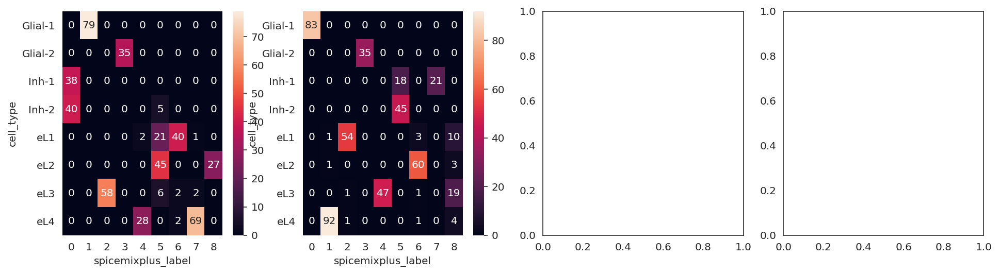

sil 0.603352


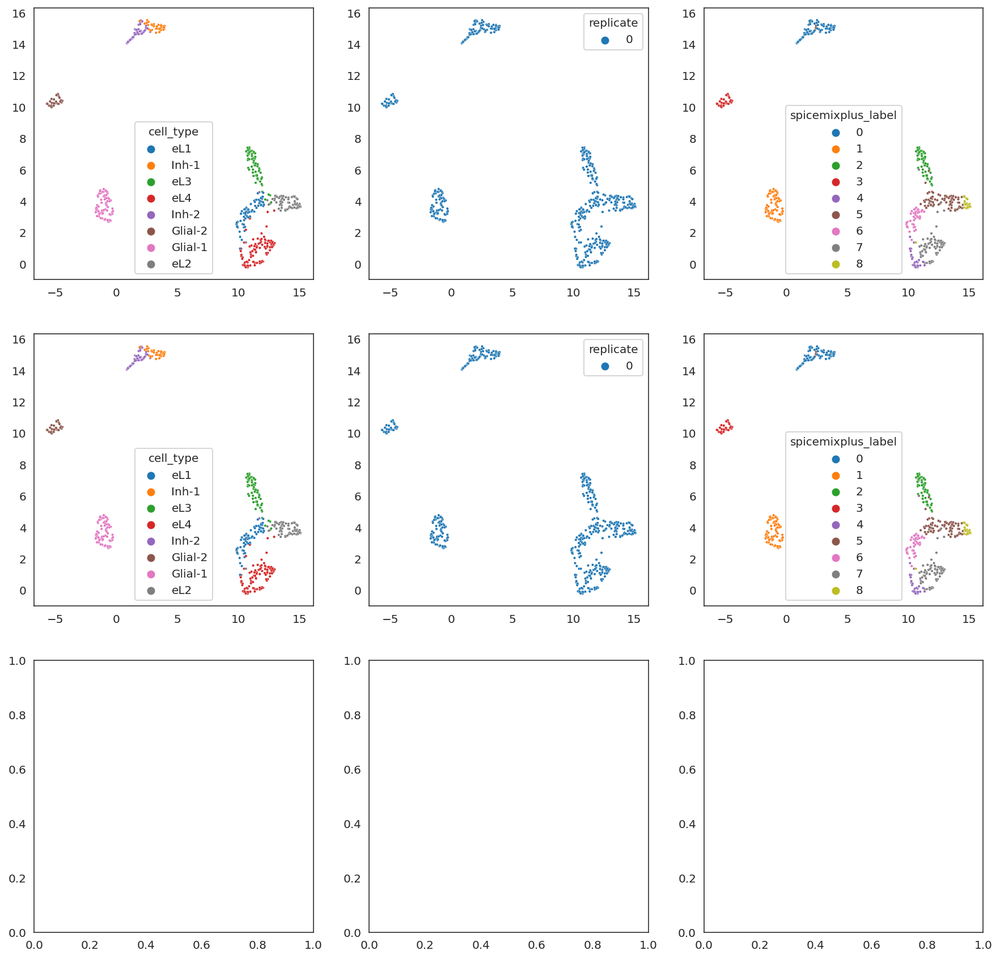

sil 0.6329567


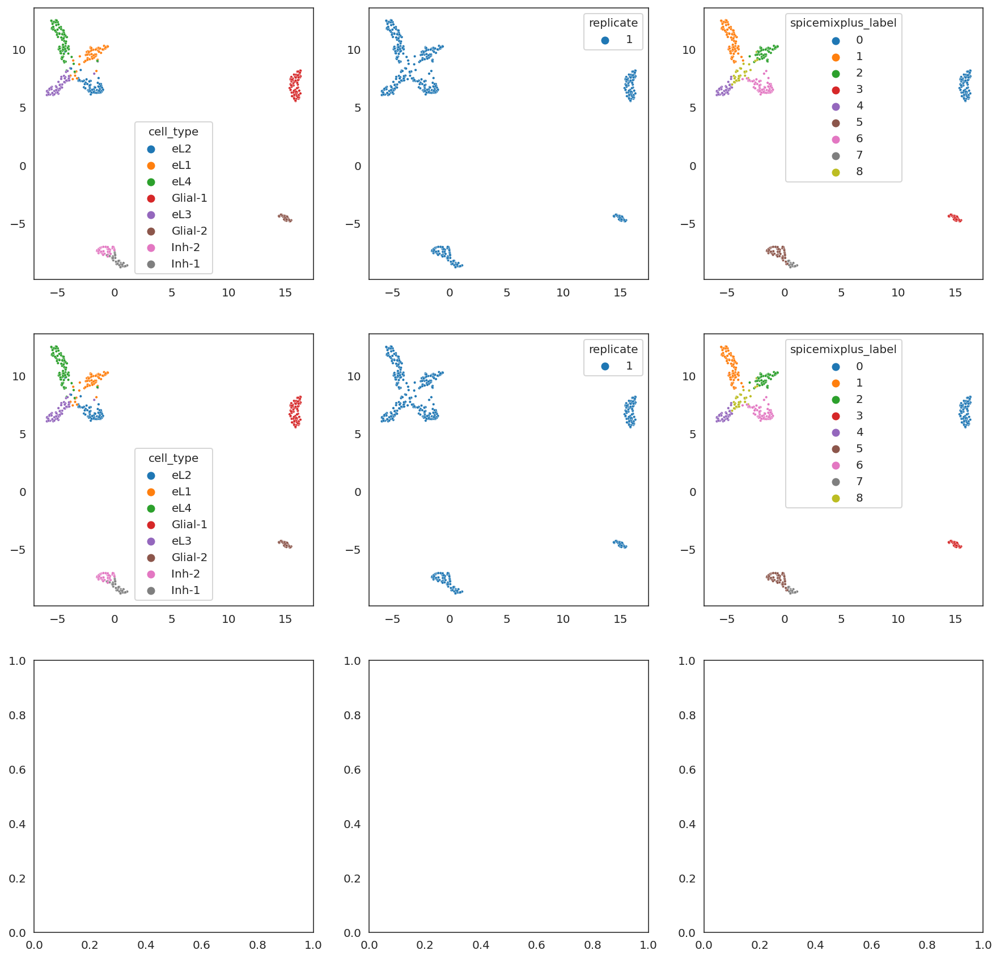

Done


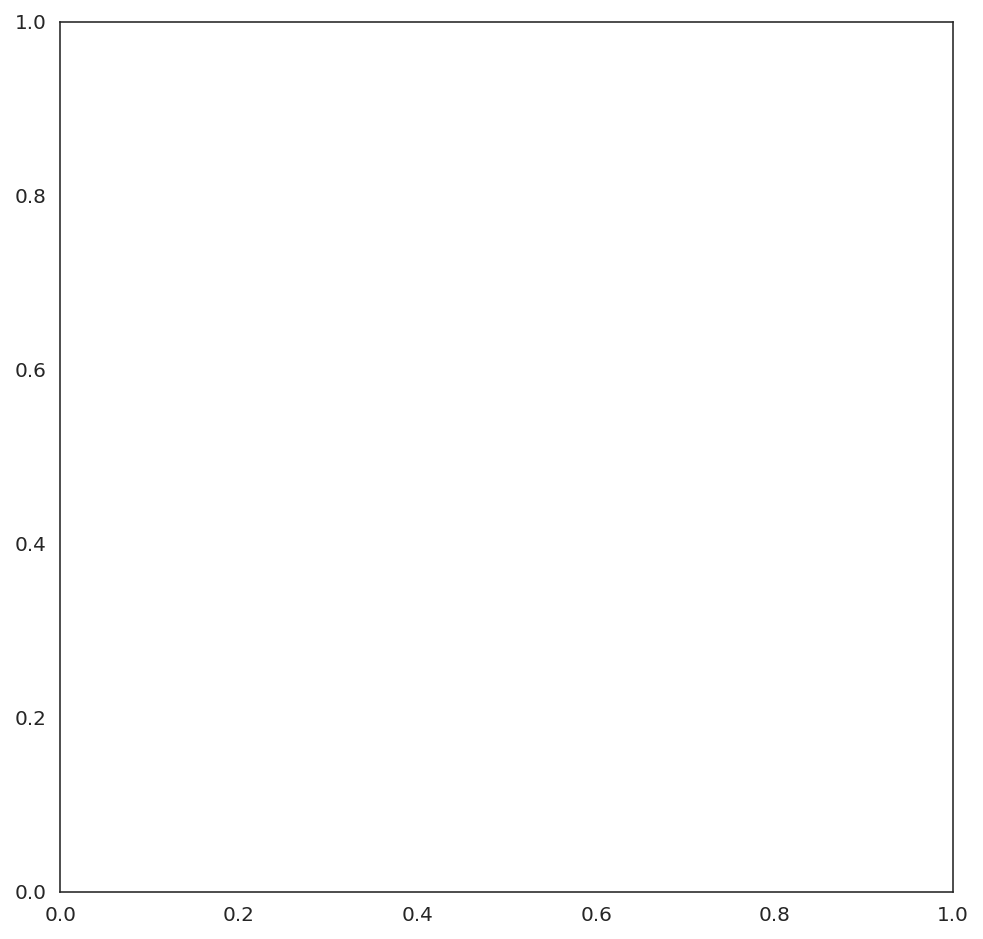

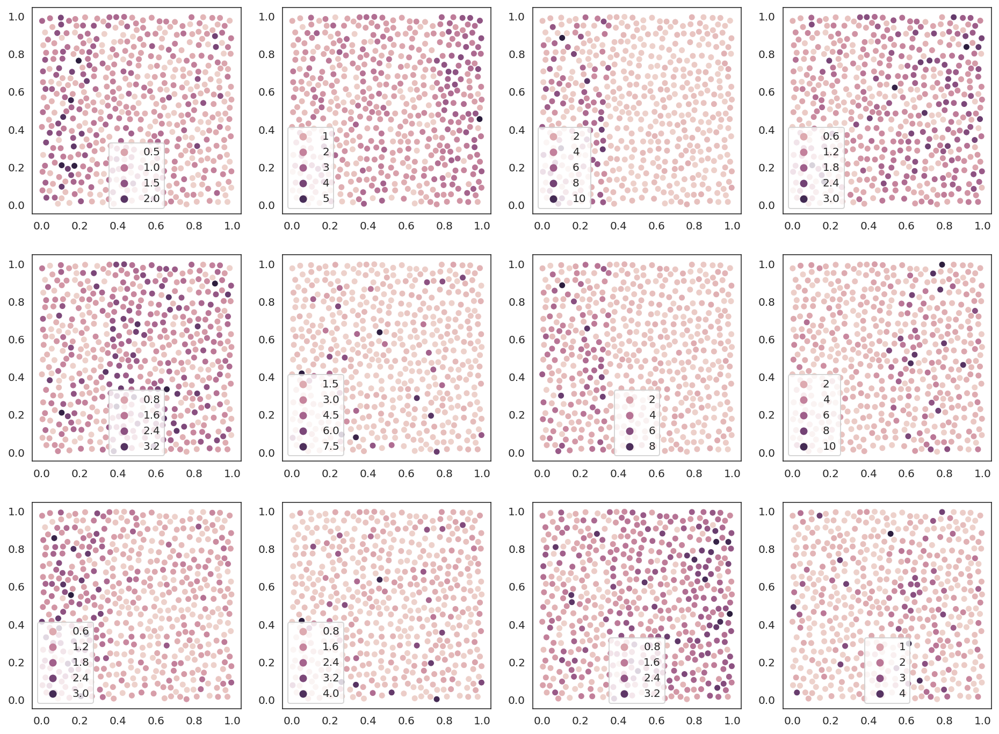

==== iteration 31 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.861273045060295e-08
M NAG Loss: 25014.25
M NAG Loss: 25007.125
M NAG Loss: 25005.5
M NAG Loss: 25004.625
M NAG Loss: 25004.125
M NAG Loss: 25003.375
M NAG Loss: 25002.625
M NAG Loss: 25002.625
M NAG Loss: 25002.125
M NAG Loss: 25001.625
M NAG Loss: 25001.625
M NAG Loss: 25001.375
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.125
M NAG Loss: 25000.625
M NAG Loss: 25000.375
M NAG Loss: 25000.625
M NAG Loss: 25000.0
M NAG Loss: 24999.875
M NAG Loss: 24999.875
M NAG Loss: 24999.875
M NAG Loss: 24999.75
M NAG Loss: 24999.5
M NAG Loss: 24999.25
M NAG Loss: 24999.375
M NAG Loss: 24999.375
M NAG Loss: 24999.375
M NAG Loss: 24999.125
M NAG Loss: 24999.125
M NAG Loss: 24999.125
M NAG Loss: 24999.0
M NAG Loss: 24998.875
M NAG Loss: 24998.875
M NAG Loss: 24998.875
M NAG Loss: 24998.625
M NAG Loss: 24998.625
M NAG Loss: 24998.625
M NAG Loss: 24999.0
M NAG Loss: 24998.625
M NAG Loss: 24998.75
M NAG Loss: 24998.625
M NAG Loss: 24998.5
M NAG Loss: 24998.75
M NAG Loss: 24998.75
M NAG Los

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3208.619140625
Function value: -1581.557373046875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -98214.1875
Function value: -79593.2890625
==== iteration 32 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.8315838581758804e-08
M NAG Loss: 25010.25
M NAG Loss: 25003.875
M NAG Loss: 25002.5
M NAG Loss: 25001.5
M NAG Loss: 25001.125
M NAG Loss: 25000.25
M NAG Loss: 25000.0
M NAG Loss: 24999.5
M NAG Loss: 24999.5
M NAG Loss: 24999.25
M NAG Loss: 24998.875
M NAG Loss: 24998.75
M NAG Loss: 24998.375
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24997.875
M NAG Loss: 24997.5
M NAG Loss: 24997.75
M NAG Loss: 24997.5
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24997.0
M NAG Loss: 24996.75
M NAG Loss: 24996.5
M NAG Loss: 24996.75
M NAG Loss: 24996.5
M NAG Loss: 24996.75
M NAG Loss: 24996.25
M NAG Loss: 24996.25
M NAG Loss: 24996.25
M NAG Loss: 24996.5
M NAG Loss: 24996.375
M NAG Loss: 24996.25
M NAG Loss: 24996.25
M NAG Loss: 24996.375
M NAG Loss: 24996.125
M NAG Loss: 24996.0
M NAG Loss: 24995.875
M NAG Loss: 24996.0
M NAG Loss: 24996.125
M NAG Loss: 24996.0
M NAG Loss: 24995.75
M NAG Loss: 24996.125
M NAG Loss: 24996.125
M NAG Loss: 24995.875
M NAG Loss: 24

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -1911.18310546875
Function value: -1820.459228515625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -931.26513671875
Function value: -6942.1533203125
==== iteration 33 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.8005582457255684e-08
M NAG Loss: 25011.0
M NAG Loss: 25005.25
M NAG Loss: 25004.0
M NAG Loss: 25003.25
M NAG Loss: 25002.625
M NAG Loss: 25002.0
M NAG Loss: 25001.875
M NAG Loss: 25001.375
M NAG Loss: 25001.25
M NAG Loss: 25000.875
M NAG Loss: 25000.75
M NAG Loss: 25000.375
M NAG Loss: 25000.375
M NAG Loss: 25000.0
M NAG Loss: 25000.0
M NAG Loss: 24999.75
M NAG Loss: 24999.625
M NAG Loss: 24999.375
M NAG Loss: 24999.25
M NAG Loss: 24999.0
M NAG Loss: 24999.125
M NAG Loss: 24999.0
M NAG Loss: 24998.875
M NAG Loss: 24998.5
M NAG Loss: 24998.5
M NAG Loss: 24998.625
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24998.125
M NAG Loss: 24998.0
M NAG Loss: 24998.25
M NAG Loss: 24998.25
M NAG Loss: 24997.875
M NAG Loss: 24998.0
M NAG Loss: 24997.875
M NAG Loss: 24998.0
M NAG Loss: 24998.0
M NAG Loss: 24997.875
M NAG Loss: 24998.0
M NAG Loss: 24997.875
M NAG Loss: 24997.75
M NAG Loss: 24997.875
M NAG Loss: 24997.75
M NAG Loss: 24997.75
M NAG Loss: 24997.75
M NAG Lo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3388.4560546875
Function value: -4782.65478515625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -3062.4619140625
Function value: -9307.19140625
==== iteration 34 ====
1.0000e-04


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

5.769232544379244e-08
M NAG Loss: 25011.75
M NAG Loss: 25006.0
M NAG Loss: 25005.0
M NAG Loss: 25004.125
M NAG Loss: 25003.75
M NAG Loss: 25003.125
M NAG Loss: 25002.75
M NAG Loss: 25002.5
M NAG Loss: 25002.125
M NAG Loss: 25002.0
M NAG Loss: 25002.0
M NAG Loss: 25001.5
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.25
M NAG Loss: 25001.0
M NAG Loss: 25000.75
M NAG Loss: 25000.5
M NAG Loss: 25000.25
M NAG Loss: 25000.375
M NAG Loss: 25000.125
M NAG Loss: 25000.25
M NAG Loss: 24999.875
M NAG Loss: 24999.75
M NAG Loss: 24999.75
M NAG Loss: 24999.75
M NAG Loss: 24999.75
M NAG Loss: 24999.5
M NAG Loss: 24999.375
M NAG Loss: 24999.5
M NAG Loss: 24999.25
M NAG Loss: 24999.5
M NAG Loss: 24999.25
M NAG Loss: 24999.375
M NAG Loss: 24999.25
M NAG Loss: 24999.25
M NAG Loss: 24999.0
M NAG Loss: 24999.125
M NAG Loss: 24999.0
M NAG Loss: 24999.125
M NAG Loss: 24999.25
M NAG Loss: 24999.0
M NAG Loss: 24998.875
M NAG Loss: 24999.125
M NAG Loss: 24999.0
M NAG Loss: 24999.0
M NAG Loss: 2499

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -912.320556640625
Function value: -3785.181640625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Function value: -6296.30078125
Function value: -7271.52294921875


In [16]:
# SpiceMix shared 50 iterations
obj = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    metagene_mode="shared",
    lambda_M=1,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
    random_state=2
)
obj.load_dataset(path2dataset)
# obj.meta['cell type'] = obj.meta['cell type'].astype('category')
obj.initialize(
    method='kmeans',
#     method='svd',
#    random_state=2,
)
# print(obj.sigma_yxs)
# obj.sigma_yxs[:] = 1e-2
# for prior_x in obj.prior_xs: prior_x[0][:] = 0
# evaluate(obj)
for iiter in trange(15):
    obj.estimate_weights(iiter=iiter, use_spatial=[False]*obj.num_repli, backend_algorithm="gd")
    obj.estimate_parameters(iiter=iiter, use_spatial=[False]*obj.num_repli)
    
obj.initialize_Sigma_x_inv()
for iiter in range(35):
    print(f'==== iteration {iiter} ====')
    obj.lambda_Sigma_x_inv = max(1e-4, 1e-1 * .7**iiter)
    print(f'{obj.lambda_Sigma_x_inv:.4e}')
    obj.estimate_parameters(iiter=iiter, use_spatial=[True]*obj.num_repli)
    obj.estimate_weights(iiter=iiter, use_spatial=[True]*obj.num_repli)
    if iiter % 10 == 0:
        evaluate(obj)

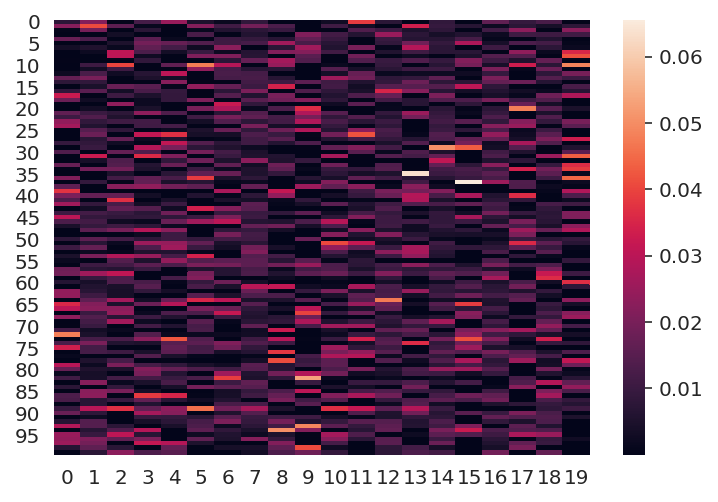

<AxesSubplot:>

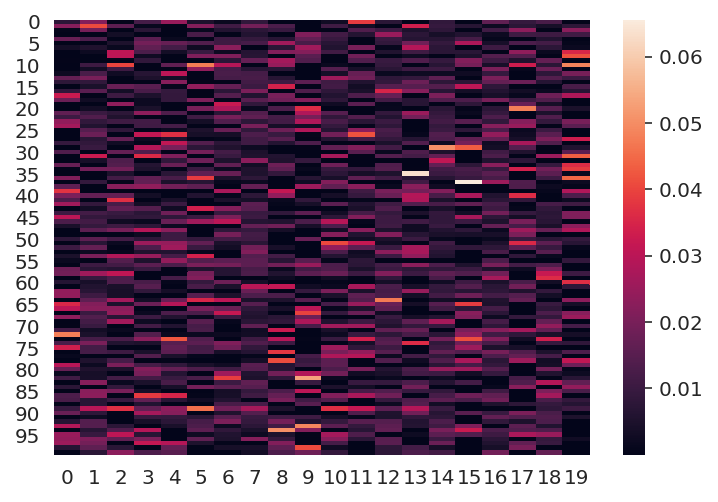

In [17]:
sns.heatmap(obj.datasets[1].uns["M"]["1"].detach().cpu().numpy())
plt.show()
plt.figure()
sns.heatmap(obj.datasets[0].uns["M"]["0"].detach().cpu().numpy())

replicate 0hierarchical w/ K=6.ARI = 0.60
replicate 0hierarchical w/ K=7.ARI = 0.69
replicate 0hierarchical w/ K=8.ARI = 0.76
replicate 0hierarchical w/ K=9.ARI = 0.77
replicate 1hierarchical w/ K=6.ARI = 0.73
replicate 1hierarchical w/ K=7.ARI = 0.84
replicate 1hierarchical w/ K=8.ARI = 0.86
replicate 1hierarchical w/ K=9.ARI = 0.84


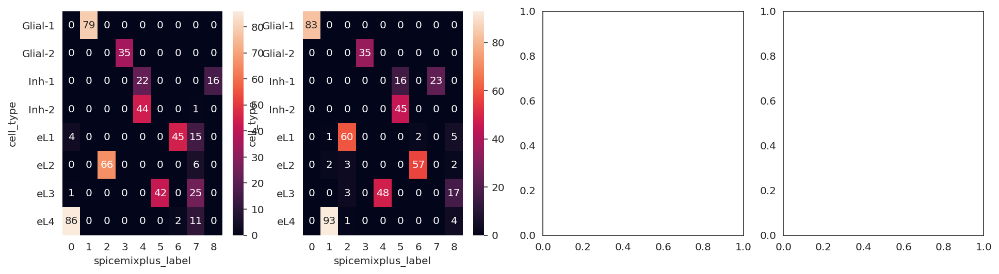

sil 0.6112937


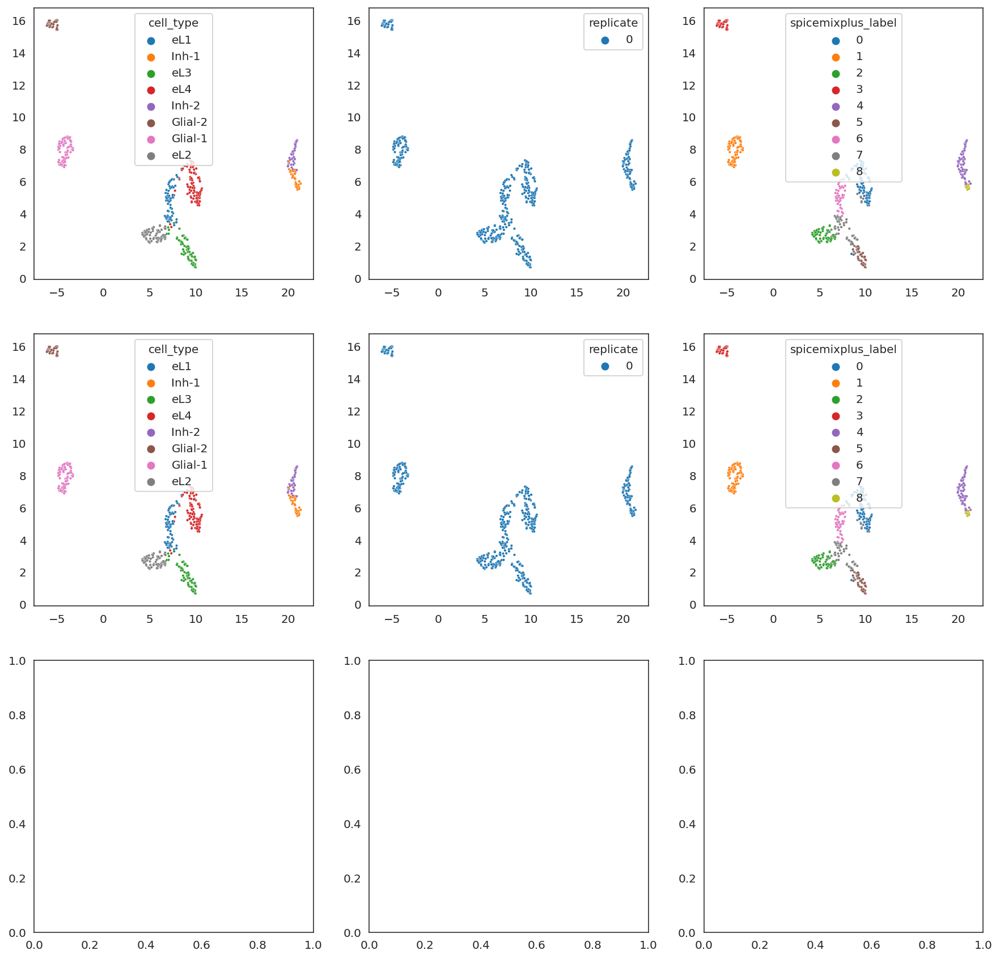

sil 0.6303406


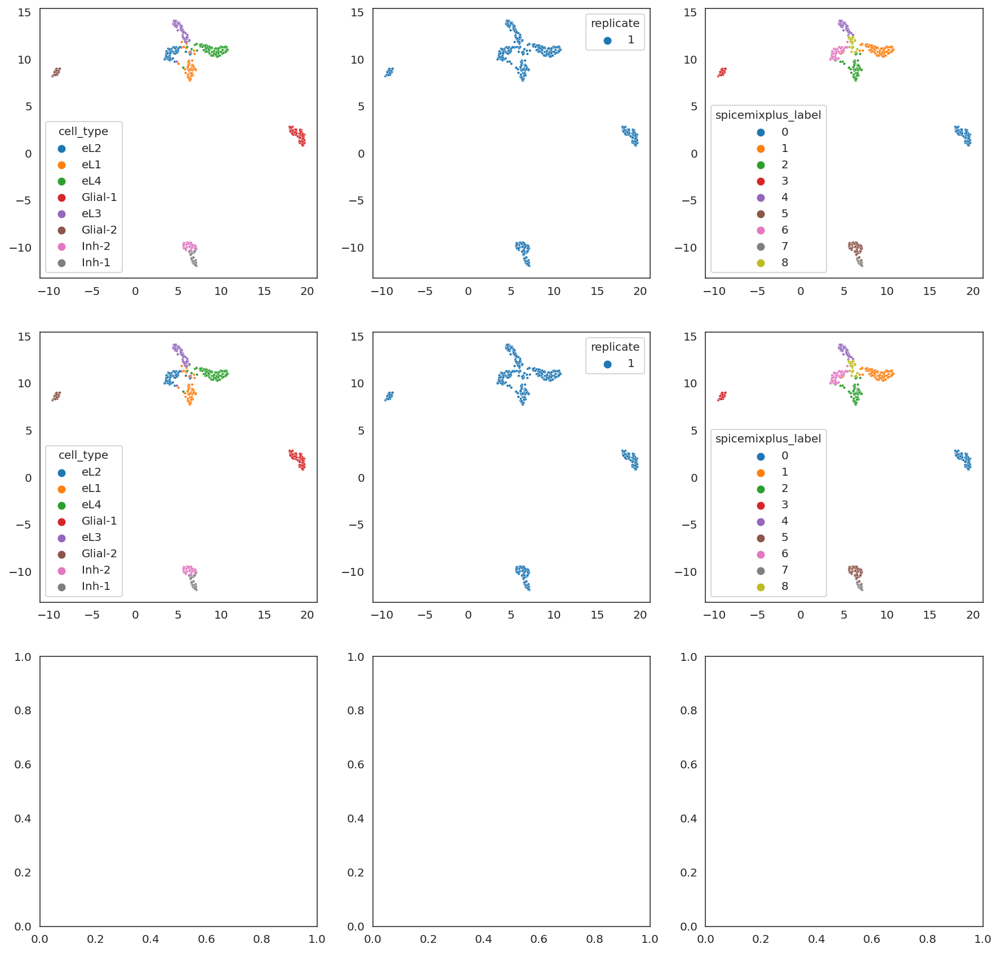

Done


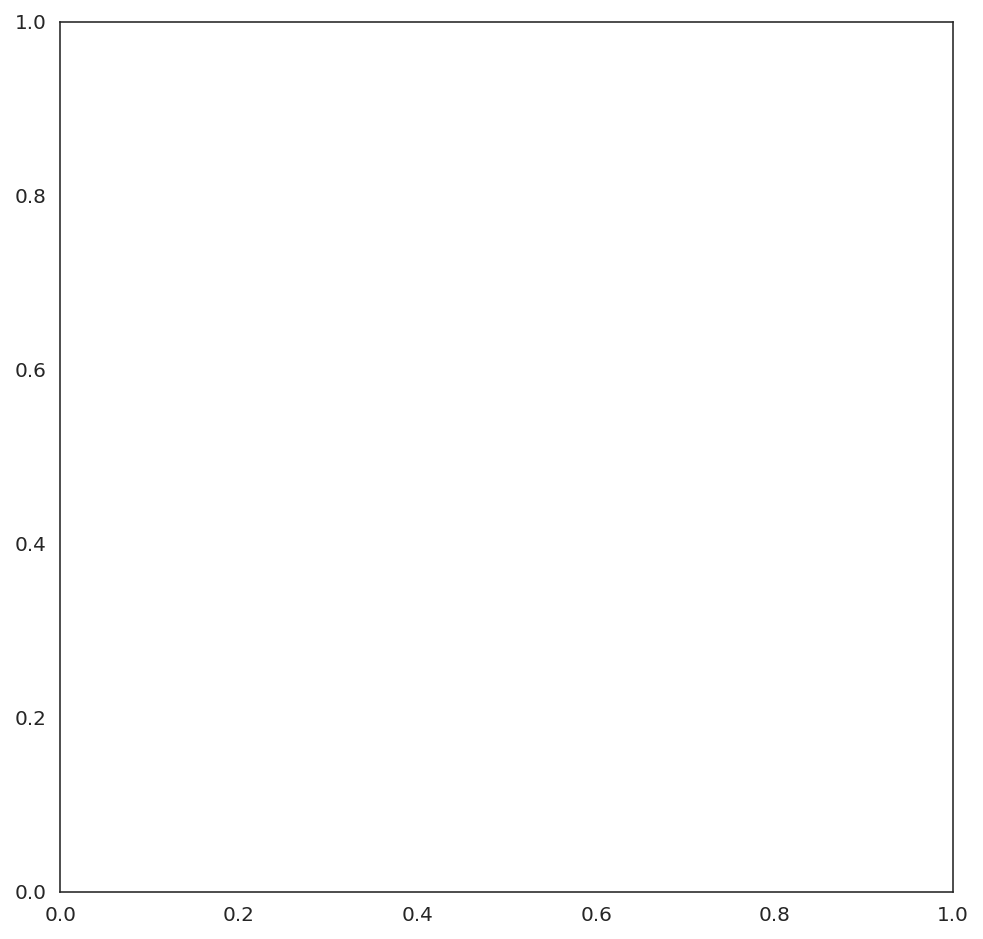

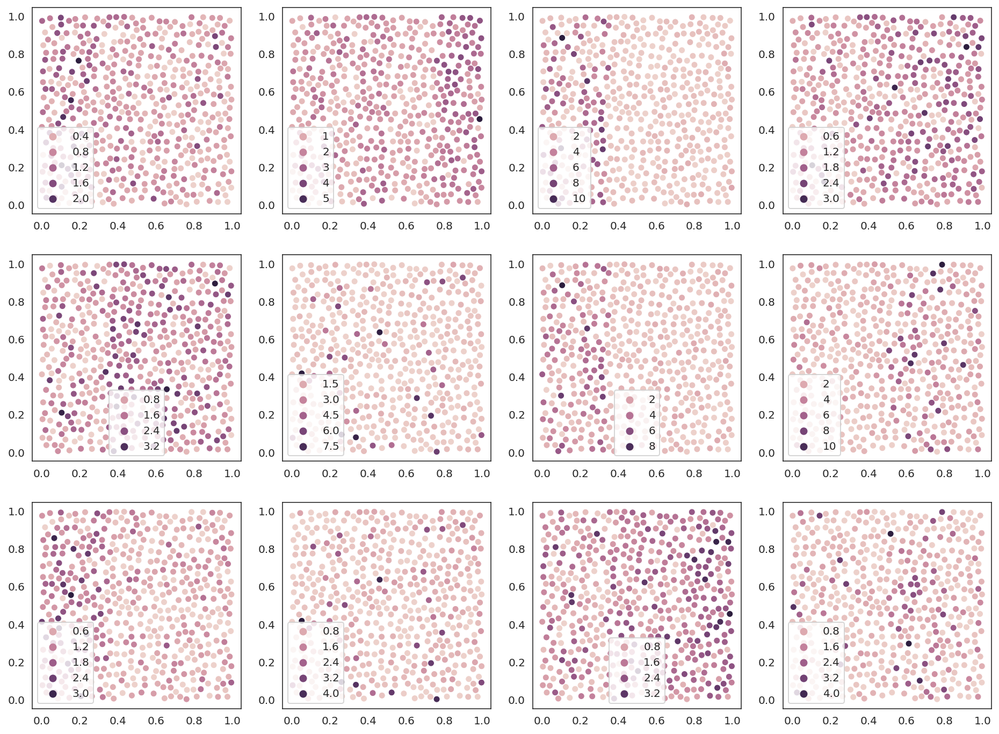

In [18]:
reload_all()
evaluate(obj)

In [24]:
%e

> /work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/util.py(198)plot()
    196                 fig, axes = plt.subplots(nrow, ncol, figsize=(5*ncol, 5*nrow))
    197                 def plot(axes, idx):
--> 198                     for ax, key in zip(axes, keys):
    199                         sns.scatterplot(ax=ax, data=obj.meta.iloc[idx], x=x[idx, 0], y=x[idx, 1], hue=key, s=5)
    200                 plot(axes[0], slice(None))

ipdb> 
ipdb> 
ipdb> 
ipdb> 
ipdb> fsad
*** NameError: name 'fsad' is not defined
ipdb> exit()


# supervised

[tensor([[0.0953, 0.0831, 0.0680,  ..., 0.1214, 0.0738, 0.1078],
        [0.0850, 0.1055, 0.0428,  ..., 0.0671, 0.0816, 0.0844],
        [0.1184, 0.0895, 0.0706,  ..., 0.1184, 0.0745, 0.1195],
        ...,
        [0.0992, 0.1088, 0.0681,  ..., 0.0688, 0.0565, 0.0172],
        [0.0888, 0.1009, 0.0774,  ..., 0.0886, 0.0716, 0.1165],
        [0.1772, 0.1617, 0.1137,  ..., 0.2120, 0.0927, 0.1500]],
       device='cuda:0'), tensor([[0.1011, 0.0815, 0.0731,  ..., 0.1129, 0.0876, 0.0890],
        [0.0795, 0.0909, 0.0506,  ..., 0.1060, 0.0569, 0.0886],
        [0.1805, 0.1868, 0.1212,  ..., 0.1625, 0.1143, 0.1399],
        ...,
        [0.1033, 0.1325, 0.0594,  ..., 0.0603, 0.0664, 0.1194],
        [0.0303, 0.1143, 0.0810,  ..., 0.0630, 0.0816, 0.0404],
        [0.0343, 0.0803, 0.0521,  ..., 0.0674, 0.0904, 0.0793]],
       device='cuda:0')]


Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

hierarchical w/ K=6.ARI = 0.72
hierarchical w/ K=7.ARI = 0.85
hierarchical w/ K=8.ARI = 0.90
hierarchical w/ K=9.ARI = 0.89


Louvain clustering: res=3.16e-01:   0%|          | 0/100 [00:00<?, ?it/s]

ari = 0.97
ari 0 = 0.99
ari 1 = 0.95


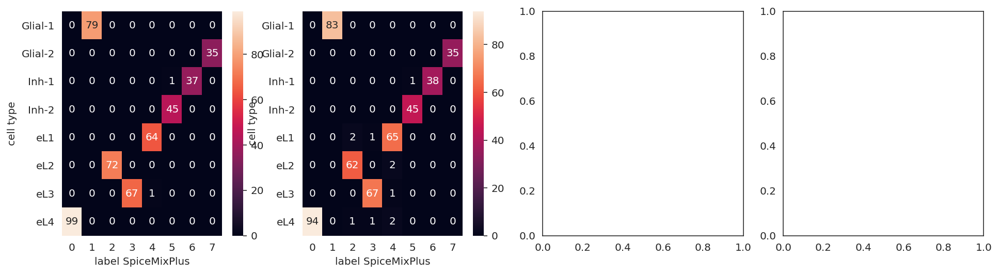

sil 0.7381518


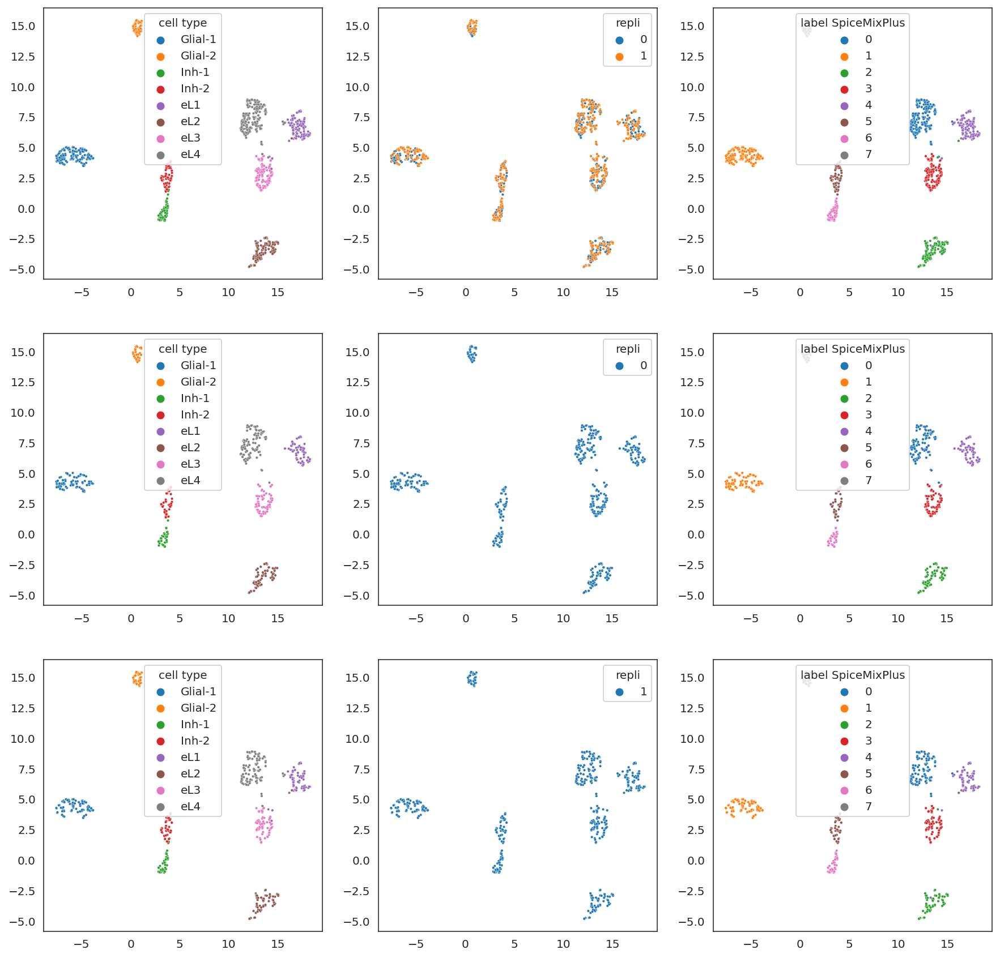

,acc,f1 micro,f1 macro,ari
0,0.99,0.99,0.990890,0.975994
1,0.98,0.98,0.979228,0.957457


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating `cell type encoded` predictor:   0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating Z w/ nbrs w/ ph.:   0%|          | 0/500 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

hierarchical w/ K=6.ARI = 0.78
hierarchical w/ K=7.ARI = 0.90
hierarchical w/ K=8.ARI = 0.95
hierarchical w/ K=9.ARI = 0.87


Louvain clustering: res=3.16e-01:   0%|          | 0/100 [00:00<?, ?it/s]

ari = 0.97
ari 0 = 0.97
ari 1 = 0.96


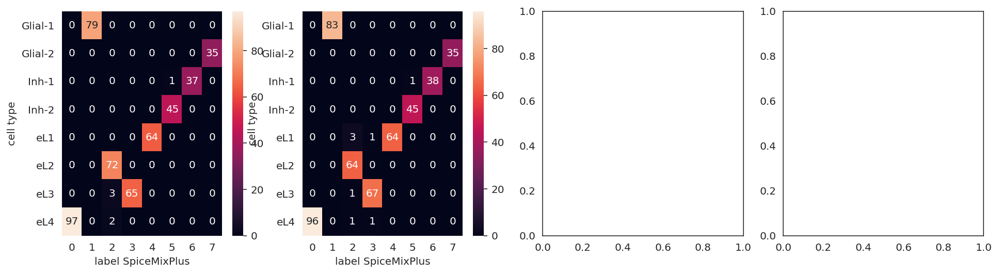

sil 0.7501676


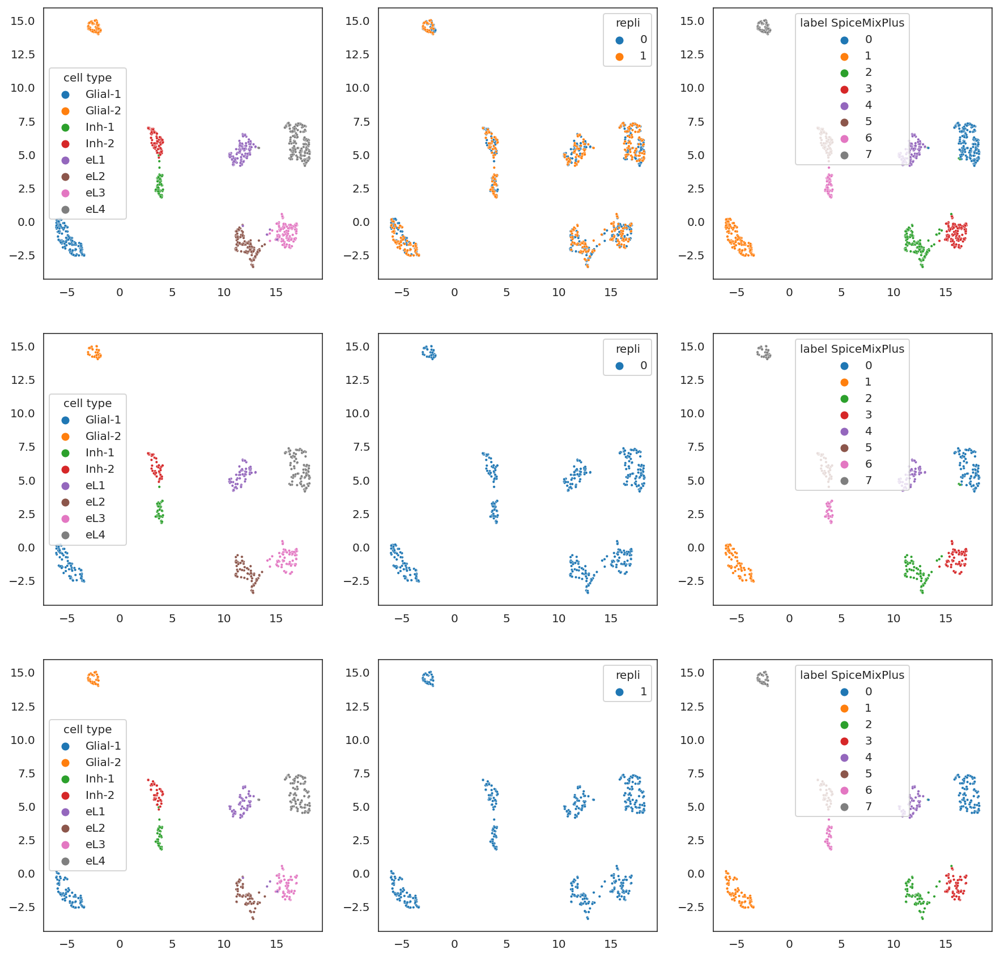

,acc,f1 micro,f1 macro,ari
0,0.988,0.988,0.988728,0.971450
1,0.980,0.980,0.978675,0.957191


CPU times: user 3min 44s, sys: 8.32 s, total: 3min 52s
Wall time: 3min 44s


In [5]:
%%time
reload_all()
from model import SpiceMixPlus
from util import clustering_louvain_nclust, evaluate_embedding, evaluate_prediction_wrapper
from sklearn.cluster import AgglomerativeClustering


# evaluate = lambda obj, f=evaluate_embedding: f(obj, embedding='X', do_plot=True, do_sil=True)
def evaluate(obj):
    evaluate_embedding(obj, embedding='X', do_plot=True, do_sil=True)
    evaluate_prediction_wrapper(obj, display_fn=display)

K = 10

obj = SpiceMixPlus(
    K=K, lambda_Sigma_x_inv=1e-2,
    repli_list=repli_list,
    context=context,
#     context_Y=dict(dtype=torch.float32, device='cpu'),
    context_Y=context,
)
obj.load_dataset(path2dataset)
obj.meta['cell type'] = obj.meta['cell type'].astype('category')

phenotype2predictor = {}
df = obj.meta
# cell type
label_raw = df['cell type']
label_a2i = dict(zip(np.unique(label_raw), itertools.count()))
label = list(map(label_a2i.get, label_raw))
df['cell type encoded'] = np.array(label, dtype=int)
predictor = nn.Linear(K, len(set(label)))
predictor = predictor.to(context['device'])
predictor.weight.data.normal_()
predictor.bias.data.normal_()
optimizer = torch.optim.Adam(predictor.parameters(), lr=1e-2, weight_decay=1e-2)
# loss_fn = nn.CrossEntropyLoss()
def loss_fn(yhat, y, state):
    if state == 'train':
         return torch.nn.functional.cross_entropy(yhat, y, reduction='mean')
    elif state == 'eval':
         return torch.nn.functional.cross_entropy(yhat, y, reduction='sum') * 1e1
    else:
        raise NotImplementError
phenotype2predictor['cell type encoded'] = (predictor, optimizer, loss_fn)
del label_raw, label, predictor, optimizer, loss_fn
obj.register_phenotype(phenotype2predictor)
print(obj.Ys)
obj.phenotypes[1]['cell type encoded'] = None

obj.initialize(
#     method='kmeans',
    method='svd',
#     random_state=4,
)
# evaluate(obj)
for iiter in trange(20):
    obj.estimate_parameters(iiter=iiter, use_spatial=[False]*obj.num_repli)
    obj.estimate_weights(iiter=iiter, use_spatial=[False]*obj.num_repli)
evaluate(obj)
obj.initialize_Sigma_x_inv()

# obj.phenotypes = [{}]
# obj.phenotype_predictors = None

# obj.register_phenotype(phenotype2predictor)

for iiter in range(1, 11):
    obj.estimate_parameters(iiter=iiter, use_spatial=[True]*obj.num_repli)
    obj.estimate_weights(iiter=iiter, use_spatial=[True]*obj.num_repli)
    if iiter % 10 == 0:
        evaluate(obj)

In [ ]:
#evaluate(obj)
Xs = [dataset.obsm["X"] for dataset in obj.datasets]
x = np.concatenate(Xs, axis=0)
x = StandardScaler().fit_transform(x)
x = UMAP(
    random_state=obj.random_state,
    n_neighbors=10,
).fit_transform(x)

In [36]:
print(silhouette_score(x, pd.concat([dataset.obs["cell_type"] for dataset in obj.datasets]), random_state=obj.random_state))

0.7627127


In [ ]:
%debug

> <ipython-input-33-1a1947510518>(1)<module>()
----> 1 print(silhouette_score(x, pd.concat([dataset.obs["cell_type"] for dataset in obj.datsets]), random_state=obj.random_state))

ipdb> 
ipdb> 


In [23]:
reload_all()
from util import evaluate_prediction

X_train = obj.Xs[0].cpu().numpy()
X_all = np.concatenate([X.cpu().numpy() for X in obj.Xs], axis=0)
y_train = obj.meta.groupby('repli').get_group('0')['cell type'].values

# from sklearn.linear_model import LogisticRegression
# for C in 10.**np.arange(-5, 0):
#     print(C)
#     clf = LogisticRegression(C=C)
#     obj.meta['label baseline'] = clf.fit(X_train, y_train).predict(X_all)
#     display(evaluate_prediction(obj.meta, key_pred='label baseline'))

from sklearn.neighbors import KNeighborsClassifier
for n_neighbors in np.arange(5, 31, 5):
    print(n_neighbors)
    clf = KNeighborsClassifier(n_neighbors)
    obj.meta['label baseline'] = clf.fit(X_train, y_train).predict(X_all)
    display(evaluate_prediction(obj.meta, key_pred='label baseline'))

5


,acc,f1 micro,f1 macro,ari
0,0.998,0.998,0.998396,0.994498
1,0.980,0.980,0.981143,0.953932


10


,acc,f1 micro,f1 macro,ari
0,0.996,0.996,0.995356,0.991715
1,0.978,0.978,0.979873,0.947529


15


,acc,f1 micro,f1 macro,ari
0,0.996,0.996,0.995356,0.991715
1,0.982,0.982,0.981821,0.960054


20


,acc,f1 micro,f1 macro,ari
0,0.996,0.996,0.995356,0.991715
1,0.988,0.988,0.988051,0.974410


25


,acc,f1 micro,f1 macro,ari
0,0.996,0.996,0.996608,0.989778
1,0.984,0.984,0.984966,0.963291


30


,acc,f1 micro,f1 macro,ari
0,0.994,0.994,0.993476,0.987232
1,0.986,0.986,0.985695,0.970864


In [ ]:
reload_all()
from util import evaluate_prediction
X_all = torch.cat([X for X in obj.Xs], axis=0)
obj.meta['label SpiceMixPlus predictor'] = obj.phenotype_predictors['cell type encoded'][0](X_all).argmax(1).cpu().numpy().astype(str)
display(evaluate_prediction(obj.meta, key_pred='label SpiceMixPlus predictor'))

In [79]:
reload_all()
from estimate_weights import estimate_weight_wonbr, estimate_weight_wnbr
N, G, K = 100, 50, 5
M = torch.rand(G, K, **context)
X = torch.rand(N, K, **context)
Y = X @ M.T + torch.randn(N, G, **context)*1e-2
Y.clip_(min=0)

X1 = X.clone()
estimate_weight_wonbr(
    Y, M, X1, 1, 
    'exponential shared fixed', (torch.full([K], 1e-2, **context),), context=context)
X2 = X.clone()
estimate_weight_wnbr(
    Y, M, X2, 1, 
    None, [[i] for i in range(N)],
    'exponential shared fixed', (torch.full([K], 1e-2, **context),), context=context)
print(torch.linalg.norm(X1-X2))
print(torch.linalg.norm(Y - X @ M.T))
print(torch.linalg.norm(Y - X1 @ M.T))
print(torch.linalg.norm(Y - X2 @ M.T))

  0%|          | 0/10000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

tensor(0.0083, device='cuda:0')
tensor(0.7111, device='cuda:0')
tensor(0.6753, device='cuda:0')
tensor(0.6754, device='cuda:0')
